# (30) Simulation -- full [final]

**Motivation**: Explore/visualize various combination, learn the behavior of the simulation. <br>

In [1]:
# HIDE CODE


import os
import sys
from copy import deepcopy as dc
from os.path import join as pjoin
from IPython.display import display, IFrame, HTML

# tmp & extras dir
git_dir = pjoin(os.environ['HOME'], 'Dropbox/git')
extras_dir = pjoin(git_dir, 'jb-MTMST/_extras')
fig_base_dir = pjoin(git_dir, 'jb-MTMST/figs')
tmp_dir = pjoin(git_dir, 'jb-MTMST/tmp')

# GitHub
sys.path.insert(0, pjoin(git_dir, '_MTMST'))
from model.opticflow import *

# warnings, tqdm, & style
warnings.filterwarnings('ignore', category=DeprecationWarning)
from tqdm.notebook import tqdm
from rich.jupyter import print
%matplotlib inline
set_style()

In [2]:
# HIDE CODE


def show_thetaphi(t, p):
    fig, axes = create_figure(1, 4, (13, 2.5), tight_layout=True)
    im = axes[0].imshow(t, cmap='nipy_spectral')
    plt.colorbar(im, ax=axes[0])

    im = axes[2].imshow(p, cmap='hsv', vmin=0, vmax=2*np.pi)
    plt.colorbar(im, ax=axes[2])

    for ax in [axes[0], axes[2]]:
        ax.invert_yaxis()
        ax.tick_params(labelsize=10)
        ax.set(
            xticks=of.ticks,
            yticks=of.ticks,
            xticklabels=of.ticklabels,
            yticklabels=of.ticklabels,
        )

    axes[1].axvline(np.deg2rad(fov), color='r', ls='--', label=f'{fov} deg')
    sns.histplot(
        t.ravel(), ax=axes[1], label=r'$\theta$',
        bins=np.linspace(0, np.pi/2, 91), stat='count')
    sns.histplot(
        p.ravel(), ax=axes[3], label=r'$\phi$', color='C0',
        bins=np.linspace(0, 2*np.pi, 37), stat='count')
    
    sns.histplot(
        p[t <= np.deg2rad(fov)], ax=axes[3], label=r'$\phi$' + f' (<{fov})', color='C1',
        bins=np.linspace(0, 2*np.pi, 37), stat='count')
    for ax in [axes[1], axes[3]]:
        ax.set_ylabel('')
        ax.legend(fontsize=8, loc='upper left')

    plt.show()
    
    
def show_xyzd(x, y, z, d, cmap='Spectral', grid=False):
    fig, axes = create_figure(1, 4, (12, 2.5), 'all', 'all', tight_layout=True)
    im = axes[0].imshow(x, cmap=cmap)
    plt.colorbar(im, ax=axes[0])
    axes[0].set_title(r'$\mathcal{x}$', y=1.02, fontsize=17)

    im = axes[1].imshow(y, cmap=cmap)
    plt.colorbar(im, ax=axes[1])
    axes[1].set_title(r'$\mathcal{y}$', y=1.02, fontsize=17)

    im = axes[2].imshow(z, cmap=cmap)
    plt.colorbar(im, ax=axes[2])
    axes[2].set_title(r'$\mathcal{z}$', y=1.02, fontsize=17)

    im = axes[3].imshow(d, cmap=cmap)
    plt.colorbar(im, ax=axes[3])
    axes[3].set_title(r'$\mathcal{d} = \sqrt{\mathcal{x}^2+\mathcal{y}^2+\mathcal{z}^2}$', y=1.02, fontsize=14)

    axes[-1].invert_yaxis()
    for ax in axes.flat:
        ax.tick_params(labelsize=10)
        ax.set(
            xticks=of.ticks,
            yticks=of.ticks,
            xticklabels=of.ticklabels,
            yticklabels=of.ticklabels,
        )
    if grid:
        add_grid(axes)
    plt.show()
    
    
def hist_xyzd(x, y, d, z=None, bins=30):
    kws = {
        'bins': bins,
        'stat': 'percent',
    }
    fig, axes = create_figure(2, 4, (13, 5), sharey='all', constrained_layout=True)
    sns.histplot(x.ravel(), ax=axes[0, 0], **kws)
    sns.histplot(y.ravel(), ax=axes[0, 1], **kws)
    if z is not None:
        sns.histplot(z.ravel(), ax=axes[0, 2], **kws)
    sns.histplot(d.ravel(), ax=axes[0, 3], **kws)

    sns.histplot(x[of.theta < np.deg2rad(fov)], ax=axes[1, 0], **kws)
    sns.histplot(y[of.theta < np.deg2rad(fov)], ax=axes[1, 1], **kws)
    if z is not None:
        sns.histplot(z[of.theta < np.deg2rad(fov)], ax=axes[1, 2], **kws)
    sns.histplot(d[of.theta < np.deg2rad(fov)], ax=axes[1, 3], **kws)
    
    axes[0, 0].set_title(r'$x$', y=1.02, fontsize=17)
    axes[0, 1].set_title(r'$y$', y=1.02, fontsize=17)
    axes[0, 2].set_title(r'$z$', y=1.02, fontsize=17)
    axes[0, 3].set_title(r'$d$', y=1.02, fontsize=17)
    
    plt.show()
    

def show_velocity(v, cmap='Spectral_r', grid=False):
    rho, phi = vel2polar(v)
    vminmax = np.max(np.abs(v))
    kws = dict(
        cmap='bwr',
        vmax=vminmax,
        vmin=-vminmax,
    )
    fig, axes = create_figure(1, 4, (12, 2.5), 'all', 'all', tight_layout=True)
    im = axes[0].imshow(v[..., 0], **kws)
    plt.colorbar(im, ax=axes[0])
    axes[0].set_title(r'$v_x$', y=1.02, fontsize=17)

    im = axes[1].imshow(v[..., 1], **kws)
    plt.colorbar(im, ax=axes[1])
    axes[1].set_title(r'$v_y$', y=1.02, fontsize=17)

    im = axes[2].imshow(rho, cmap=cmap)
    plt.colorbar(im, ax=axes[2])
    axes[2].set_title(r'$\rho$', y=1.02, fontsize=17)

    im = axes[3].imshow(phi, cmap='hsv', vmin=0, vmax=2*np.pi)
    plt.colorbar(im, ax=axes[3])
    axes[3].set_title(r'$\phi$', y=1.02, fontsize=14)

    axes[-1].invert_yaxis()
    for ax in axes.flat:
        ax.tick_params(labelsize=10)
        ax.set(
            xticks=of.ticks,
            yticks=of.ticks,
            xticklabels=of.ticklabels,
            yticklabels=of.ticklabels,
        )
    if grid:
        add_grid(axes)
    plt.show()


from skimage.transform import resize

def show_opticflow(v):
    fig, axes = create_figure(1, 3, (12, 4), constrained_layout=True)
    axes[0].quiver(
        range(-2, 2 + 1),
        range(-2, 2 + 1),
        resize(v[..., 0], (4+1,) * 2),
        resize(v[..., 1], (4+1,) * 2),
        # scale=150,
    )
    axes[1].quiver(
        range(-4, 4 + 1),
        range(-4, 4 + 1),
        resize(v[..., 0], (8+1,) * 2),
        resize(v[..., 1], (8+1,) * 2),
        # scale=100,
    )
    axes[2].quiver(
        range(-8, 8 + 1),
        range(-8, 8 + 1),
        resize(v[..., 0], (16+1,) * 2),
        resize(v[..., 1], (16+1,) * 2),
        # scale=100,
    )
    ax_square(axes)
    plt.show()

## Setup

In [3]:
fov = 45
res = 1

fix = np.array([
    [0, 0],
    [0.4, 0],
    [0, 0.4],
    [0.4, 0.4],
])
of = OpticFlow(fov, res).compute_coords(fix)

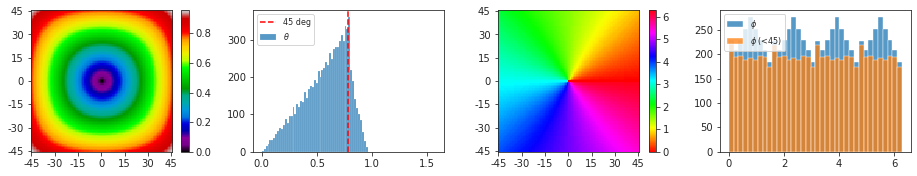

In [4]:
theta, phi = self2polar(of.alpha[..., 0], of.alpha[..., 1])
show_thetaphi(theta, phi)

## No object

In [5]:
vel = np.array([[0, 0, 10]]).T
obj_pos = np.array([[0, 0, 1]]).T
obj_vel = np.array([[0, 0, 0]]).T

In [6]:
alpha_dot = of.compute_flow(vel, obj_pos, obj_vel)
alpha_dot.shape

(4, 91, 91, 2, 1, 1)

fixation: [0. 0. 1.]

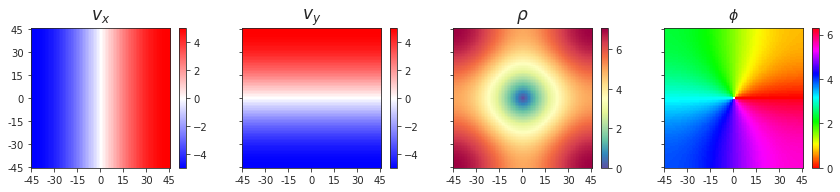

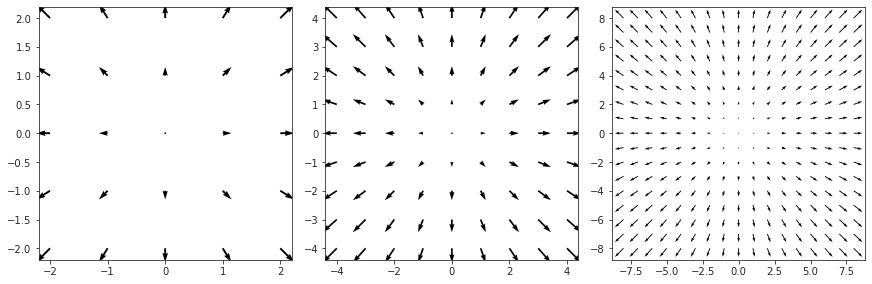

---------------------------------------------------------------------------

fixation: [0.4 0.  1. ]

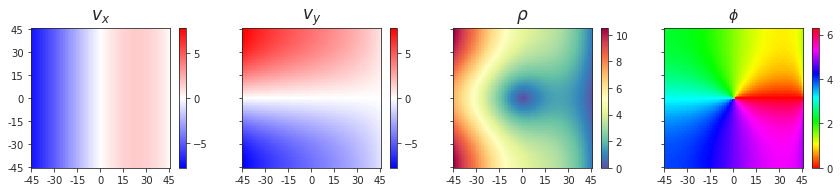

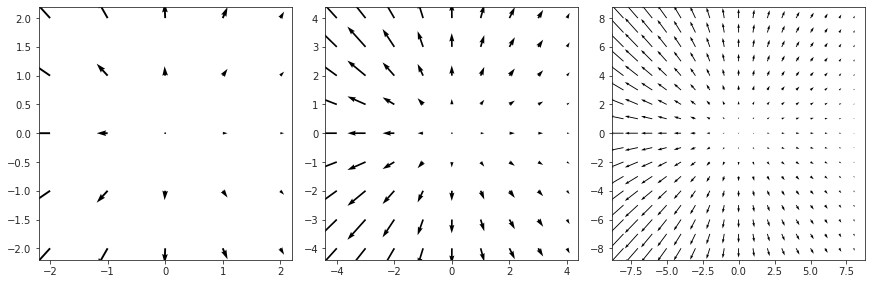

---------------------------------------------------------------------------

fixation: [0.  0.4 1. ]

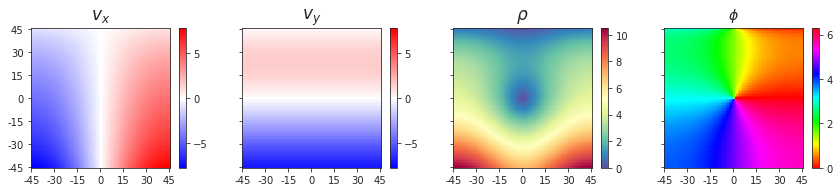

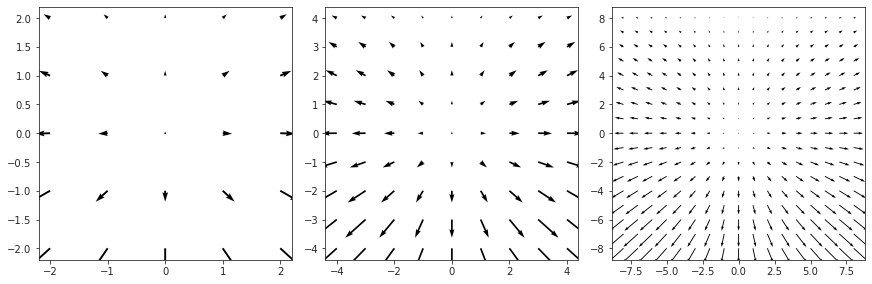

---------------------------------------------------------------------------

fixation: [0.4 0.4 1. ]

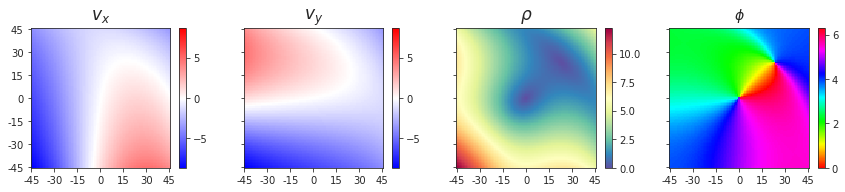

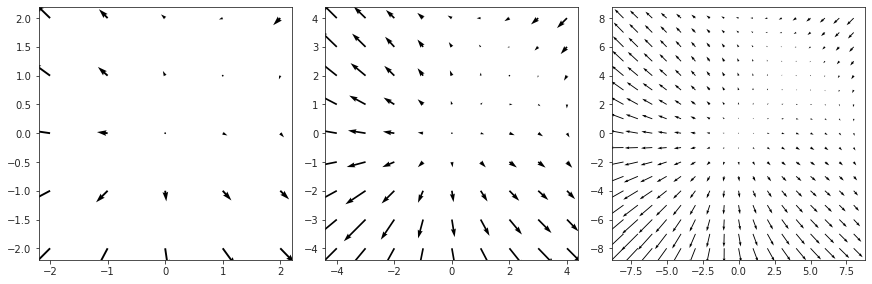

---------------------------------------------------------------------------

In [7]:
j, k = 0, 0

for i, f in enumerate(of.fix):
    msg = f"fixation: {f}"
    print(msg)
    show_velocity(alpha_dot[i, ..., j, k])
    show_opticflow(alpha_dot[i, ..., j, k])
    print('-' * 75)
    print('\n\n')

### Fixation loop

In [108]:
nrows, ncols = 5, 5
ylim = 0.4
yspan = np.linspace(-ylim, ylim, nrows)
fix = np.zeros((nrows, ncols, 2))
for i, y in enumerate(yspan):
    xlim = 1 / np.tan(fov) - abs(y) - 0.01
    xspan = np.linspace(-xlim, xlim, ncols)
    for j, x in enumerate(xspan):
        fix[i, j] = [x, y]
fix.shape

(5, 5, 2)

In [109]:
of = OpticFlow(fov, res).compute_coords(flatten_arr(fix))

vel = np.array([[0, 0, 10]]).T
alpha_dot = of.compute_flow(vel, obj_pos, obj_vel)
alpha_dot.shape

(25, 91, 91, 2, 1, 1)

In [110]:
scale = 8
j, k = 0, 0
v2p = alpha_dot[..., j, k]
v2p = v2p.reshape((nrows, ncols, of.dim, of.dim, 2))
shape = v2p.shape
shape = [
    e if e != of.dim
    else 2 * scale + 1
    for e in shape
]
v2p = resize(v2p, shape)
v2p.shape

(5, 5, 17, 17, 2)

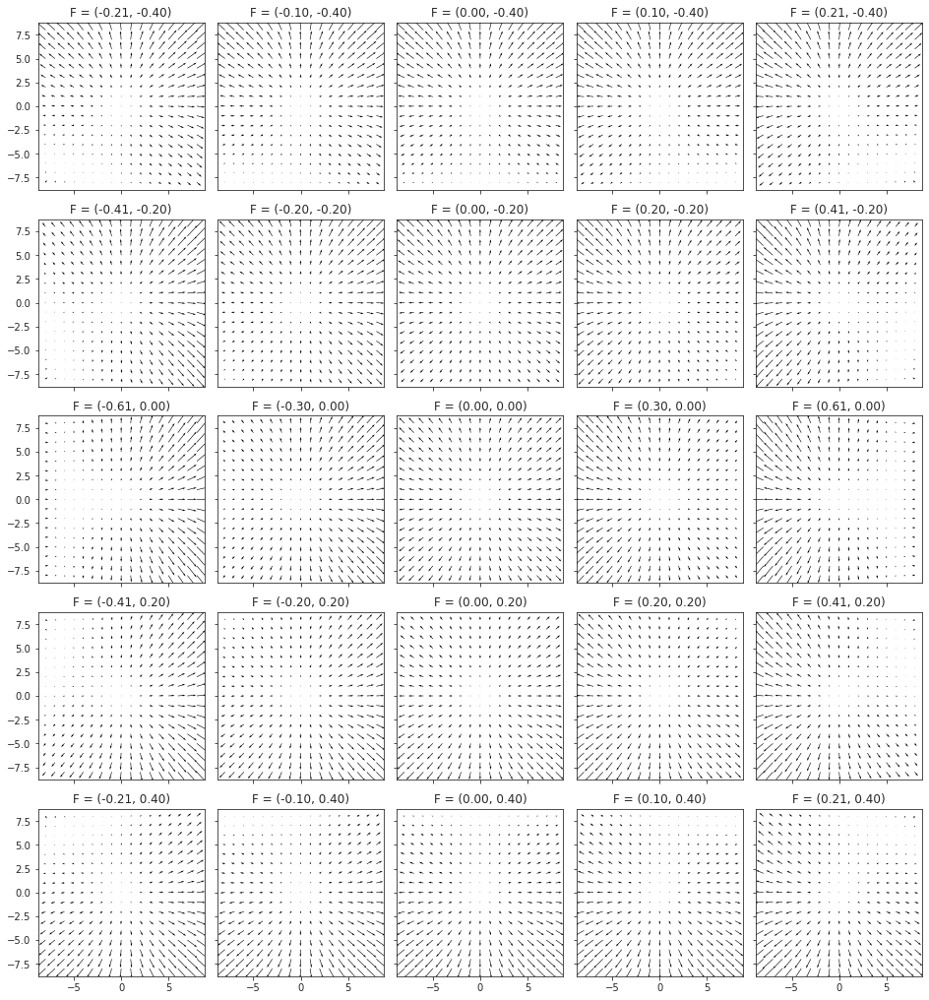

In [111]:
fig, axes = create_figure(nrows, ncols, (ncols * 2.6, nrows * 2.8), 'all', 'all', constrained_layout=True)
for i, j in itertools.product(range(nrows), range(ncols)):
    axes[i, j].quiver(
        range(-scale, scale + 1),
        range(-scale, scale + 1),
        v2p[i, j, ..., 0],
        v2p[i, j, ..., 1],
    )
    lbl = f"F = ({fix[i, j, 0]:0.2f}, {fix[i, j, 1]:0.2f})"
    axes[i, j].set_title(lbl)

### Y loop (with fixation Y)

In [112]:
nrows, ncols = 5, 5
ylim = 0.4
yspan = np.linspace(-ylim, ylim, nrows)
fix = np.zeros((nrows, 2))
fix[:, 1] = yspan
fix.shape

(5, 2)

In [113]:
vel_lim = 10
vel_span = np.linspace(-vel_lim, vel_lim, ncols)

vel = np.array([[0, 0, 10]]).T
vel = np.repeat(vel, ncols, axis=-1)
vel[1] = vel_span
vel.shape

(3, 5)

In [114]:
vel

array([[  0,   0,   0,   0,   0],
       [-10,  -5,   0,   5,  10],
       [ 10,  10,  10,  10,  10]])

In [115]:
of = OpticFlow(fov, res).compute_coords(fix)
alpha_dot = of.compute_flow(vel, obj_pos, obj_vel)
alpha_dot.shape

(5, 91, 91, 2, 5, 1)

In [116]:
scale = 8
k = 0
v2p = alpha_dot[..., k]
shape = v2p.shape
shape = [
    e if e != of.dim
    else 2 * scale + 1
    for e in shape
]
v2p = resize(v2p, shape)
v2p.shape

(5, 17, 17, 2, 5)

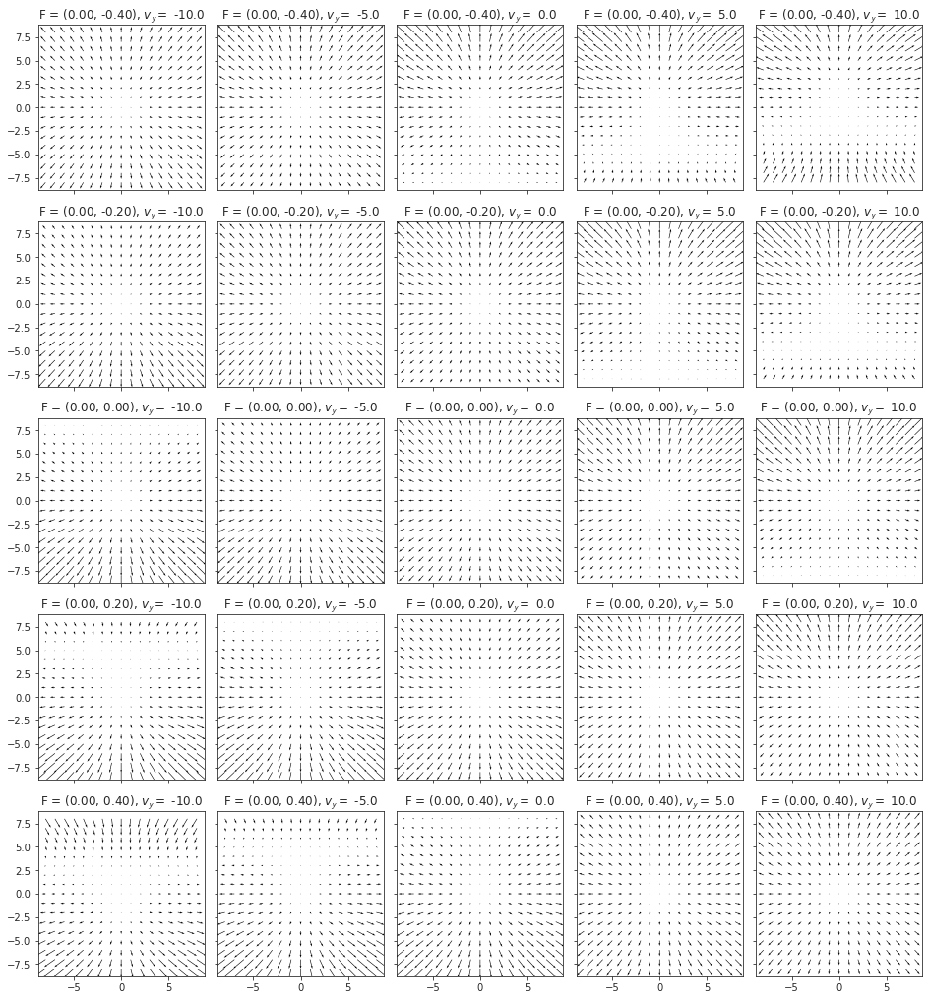

In [117]:
fig, axes = create_figure(nrows, ncols, (ncols * 2.6, nrows * 2.8), 'all', 'all', constrained_layout=True)
for i, j in itertools.product(range(nrows), range(ncols)):
    axes[i, j].quiver(
        range(-scale, scale + 1),
        range(-scale, scale + 1),
        v2p[i, ..., 0, j],
        v2p[i, ..., 1, j],
    )
    lbl = f"F = ({of.fix[i, 0]:0.2f}, {of.fix[i, 1]:0.2f}), "
    lbl += r"$v_\mathcal{y} = $" + f" {vel_span[j]}"
    axes[i, j].set_title(lbl)

## Add object

### Change position

In [156]:
nrows, ncols = 5, 5
lim = 0.4
span = np.linspace(-lim, lim, ncols)
pos = 0.7 * np.ones((nrows, ncols, 3))
for i, y in enumerate(span):
    for j, x in enumerate(span):
        pos[i, j, 0] = x
        pos[i, j, 1] = y
pos.shape

(5, 5, 3)

In [157]:
vel = np.array([[0, 0, 10]]).T
obj_pos = flatten_arr(pos).T
obj_vel = np.array([[9, 4, 0]]).T
obj_vel = np.repeat(obj_vel, nrows * ncols, -1)
obj_vel.shape

(3, 25)

In [159]:
fix = (0, 0)
of = OpticFlow(fov, res).compute_coords(fix)
alpha_dot = of.compute_flow(vel, obj_pos, obj_vel)
alpha_dot.shape

(1, 91, 91, 2, 1, 25)

In [160]:
scale = 8
i, j = 0, 0
v2p = alpha_dot[i, ..., j, :]
v2p = v2p.reshape((of.dim, of.dim, 2, nrows, ncols))
shape = v2p.shape
shape = [
    e if e != of.dim
    else 2 * scale + 1
    for e in shape
]
v2p = resize(v2p, shape)
v2p.shape

(17, 17, 2, 5, 5)

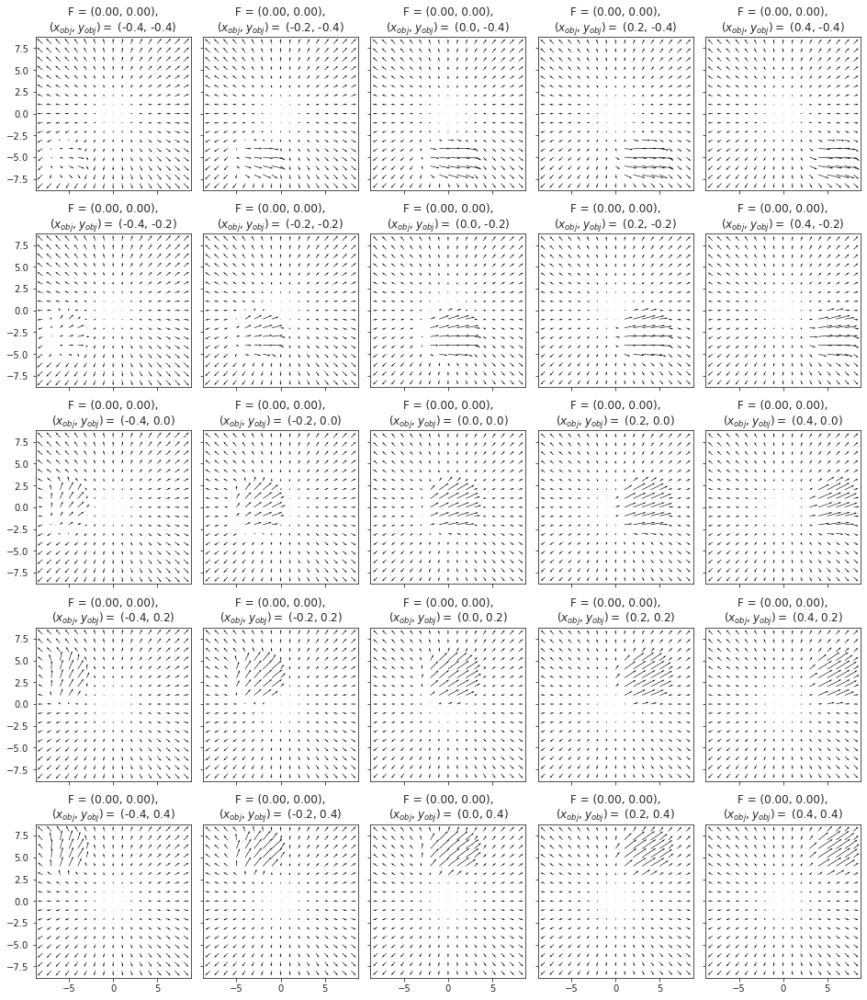

In [161]:
fig, axes = create_figure(nrows, ncols, (ncols * 2.6, nrows * 3), 'all', 'all', constrained_layout=True)
for i, j in itertools.product(range(nrows), range(ncols)):
    axes[i, j].quiver(
        range(-scale, scale + 1),
        range(-scale, scale + 1),
        v2p[..., 0, i, j],
        v2p[..., 1, i, j],
    )
    lbl = f"F = ({of.fix[0, 0]:0.2f}, {of.fix[0, 1]:0.2f}),\n"
    lbl += r"$(x_{obj}, y_{obj}) = $" + f" ({pos[i, j, 0]:0.1f}, {pos[i, j, 1]:0.1f})"
    axes[i, j].set_title(lbl)

### Change z-depth, and magnitude

In [196]:
vel = np.array([[0, 0, 10]]).T

obj_pos = np.zeros((3, 5))
obj_pos[0] = -0.2
obj_pos[2] = [1, 0.8, 0.6, 0.4, 0.2]

obj_vel = np.array([[9, 4, 0]], dtype=float).T
obj_vel = np.repeat(obj_vel, ncols, -1)
obj_vel[:, 0] *= 0.4
obj_vel[:, 1] *= 0.7
obj_vel[:, 2] *= 1
obj_vel[:, 3] *= 1.5
obj_vel[:, 4] *= 2

obj_pos = np.repeat(np.expand_dims(obj_pos, -1), 5, -1)
obj_vel = np.repeat(np.expand_dims(obj_vel, -2), 5, -2)
obj_pos = flatten_arr(obj_pos, 0, 1)
obj_vel = flatten_arr(obj_vel, 0, 1)
obj_pos.shape, obj_vel.shape

((3, 25), (3, 25))

In [212]:
9 * 0.4, 4 * 0.4

(3.6, 1.6)

In [197]:
fix = (0, 0)
of = OpticFlow(fov, res).compute_coords(fix)
alpha_dot = of.compute_flow(vel, obj_pos, obj_vel)
alpha_dot.shape

(1, 91, 91, 2, 1, 25)

In [198]:
scale = 8
i, j = 0, 0
v2p = alpha_dot[i, ..., j, :]
v2p = v2p.reshape((of.dim, of.dim, 2, nrows, ncols))
shape = v2p.shape
shape = [
    e if e != of.dim
    else 2 * scale + 1
    for e in shape
]
v2p = resize(v2p, shape)
v2p.shape

(17, 17, 2, 5, 5)

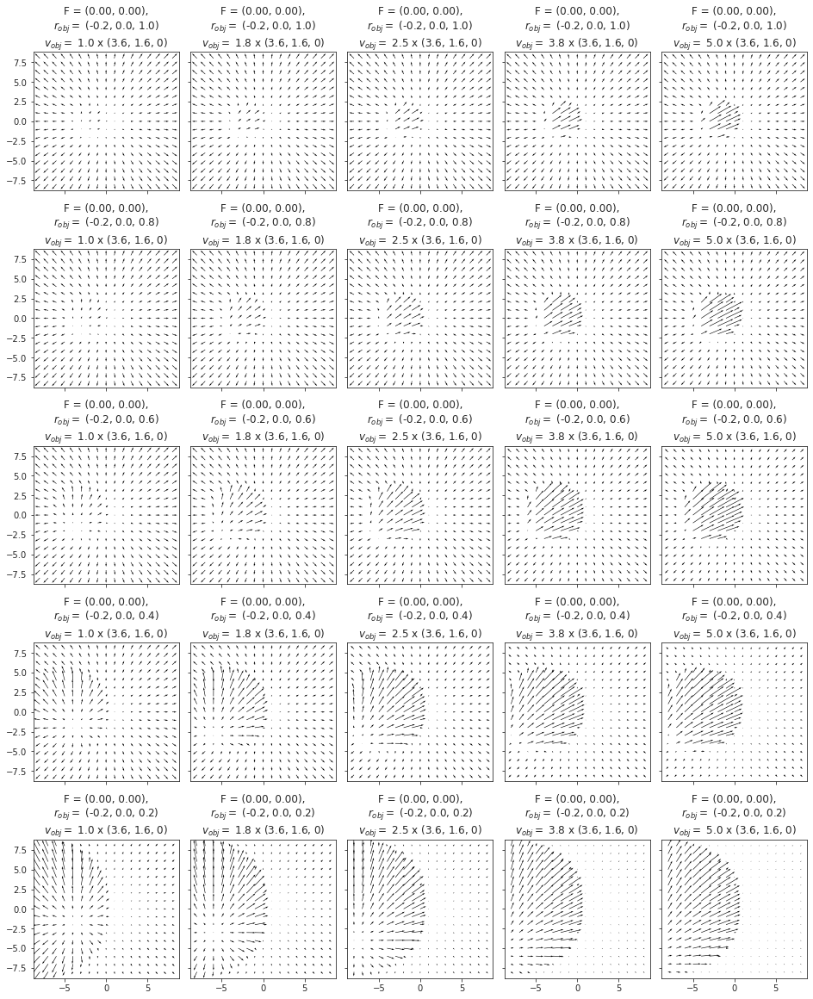

In [214]:
fig, axes = create_figure(nrows, ncols, (ncols * 2.6, nrows * 3.2), 'all', 'all', constrained_layout=True)
for i, j in itertools.product(range(nrows), range(ncols)):
    axes[i, j].quiver(
        range(-scale, scale + 1),
        range(-scale, scale + 1),
        v2p[..., 0, i, j],
        v2p[..., 1, i, j],
    )
    lbl = f"F = ({of.fix[0, 0]:0.2f}, {of.fix[0, 1]:0.2f}),\n"
    _x = obj_pos[0].reshape((5, 5))[i, j]
    _y = obj_pos[1].reshape((5, 5))[i, j]
    _z = obj_pos[2].reshape((5, 5))[i, j]
    lbl += r"$r_{obj} = $" + f" ({_x:0.1f}, {_y:0.1f}, {_z:0.1f})\n"
    _vx = obj_vel[0].reshape((5, 5))[i, j]
    lbl += r"$v_{obj} = $" + f" {_vx / 3.6:0.1f} x (3.6, 1.6, 0)"
    axes[i, j].set_title(lbl)

## Massive loop

In [230]:
fix = np.array([
    [0, 0],
    [0.4, 0],
    [0, 0.4],
    [0.4, 0.4],
    [-0.3, 0.6],
])
obj_pos = np.array([
    [-0.2, 0, 0.2],
    [-0.2, 0, 0.4],
    [-0.2, 0, 0.6],
    [-0.2, 0, 0.8],
    [-0.2, 0, 1.0],
    [-0.2, 0.2, 1.0],
    [0, 0, 0.2],
    [0, 0, 1.0],
    [0, 0, 0.2],
    [0, 0, 1.0],
]).T
obj_vel = np.array([
    [9.5, 4.7, 0],
    [9.5, 4.7, 0],
    [9.5, 4.7, 0],
    [9.5, 4.7, 0],
    [9.5, 4.7, 0],
    [9.5, 4.7, 0],
    [9.5, 4.7, 0],
    [9.5, 4.7, 0],
    [9.5, 4.7, 6],
    [9.5, 4.7, 6],
]).T
vel = np.array([
    [0, 0, 10],
    [0, 0, -10],
    [5, 5, 0],
    [1, -2, 0],
    [3, 0, 10],
    [3, 3, 1],
    [-2, 1, 5],
]).T
fix.shape, vel.shape, obj_pos.shape, obj_vel.shape

((5, 2), (3, 7), (3, 10), (3, 10))

In [231]:
%%time


of = OpticFlow(fov, res).compute_coords(fix)
alpha_dot = of.compute_flow(vel, obj_pos, obj_vel)
alpha_dot.shape

CPU times: user 630 ms, sys: 541 ms, total: 1.17 s
Wall time: 1.18 s


(5, 91, 91, 2, 7, 10)

<<< idx, (i, j, k) = (0, 0, 0) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

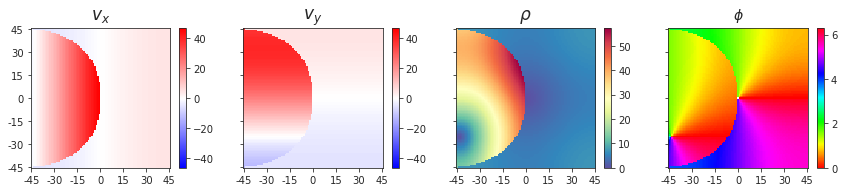

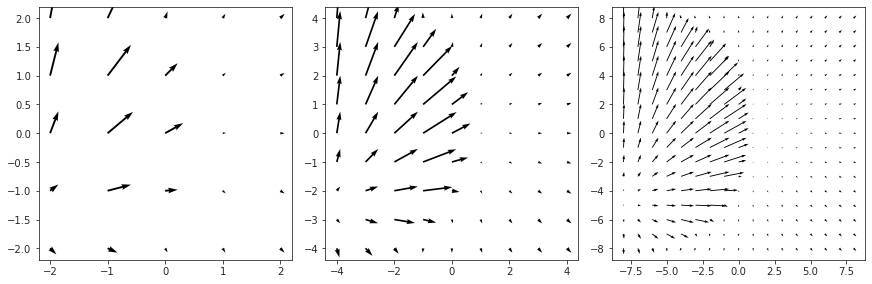

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 0, 1) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

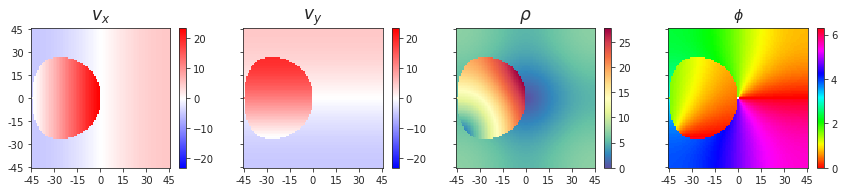

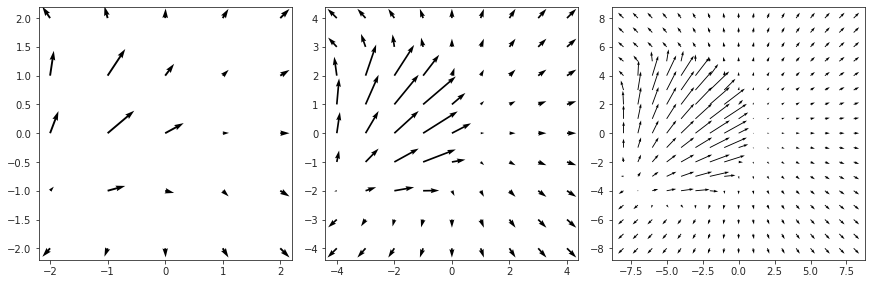

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 0, 2) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

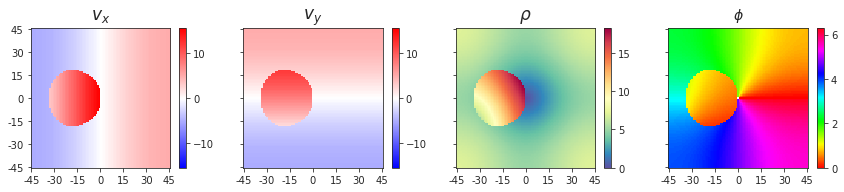

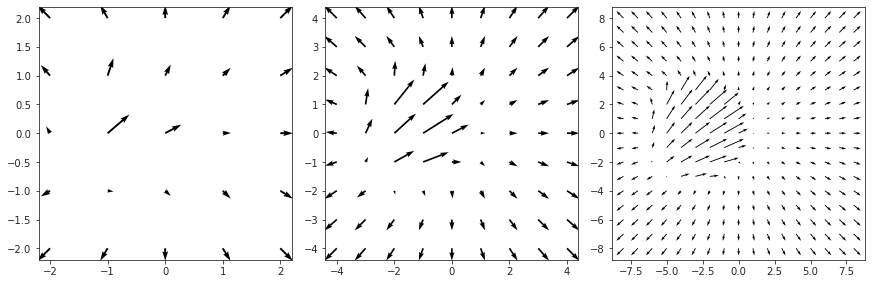

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 0, 3) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

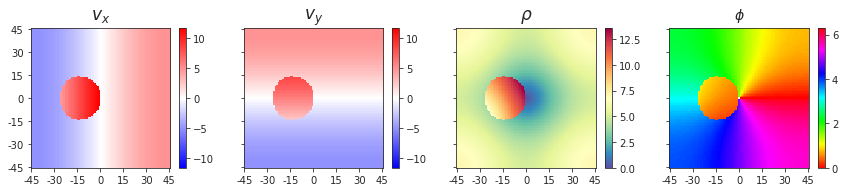

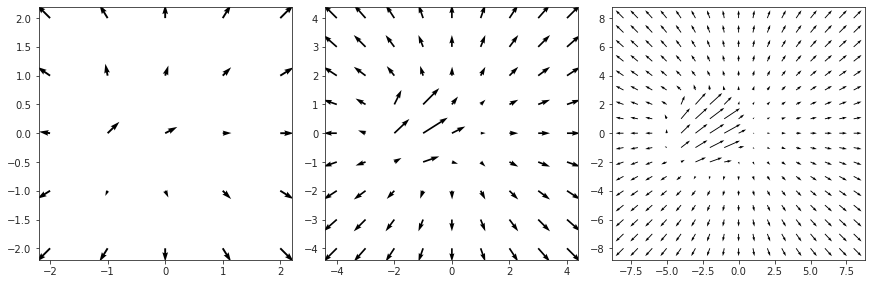

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 0, 4) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

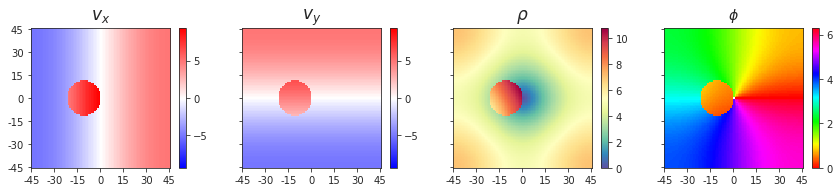

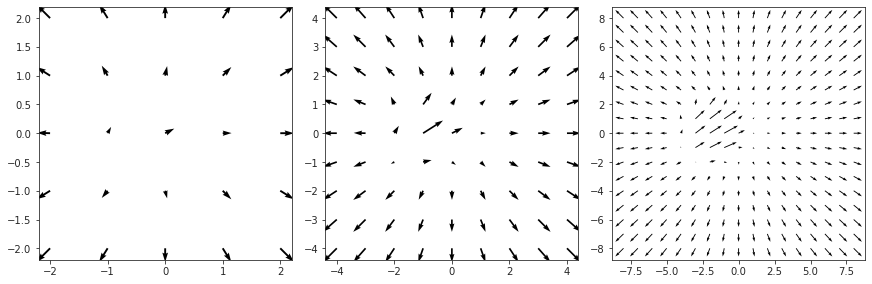

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 0, 5) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

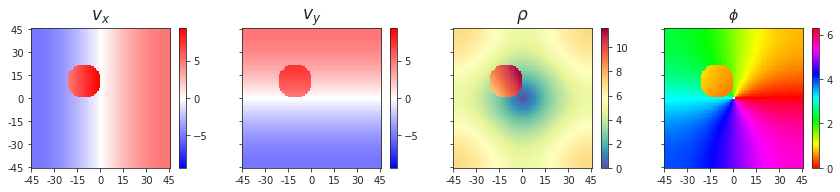

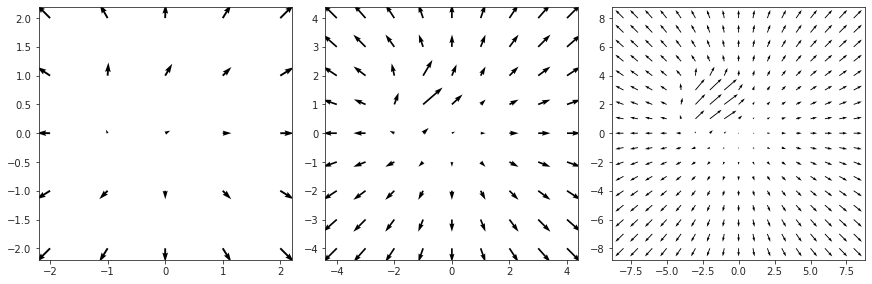

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 0, 6) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 0  0 10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

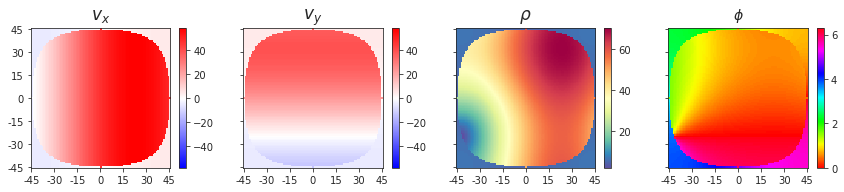

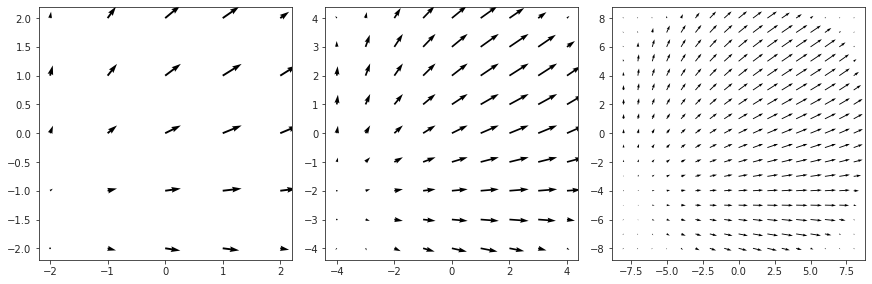

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 0, 7) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 0  0 10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

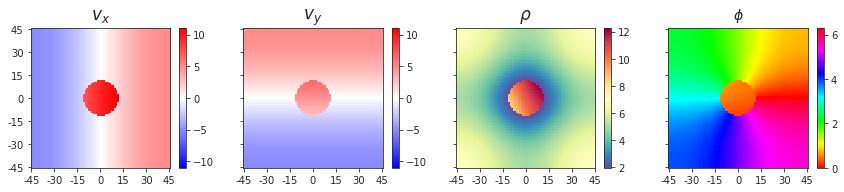

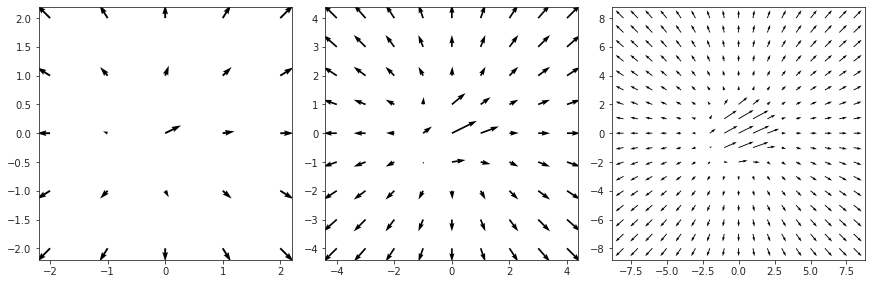

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 0, 8) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 0  0 10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

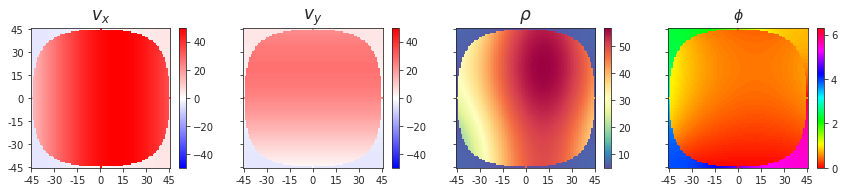

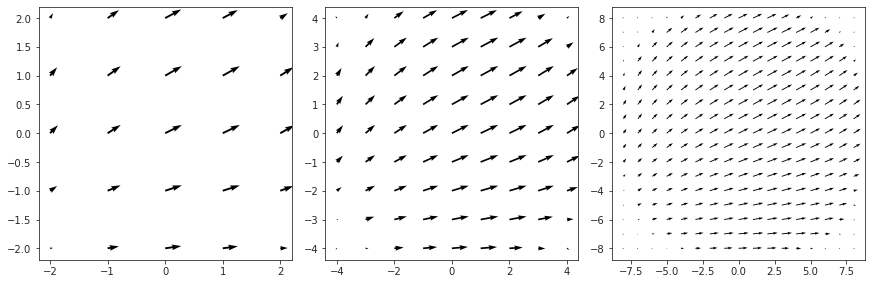

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 0, 9) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 0  0 10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

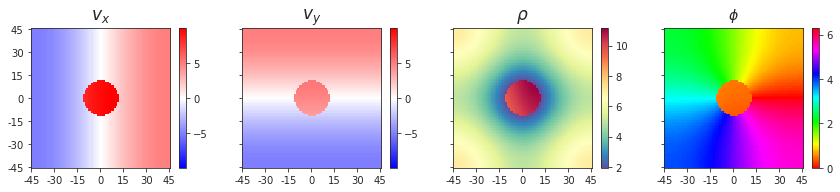

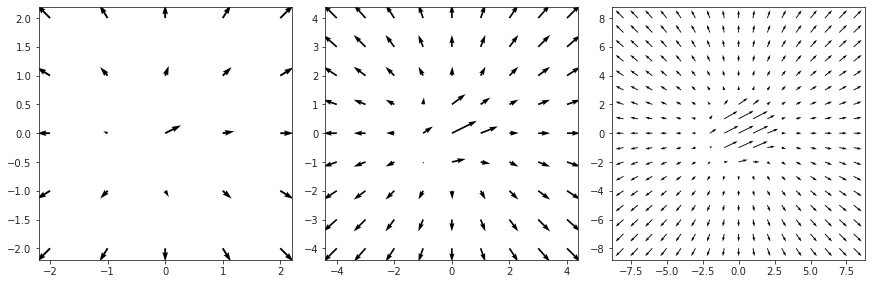

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 1, 0) >>>
self . . . fixation: [0. 0. 1.],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

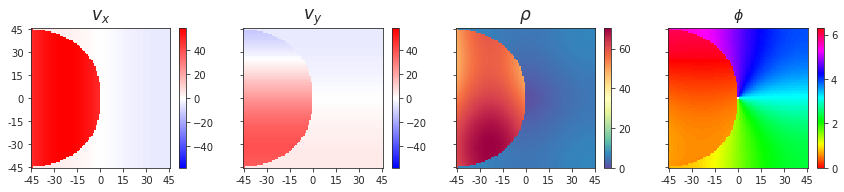

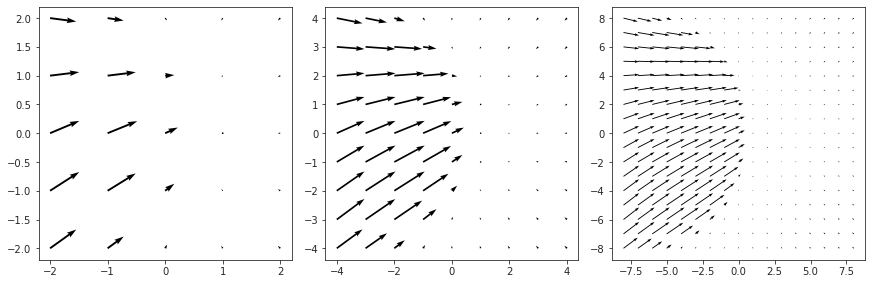

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 1, 1) >>>
self . . . fixation: [0. 0. 1.],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

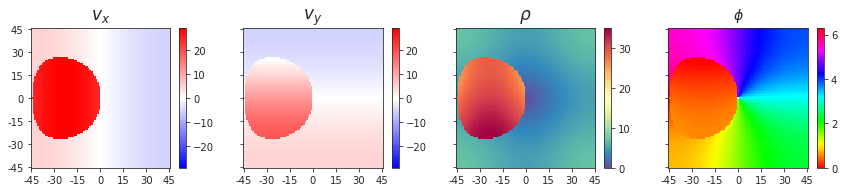

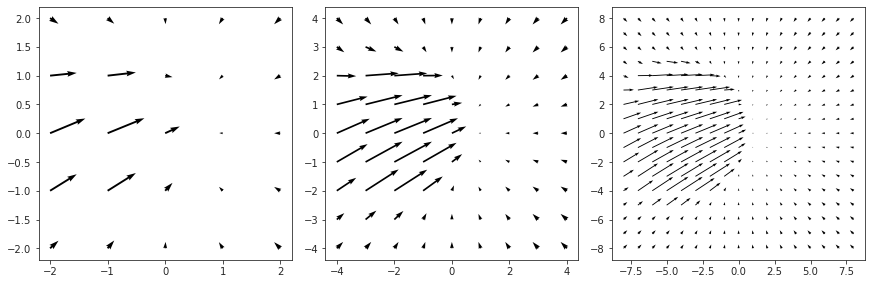

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 1, 2) >>>
self . . . fixation: [0. 0. 1.],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

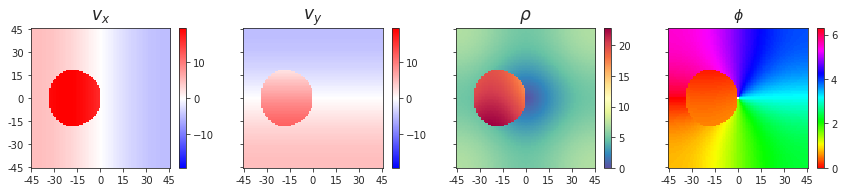

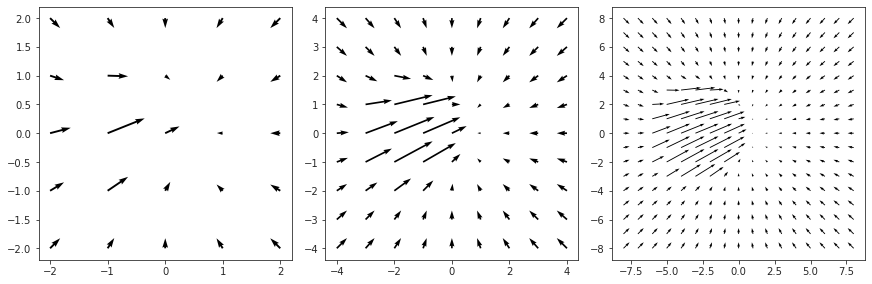

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 1, 3) >>>
self . . . fixation: [0. 0. 1.],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

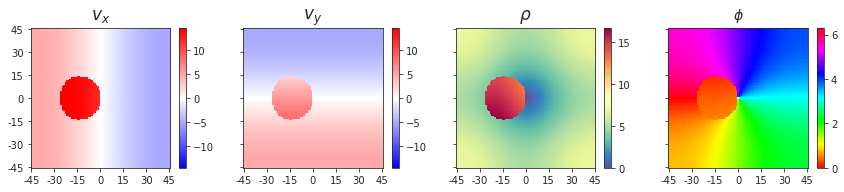

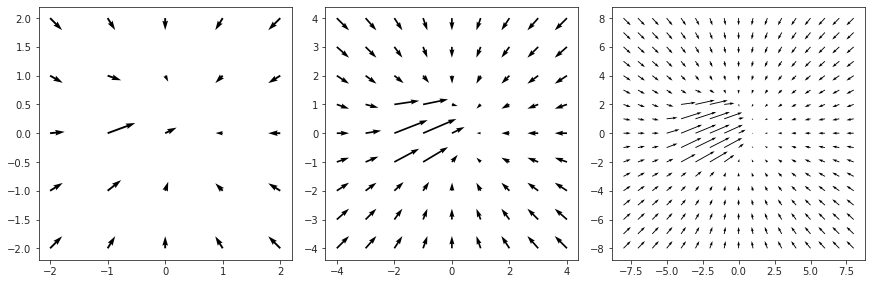

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 1, 4) >>>
self . . . fixation: [0. 0. 1.],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

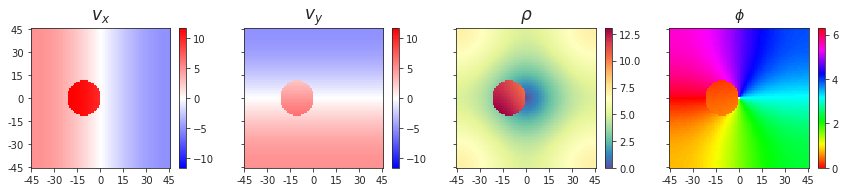

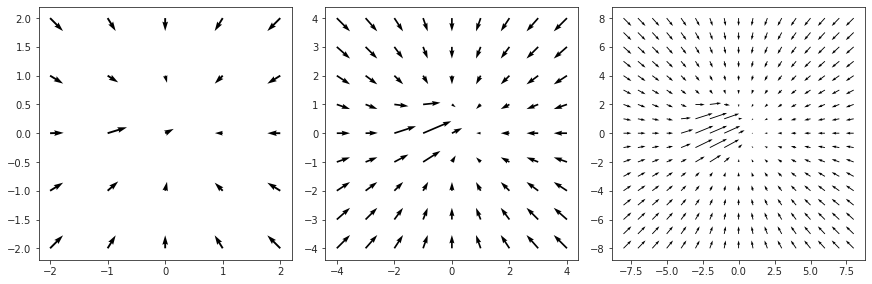

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 1, 5) >>>
self . . . fixation: [0. 0. 1.],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

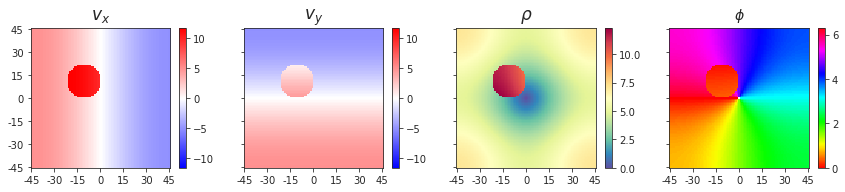

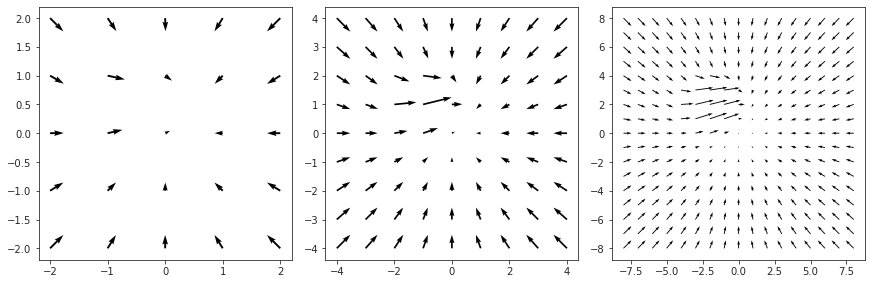

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 1, 6) >>>
self . . . fixation: [0. 0. 1.],  v_self: [  0   0 -10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

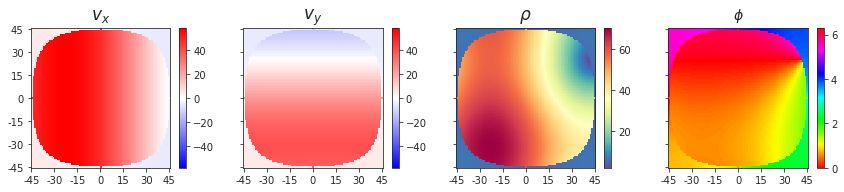

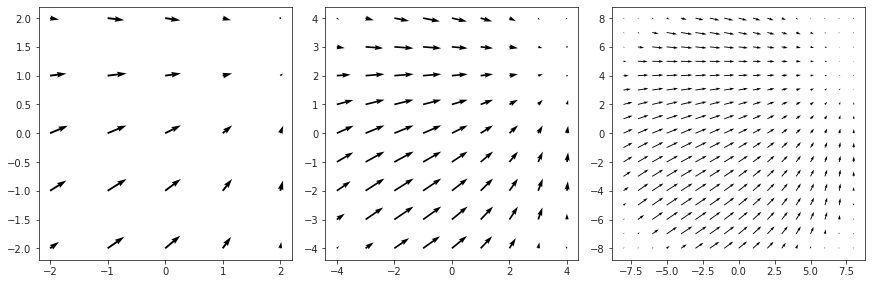

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 1, 7) >>>
self . . . fixation: [0. 0. 1.],  v_self: [  0   0 -10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

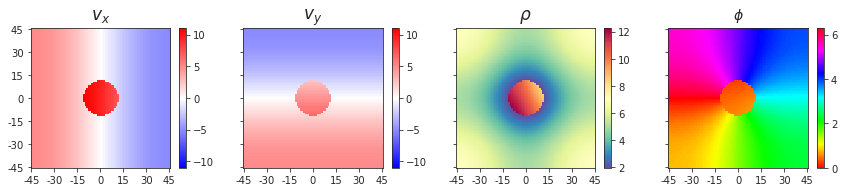

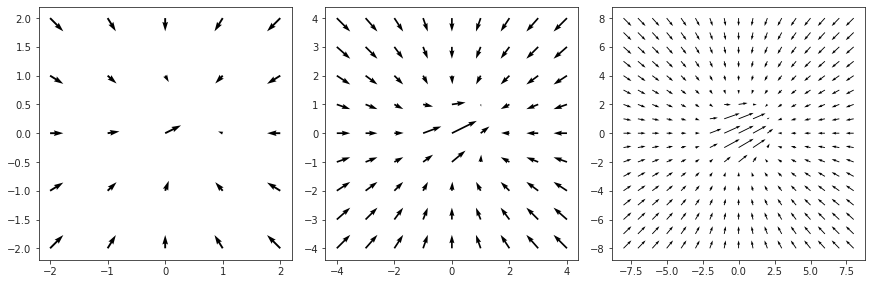

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 1, 8) >>>
self . . . fixation: [0. 0. 1.],  v_self: [  0   0 -10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

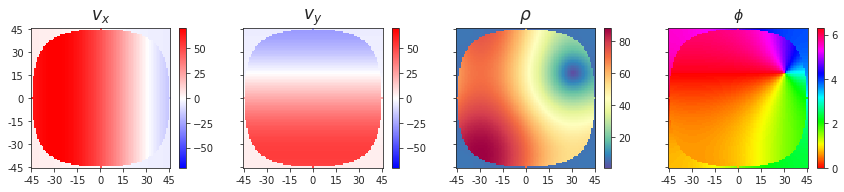

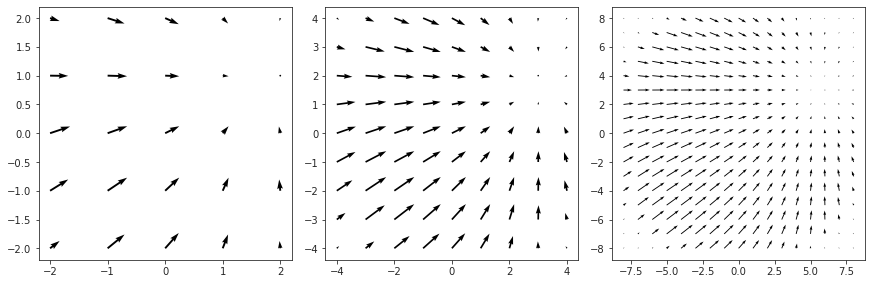

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 1, 9) >>>
self . . . fixation: [0. 0. 1.],  v_self: [  0   0 -10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

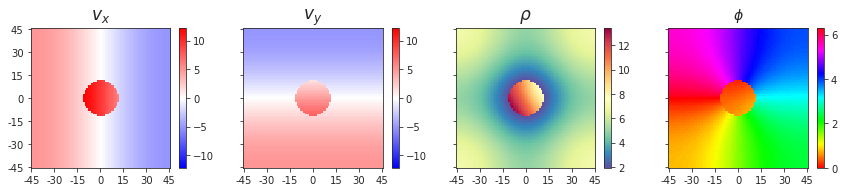

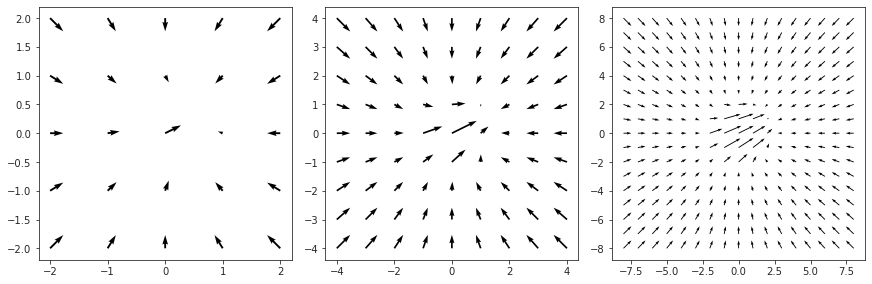

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 2, 0) >>>
self . . . fixation: [0. 0. 1.],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

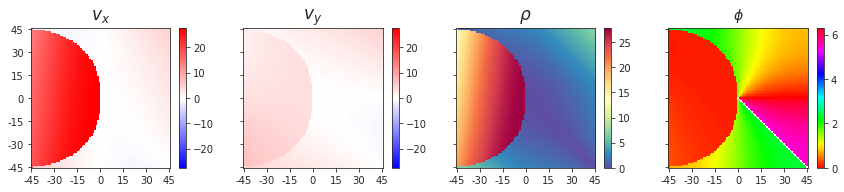

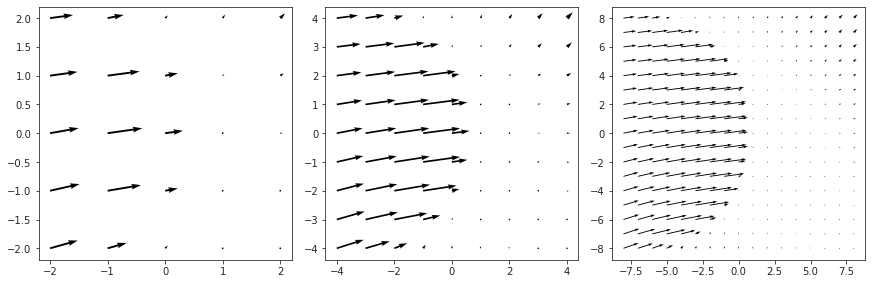

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 2, 1) >>>
self . . . fixation: [0. 0. 1.],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

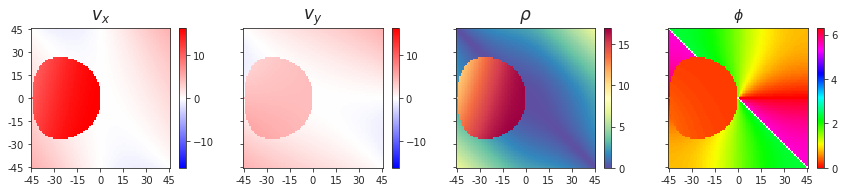

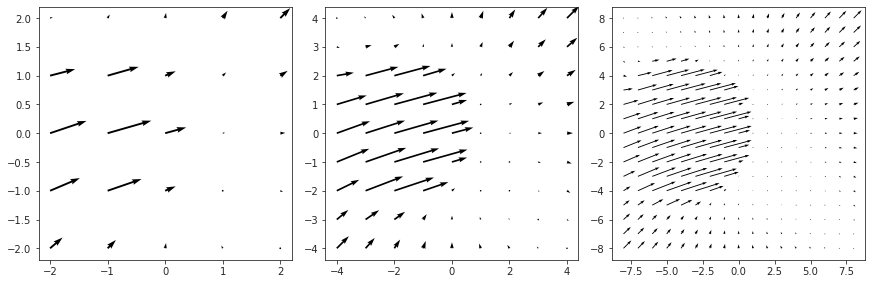

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 2, 2) >>>
self . . . fixation: [0. 0. 1.],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

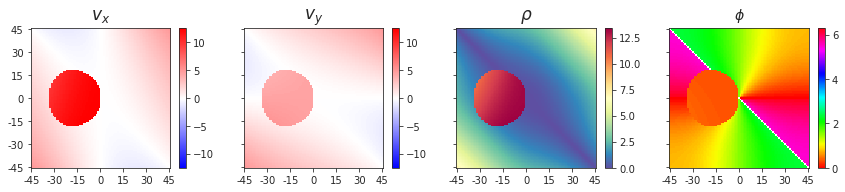

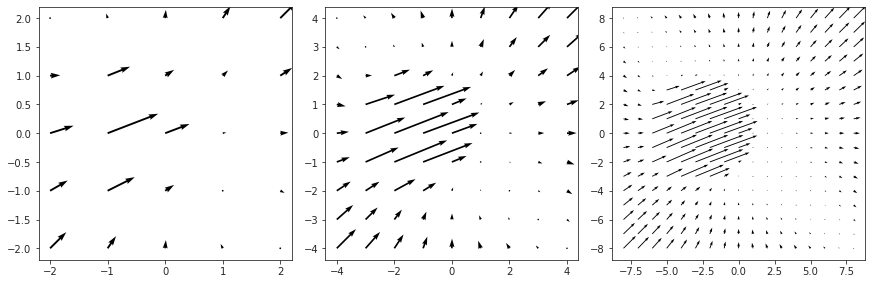

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 2, 3) >>>
self . . . fixation: [0. 0. 1.],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

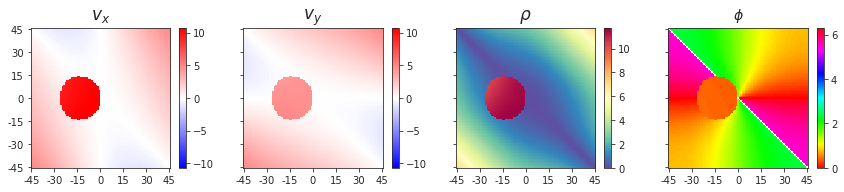

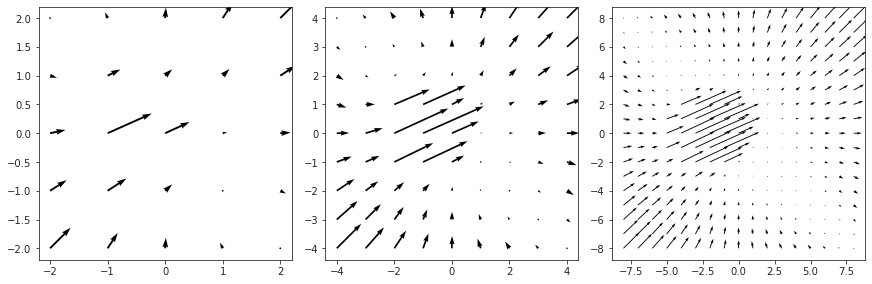

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 2, 4) >>>
self . . . fixation: [0. 0. 1.],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

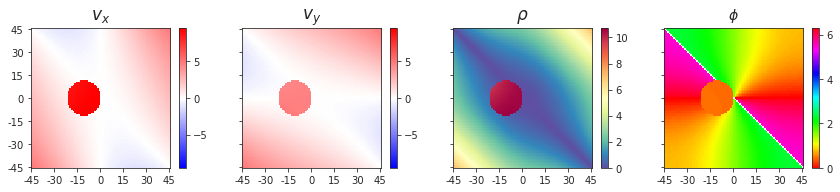

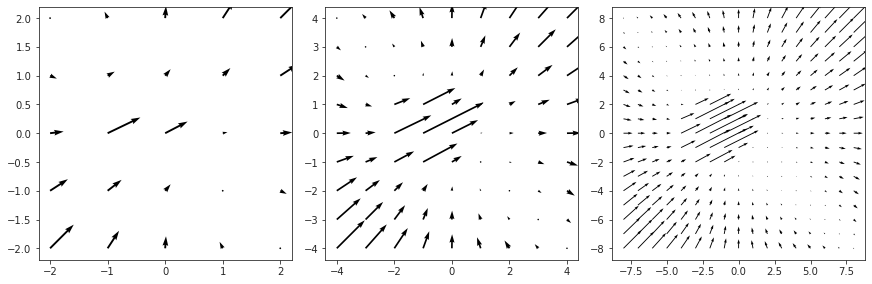

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 2, 5) >>>
self . . . fixation: [0. 0. 1.],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

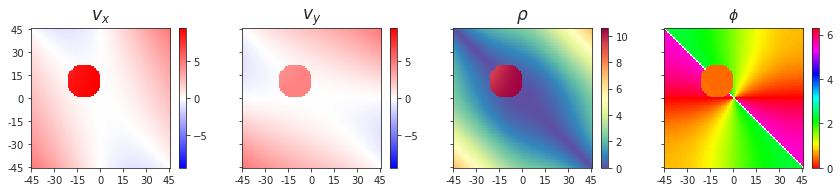

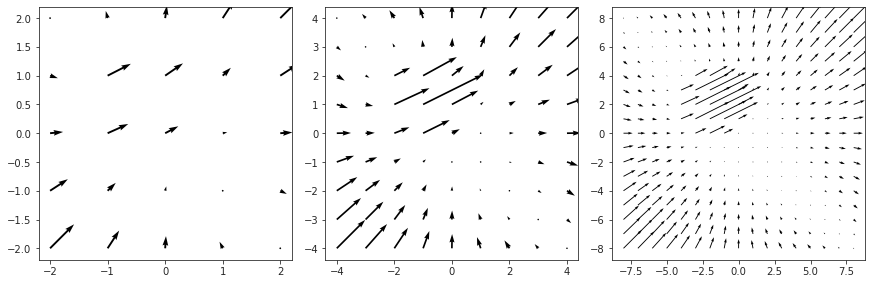

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 2, 6) >>>
self . . . fixation: [0. 0. 1.],  v_self: [5 5 0]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

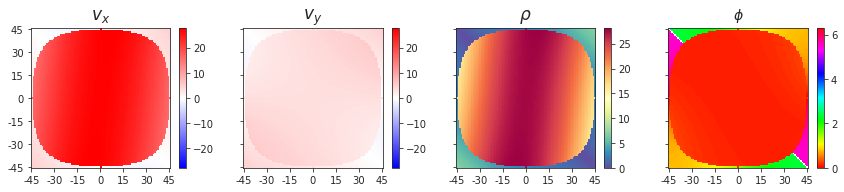

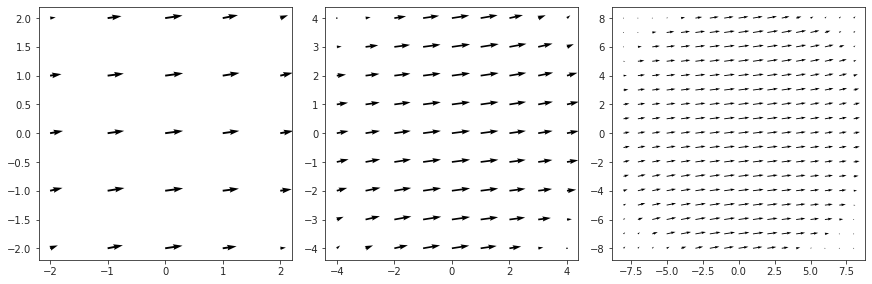

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 2, 7) >>>
self . . . fixation: [0. 0. 1.],  v_self: [5 5 0]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

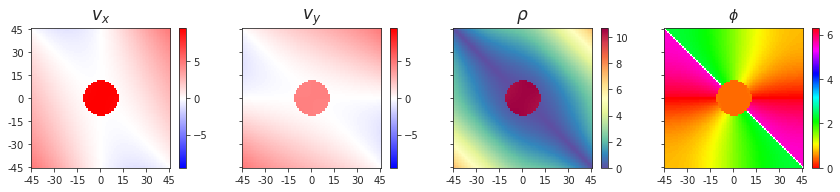

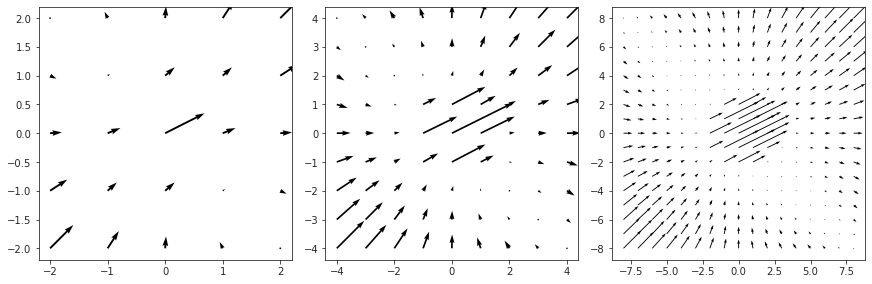

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 2, 8) >>>
self . . . fixation: [0. 0. 1.],  v_self: [5 5 0]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

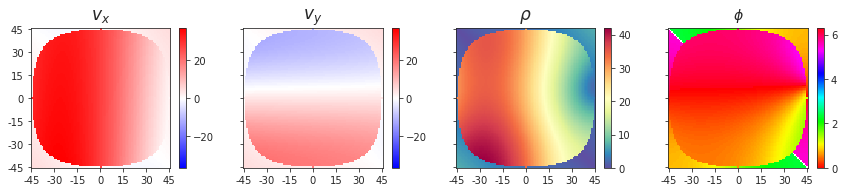

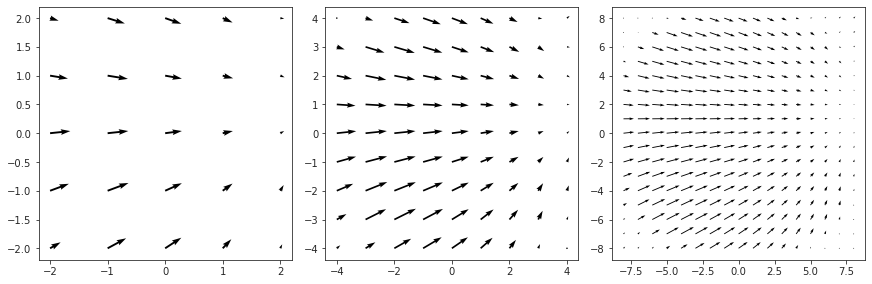

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 2, 9) >>>
self . . . fixation: [0. 0. 1.],  v_self: [5 5 0]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

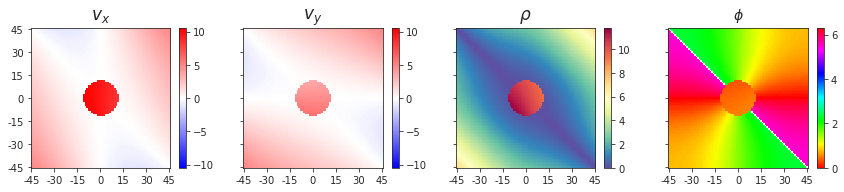

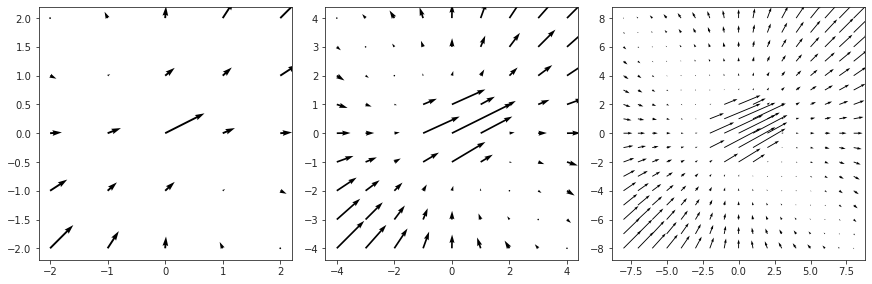

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 3, 0) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

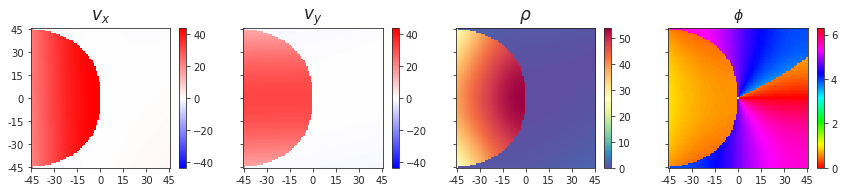

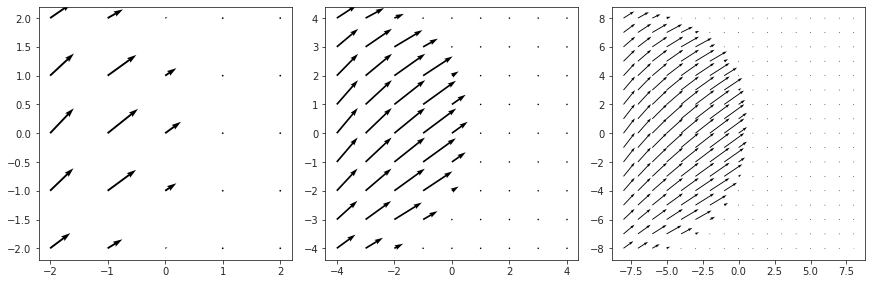

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 3, 1) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

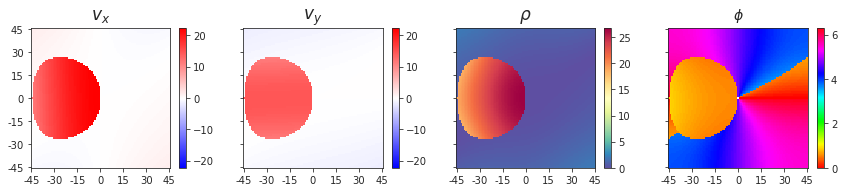

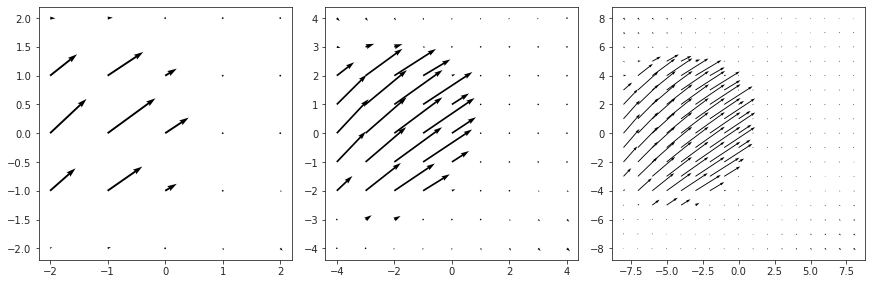

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 3, 2) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

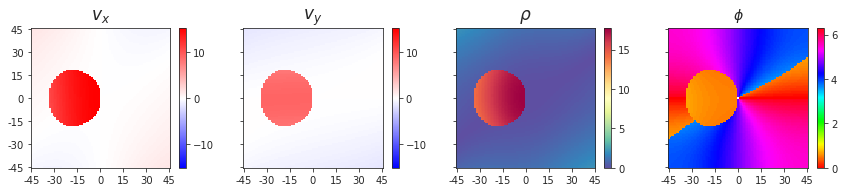

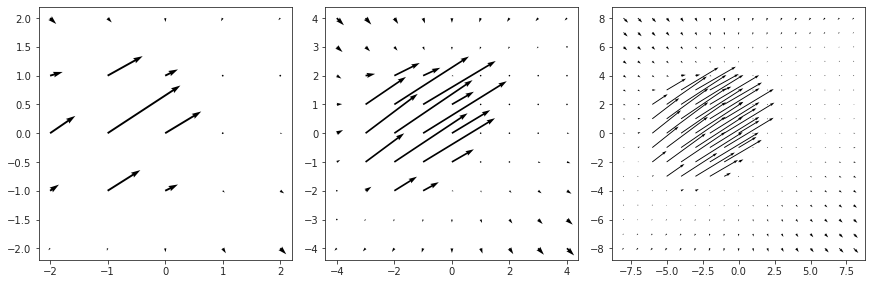

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 3, 3) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

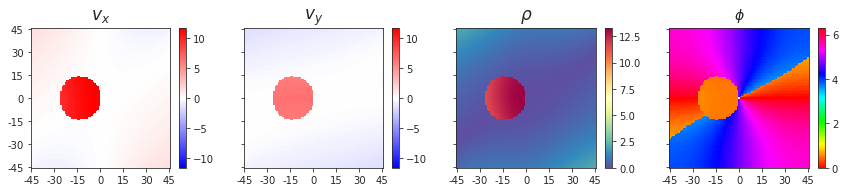

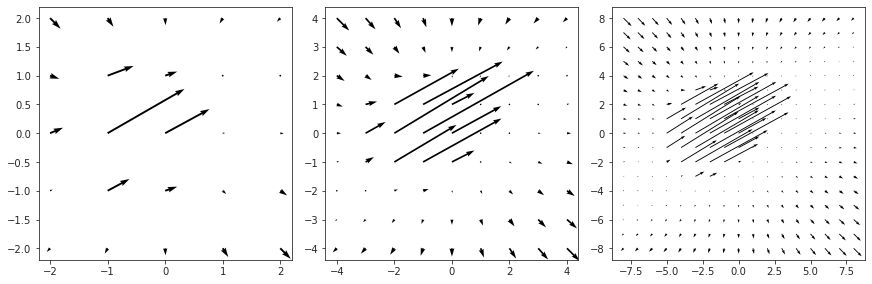

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 3, 4) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

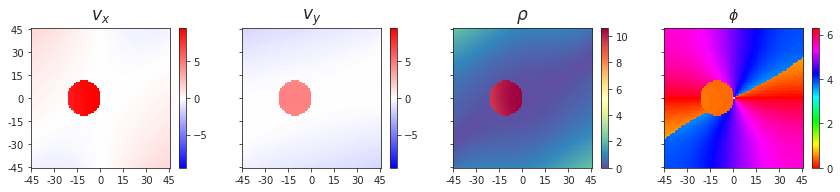

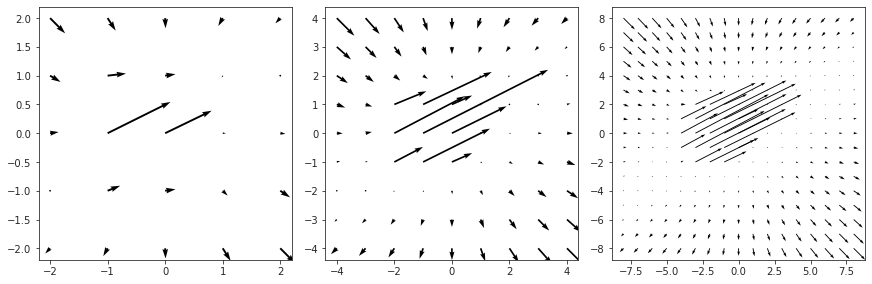

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 3, 5) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

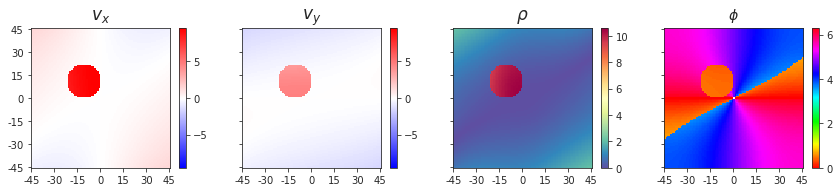

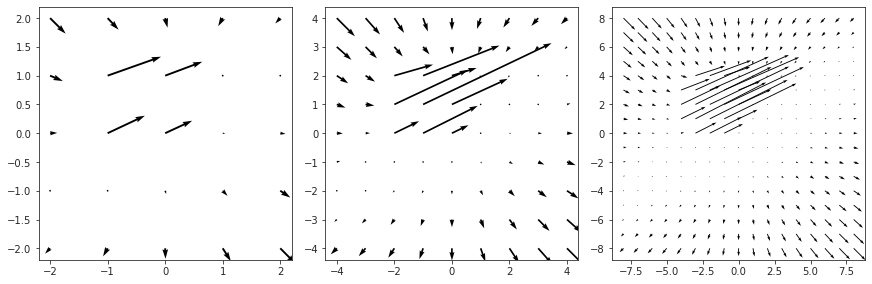

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 3, 6) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 1 -2  0]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

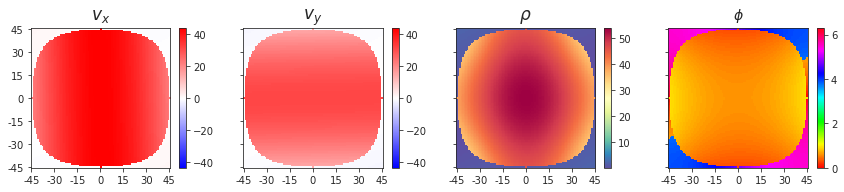

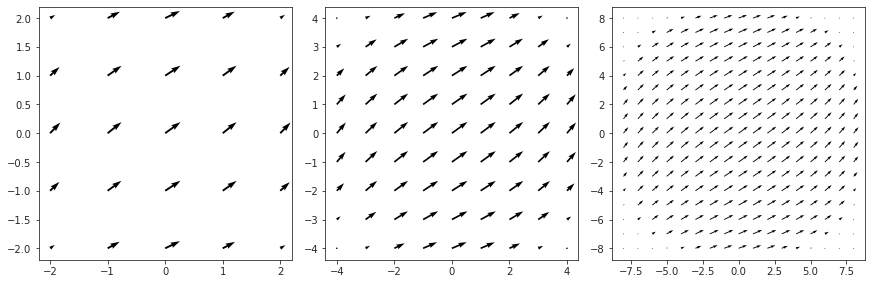

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 3, 7) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 1 -2  0]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

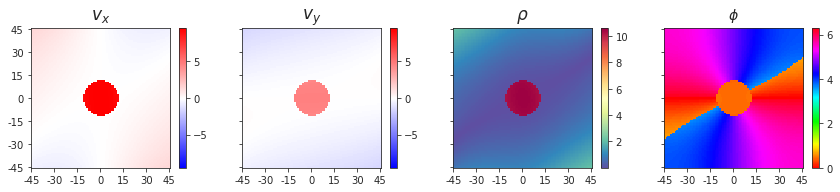

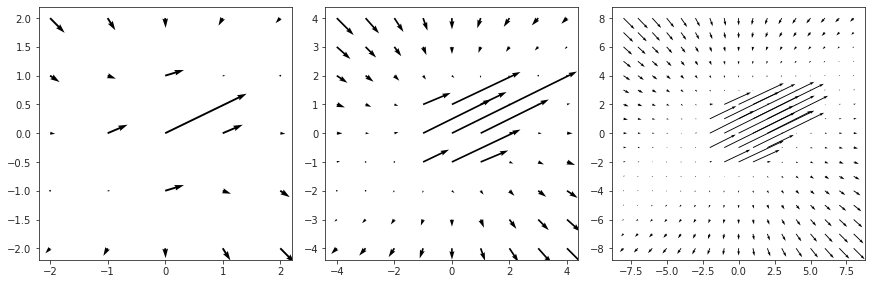

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 3, 8) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 1 -2  0]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

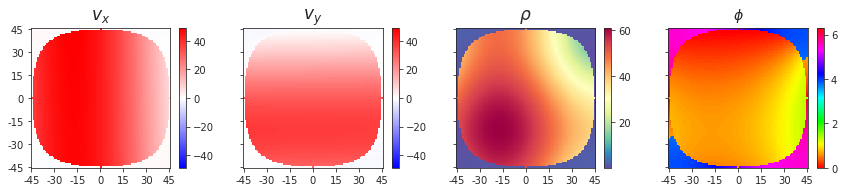

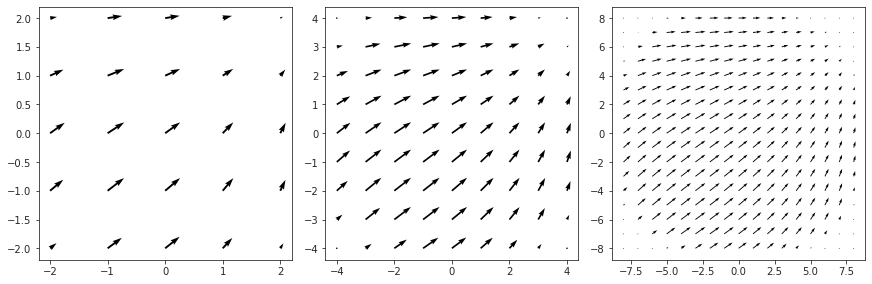

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 3, 9) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 1 -2  0]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

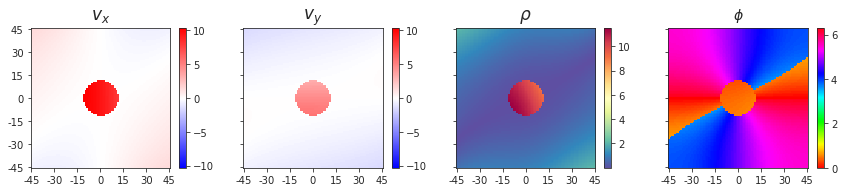

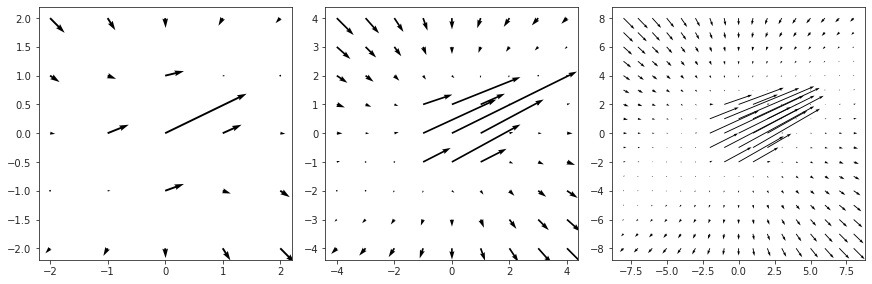

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 4, 0) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

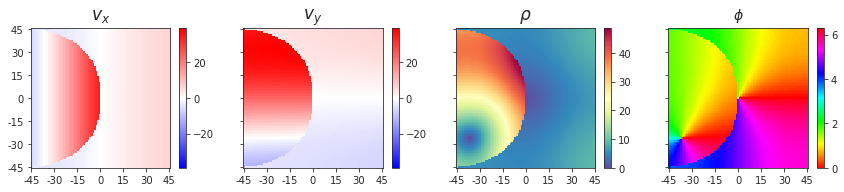

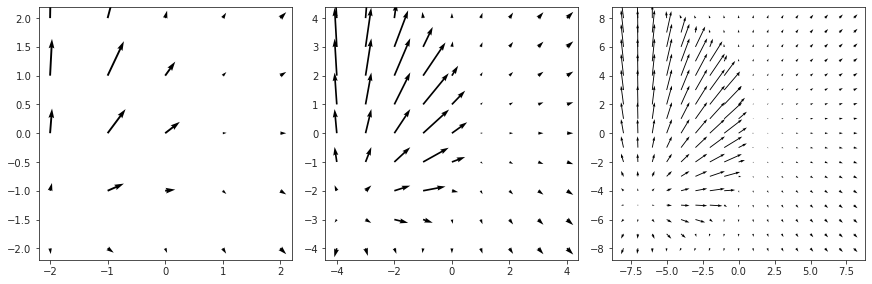

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 4, 1) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

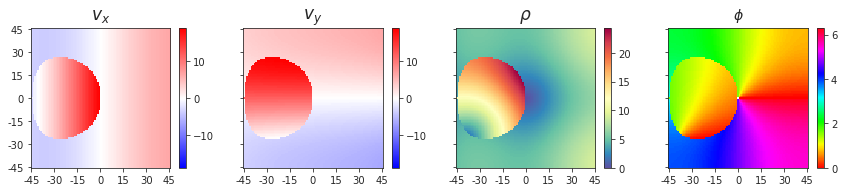

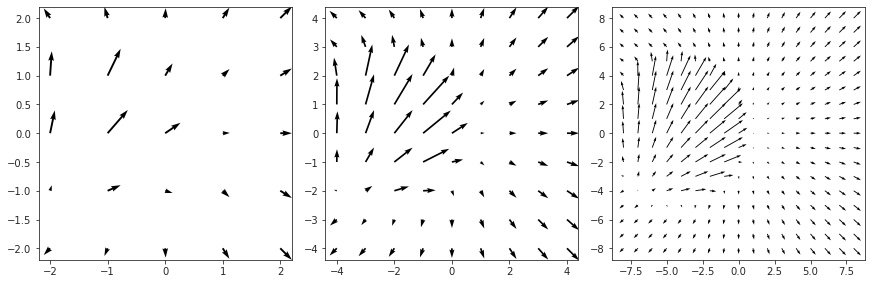

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 4, 2) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

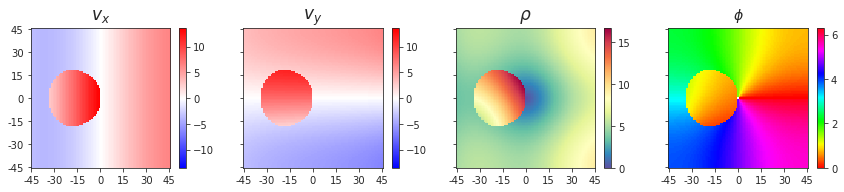

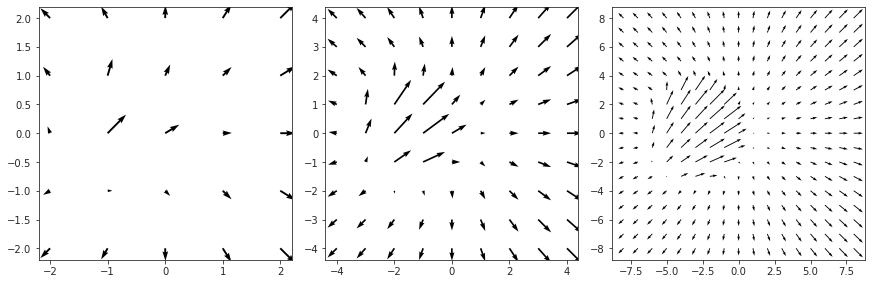

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 4, 3) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

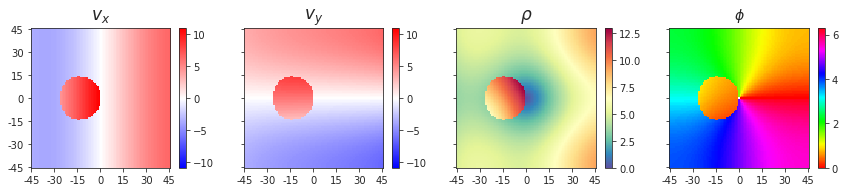

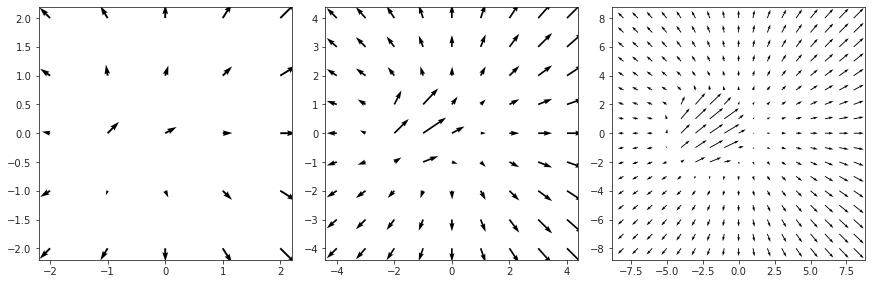

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 4, 4) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

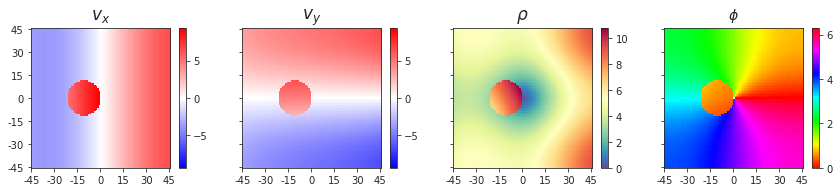

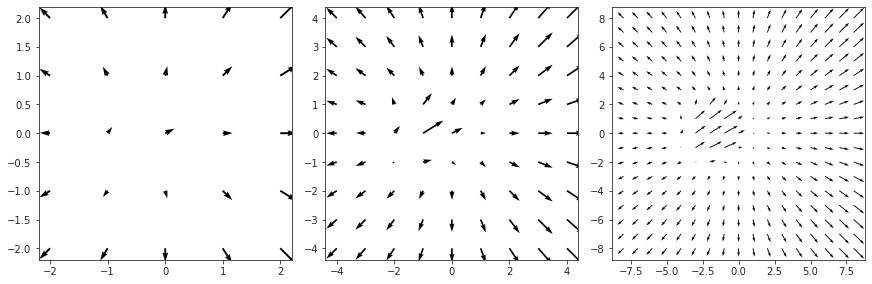

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 4, 5) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

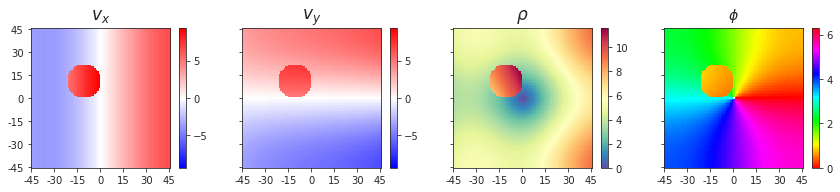

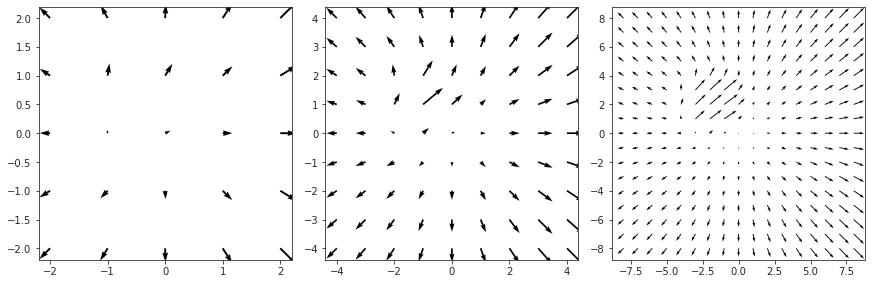

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 4, 6) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 3  0 10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

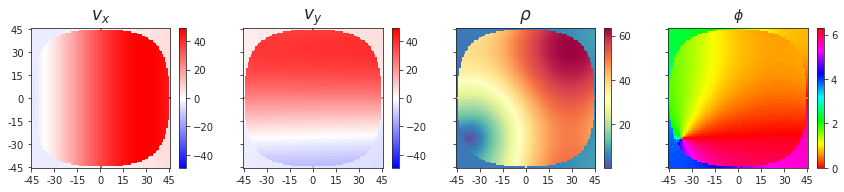

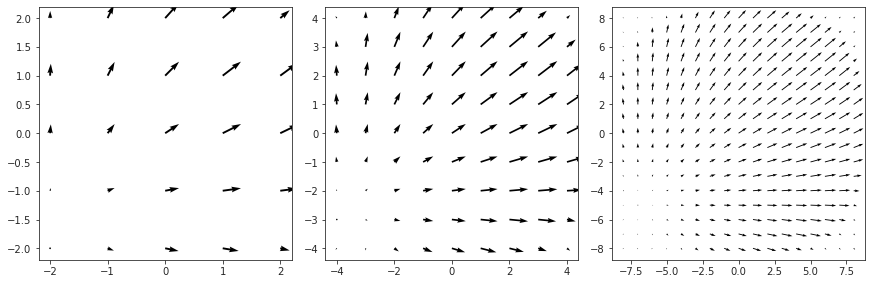

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 4, 7) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 3  0 10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

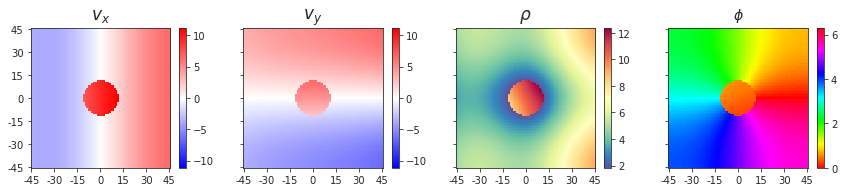

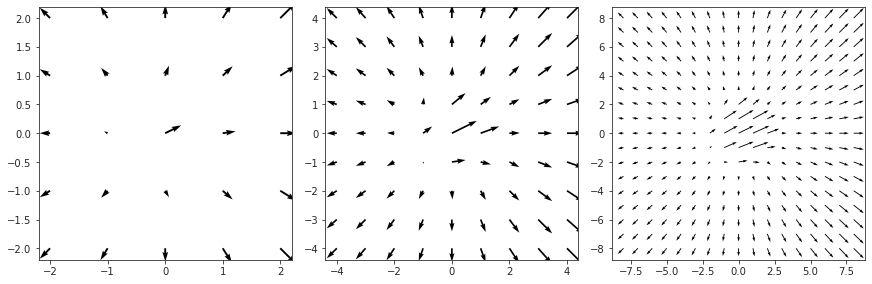

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 4, 8) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 3  0 10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

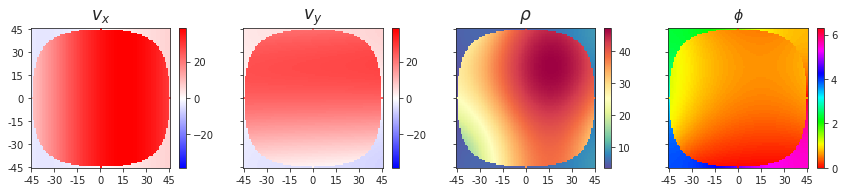

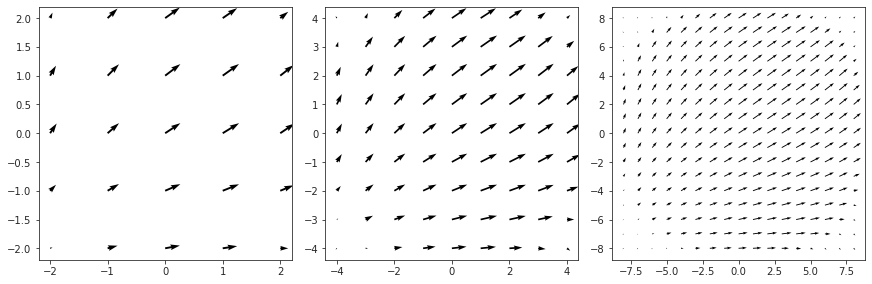

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 4, 9) >>>
self . . . fixation: [0. 0. 1.],  v_self: [ 3  0 10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

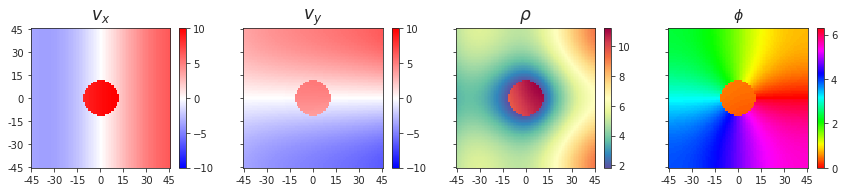

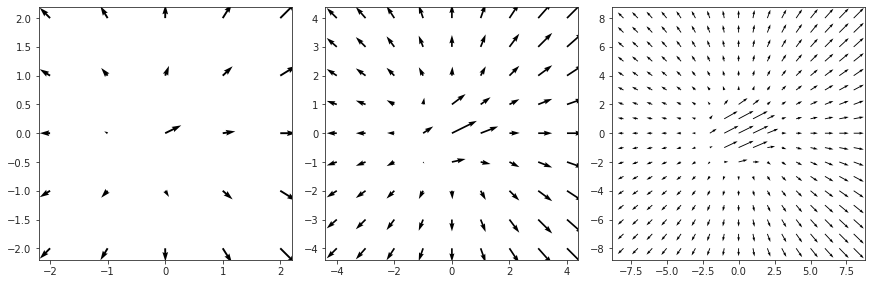

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 5, 0) >>>
self . . . fixation: [0. 0. 1.],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

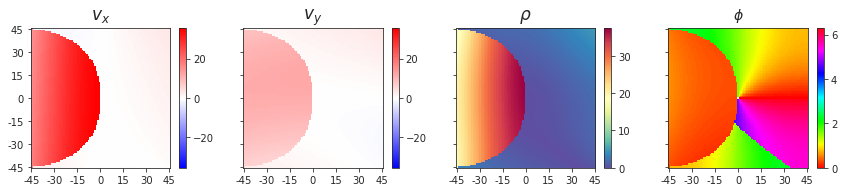

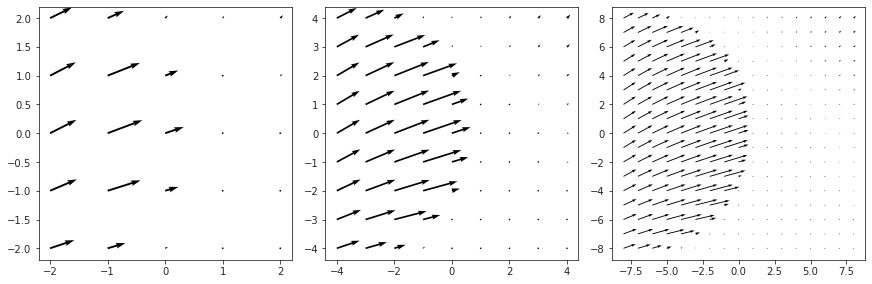

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 5, 1) >>>
self . . . fixation: [0. 0. 1.],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

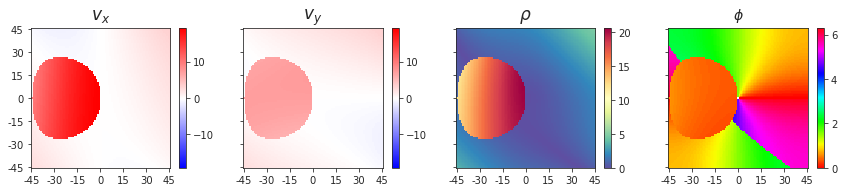

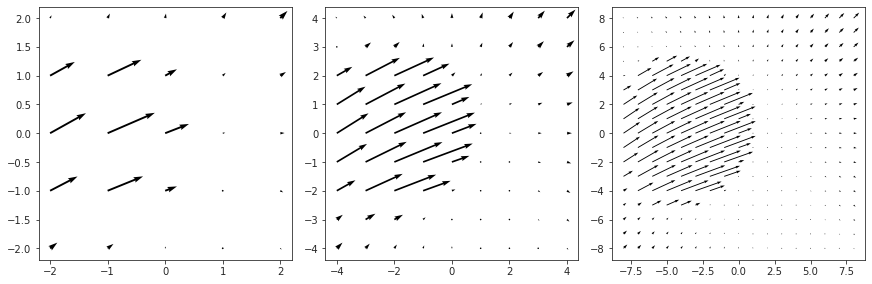

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 5, 2) >>>
self . . . fixation: [0. 0. 1.],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

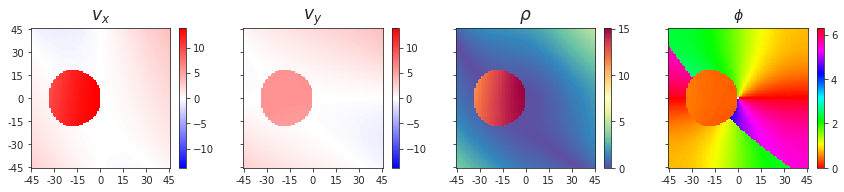

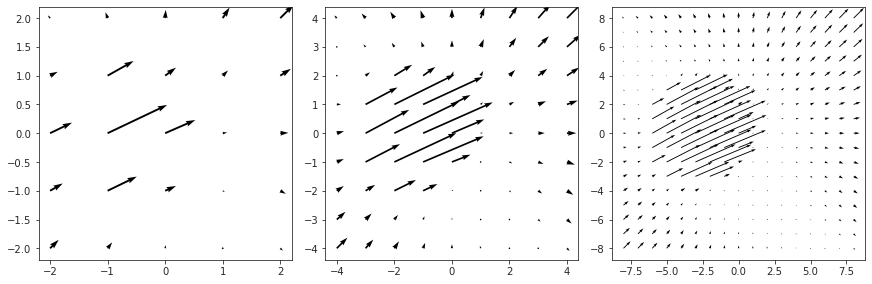

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 5, 3) >>>
self . . . fixation: [0. 0. 1.],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

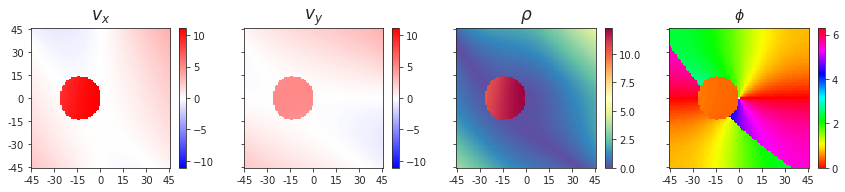

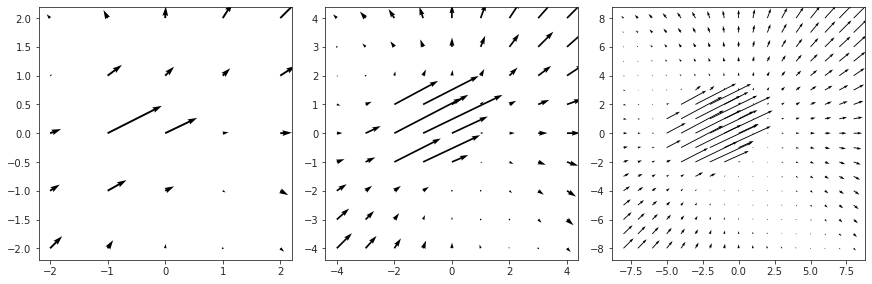

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 5, 4) >>>
self . . . fixation: [0. 0. 1.],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

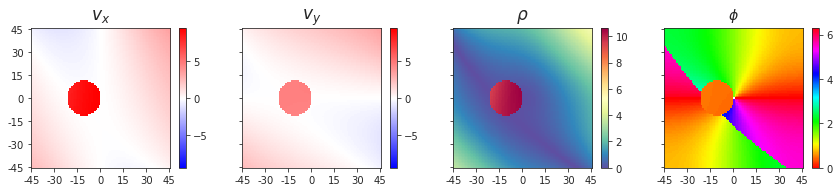

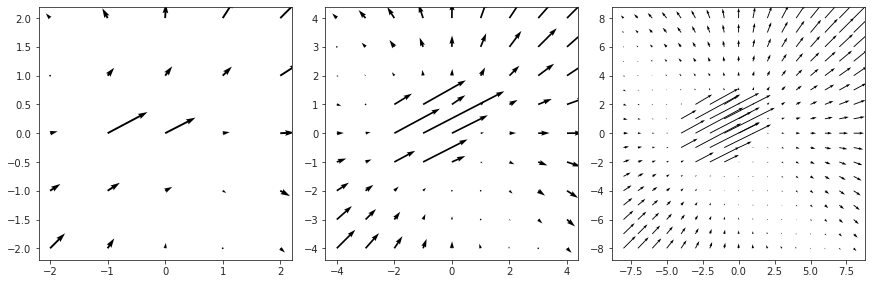

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 5, 5) >>>
self . . . fixation: [0. 0. 1.],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

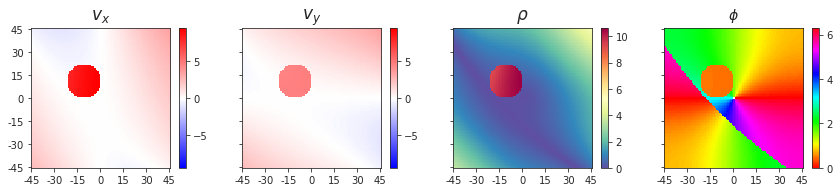

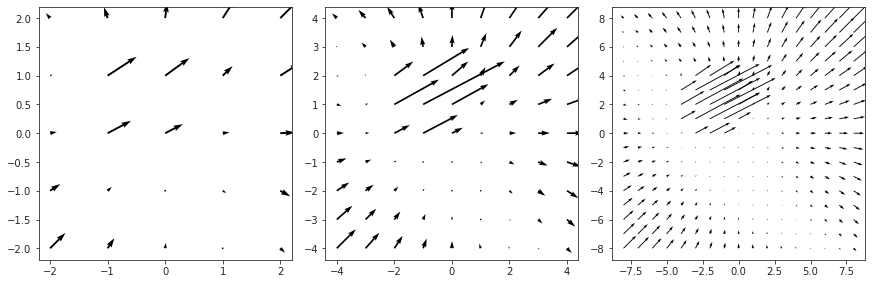

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 5, 6) >>>
self . . . fixation: [0. 0. 1.],  v_self: [3 3 1]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

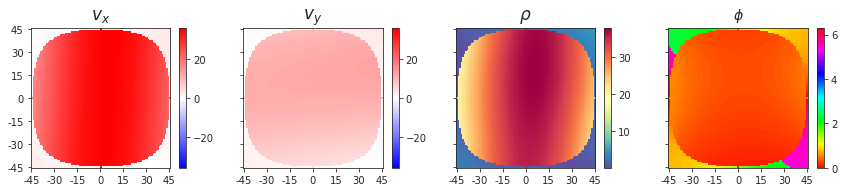

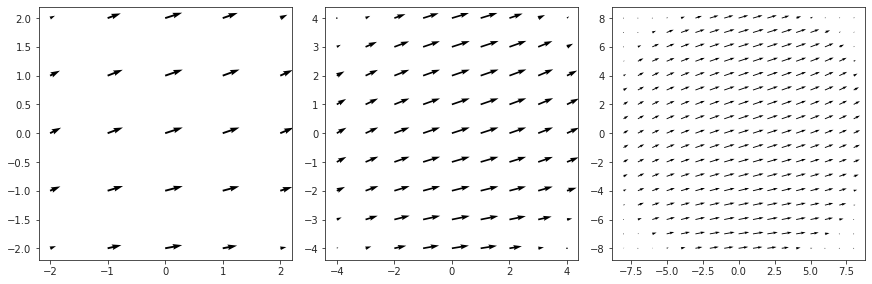

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 5, 7) >>>
self . . . fixation: [0. 0. 1.],  v_self: [3 3 1]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

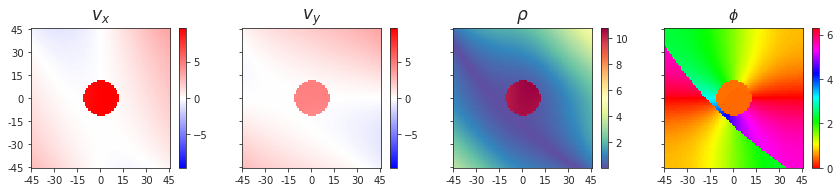

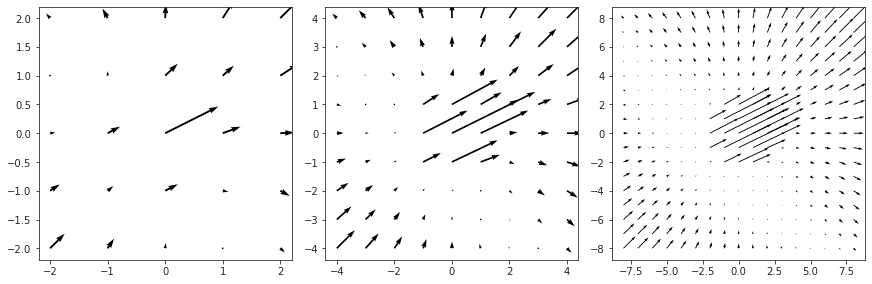

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 5, 8) >>>
self . . . fixation: [0. 0. 1.],  v_self: [3 3 1]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

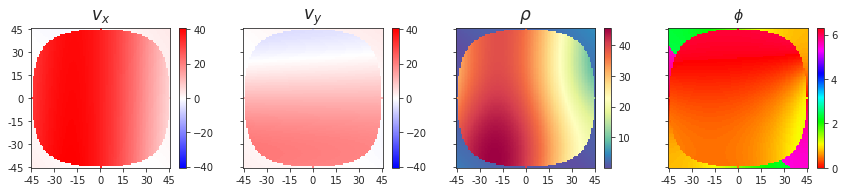

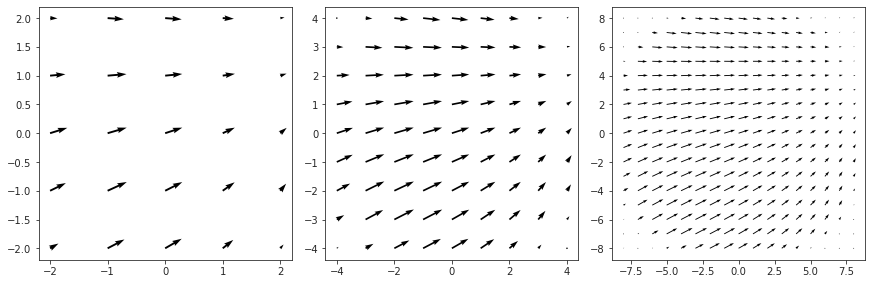

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 5, 9) >>>
self . . . fixation: [0. 0. 1.],  v_self: [3 3 1]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

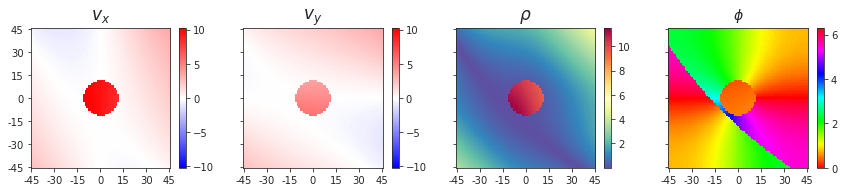

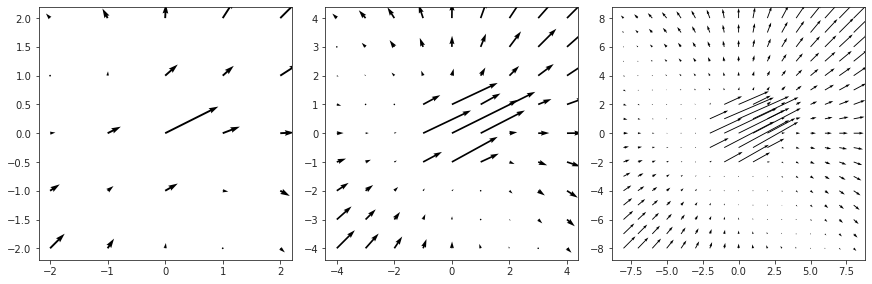

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 6, 0) >>>
self . . . fixation: [0. 0. 1.],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

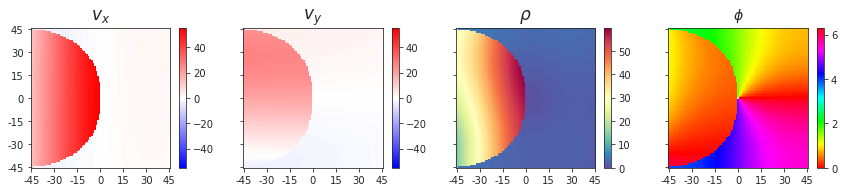

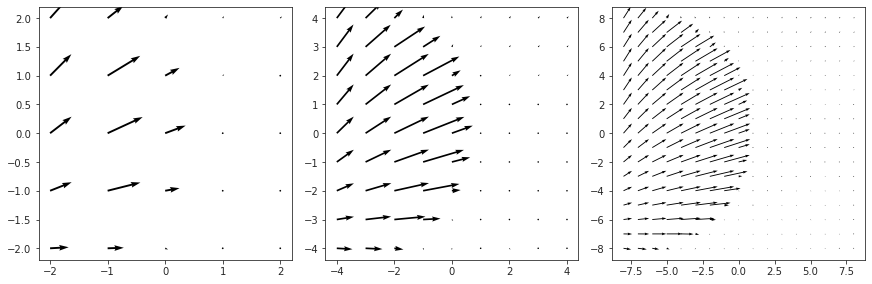

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 6, 1) >>>
self . . . fixation: [0. 0. 1.],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

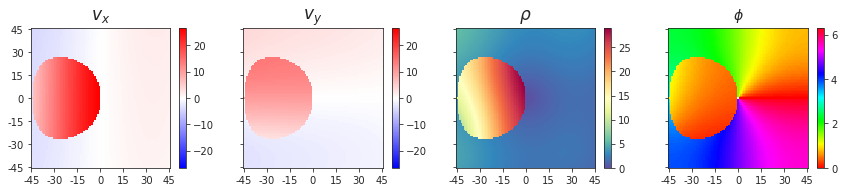

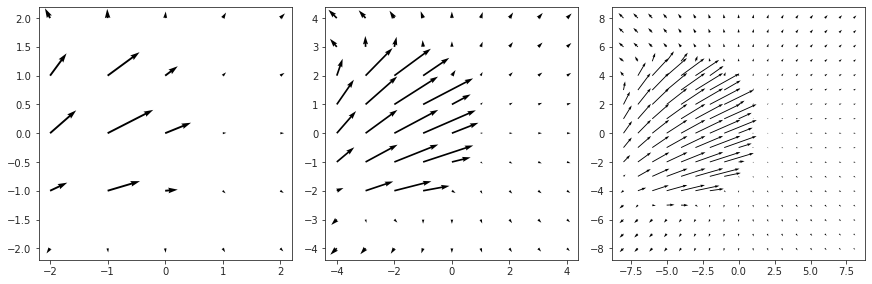

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 6, 2) >>>
self . . . fixation: [0. 0. 1.],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

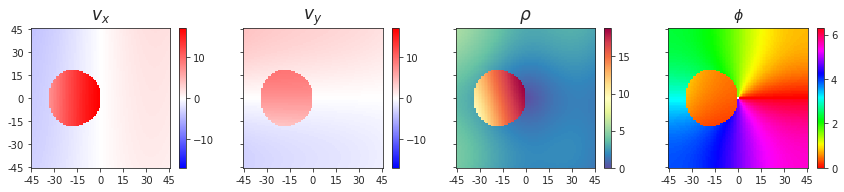

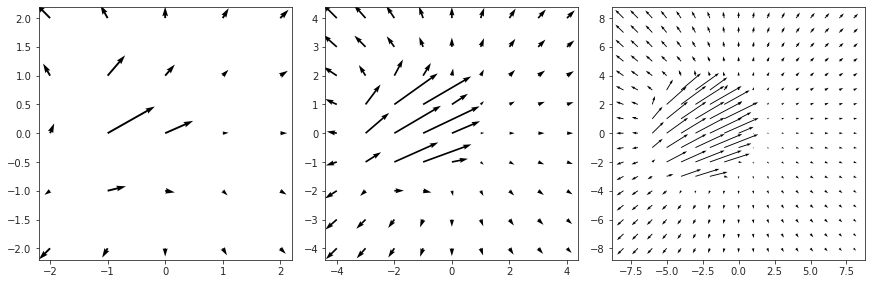

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 6, 3) >>>
self . . . fixation: [0. 0. 1.],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

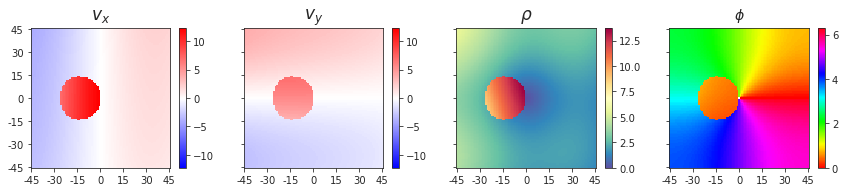

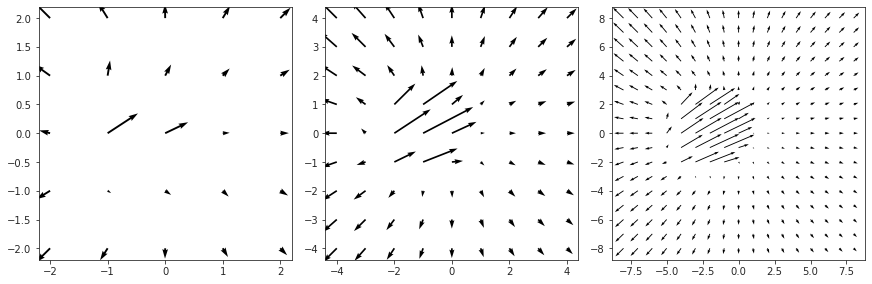

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 6, 4) >>>
self . . . fixation: [0. 0. 1.],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

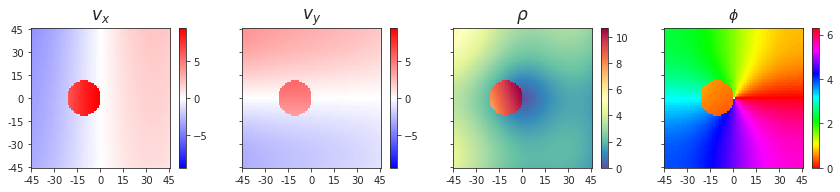

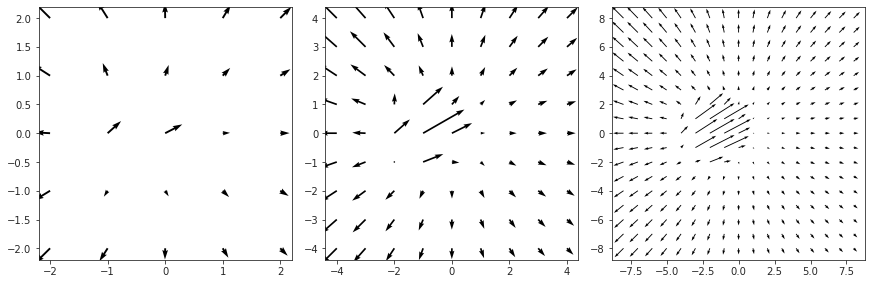

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 6, 5) >>>
self . . . fixation: [0. 0. 1.],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

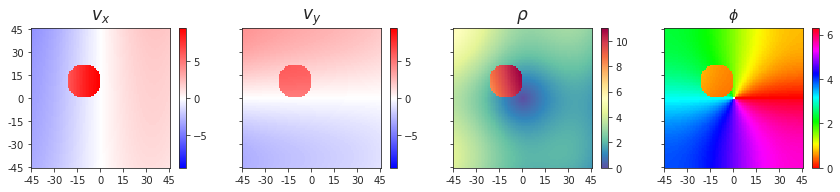

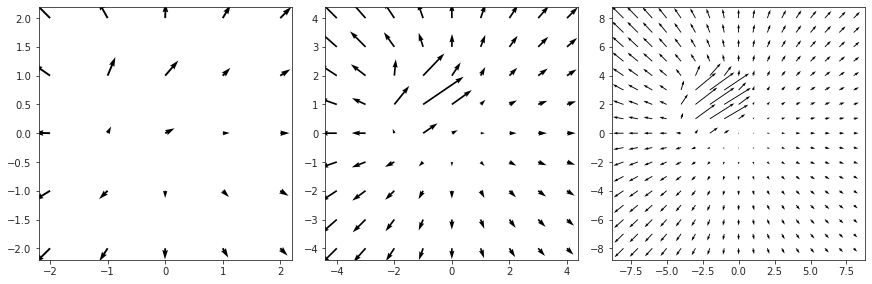

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 6, 6) >>>
self . . . fixation: [0. 0. 1.],  v_self: [-2  1  5]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

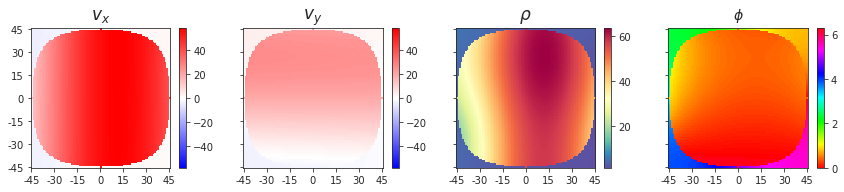

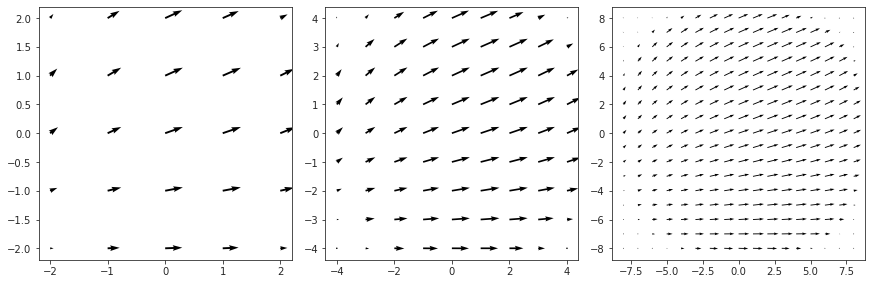

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 6, 7) >>>
self . . . fixation: [0. 0. 1.],  v_self: [-2  1  5]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

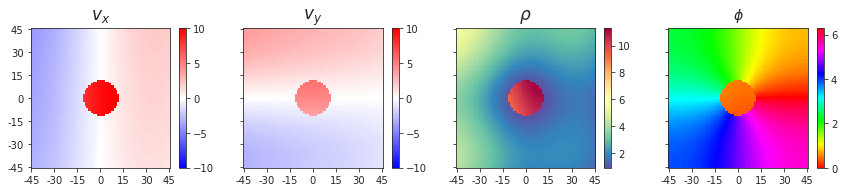

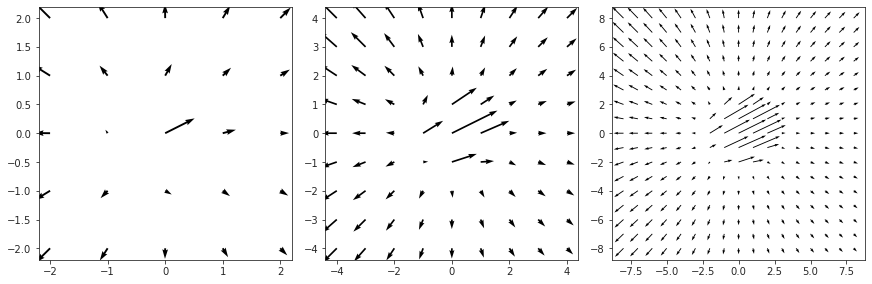

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 6, 8) >>>
self . . . fixation: [0. 0. 1.],  v_self: [-2  1  5]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

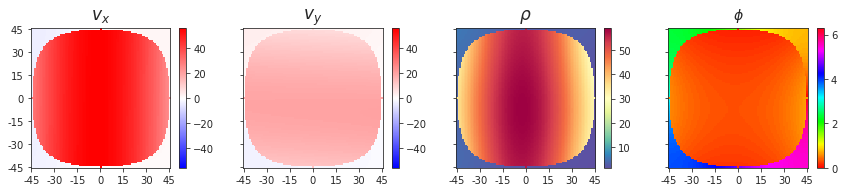

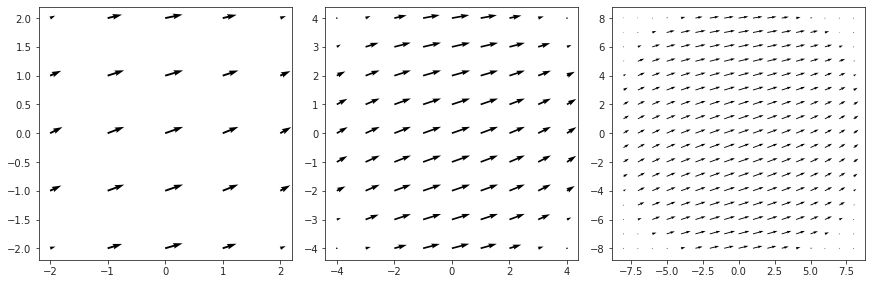

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (0, 6, 9) >>>
self . . . fixation: [0. 0. 1.],  v_self: [-2  1  5]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

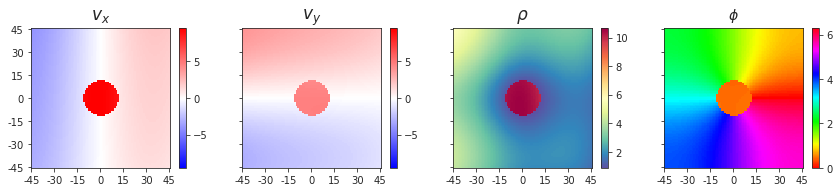

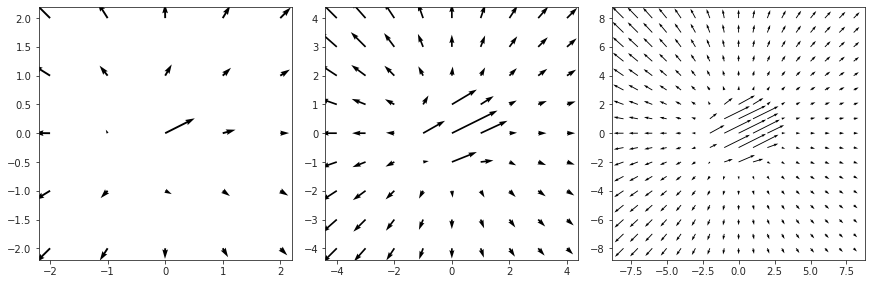

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 0, 0) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

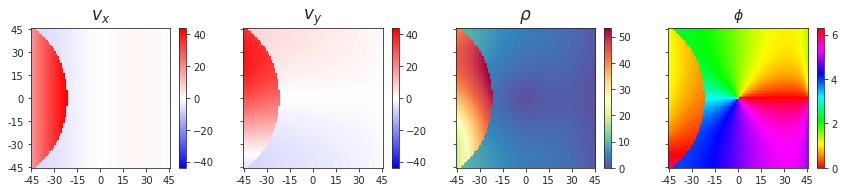

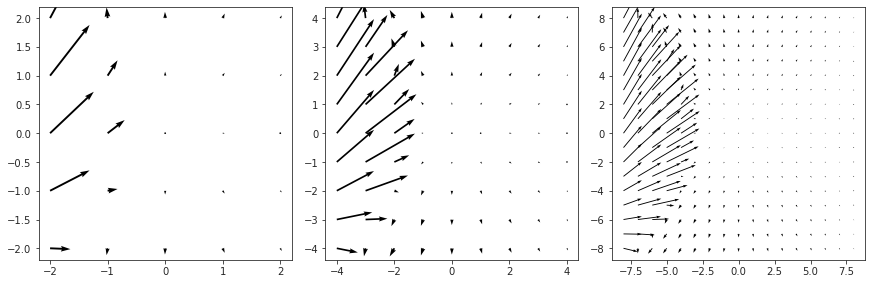

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 0, 1) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

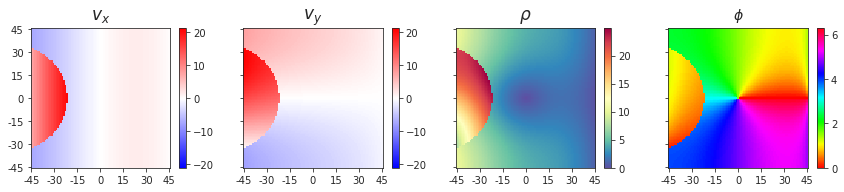

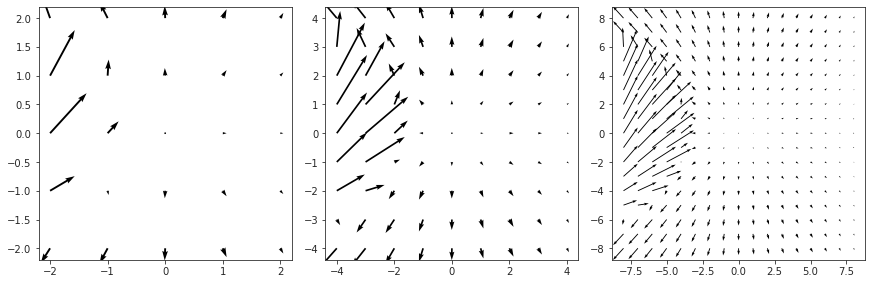

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 0, 2) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

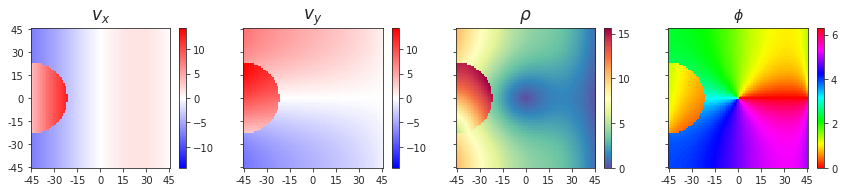

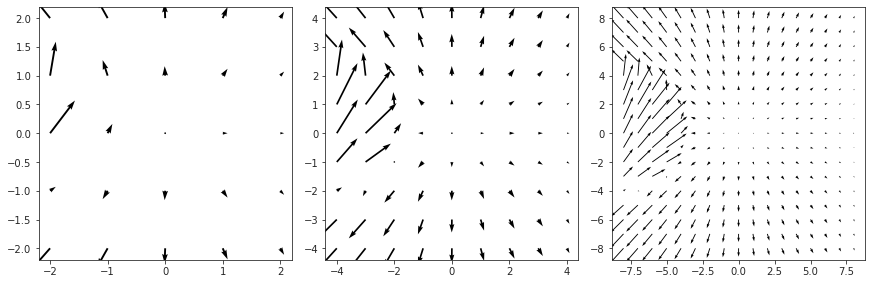

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 0, 3) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

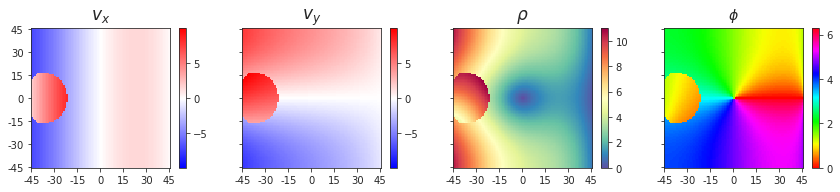

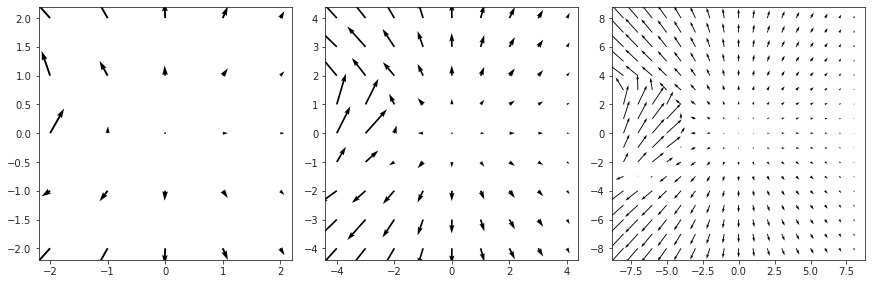

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 0, 4) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

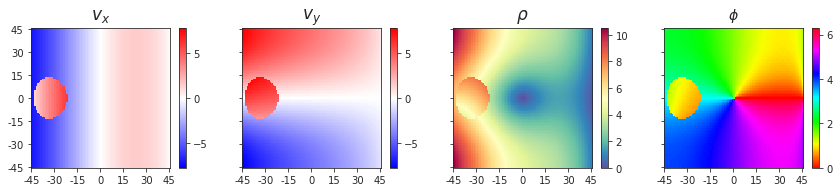

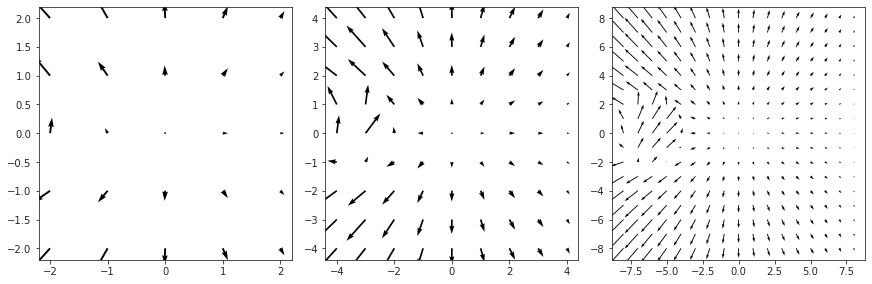

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 0, 5) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

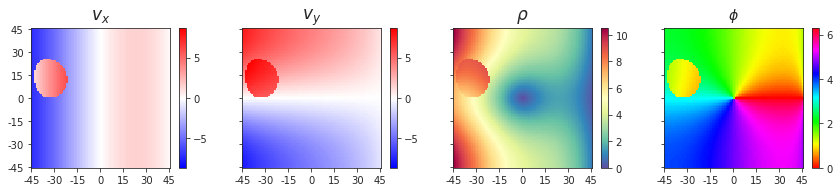

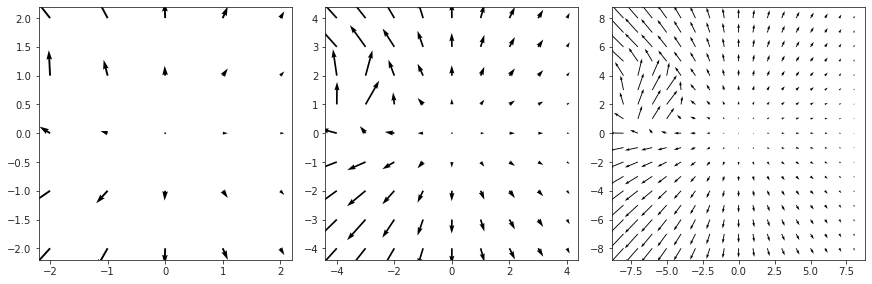

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 0, 6) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 0  0 10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

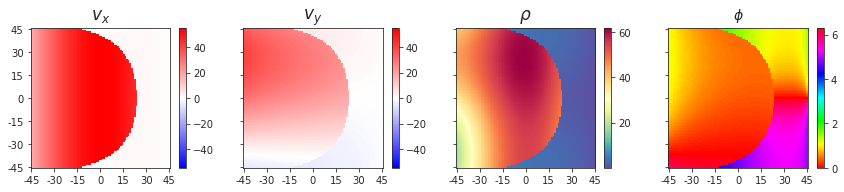

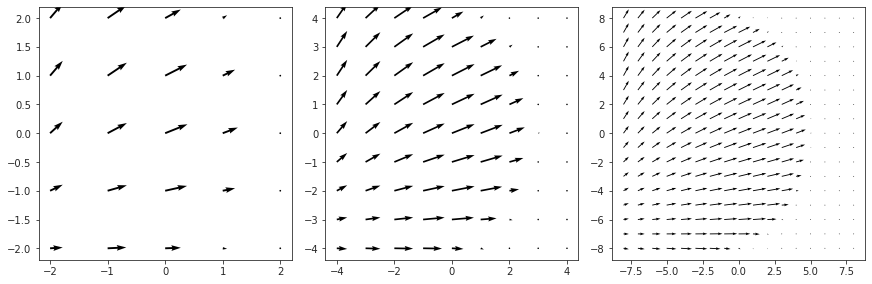

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 0, 7) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 0  0 10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

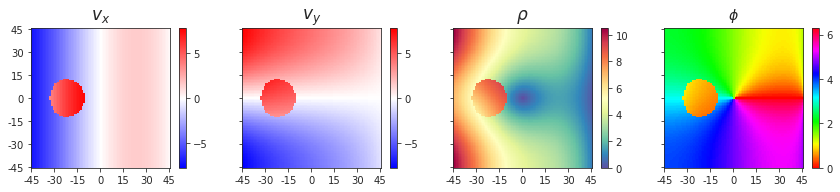

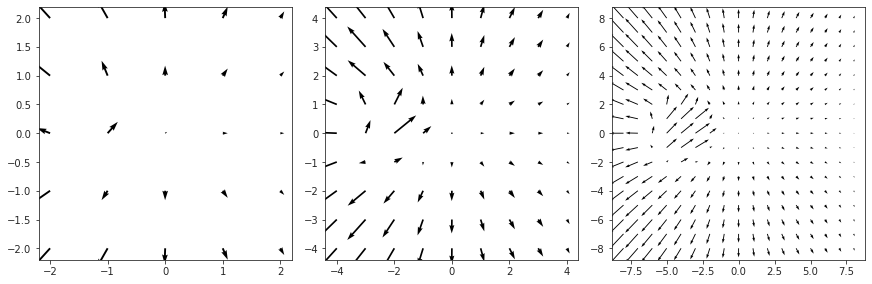

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 0, 8) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 0  0 10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

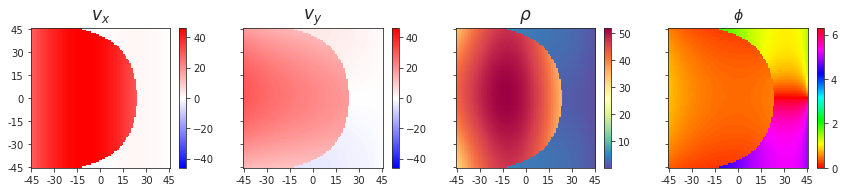

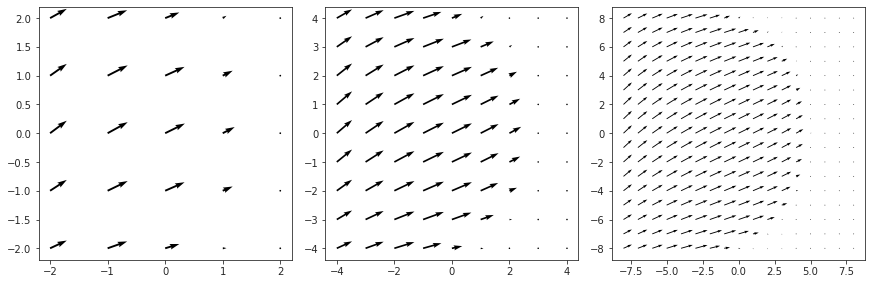

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 0, 9) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 0  0 10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

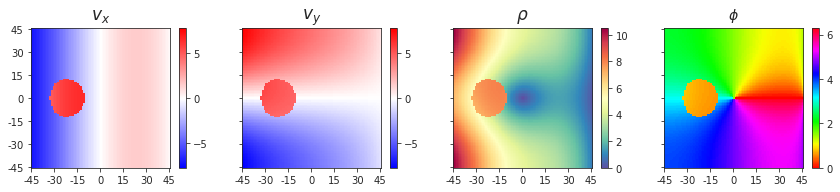

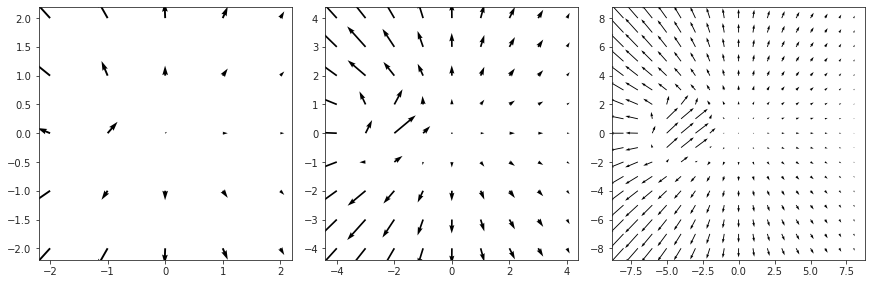

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 1, 0) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

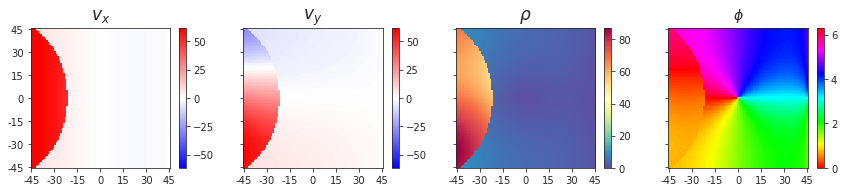

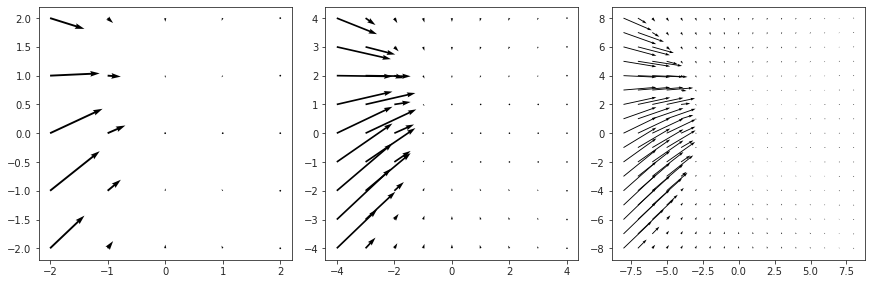

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 1, 1) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

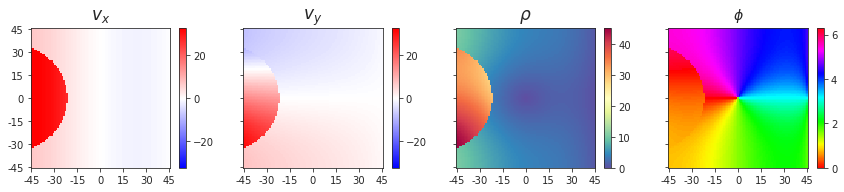

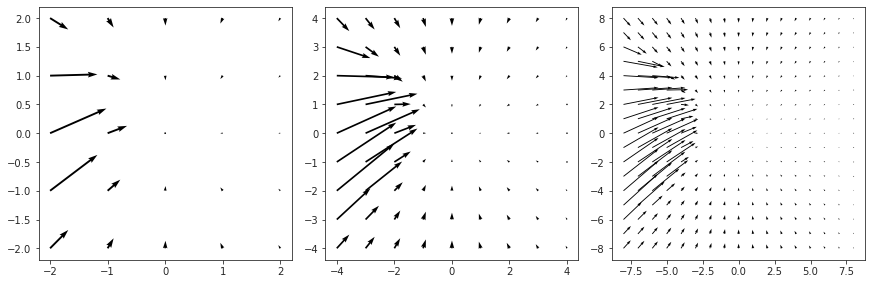

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 1, 2) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

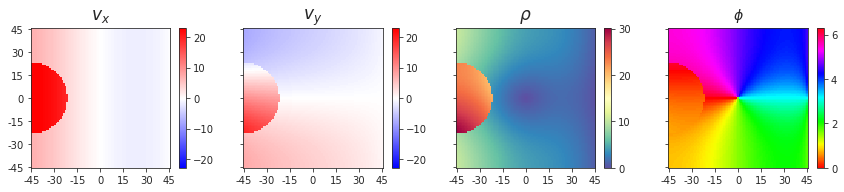

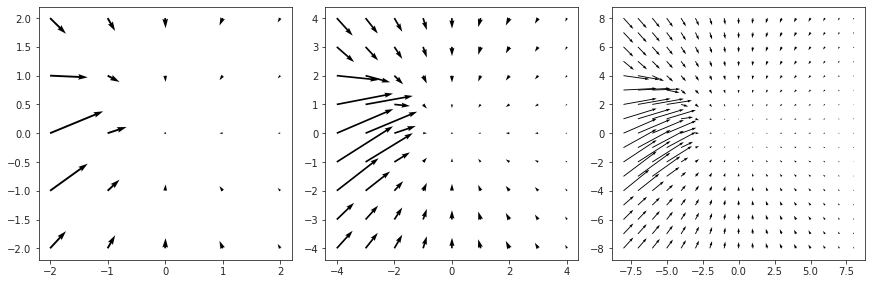

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 1, 3) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

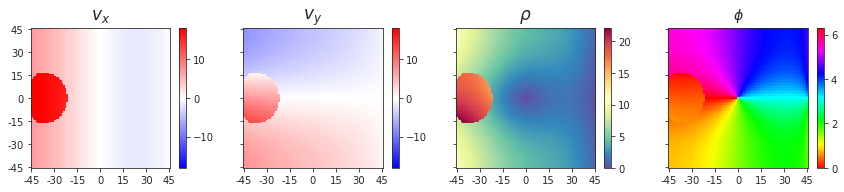

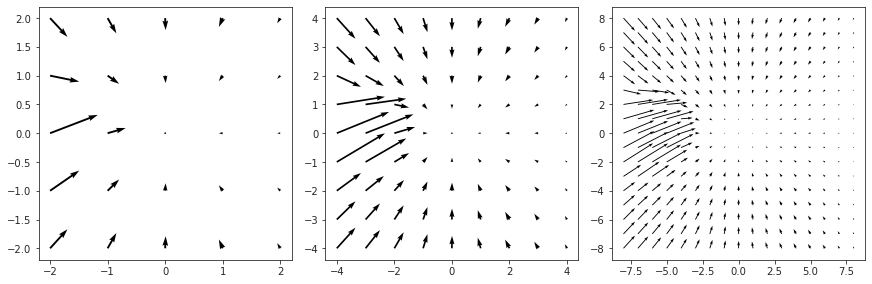

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 1, 4) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

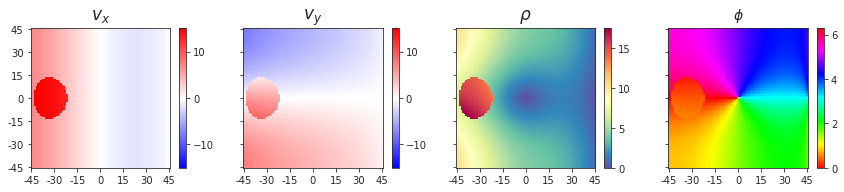

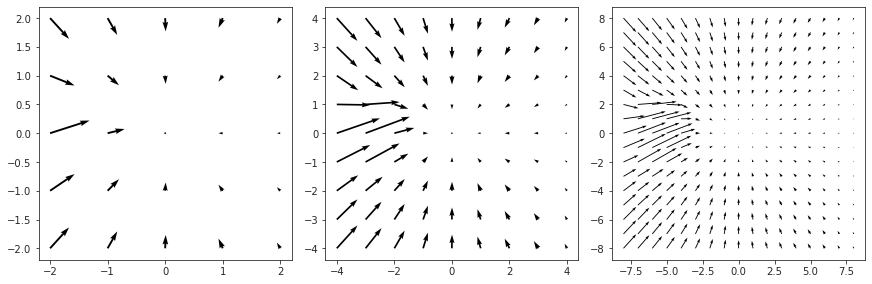

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 1, 5) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

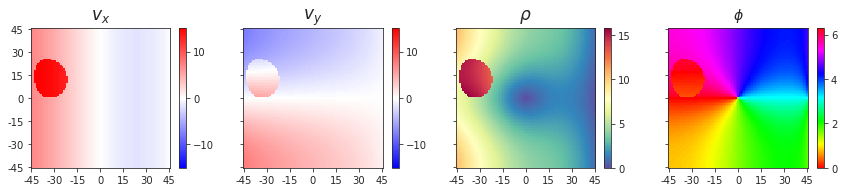

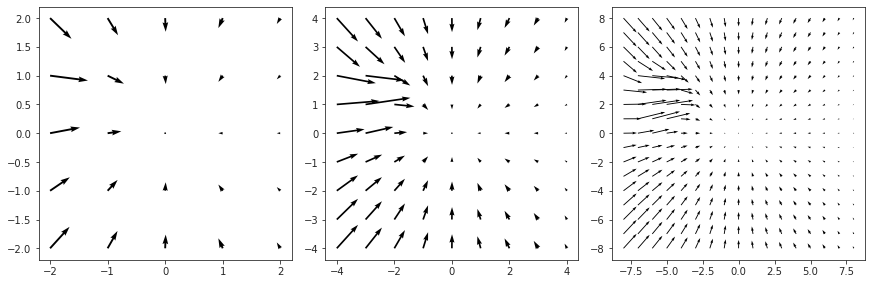

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 1, 6) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [  0   0 -10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

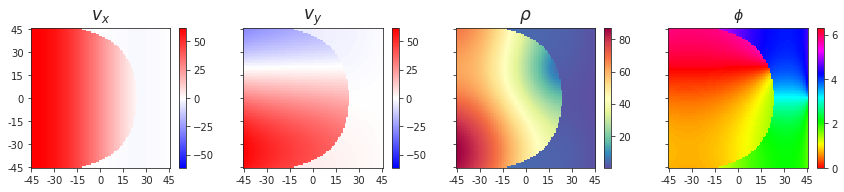

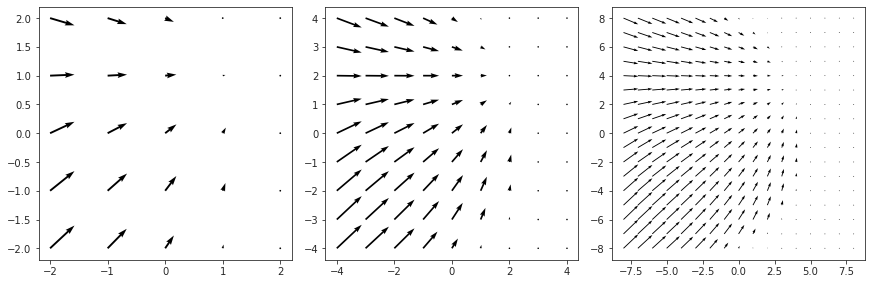

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 1, 7) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [  0   0 -10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

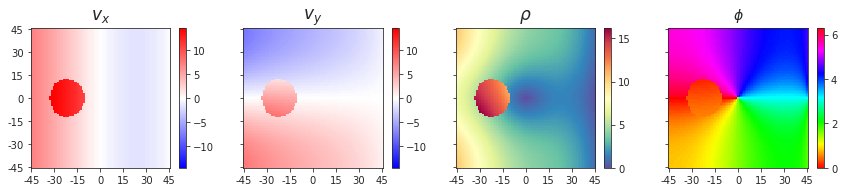

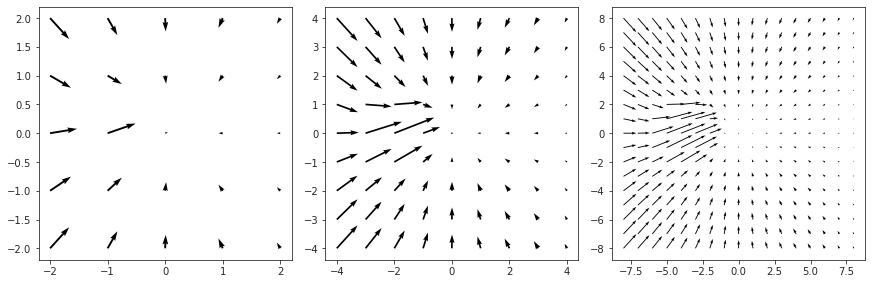

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 1, 8) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [  0   0 -10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

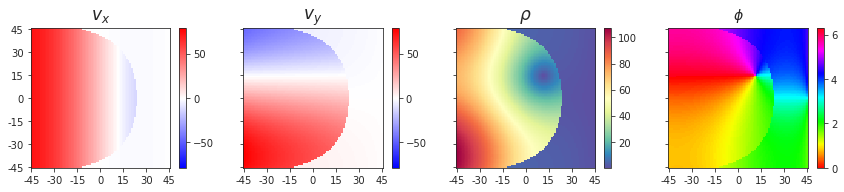

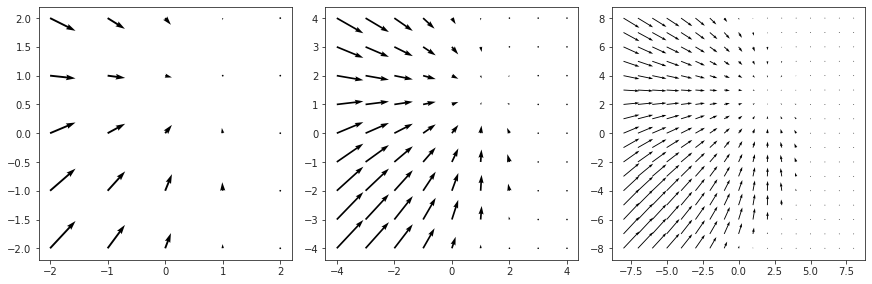

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 1, 9) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [  0   0 -10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

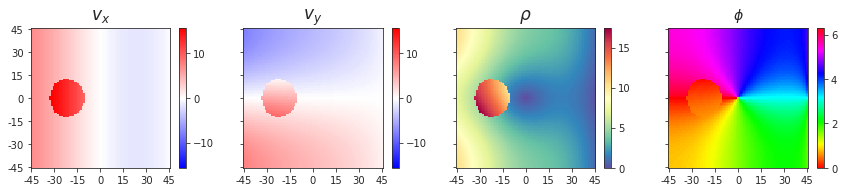

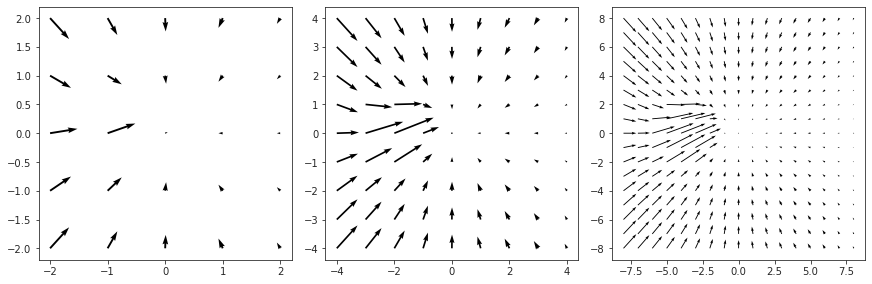

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 2, 0) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

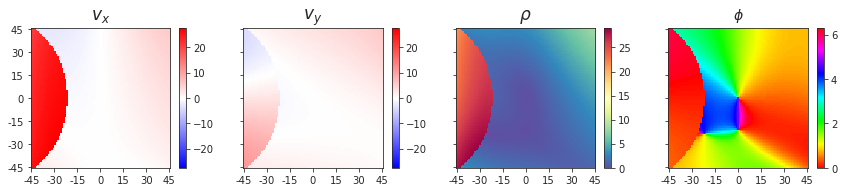

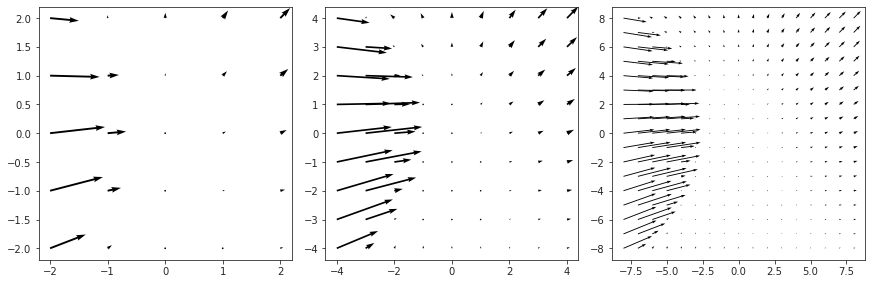

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 2, 1) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

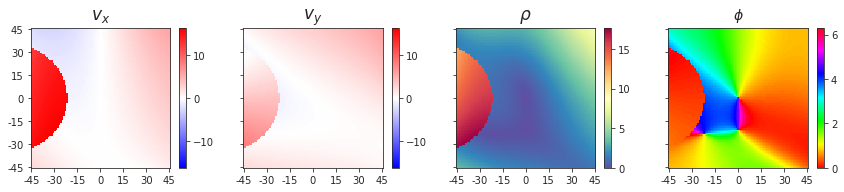

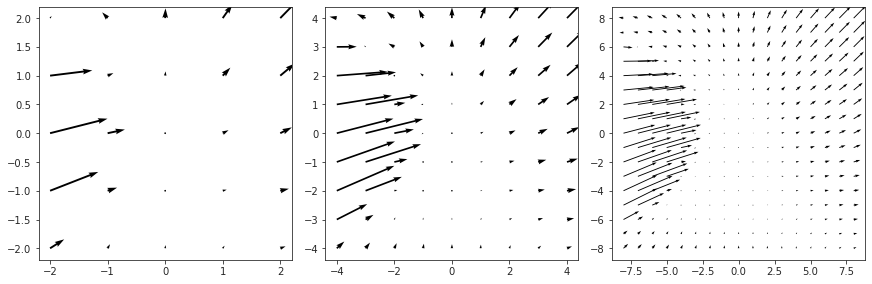

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 2, 2) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

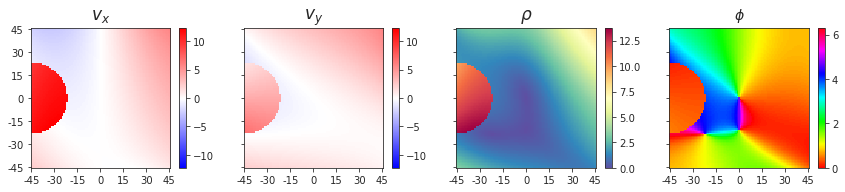

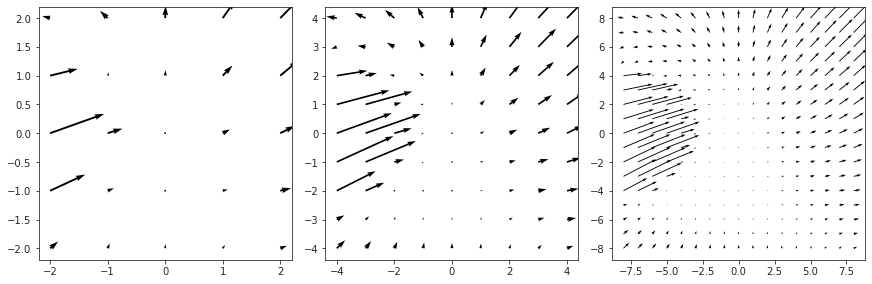

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 2, 3) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

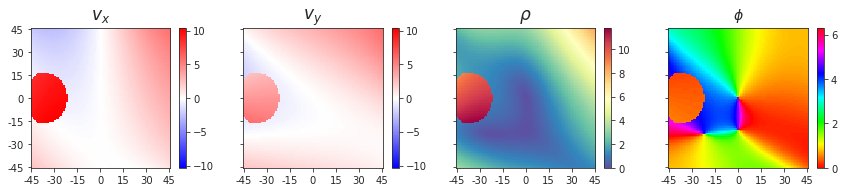

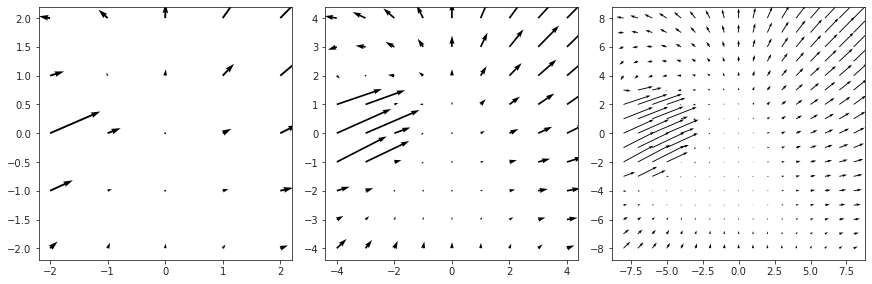

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 2, 4) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

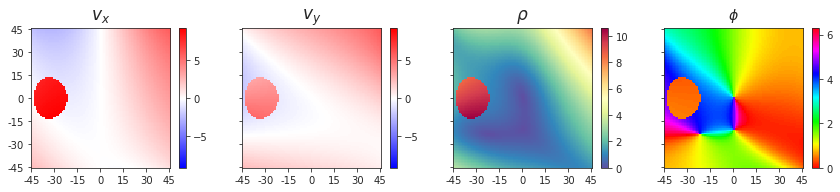

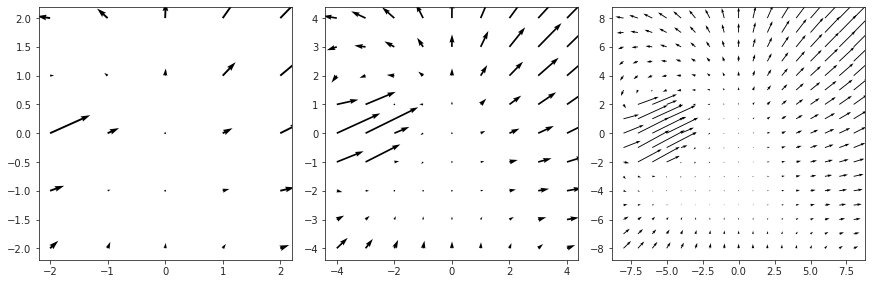

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 2, 5) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

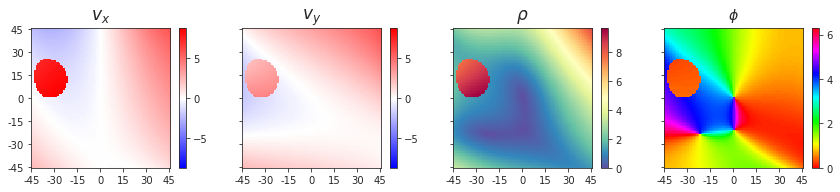

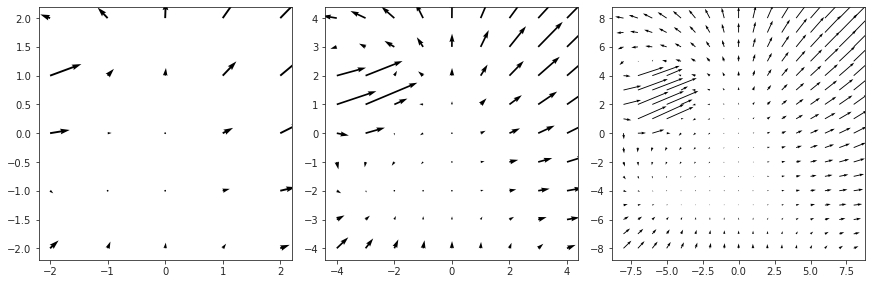

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 2, 6) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [5 5 0]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

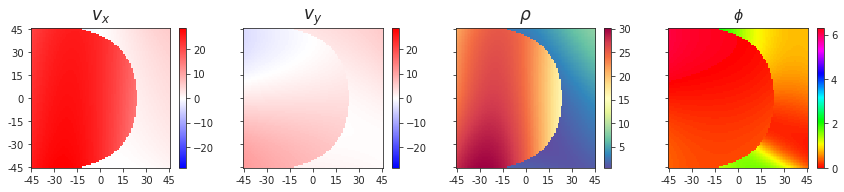

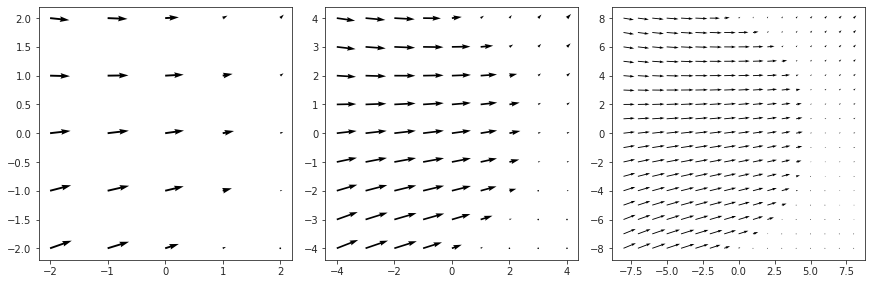

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 2, 7) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [5 5 0]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

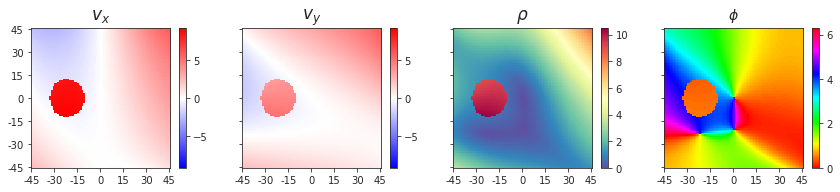

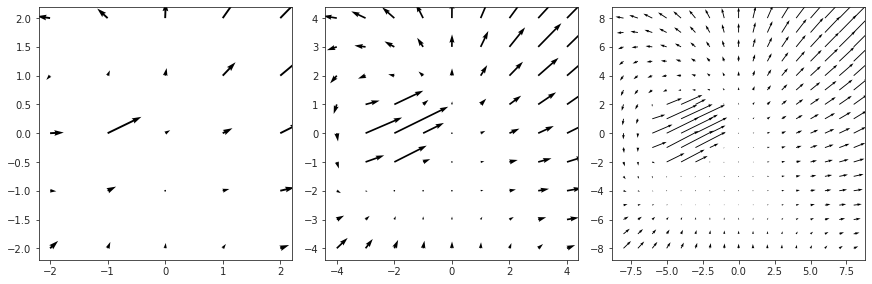

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 2, 8) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [5 5 0]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

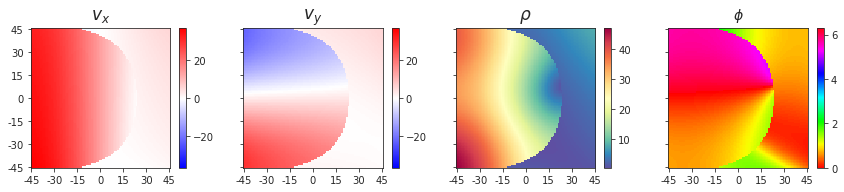

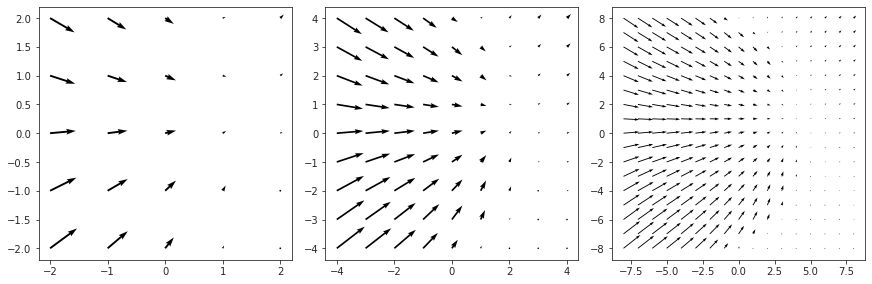

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 2, 9) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [5 5 0]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

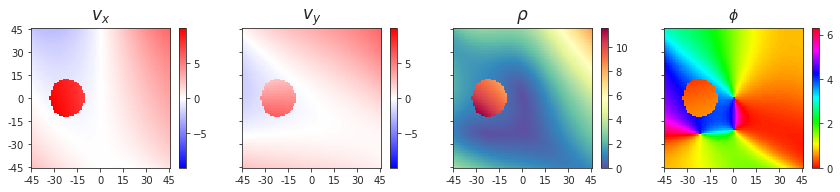

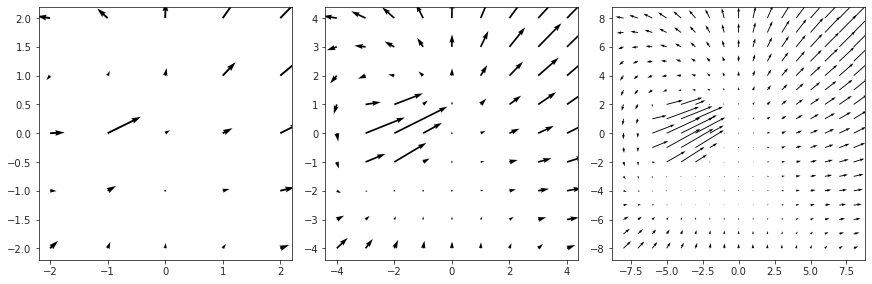

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 3, 0) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

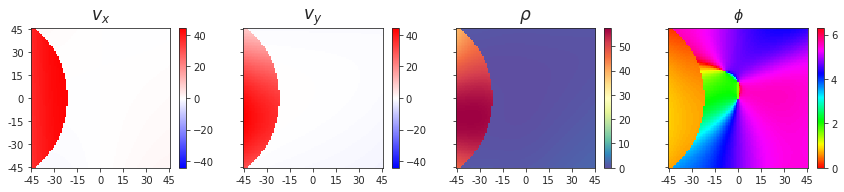

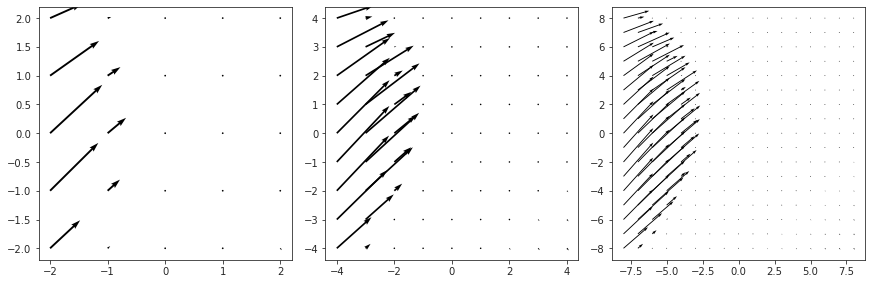

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 3, 1) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

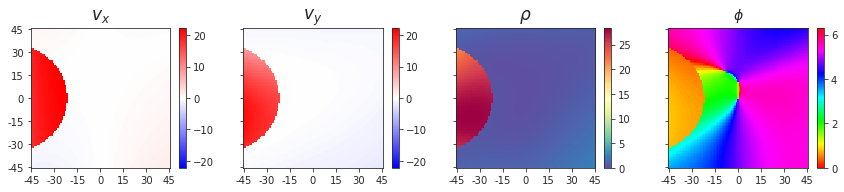

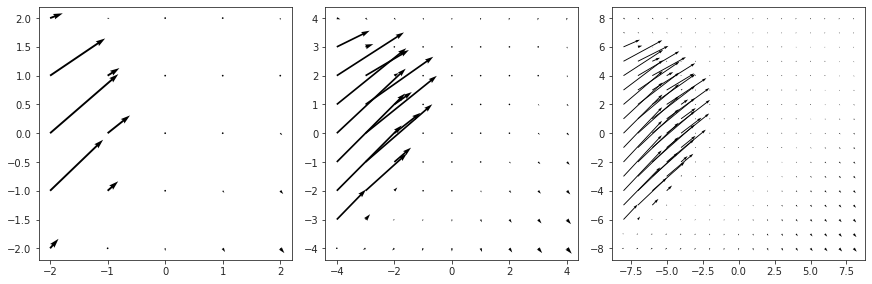

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 3, 2) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

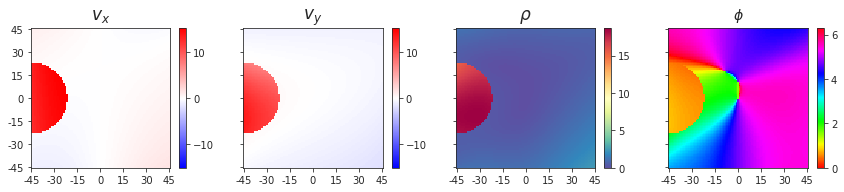

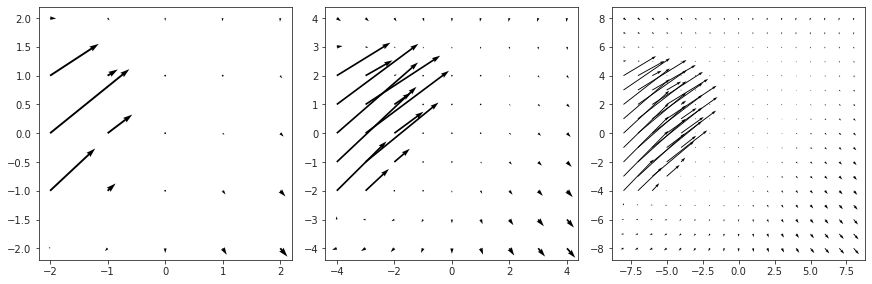

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 3, 3) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

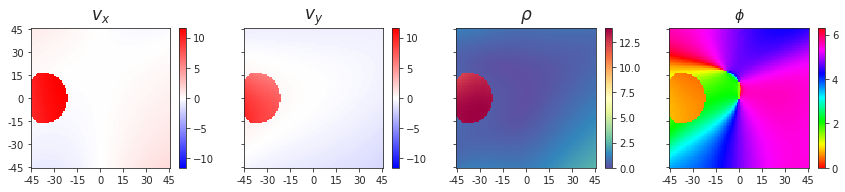

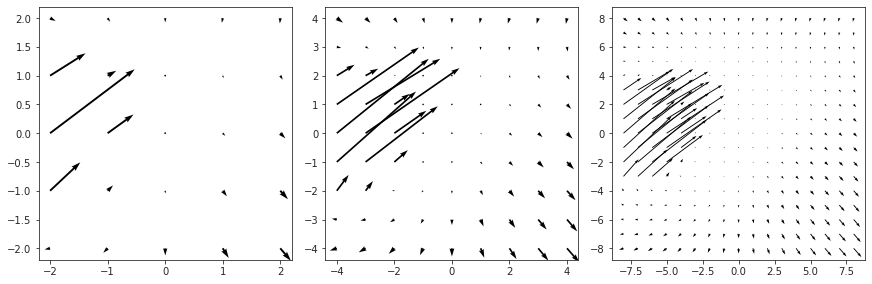

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 3, 4) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

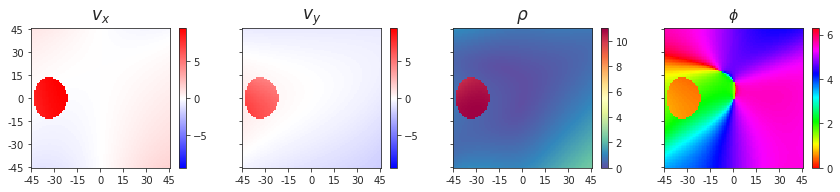

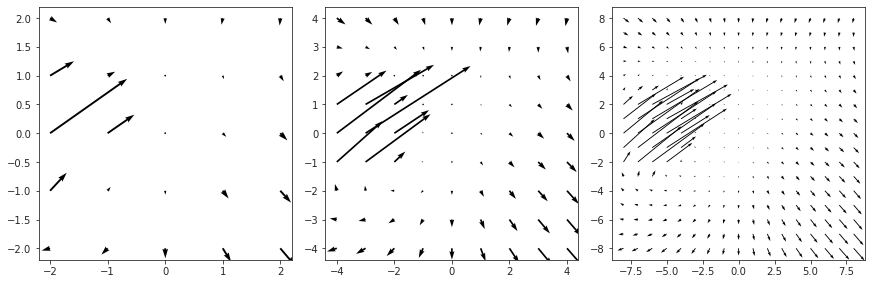

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 3, 5) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

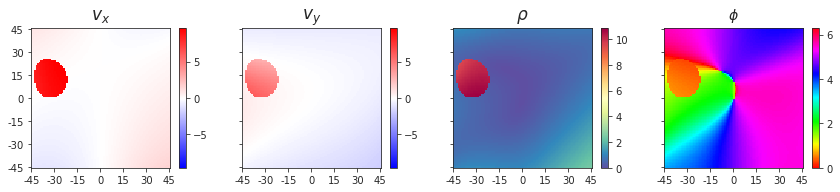

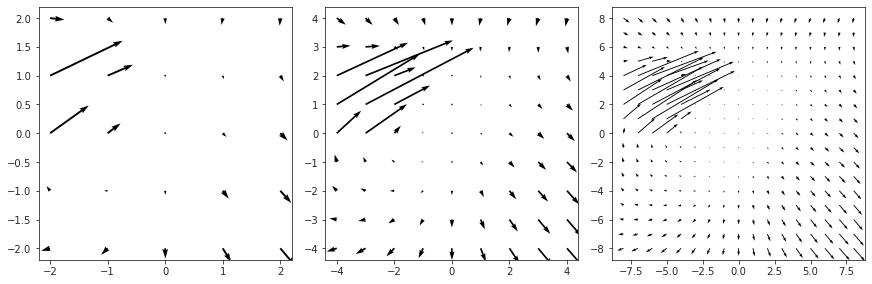

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 3, 6) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 1 -2  0]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

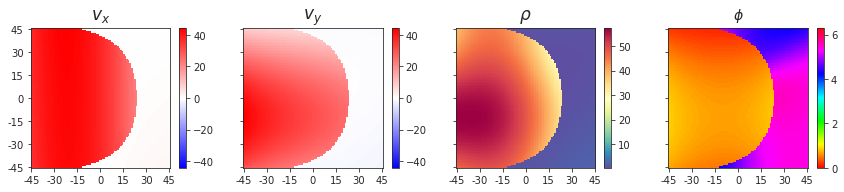

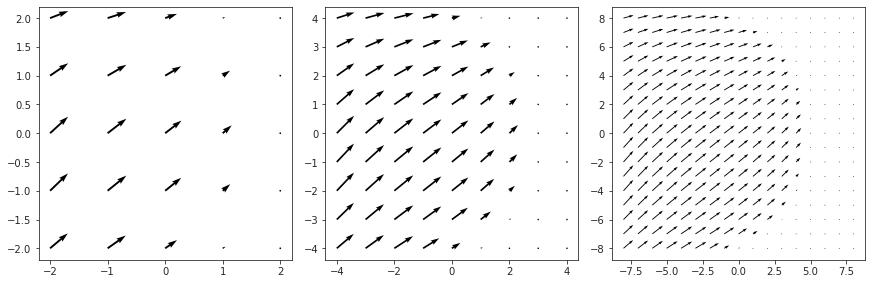

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 3, 7) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 1 -2  0]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

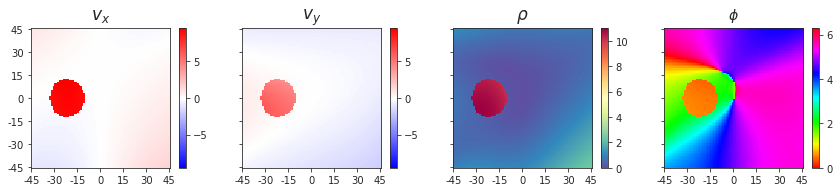

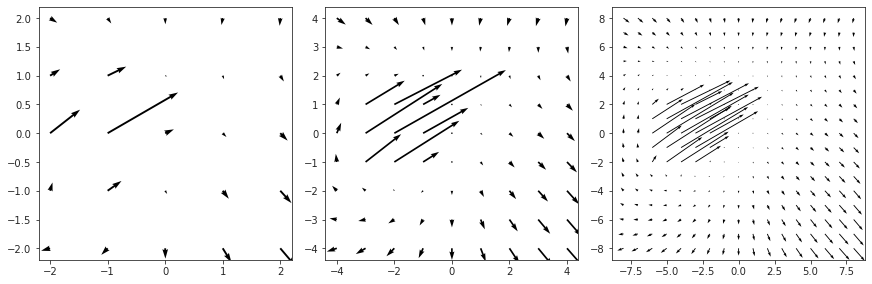

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 3, 8) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 1 -2  0]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

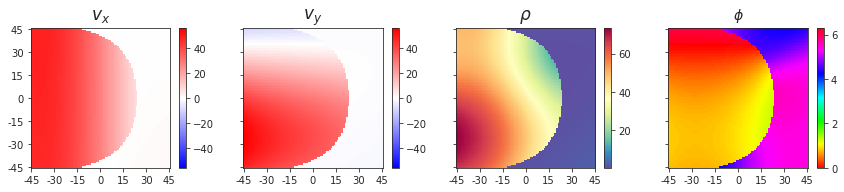

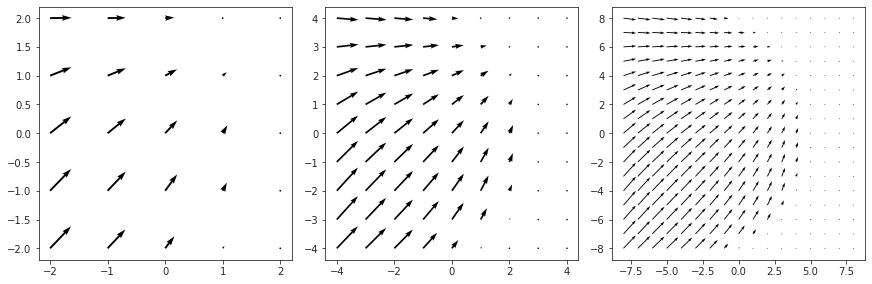

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 3, 9) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 1 -2  0]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

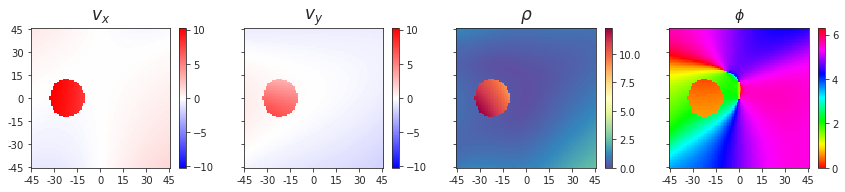

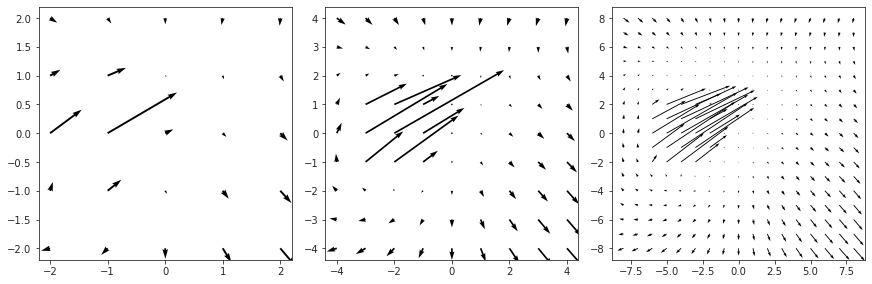

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 4, 0) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

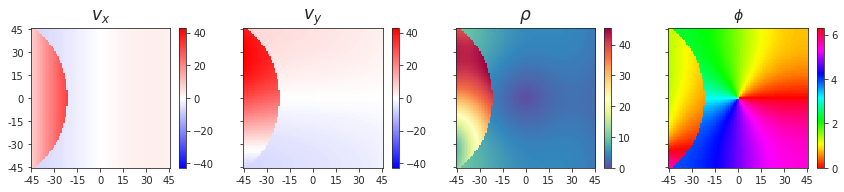

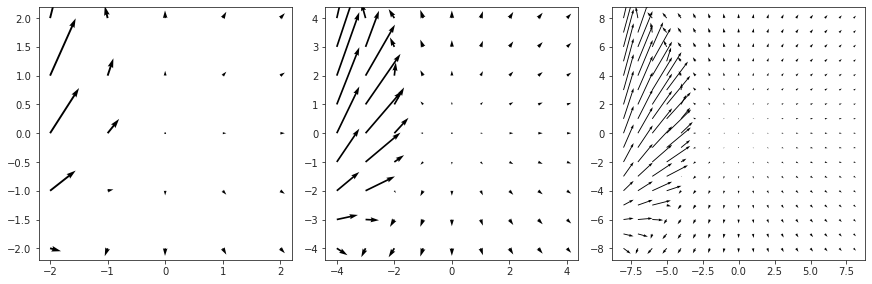

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 4, 1) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

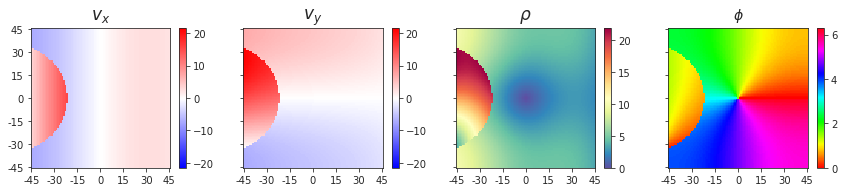

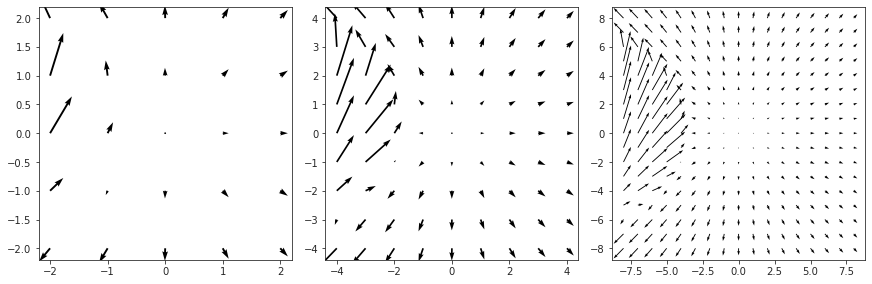

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 4, 2) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

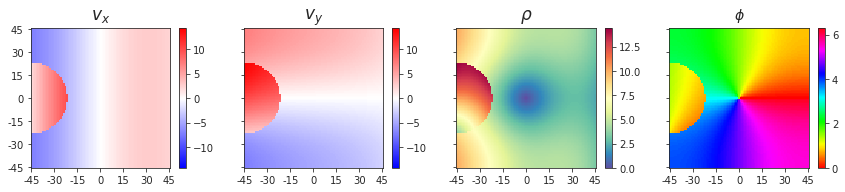

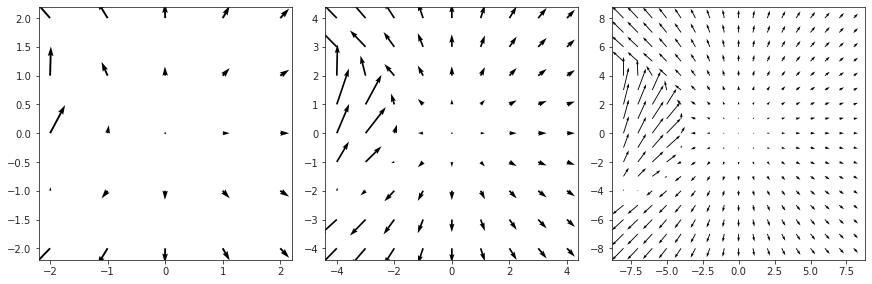

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 4, 3) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

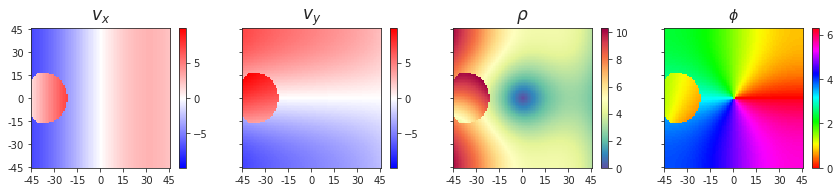

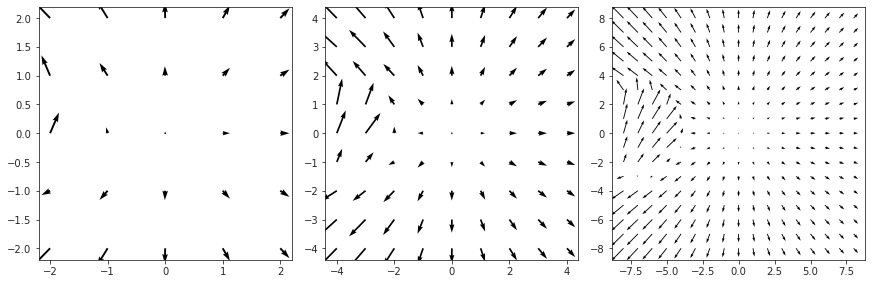

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 4, 4) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

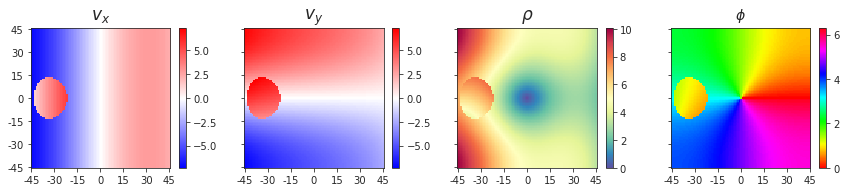

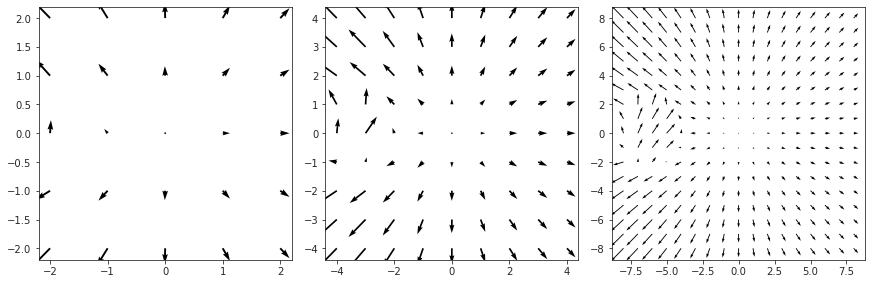

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 4, 5) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

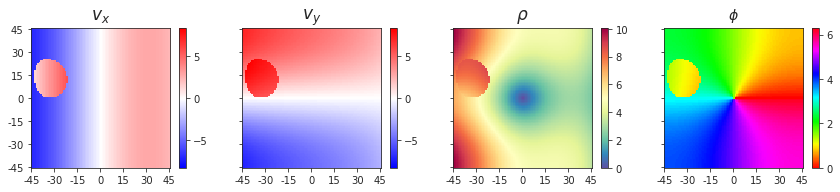

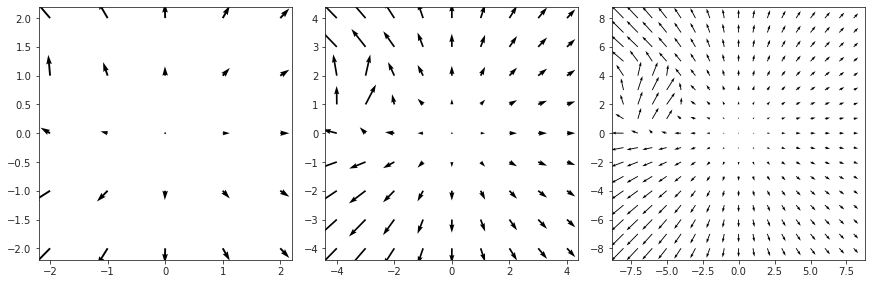

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 4, 6) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 3  0 10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

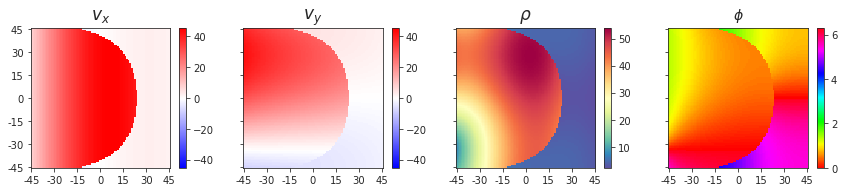

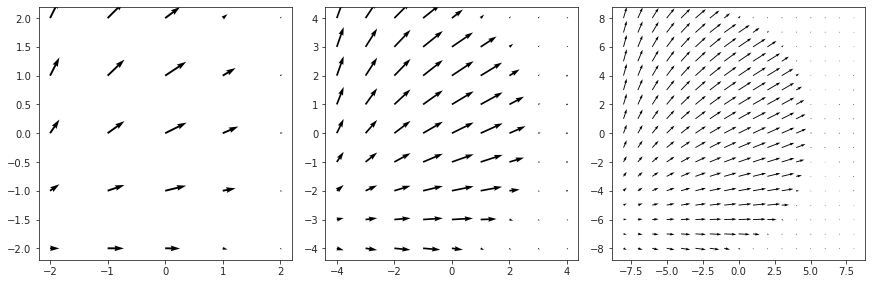

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 4, 7) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 3  0 10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

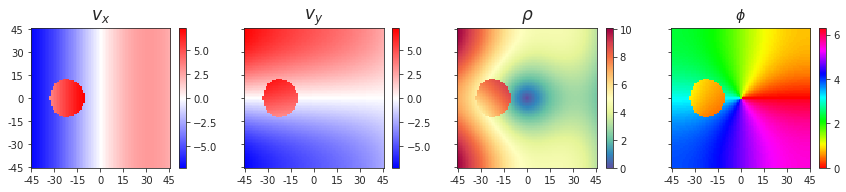

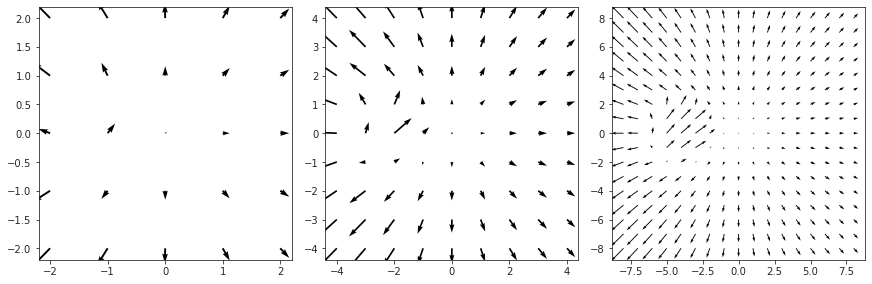

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 4, 8) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 3  0 10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

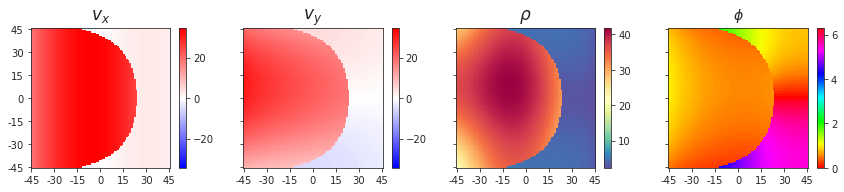

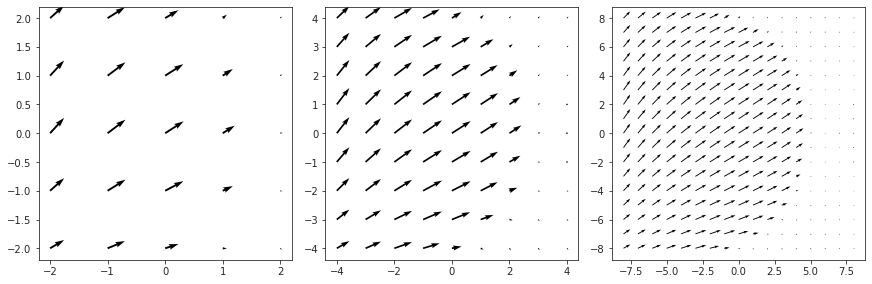

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 4, 9) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [ 3  0 10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

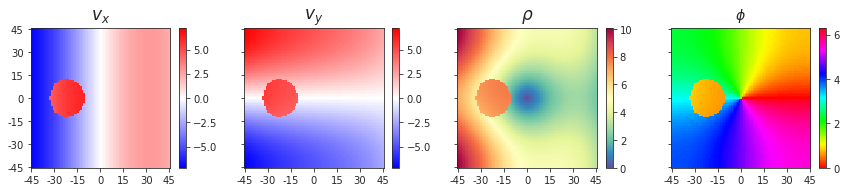

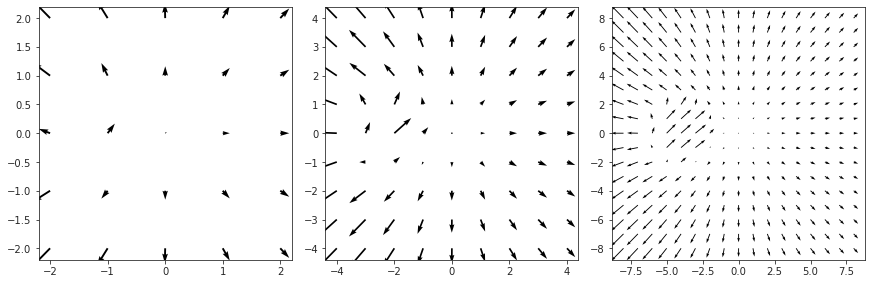

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 5, 0) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

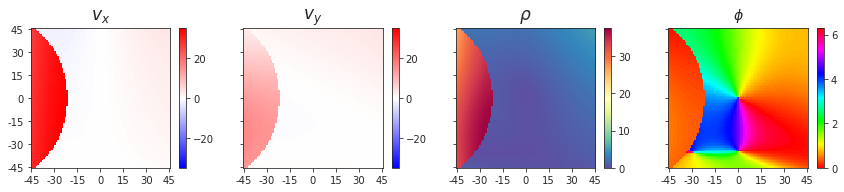

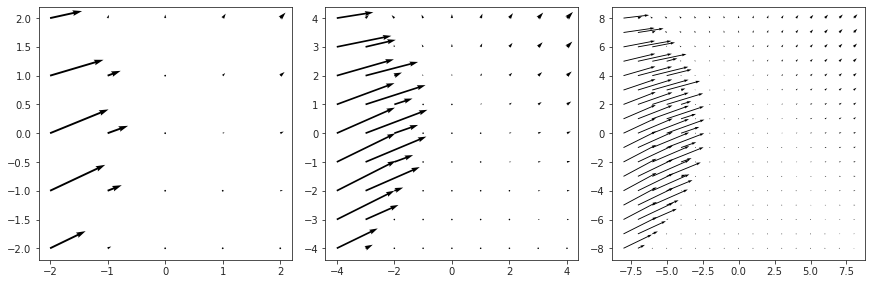

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 5, 1) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

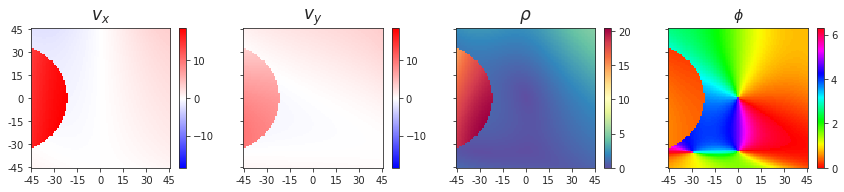

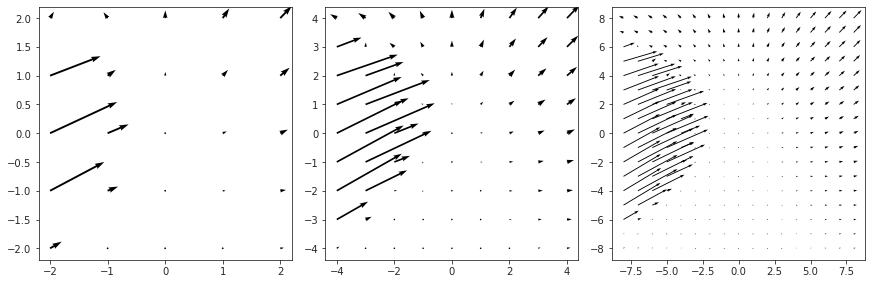

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 5, 2) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

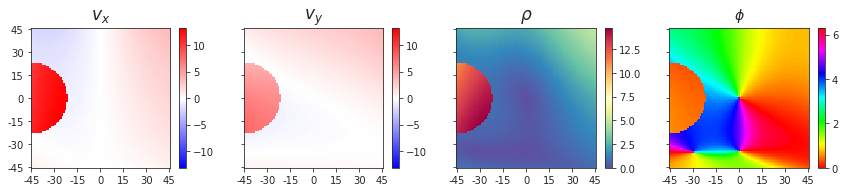

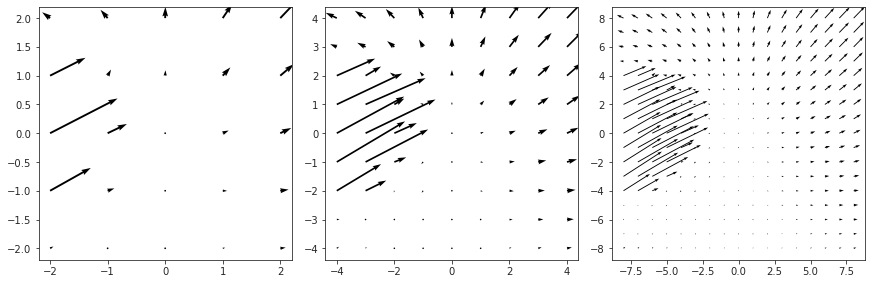

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 5, 3) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

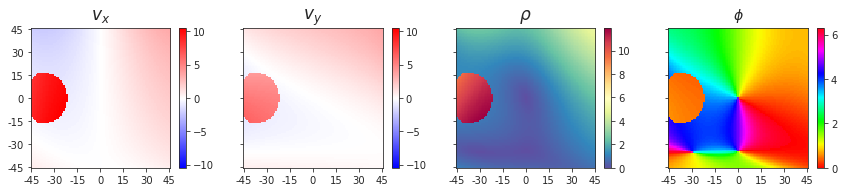

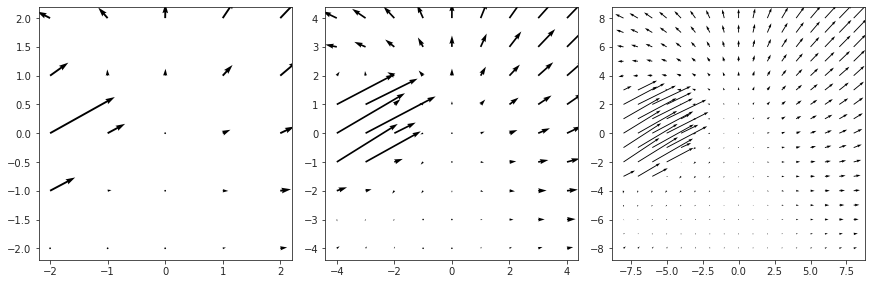

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 5, 4) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

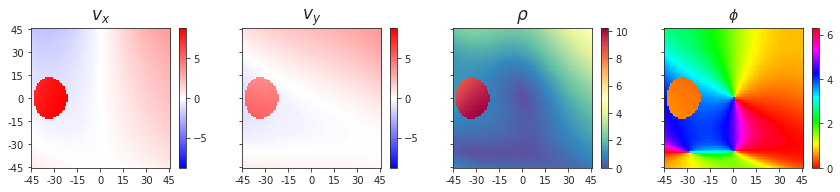

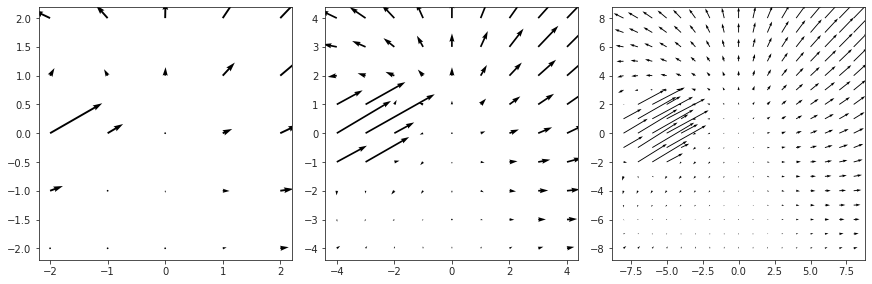

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 5, 5) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

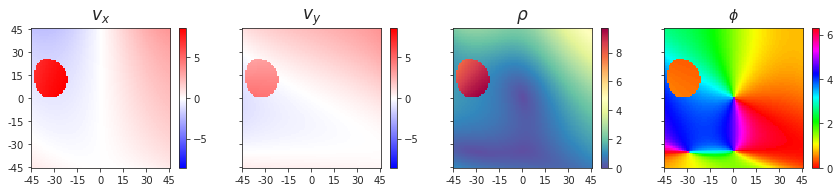

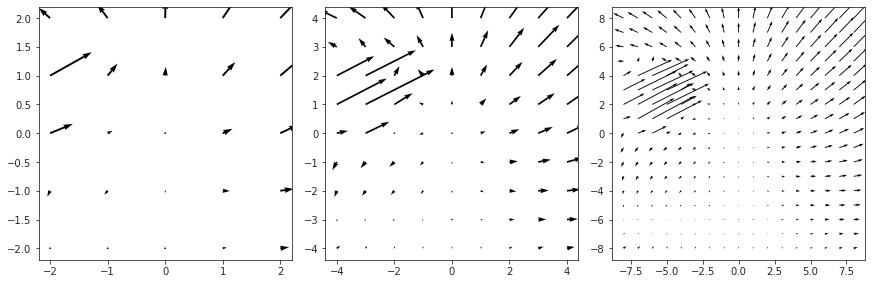

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 5, 6) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [3 3 1]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

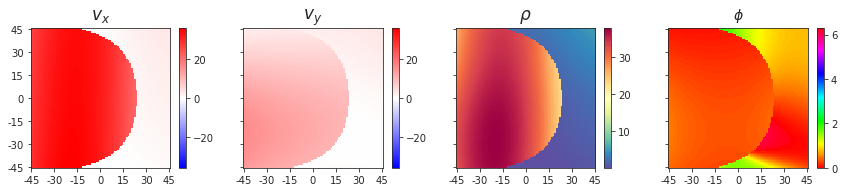

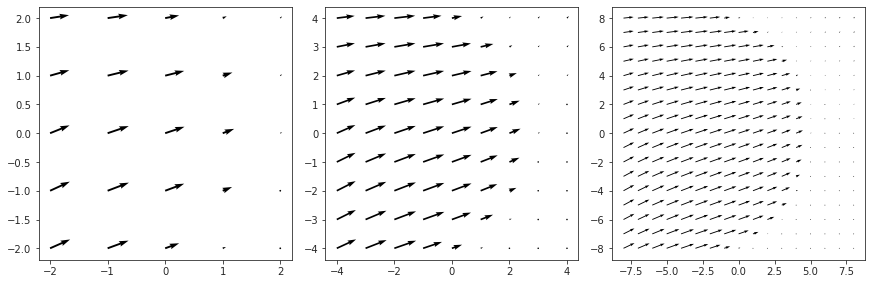

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 5, 7) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [3 3 1]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

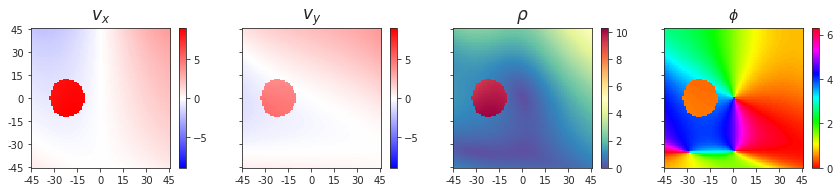

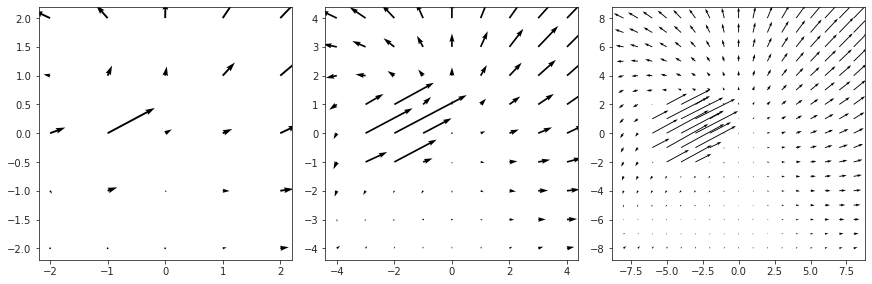

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 5, 8) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [3 3 1]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

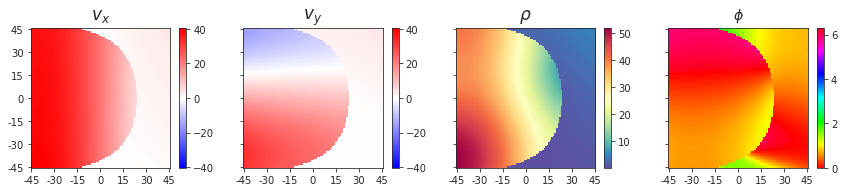

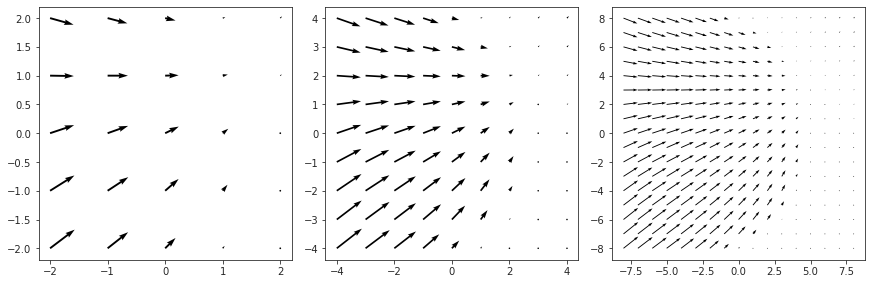

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 5, 9) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [3 3 1]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

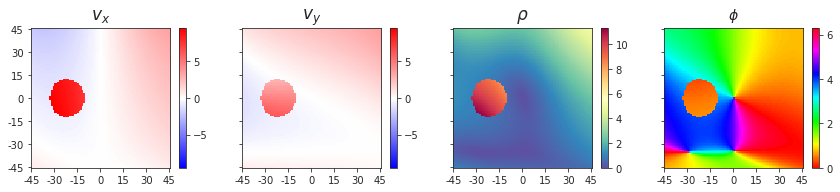

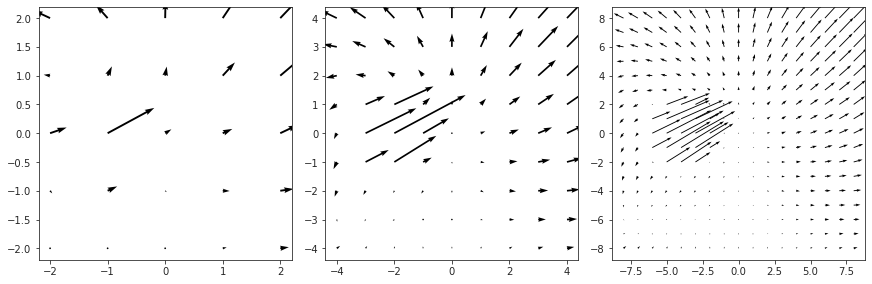

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 6, 0) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

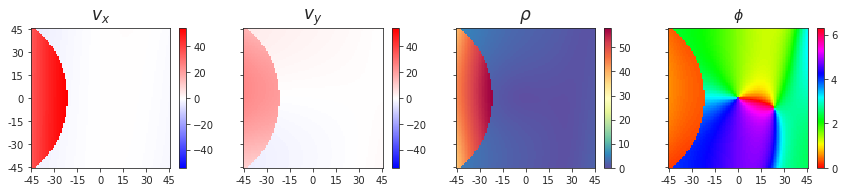

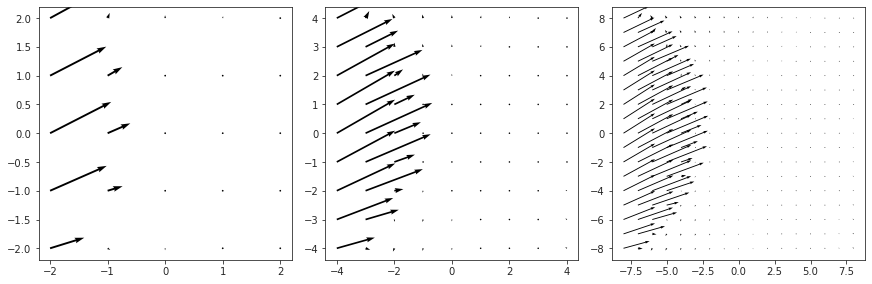

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 6, 1) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

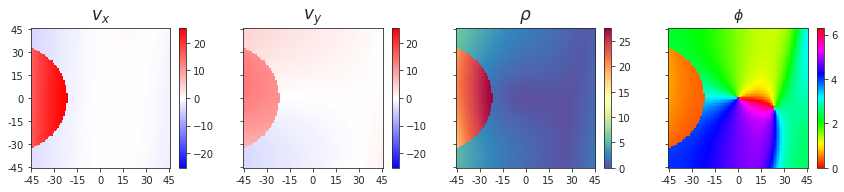

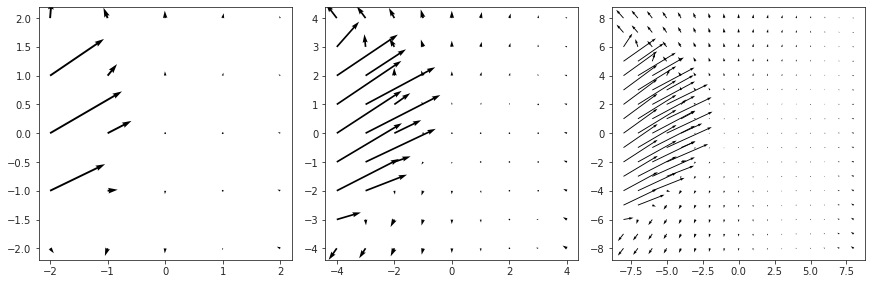

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 6, 2) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

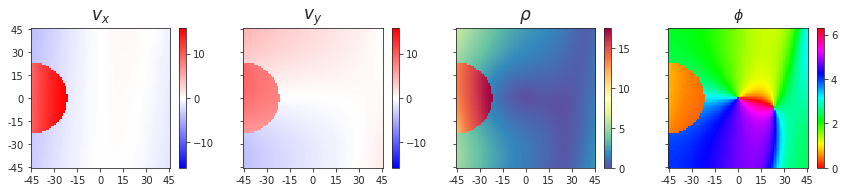

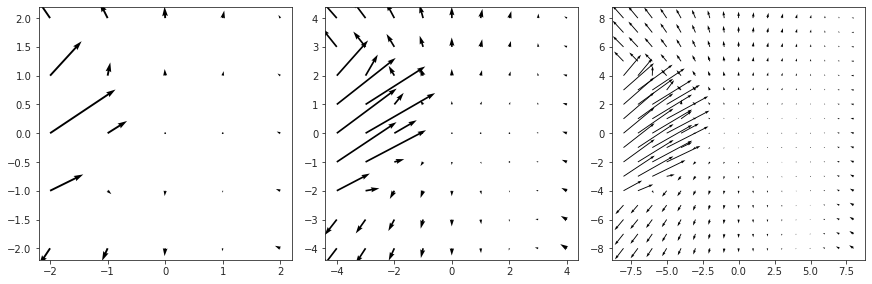

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 6, 3) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

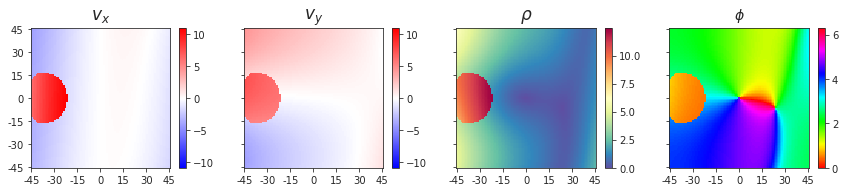

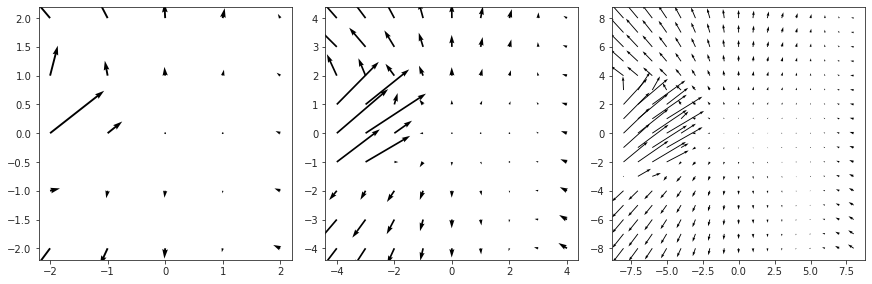

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 6, 4) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

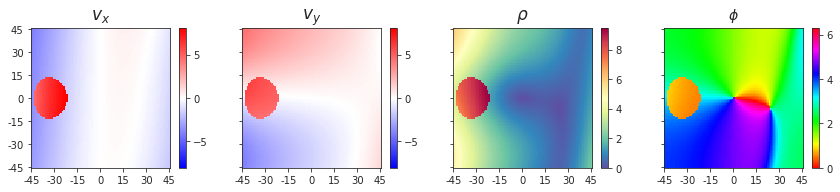

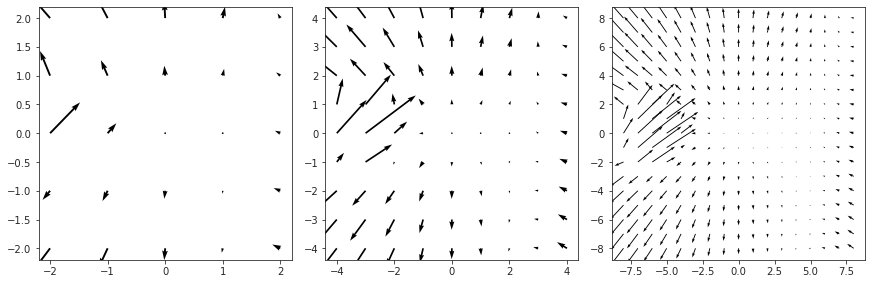

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 6, 5) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

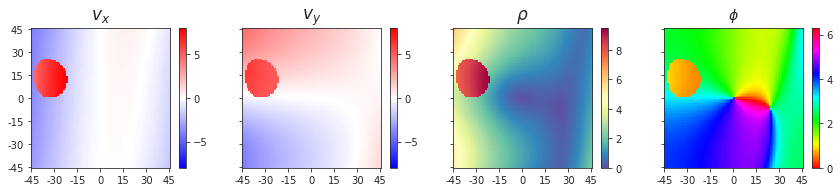

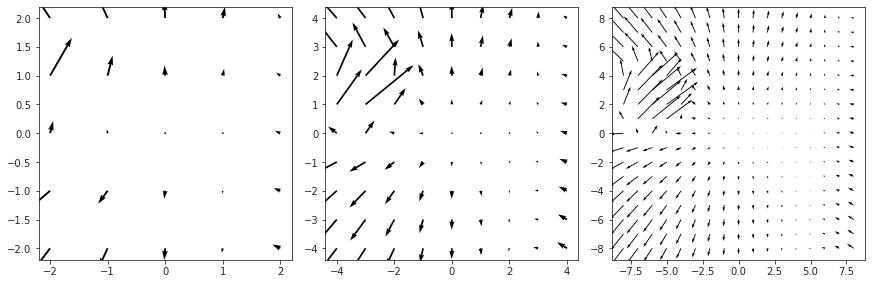

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 6, 6) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [-2  1  5]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

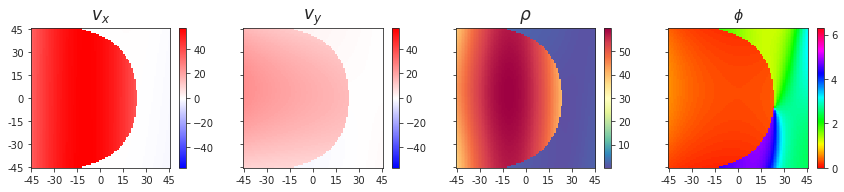

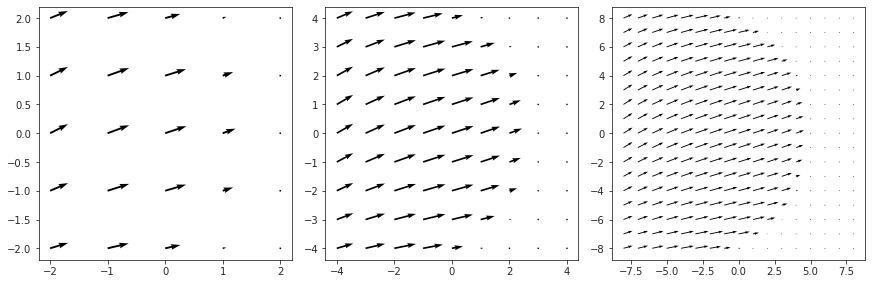

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 6, 7) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [-2  1  5]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

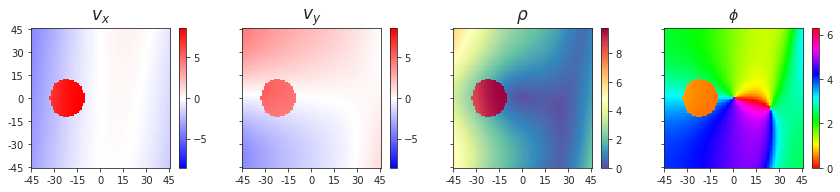

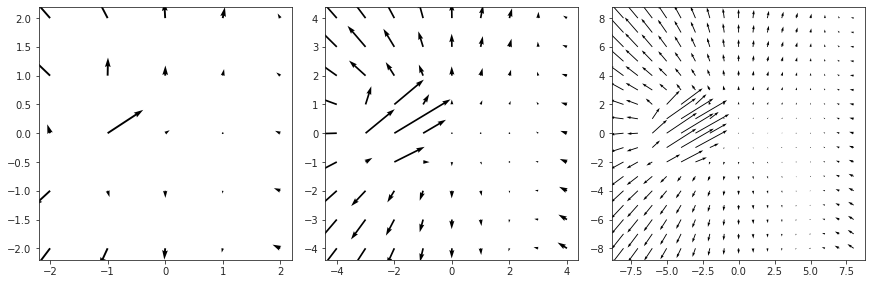

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 6, 8) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [-2  1  5]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

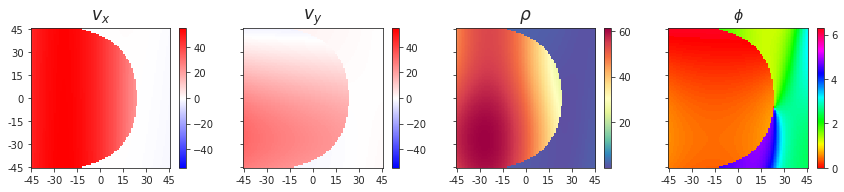

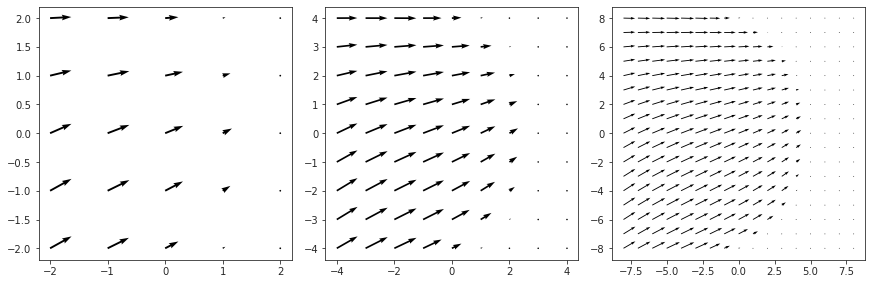

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (1, 6, 9) >>>
self . . . fixation: [0.4 0.  1. ],  v_self: [-2  1  5]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

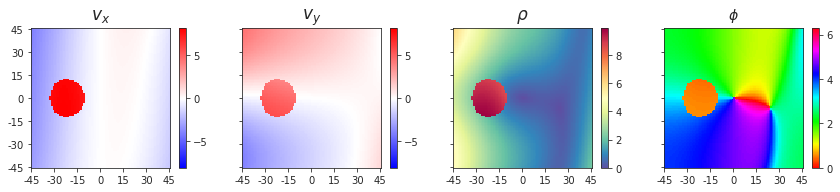

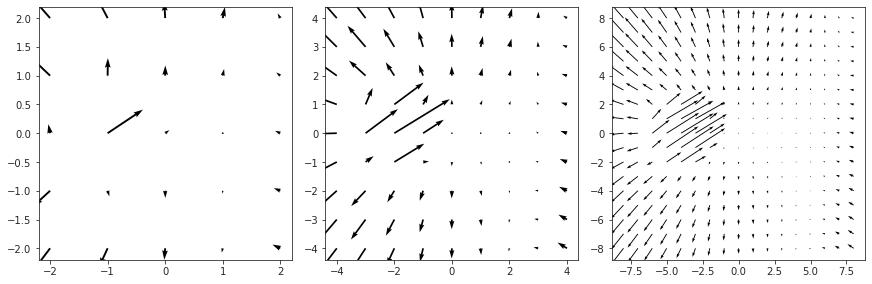

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 0, 0) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

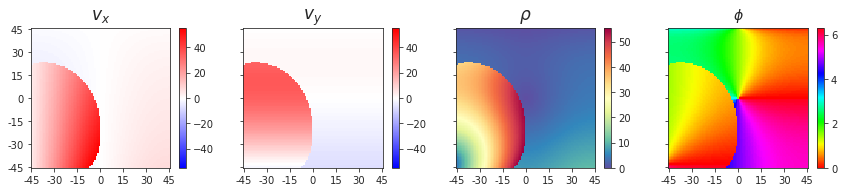

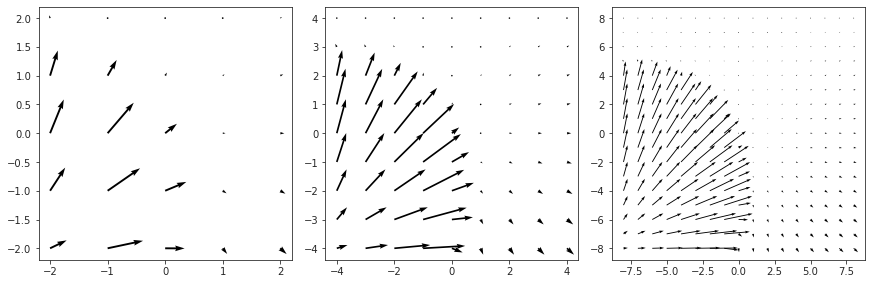

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 0, 1) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

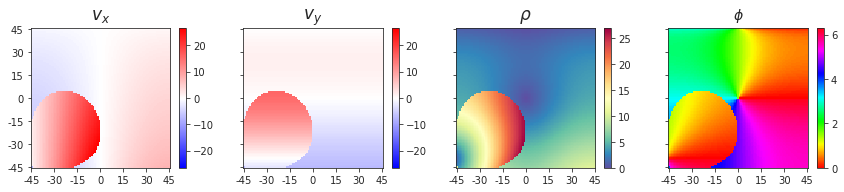

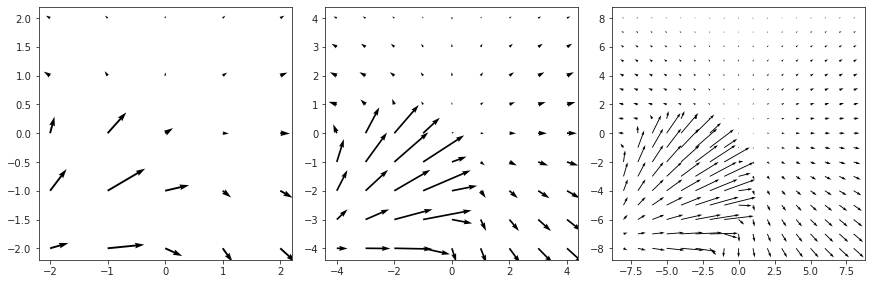

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 0, 2) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

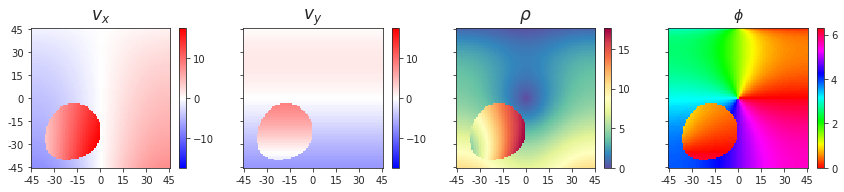

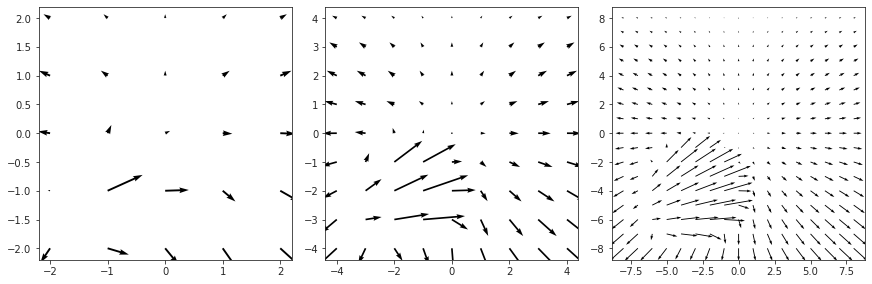

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 0, 3) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

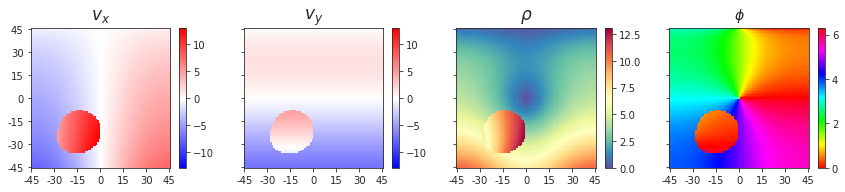

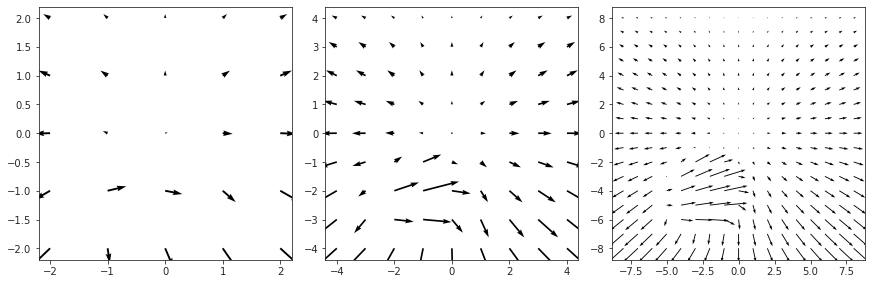

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 0, 4) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

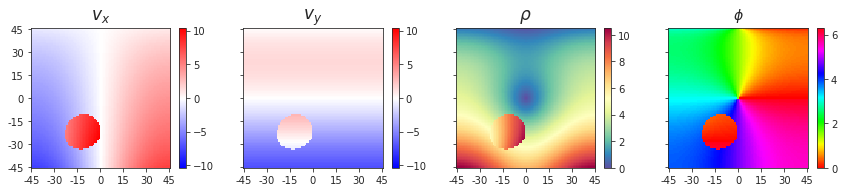

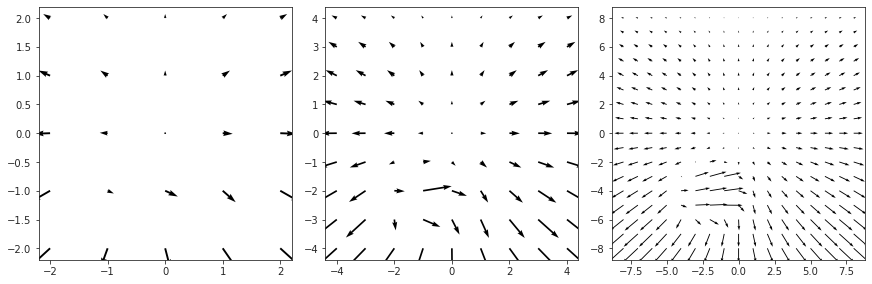

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 0, 5) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

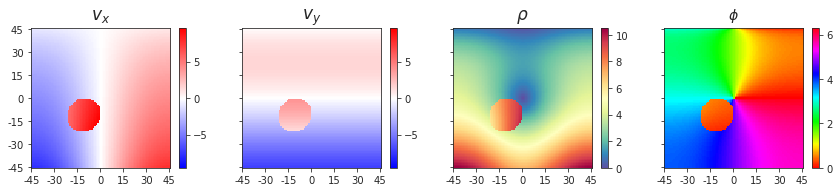

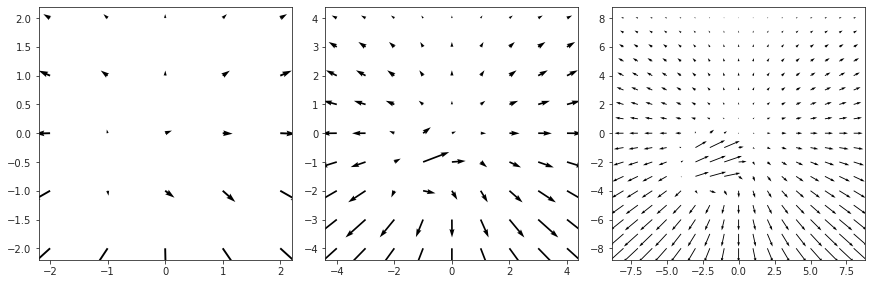

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 0, 6) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 0  0 10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

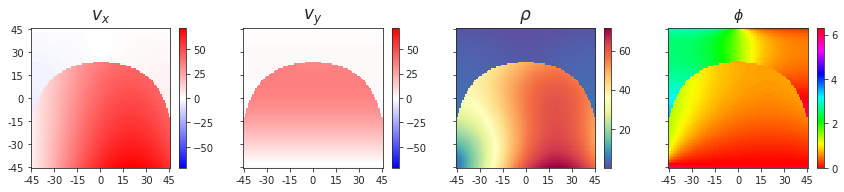

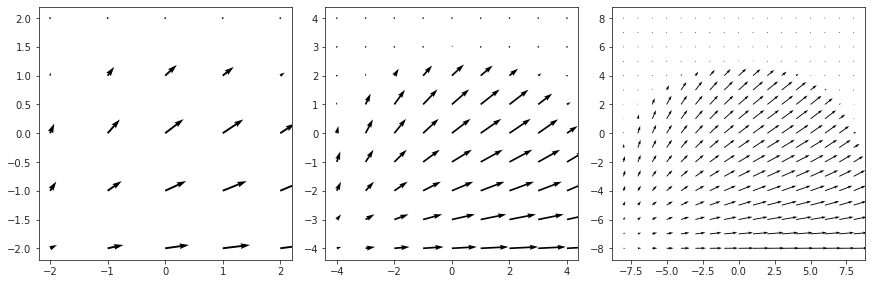

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 0, 7) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 0  0 10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

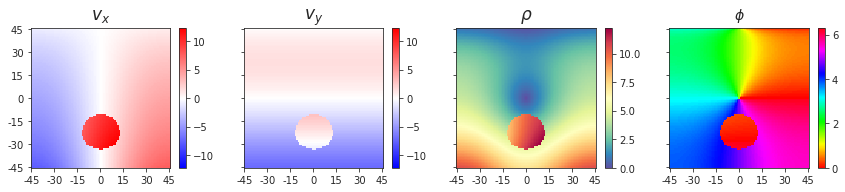

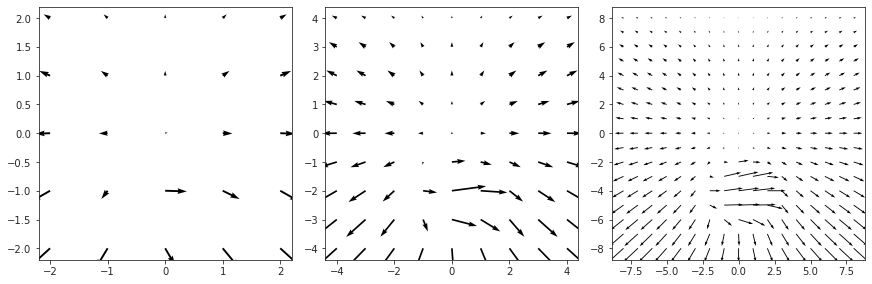

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 0, 8) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 0  0 10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

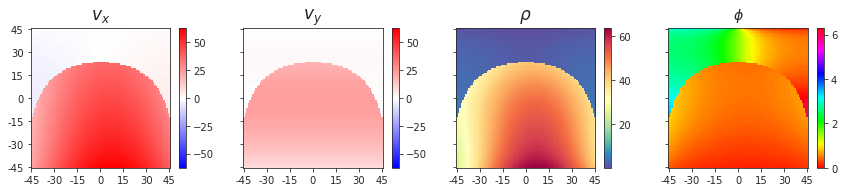

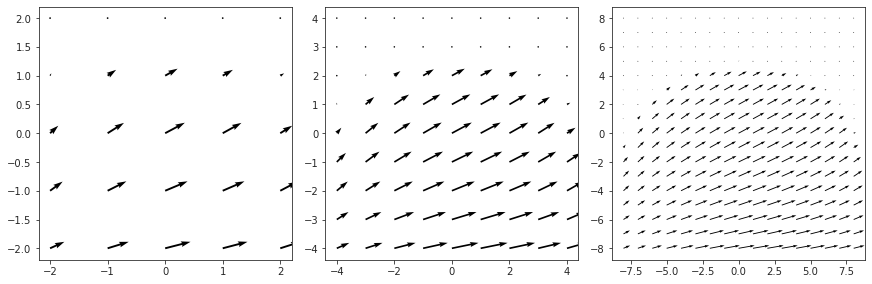

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 0, 9) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 0  0 10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

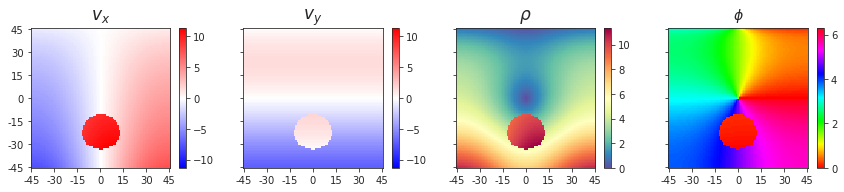

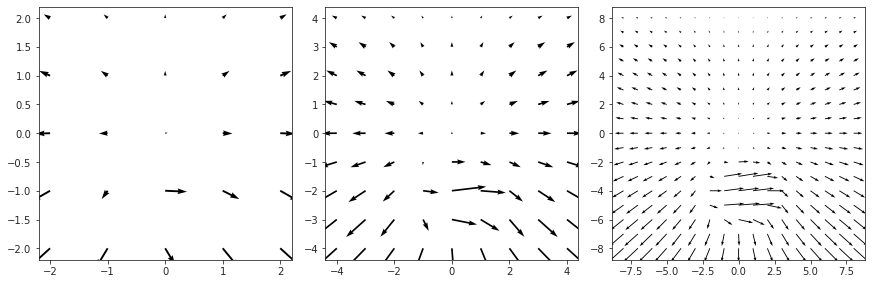

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 1, 0) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

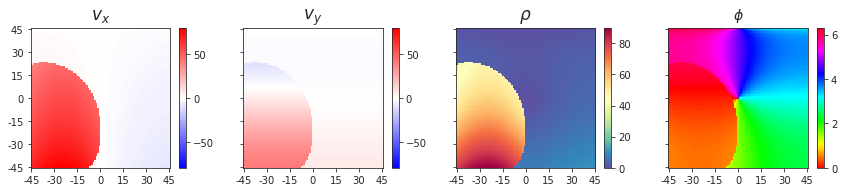

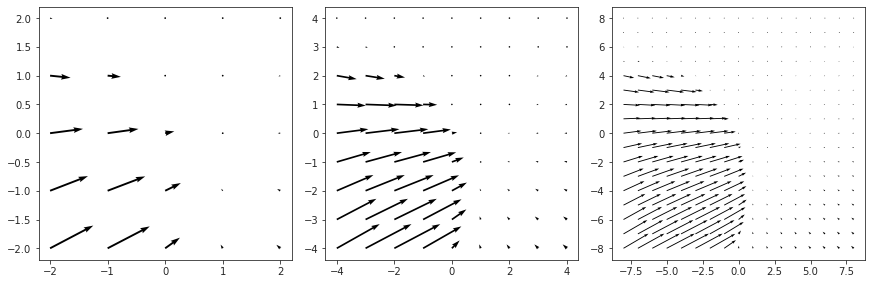

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 1, 1) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

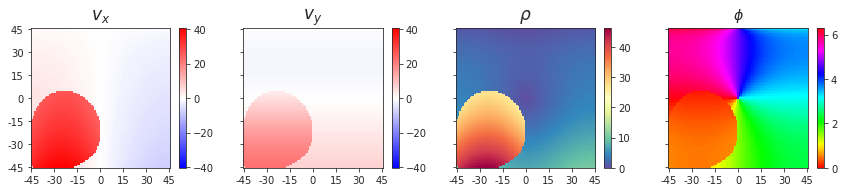

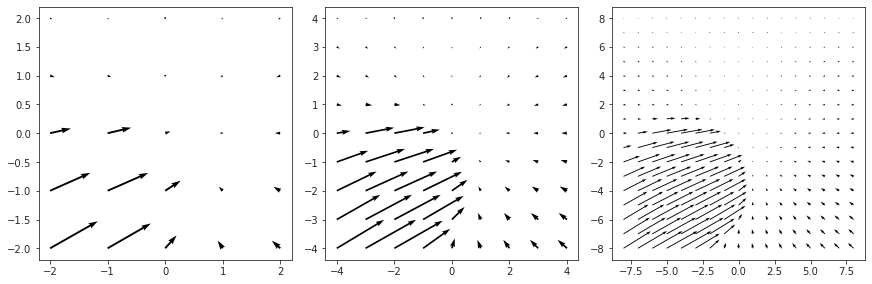

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 1, 2) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

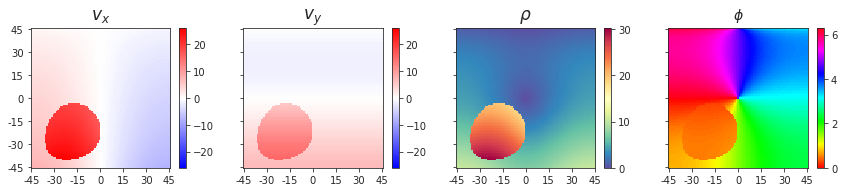

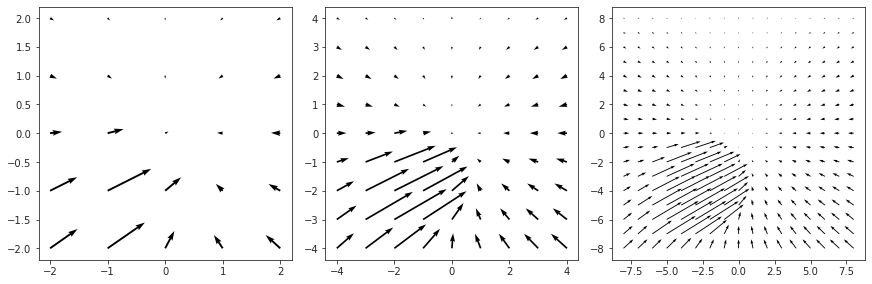

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 1, 3) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

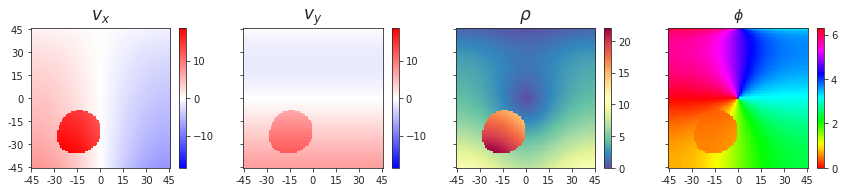

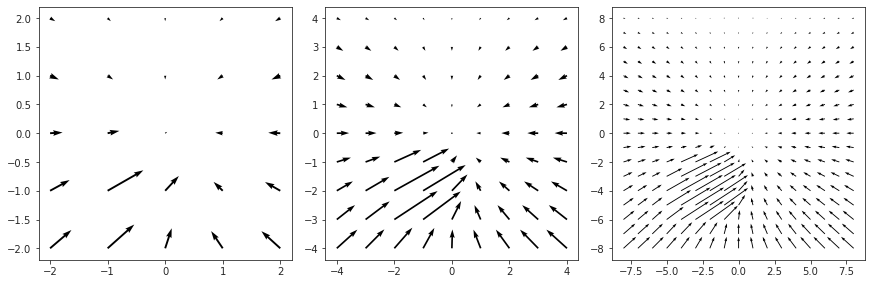

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 1, 4) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

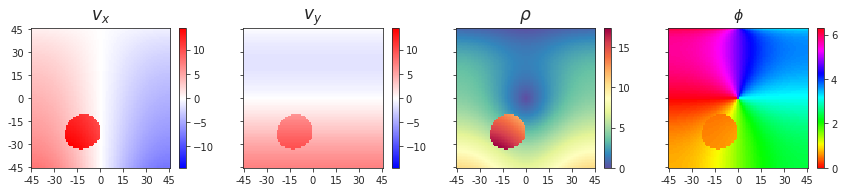

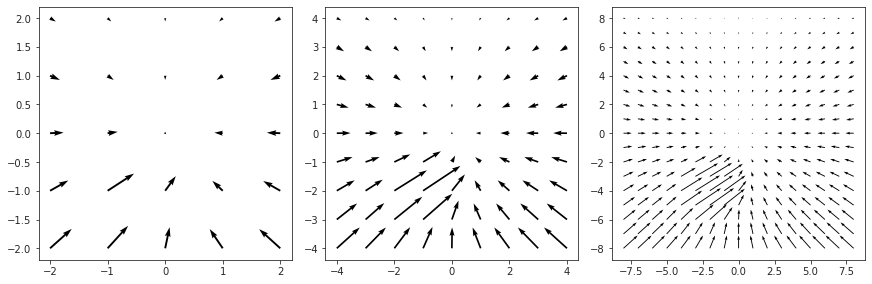

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 1, 5) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

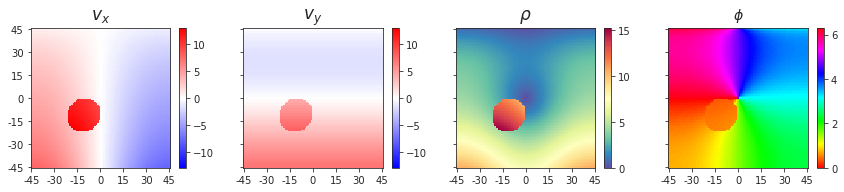

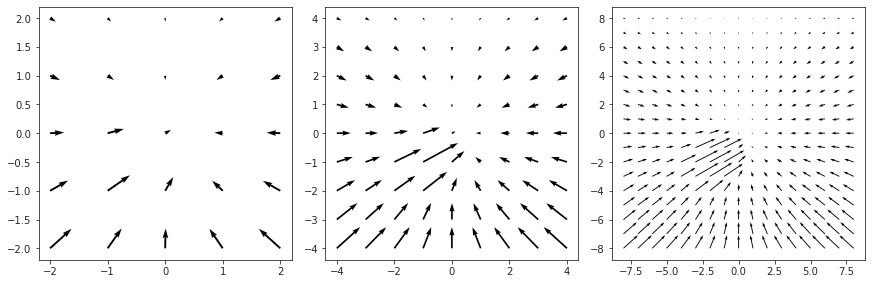

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 1, 6) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [  0   0 -10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

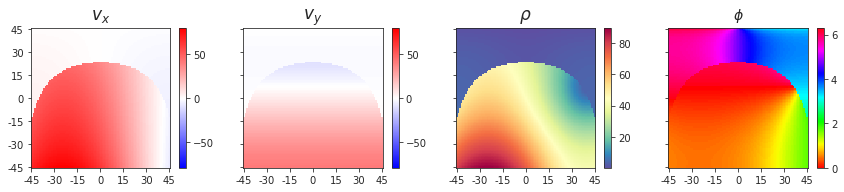

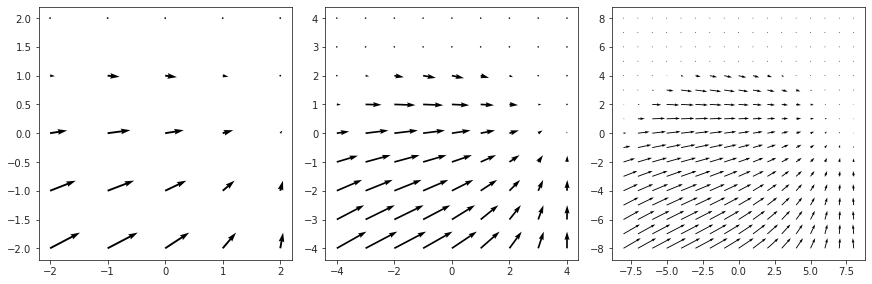

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 1, 7) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [  0   0 -10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

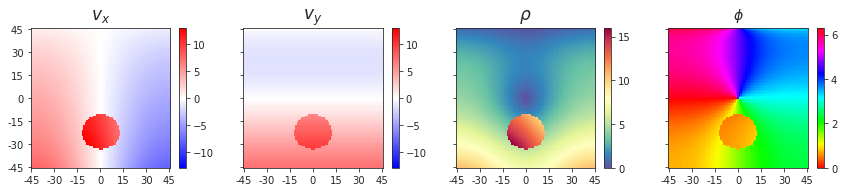

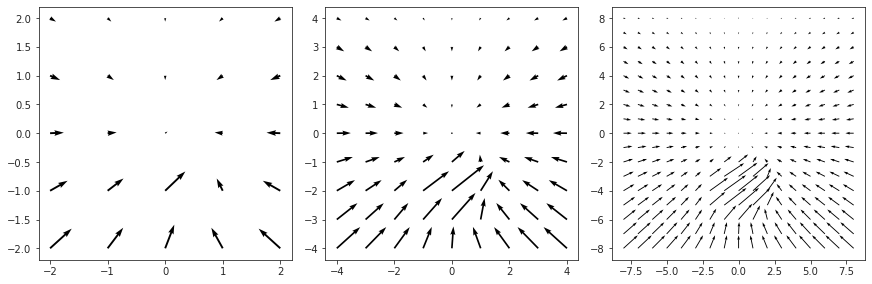

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 1, 8) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [  0   0 -10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

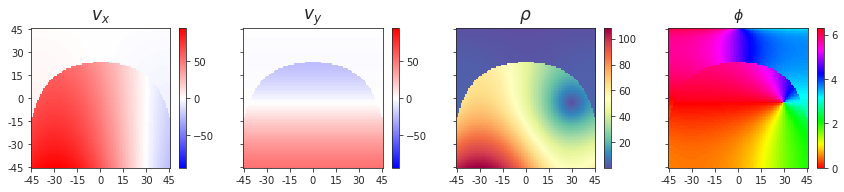

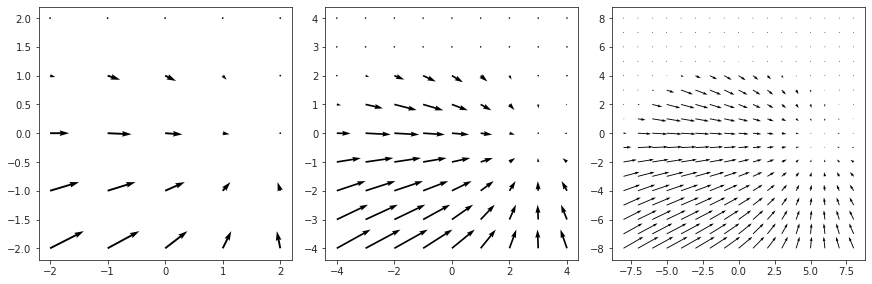

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 1, 9) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [  0   0 -10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

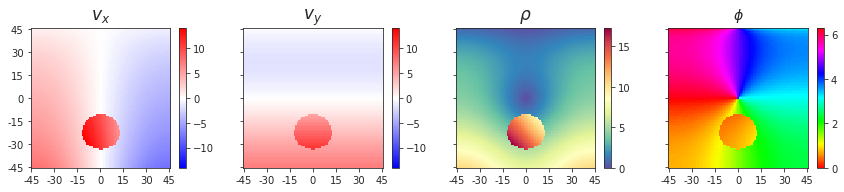

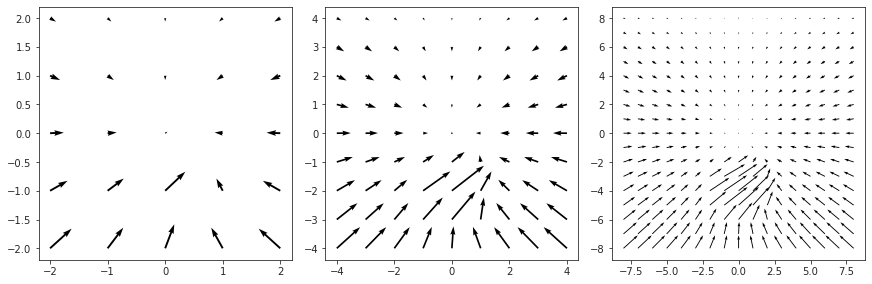

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 2, 0) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

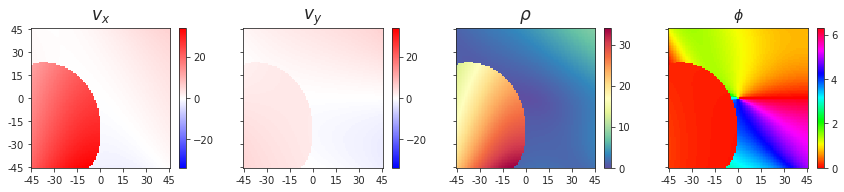

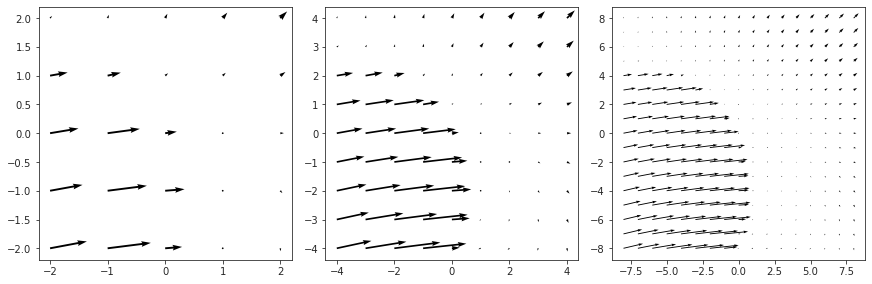

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 2, 1) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

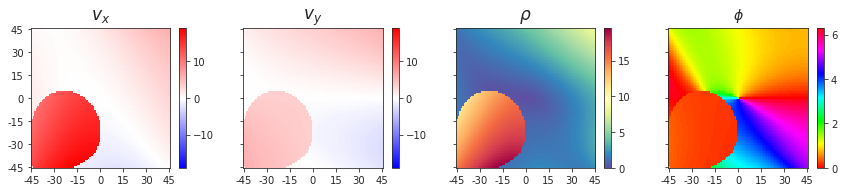

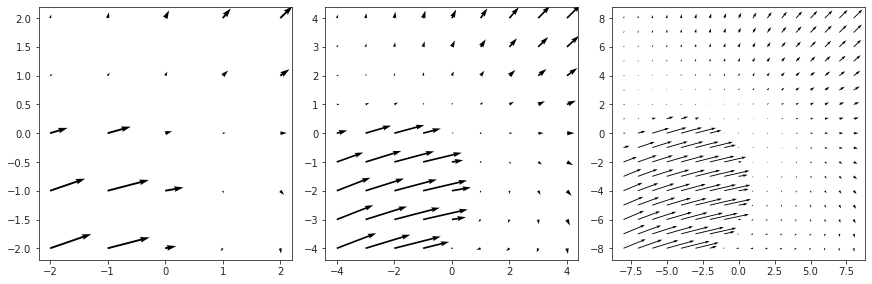

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 2, 2) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

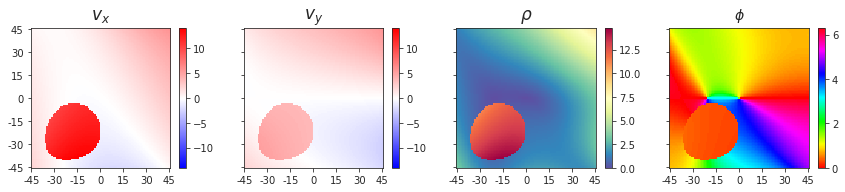

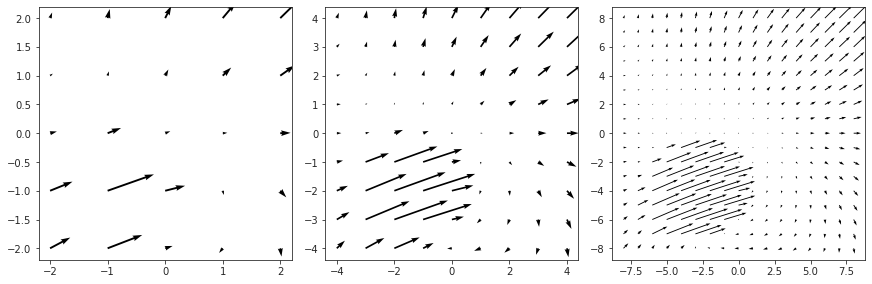

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 2, 3) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

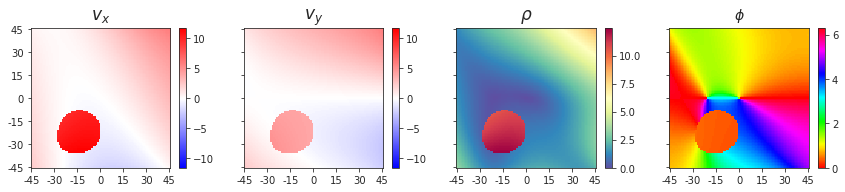

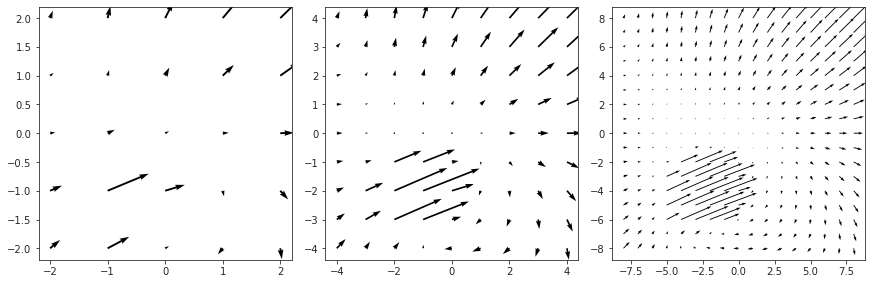

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 2, 4) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

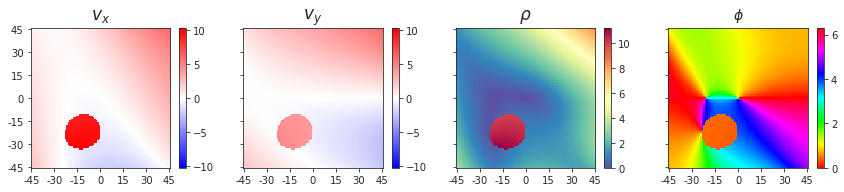

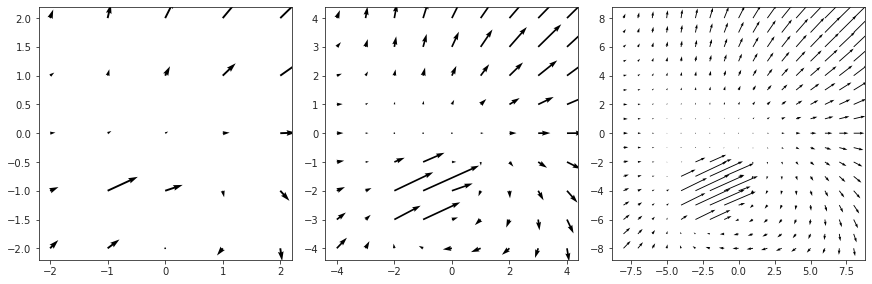

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 2, 5) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

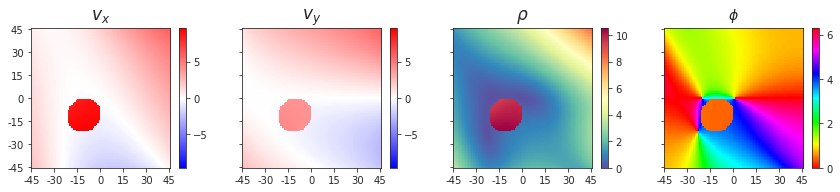

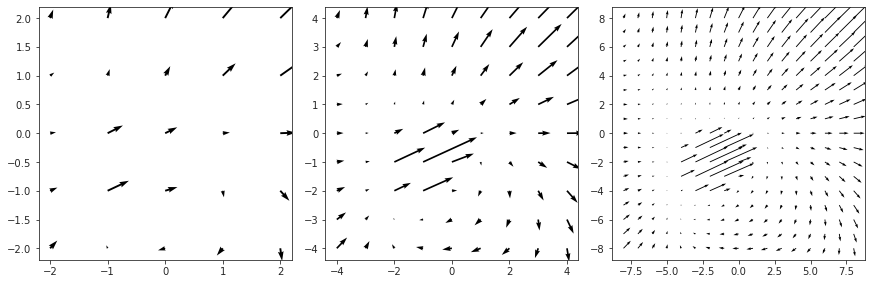

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 2, 6) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [5 5 0]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

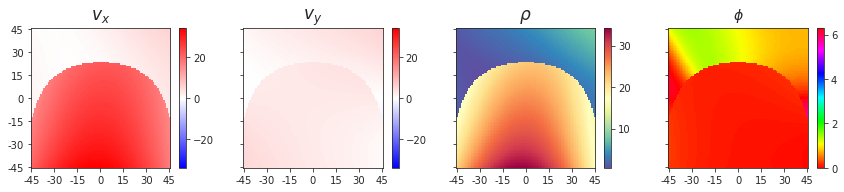

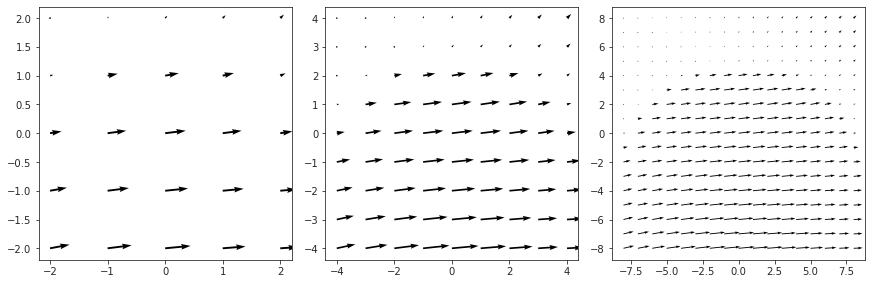

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 2, 7) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [5 5 0]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

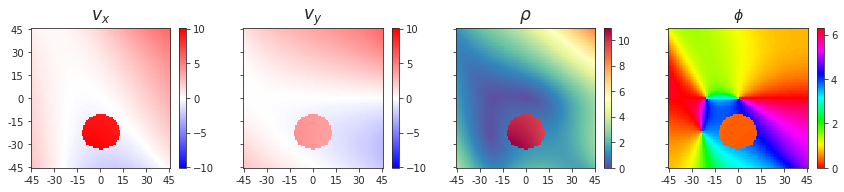

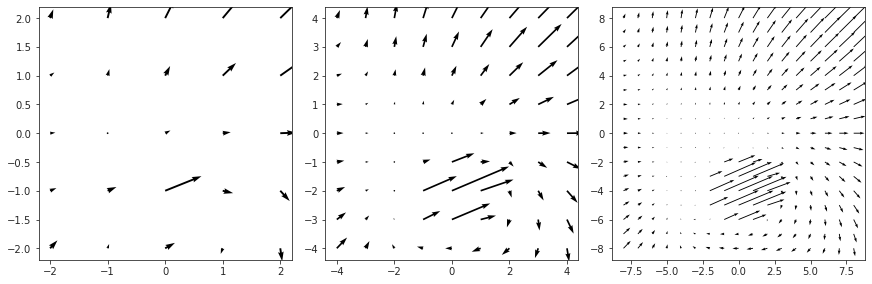

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 2, 8) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [5 5 0]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

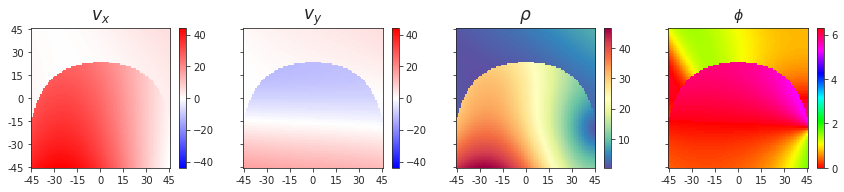

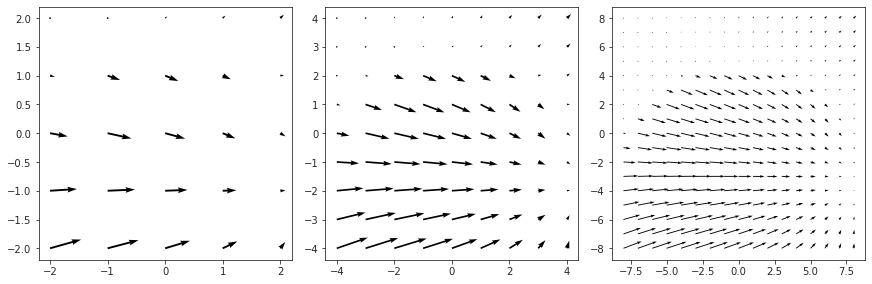

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 2, 9) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [5 5 0]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

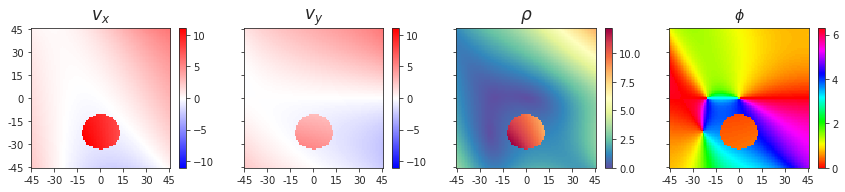

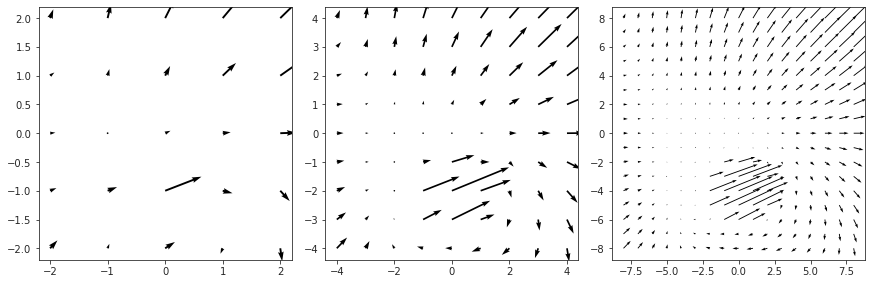

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 3, 0) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

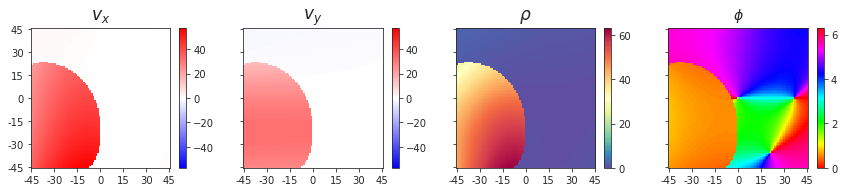

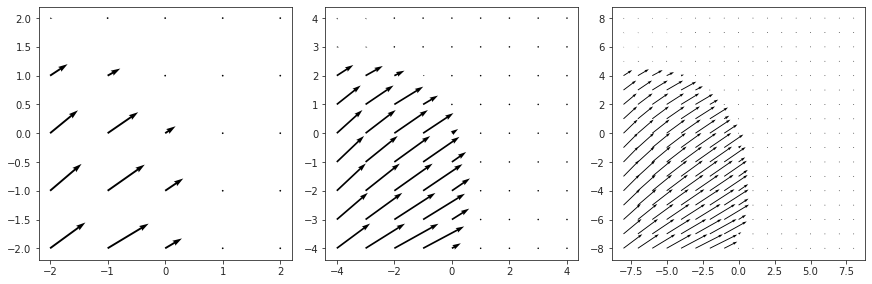

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 3, 1) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

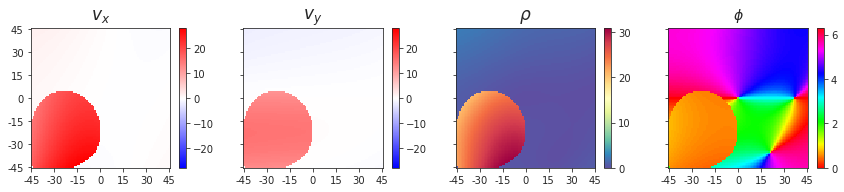

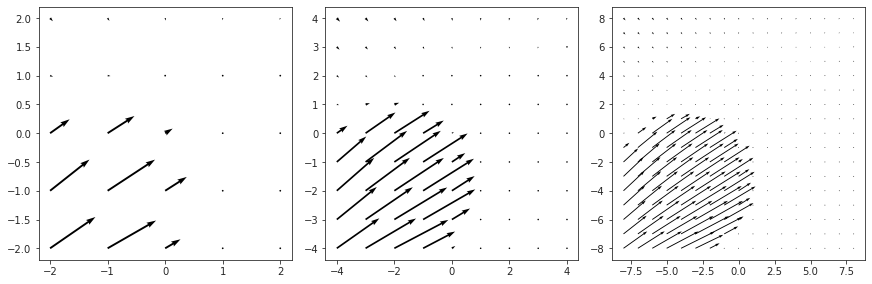

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 3, 2) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

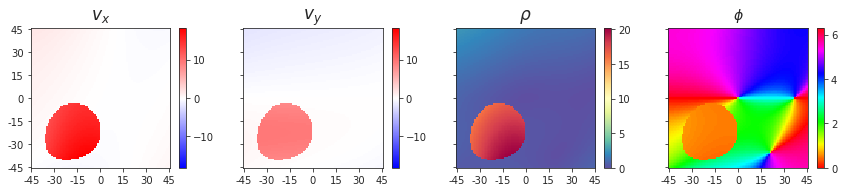

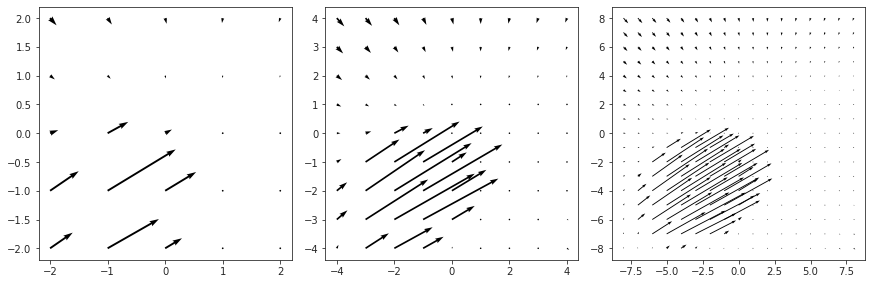

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 3, 3) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

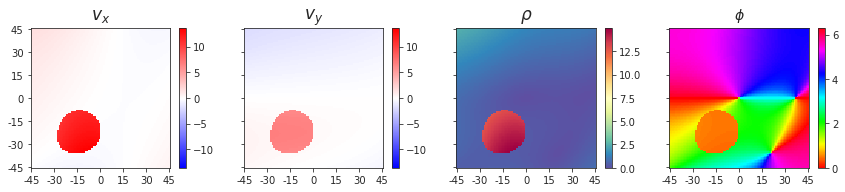

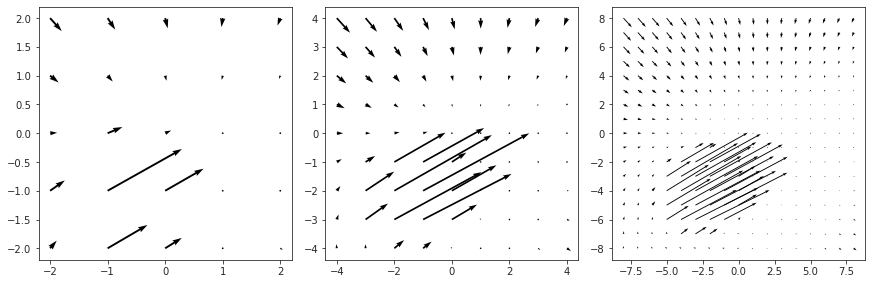

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 3, 4) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

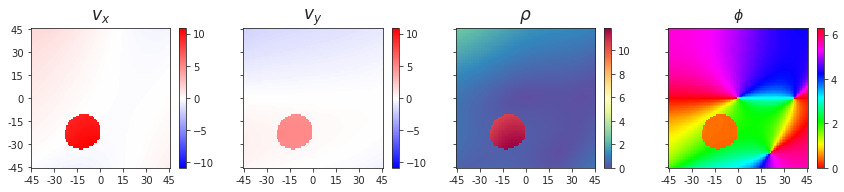

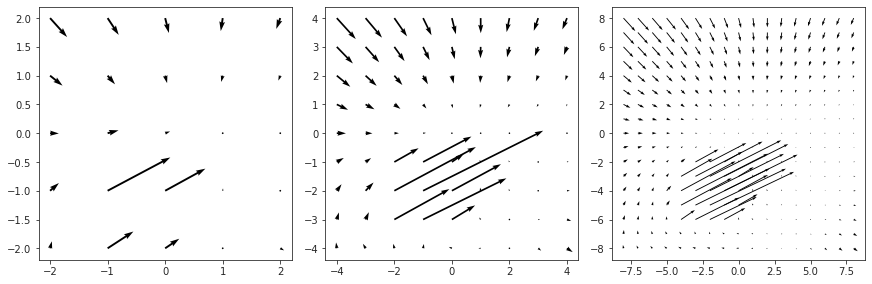

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 3, 5) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

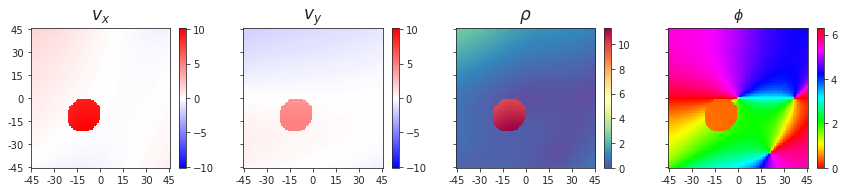

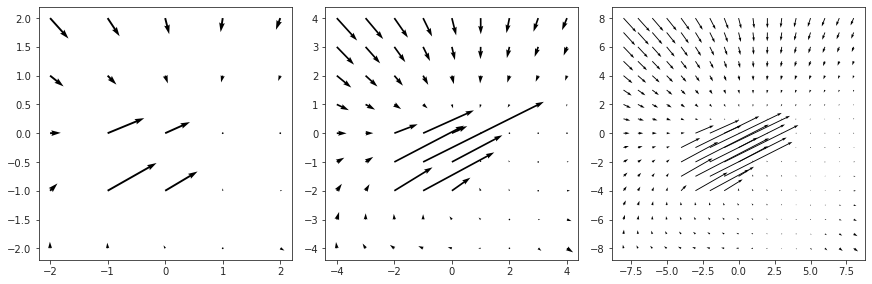

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 3, 6) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 1 -2  0]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

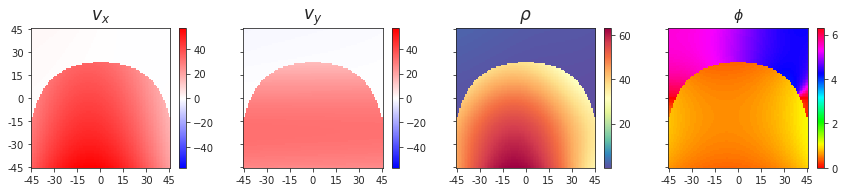

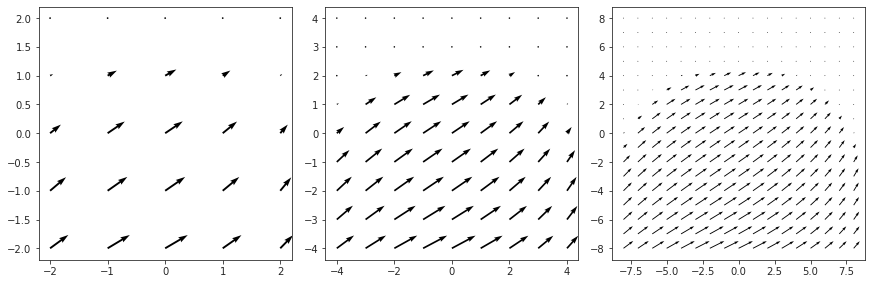

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 3, 7) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 1 -2  0]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

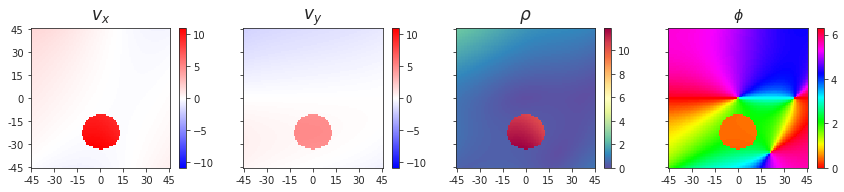

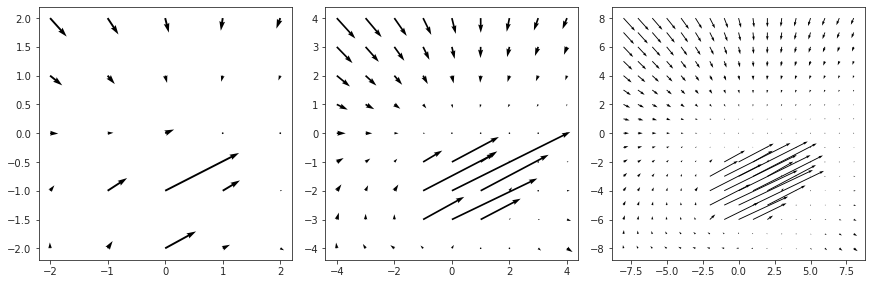

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 3, 8) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 1 -2  0]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

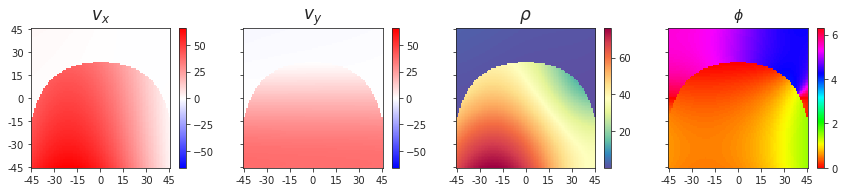

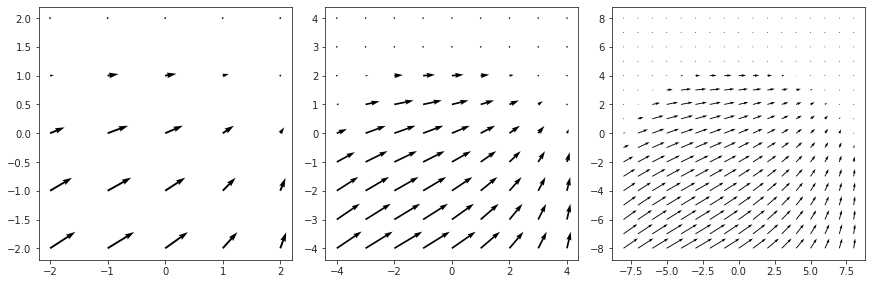

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 3, 9) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 1 -2  0]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

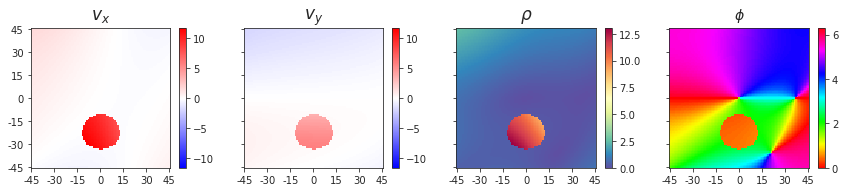

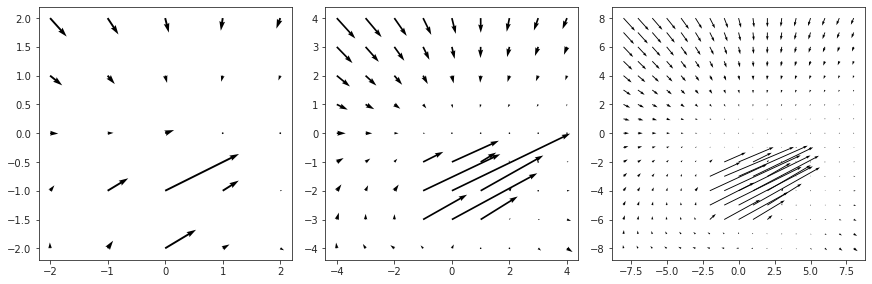

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 4, 0) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

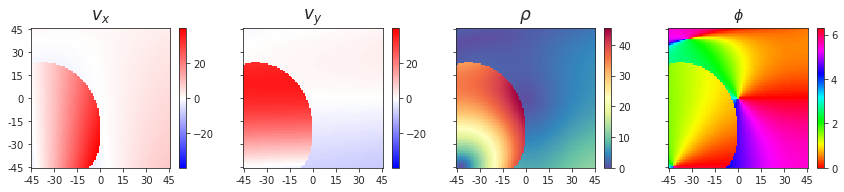

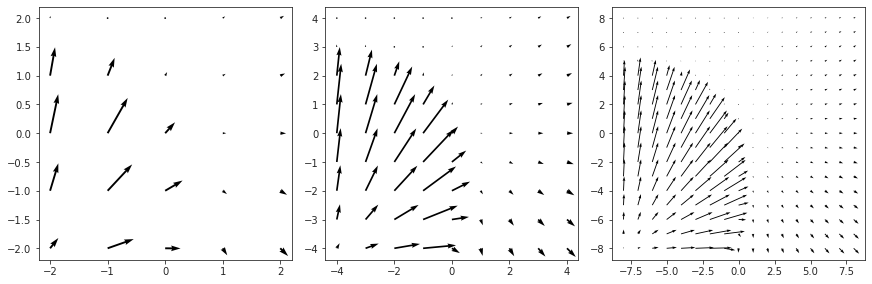

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 4, 1) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

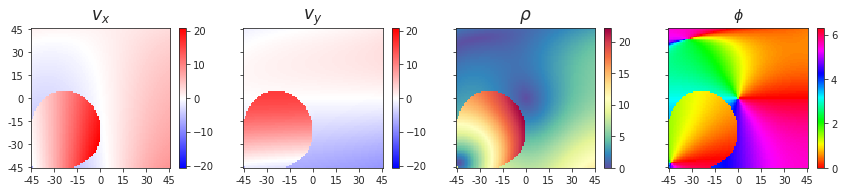

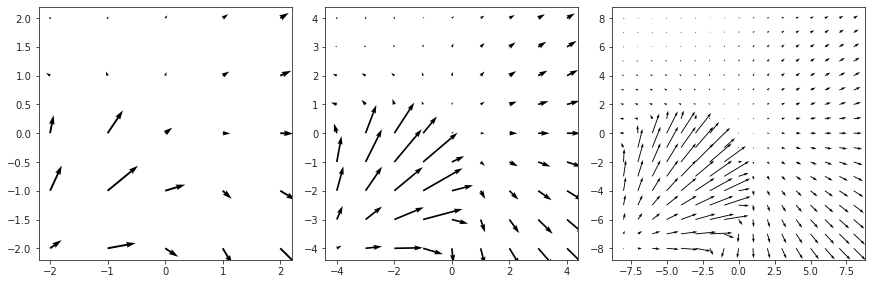

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 4, 2) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

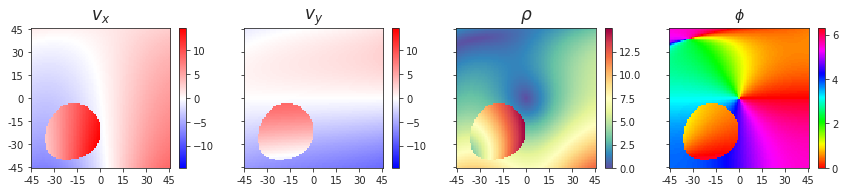

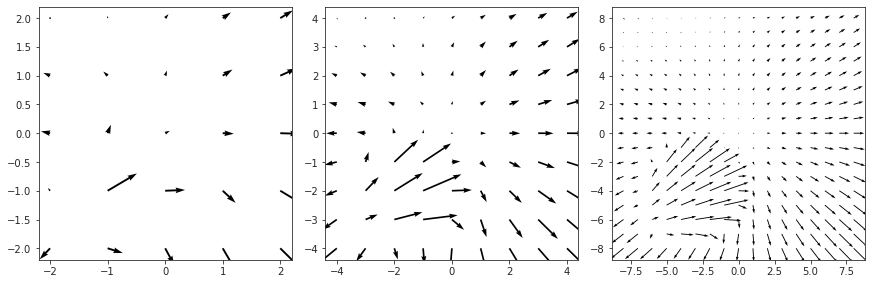

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 4, 3) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

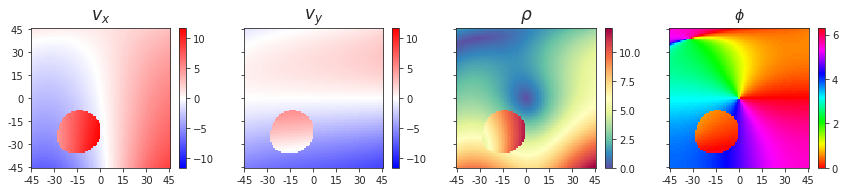

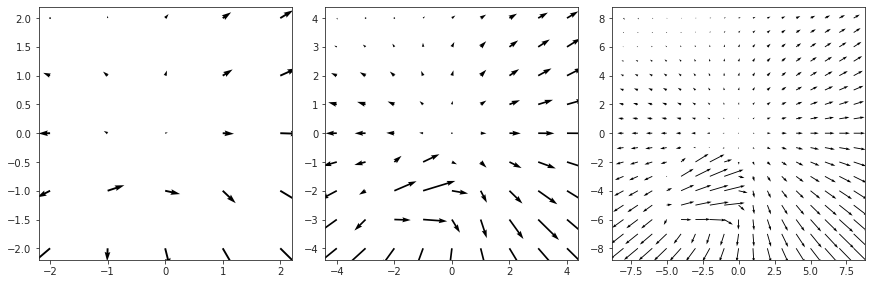

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 4, 4) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

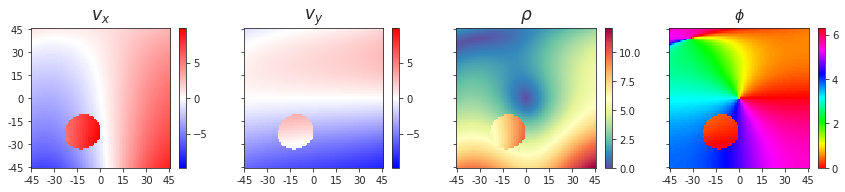

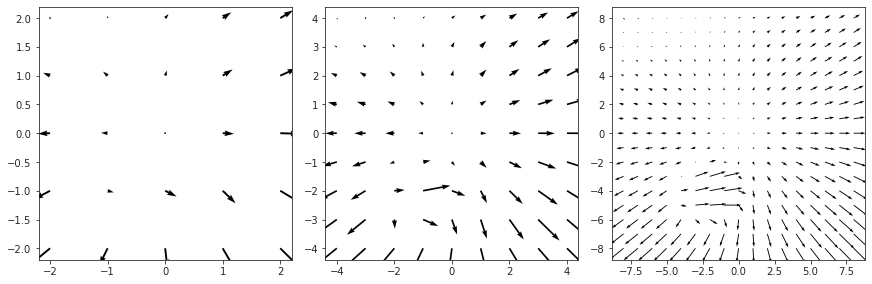

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 4, 5) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

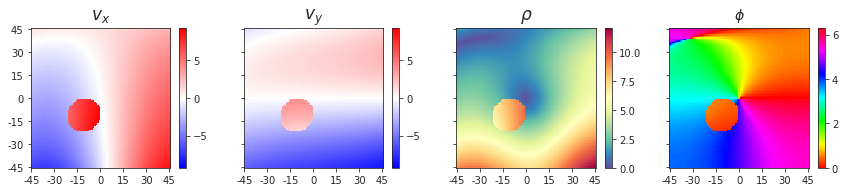

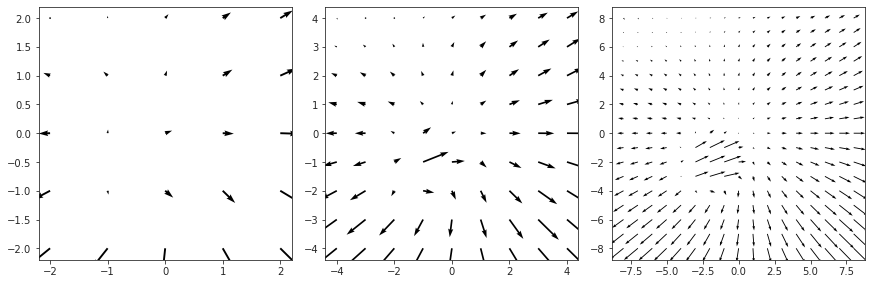

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 4, 6) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 3  0 10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

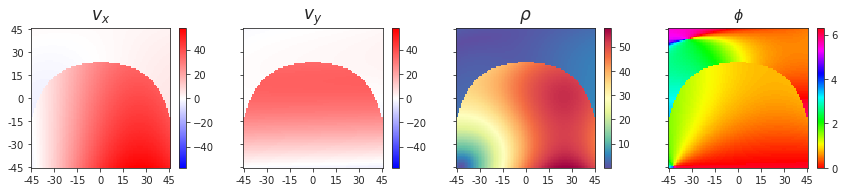

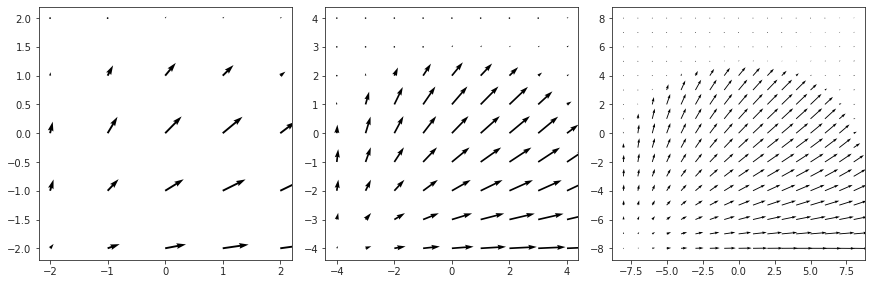

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 4, 7) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 3  0 10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

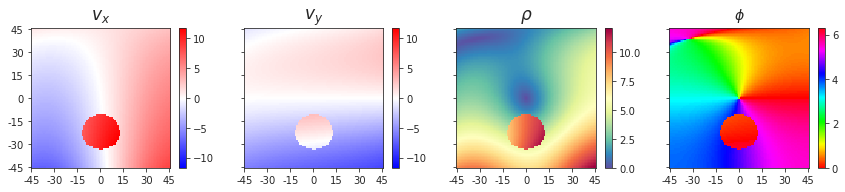

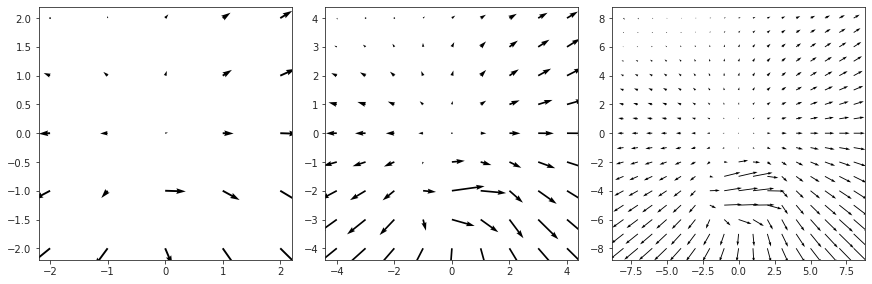

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 4, 8) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 3  0 10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

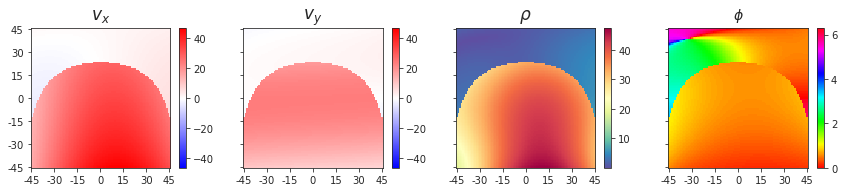

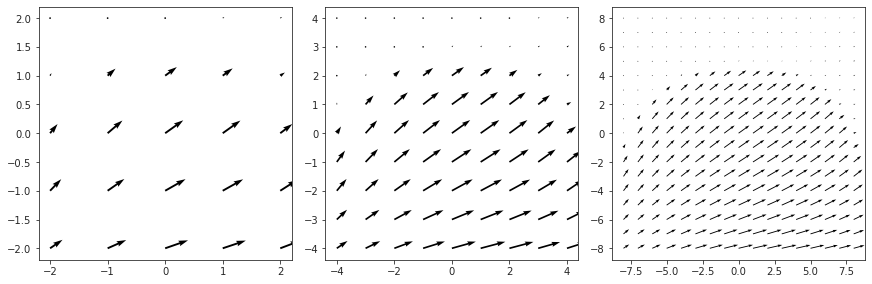

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 4, 9) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [ 3  0 10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

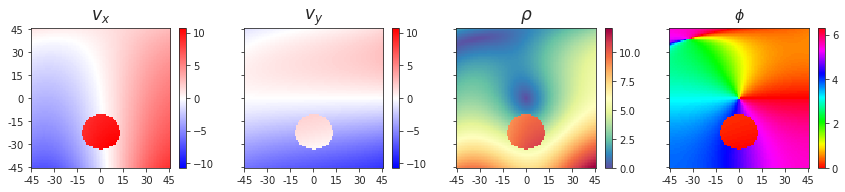

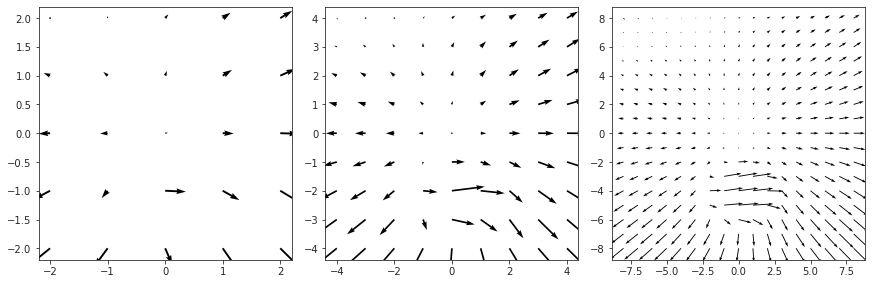

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 5, 0) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

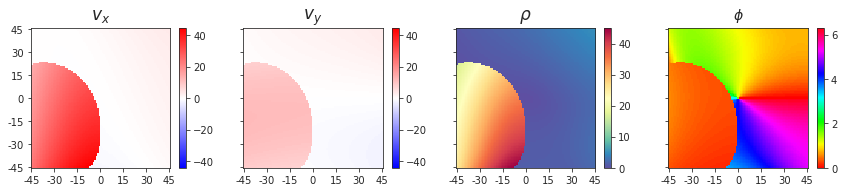

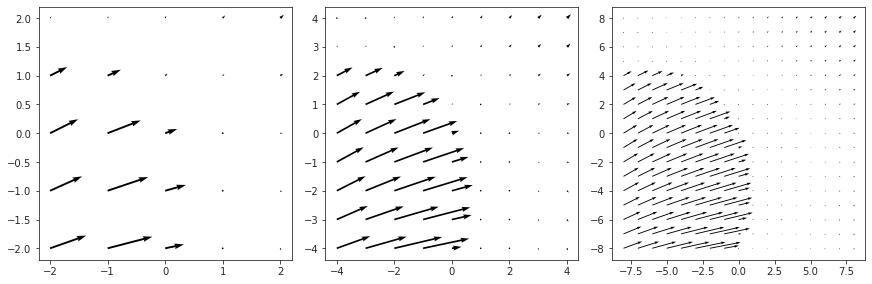

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 5, 1) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

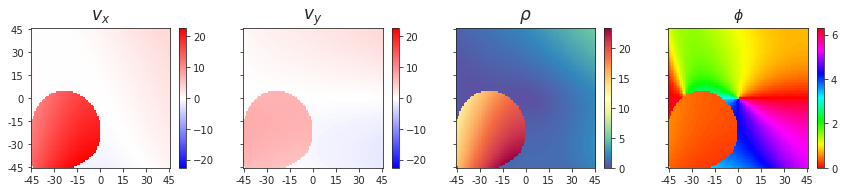

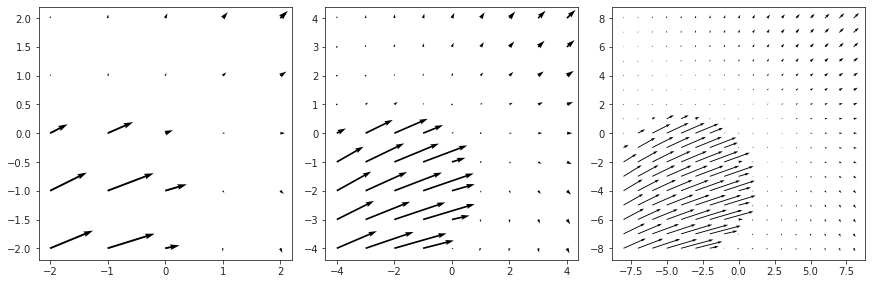

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 5, 2) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

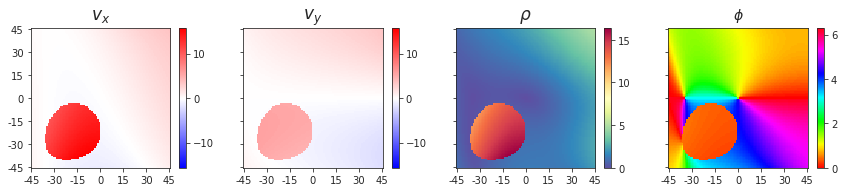

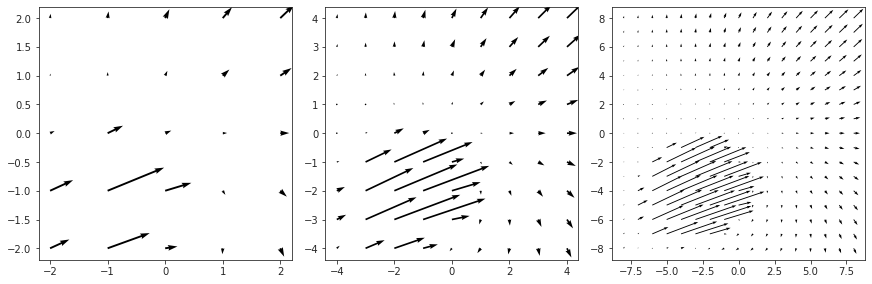

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 5, 3) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

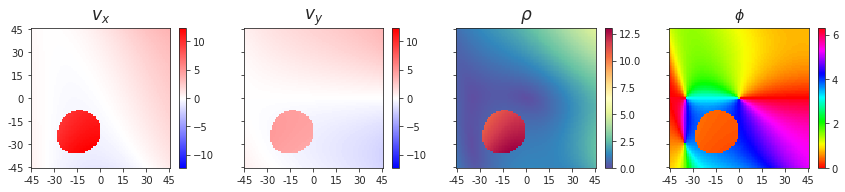

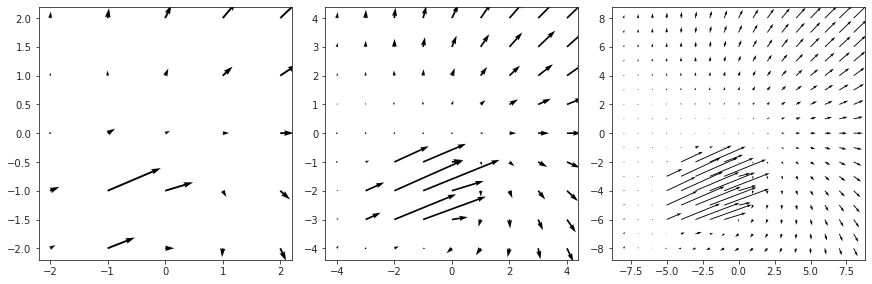

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 5, 4) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

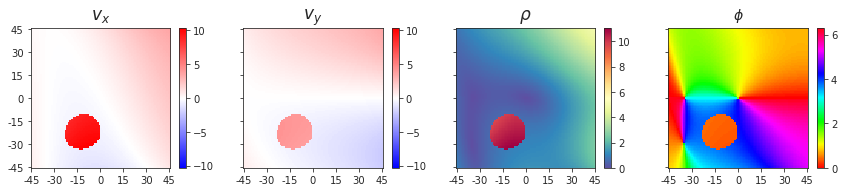

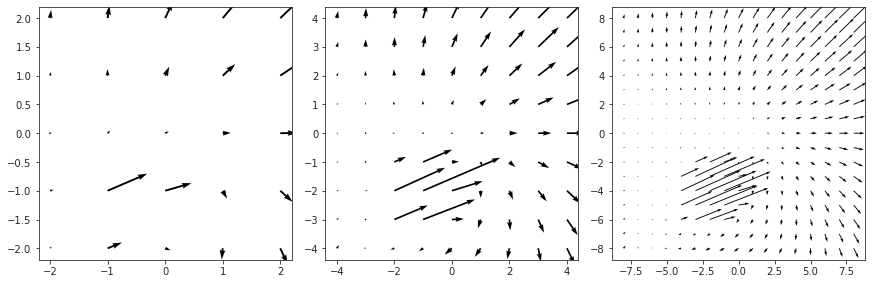

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 5, 5) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

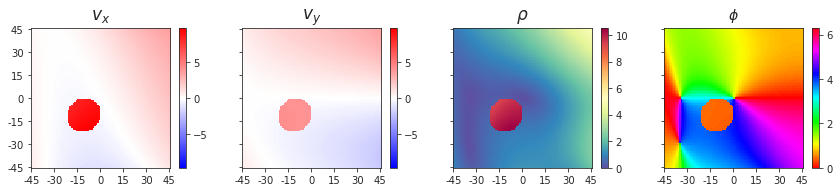

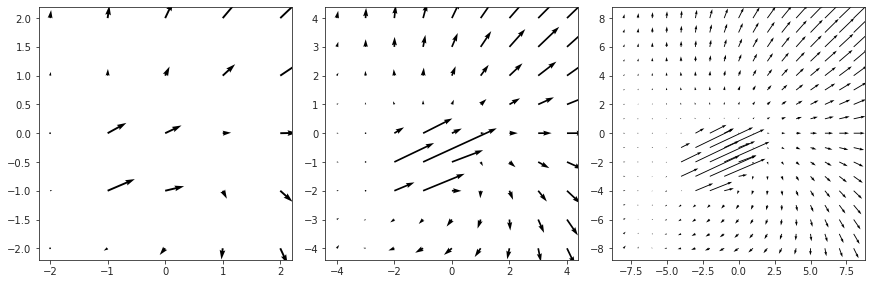

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 5, 6) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [3 3 1]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

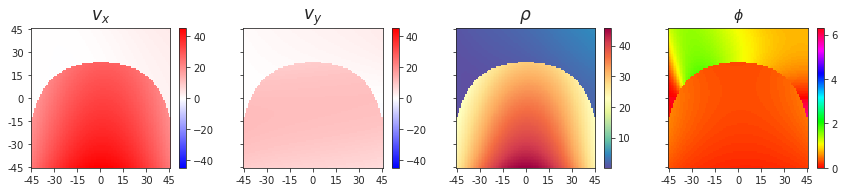

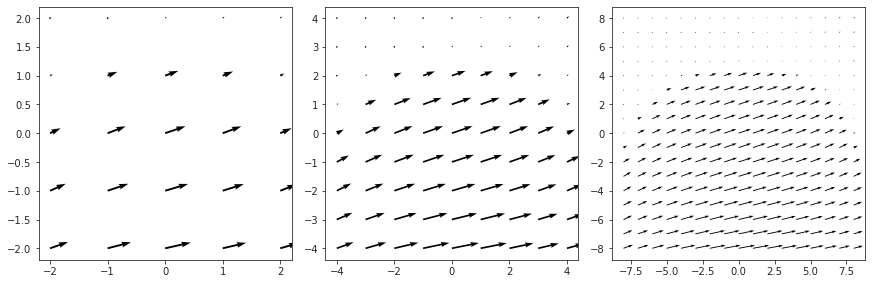

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 5, 7) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [3 3 1]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

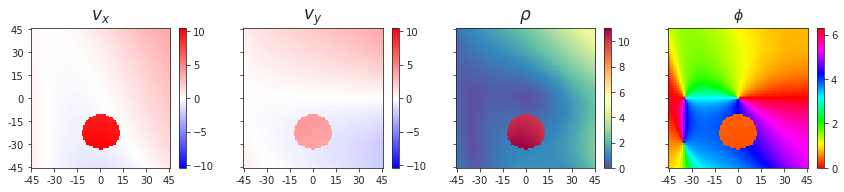

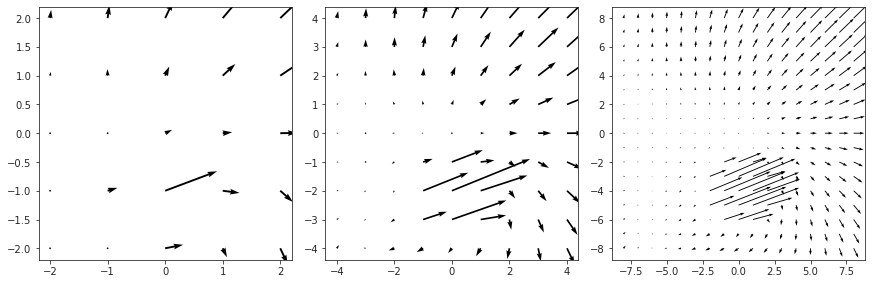

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 5, 8) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [3 3 1]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

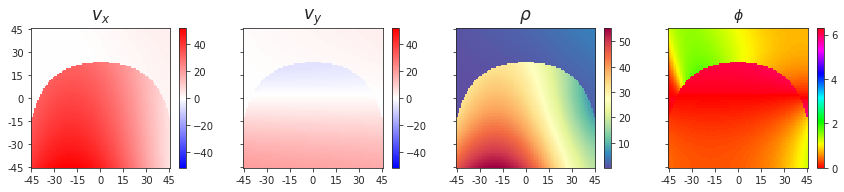

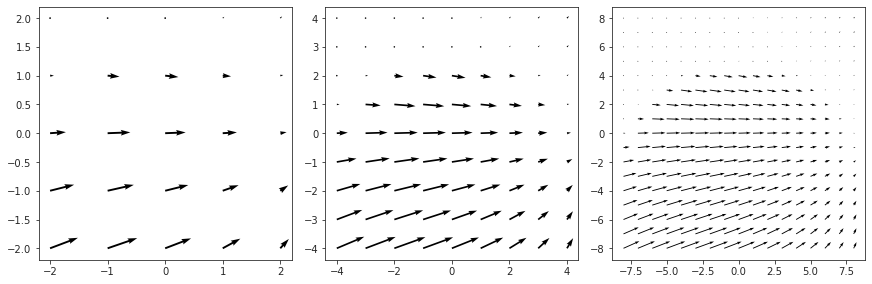

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 5, 9) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [3 3 1]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

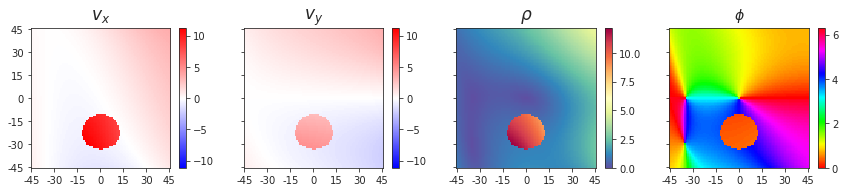

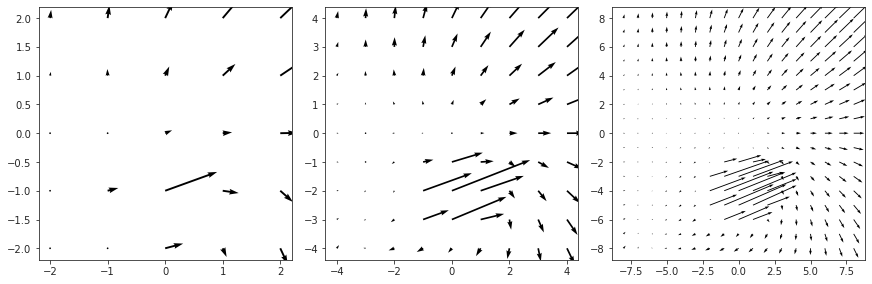

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 6, 0) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

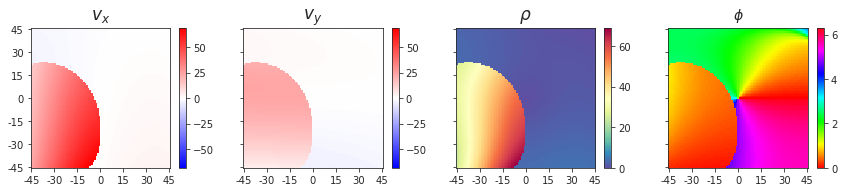

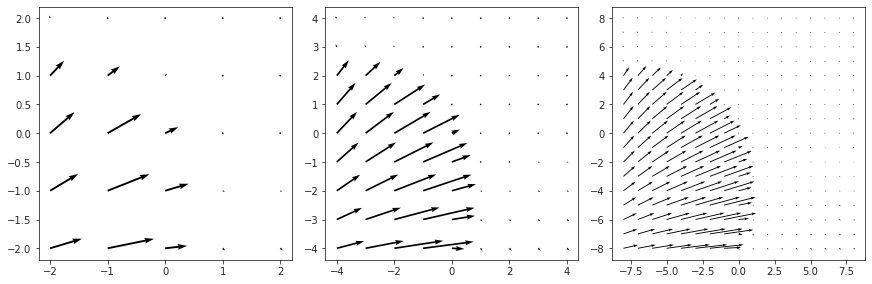

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 6, 1) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

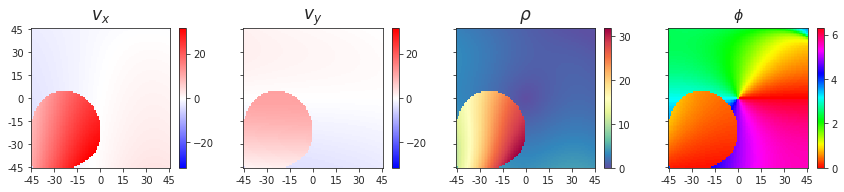

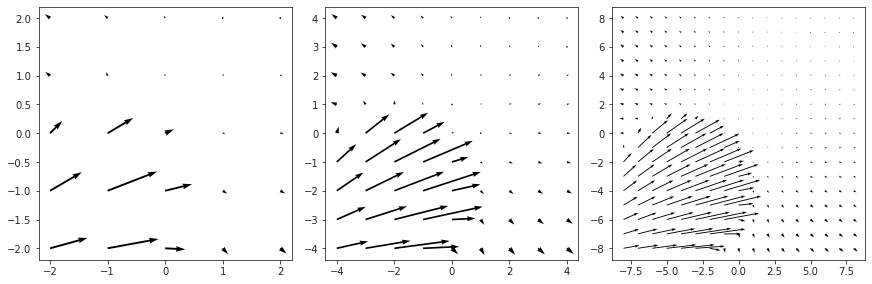

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 6, 2) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

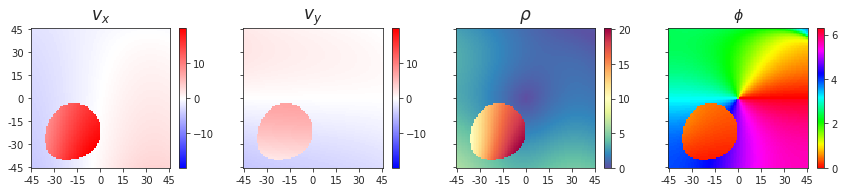

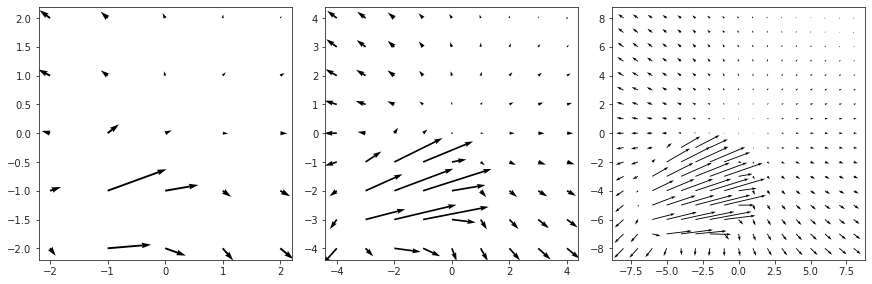

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 6, 3) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

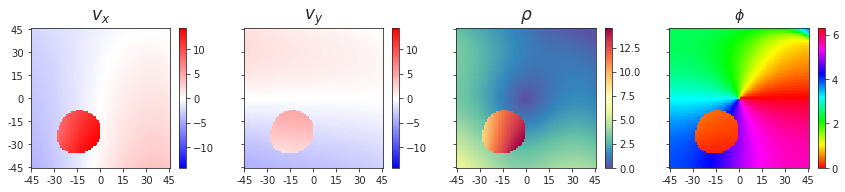

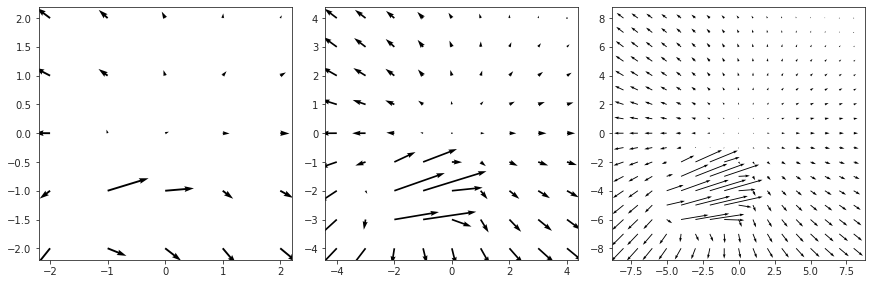

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 6, 4) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

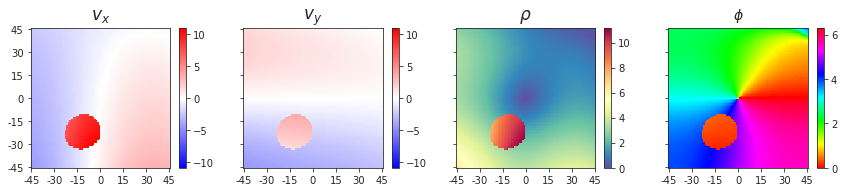

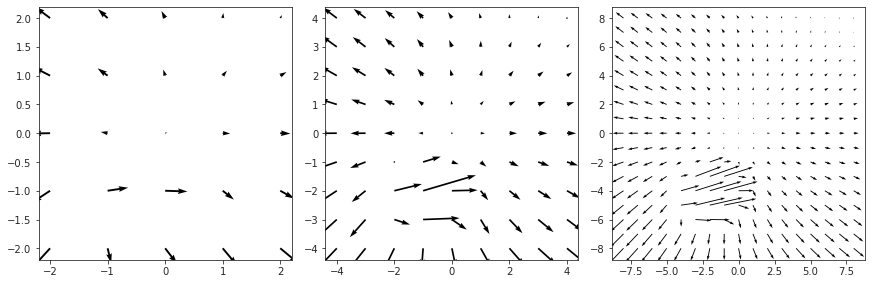

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 6, 5) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

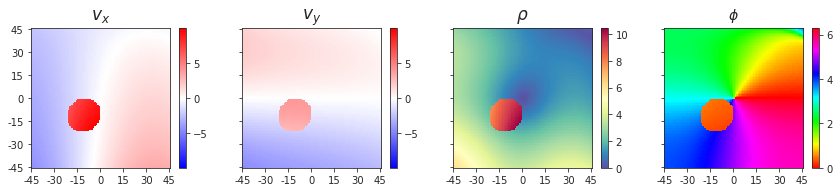

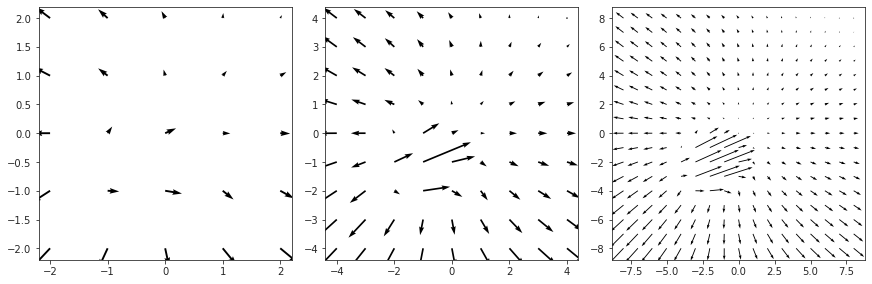

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 6, 6) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [-2  1  5]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

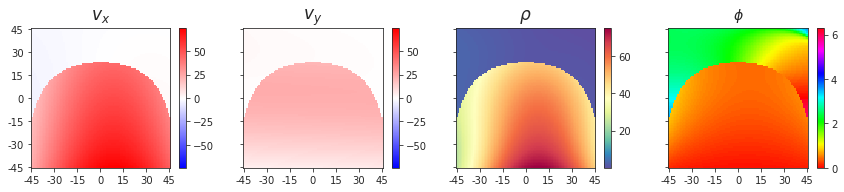

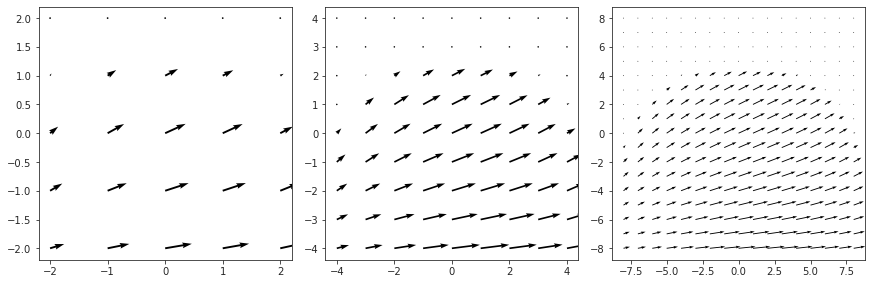

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 6, 7) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [-2  1  5]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

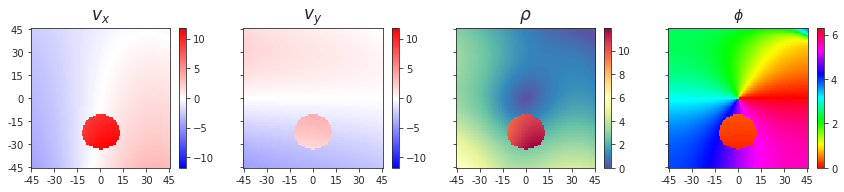

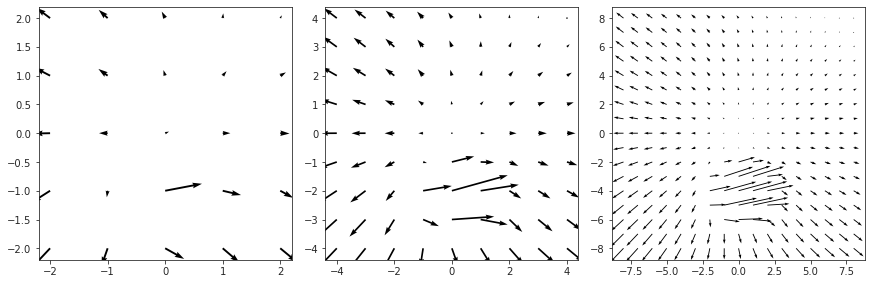

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 6, 8) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [-2  1  5]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

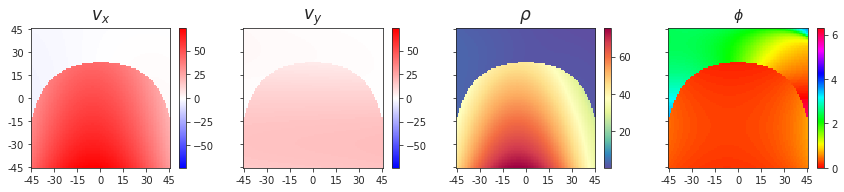

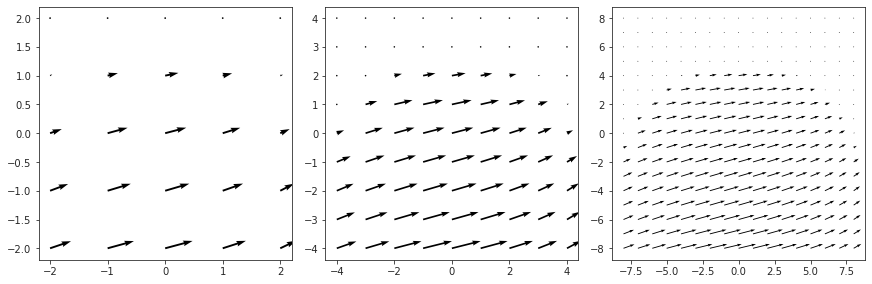

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (2, 6, 9) >>>
self . . . fixation: [0.  0.4 1. ],  v_self: [-2  1  5]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

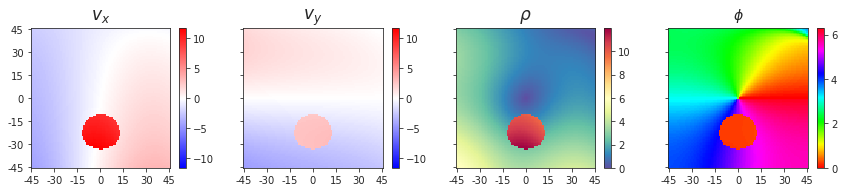

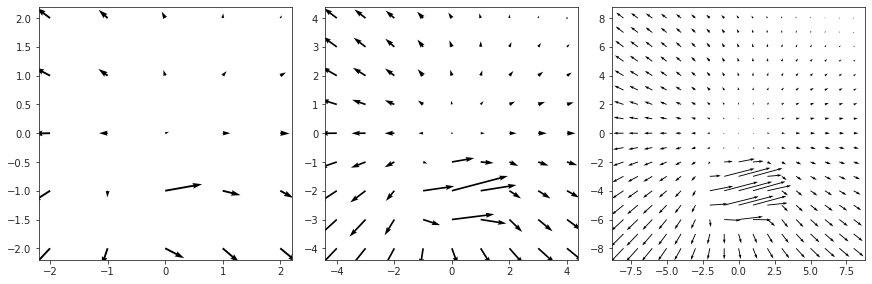

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 0, 0) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

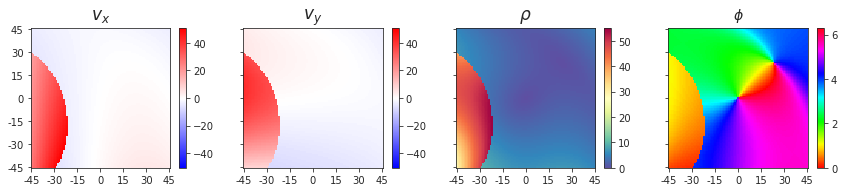

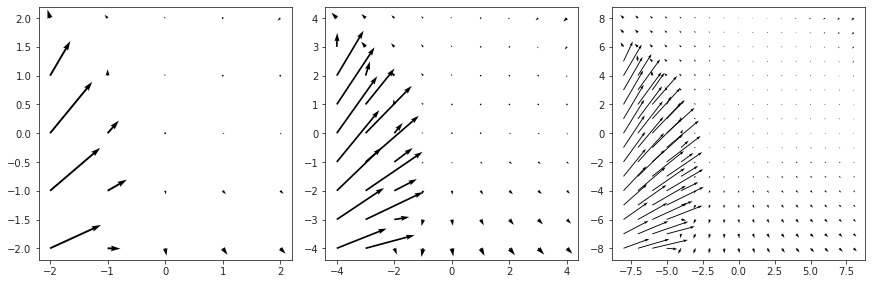

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 0, 1) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

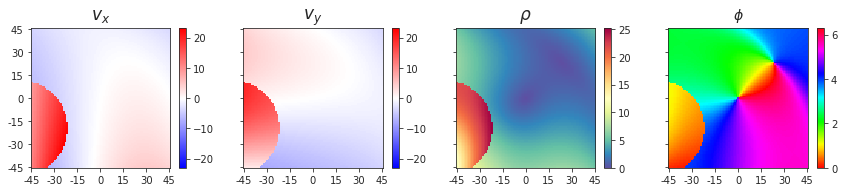

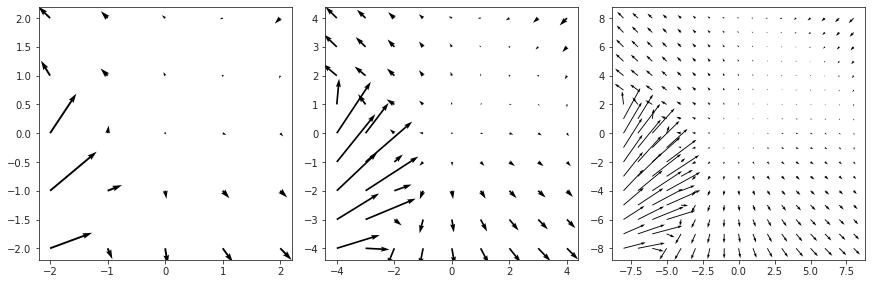

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 0, 2) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

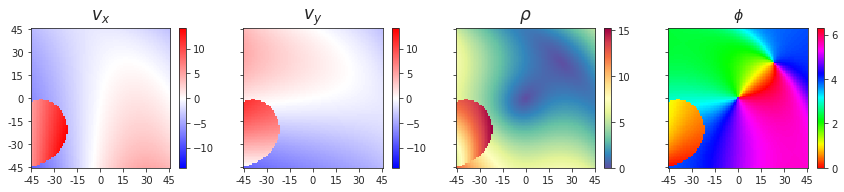

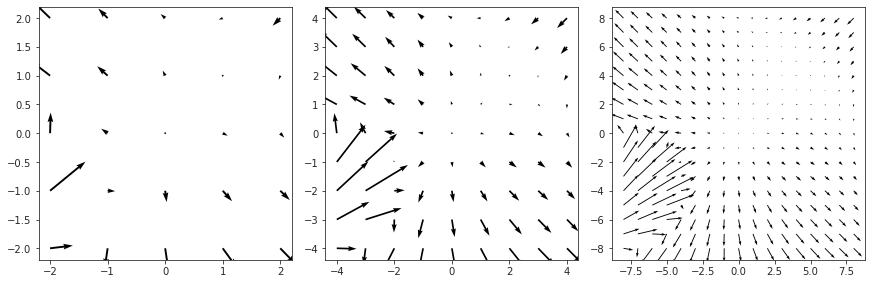

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 0, 3) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

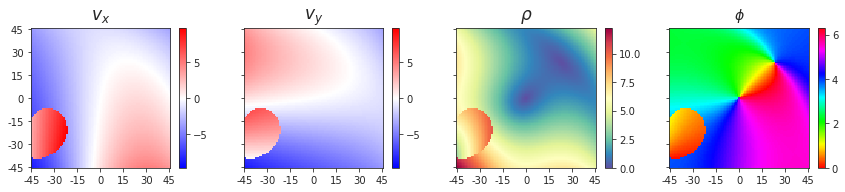

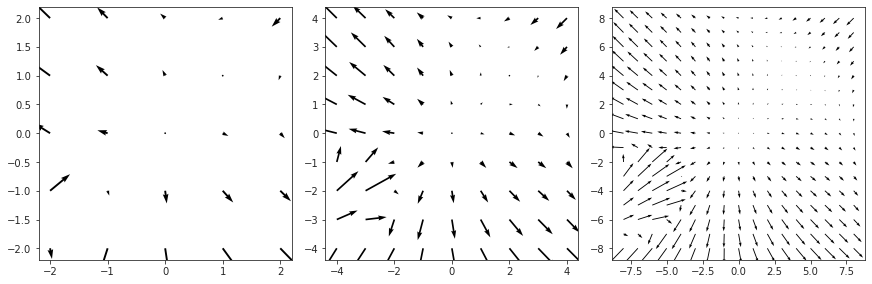

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 0, 4) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

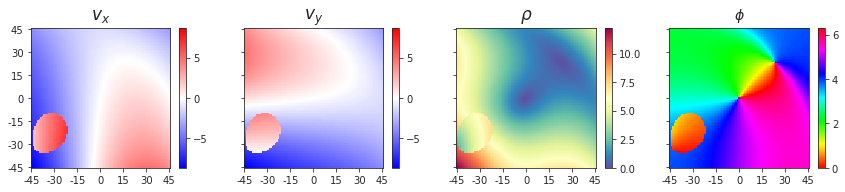

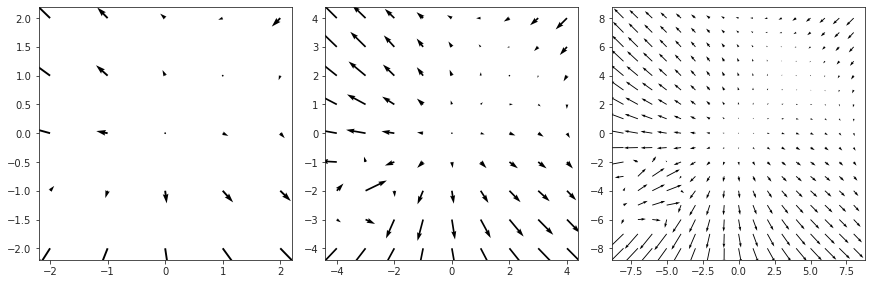

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 0, 5) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

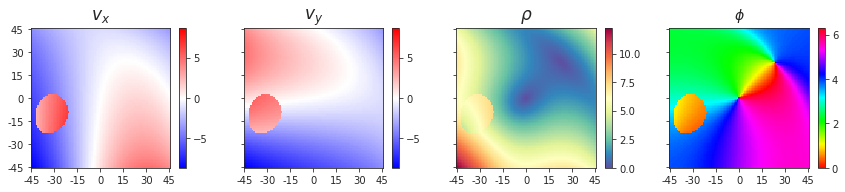

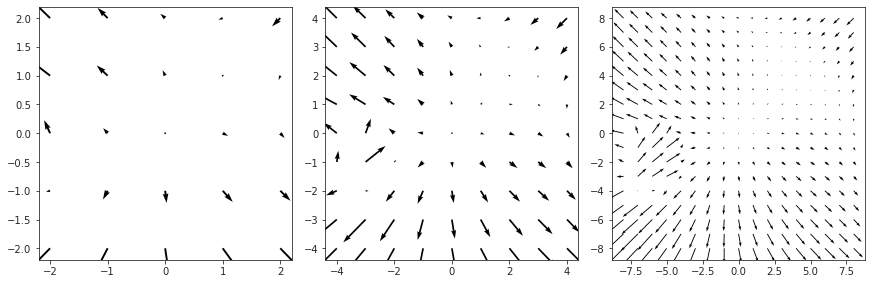

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 0, 6) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 0  0 10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

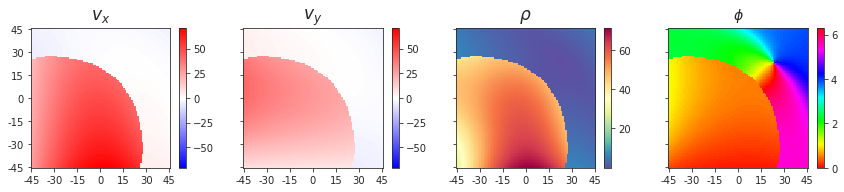

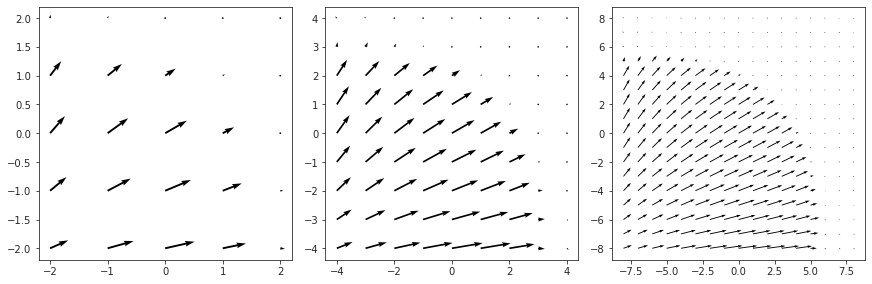

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 0, 7) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 0  0 10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

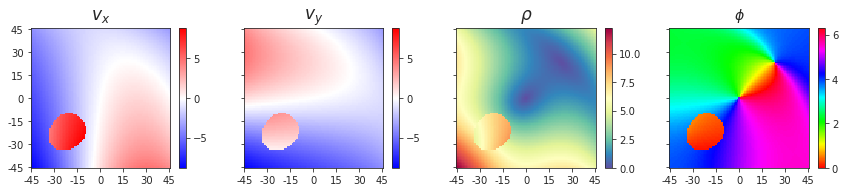

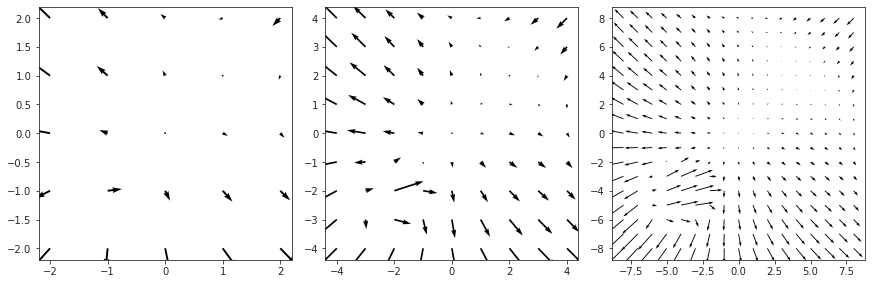

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 0, 8) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 0  0 10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

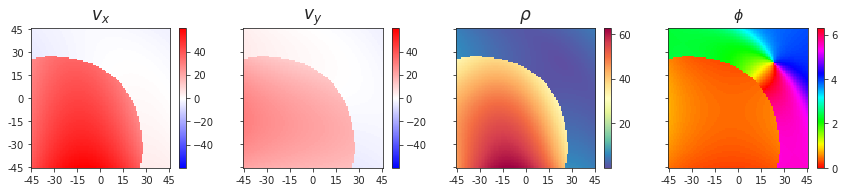

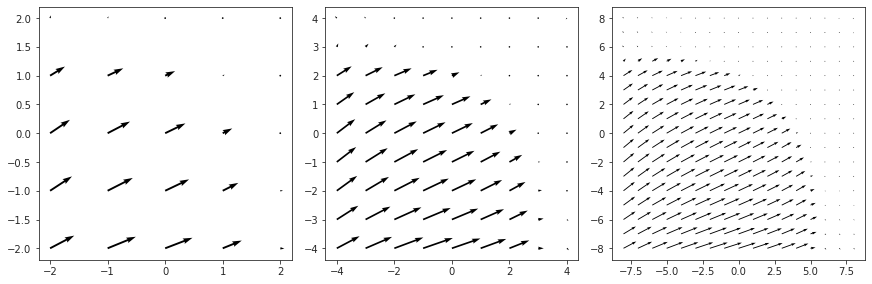

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 0, 9) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 0  0 10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

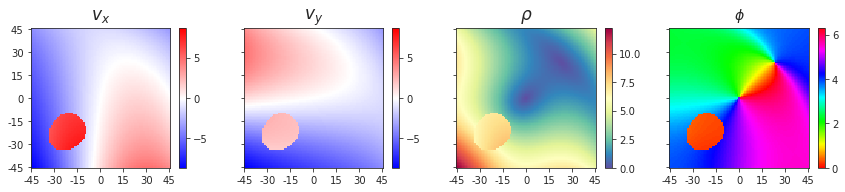

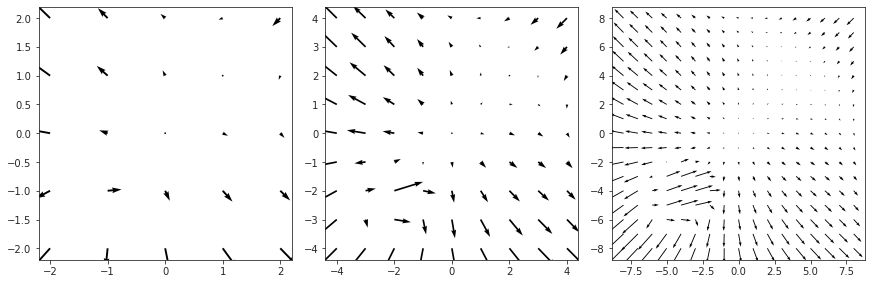

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 1, 0) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

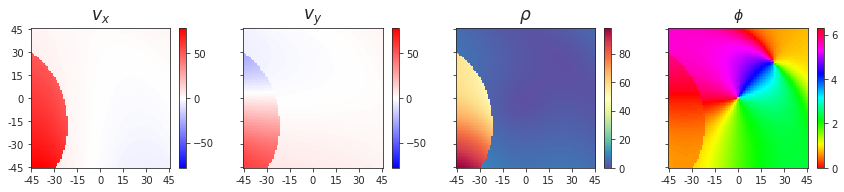

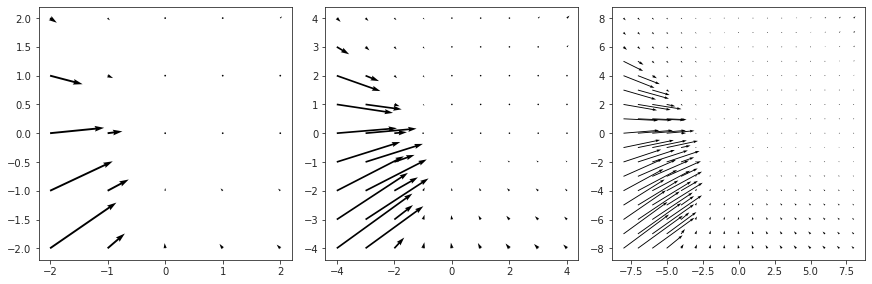

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 1, 1) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

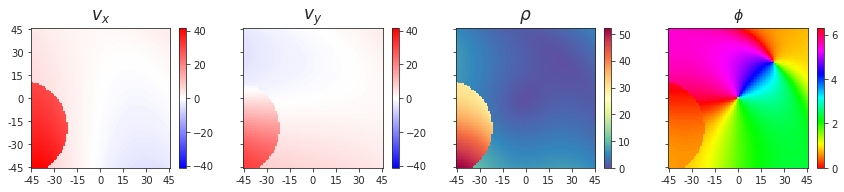

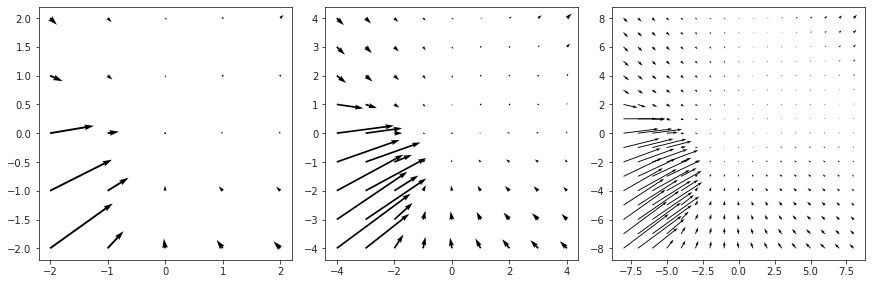

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 1, 2) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

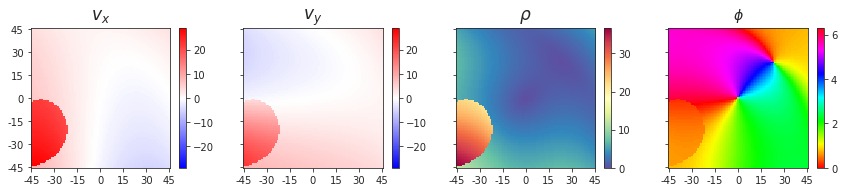

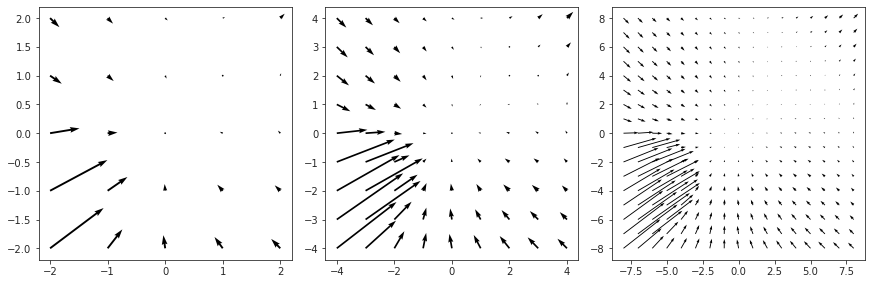

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 1, 3) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

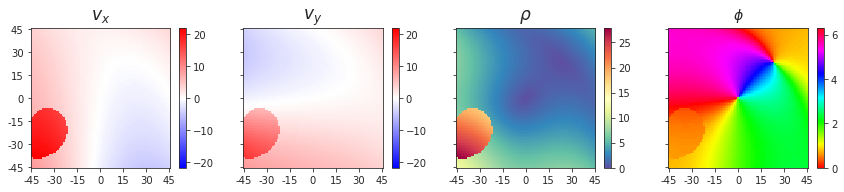

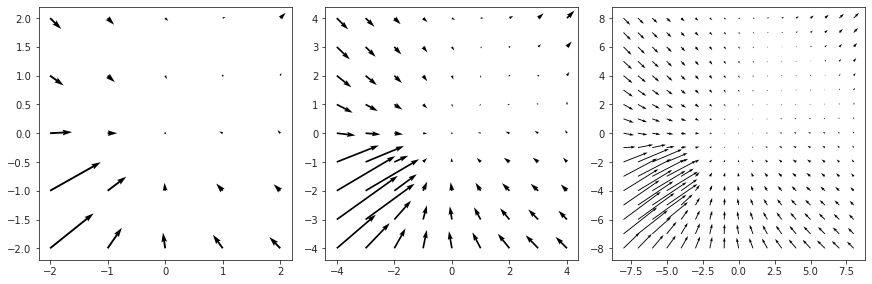

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 1, 4) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

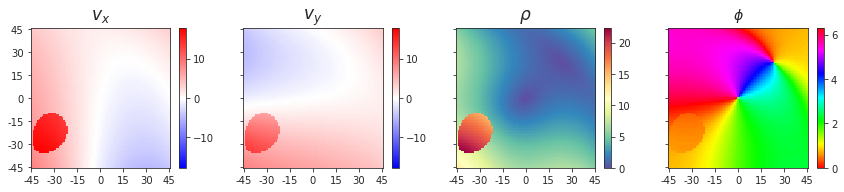

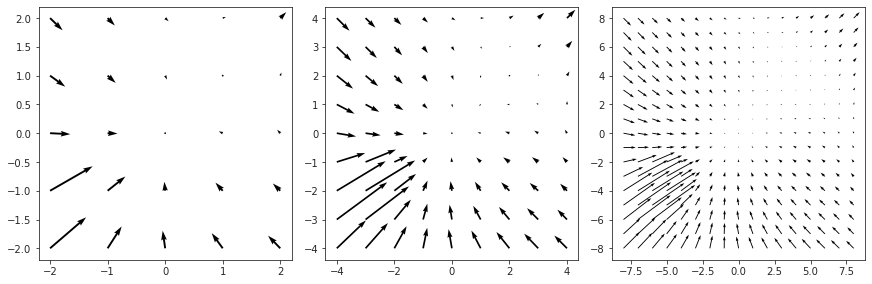

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 1, 5) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

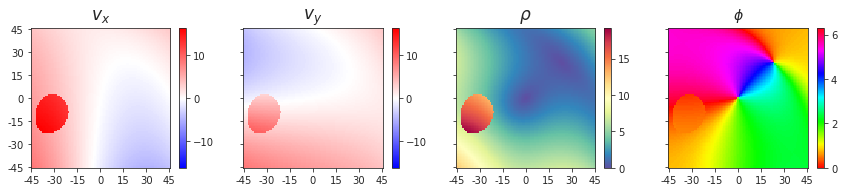

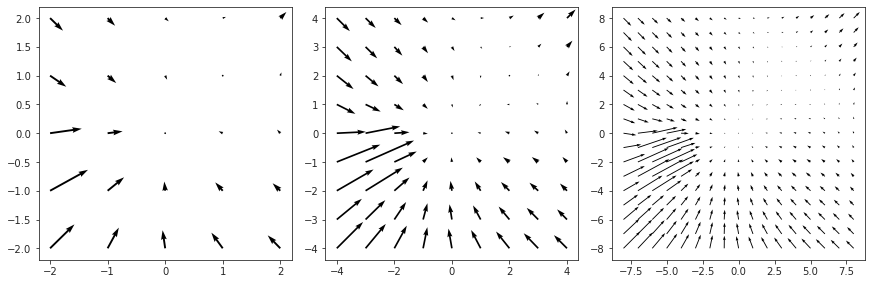

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 1, 6) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [  0   0 -10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

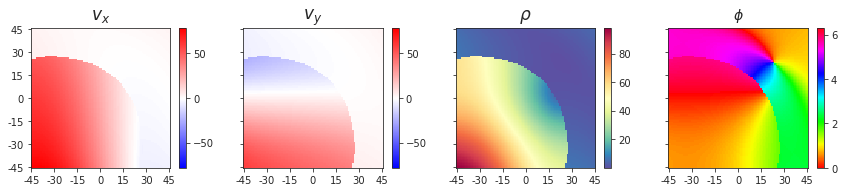

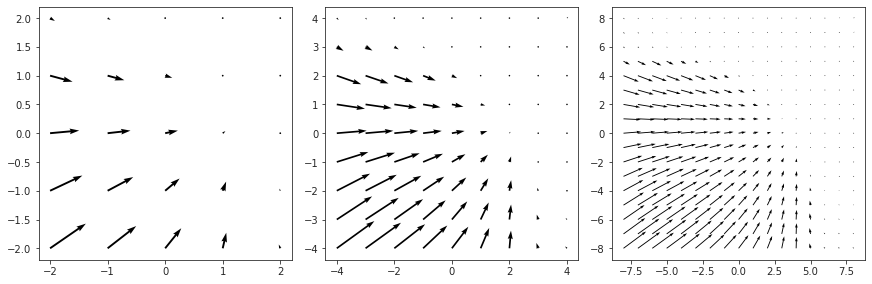

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 1, 7) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [  0   0 -10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

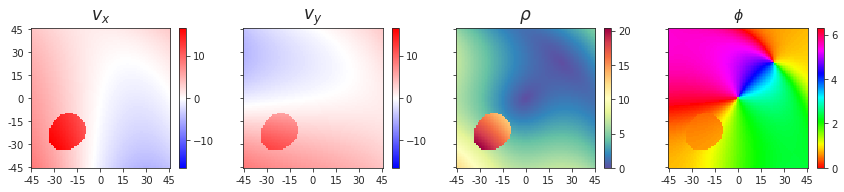

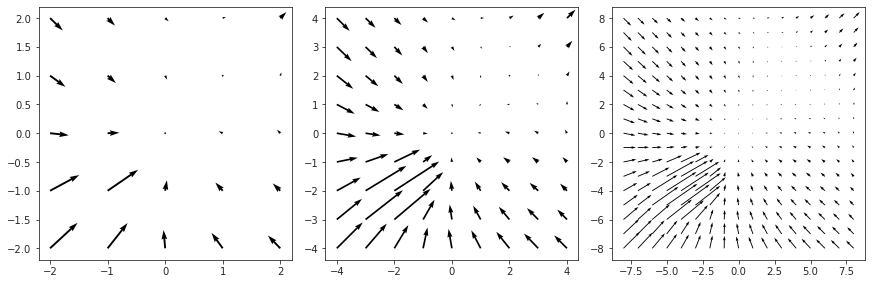

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 1, 8) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [  0   0 -10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

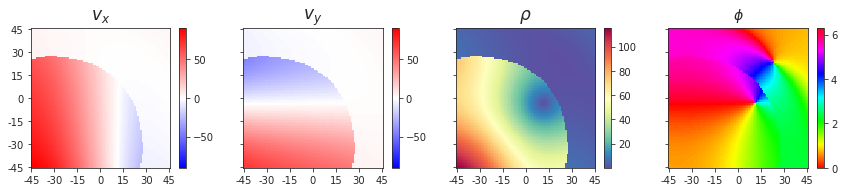

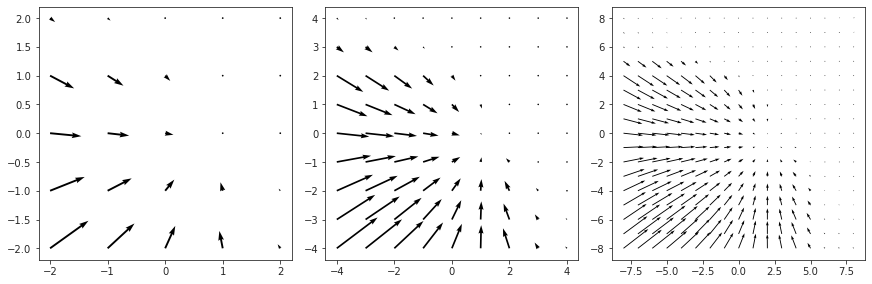

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 1, 9) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [  0   0 -10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

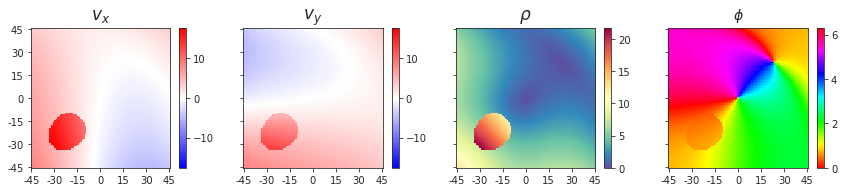

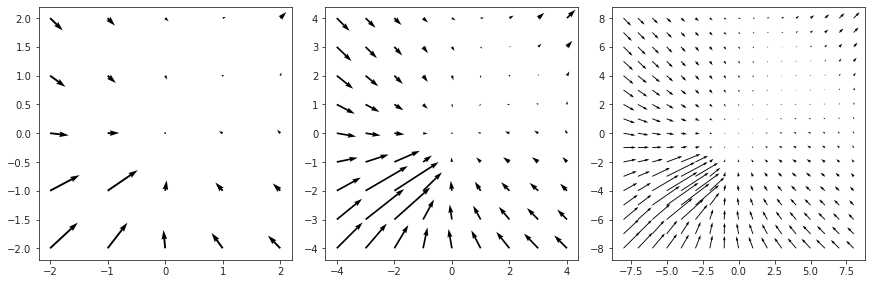

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 2, 0) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

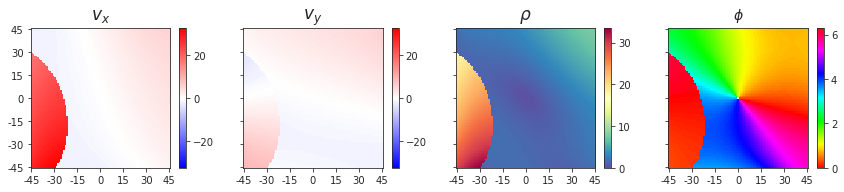

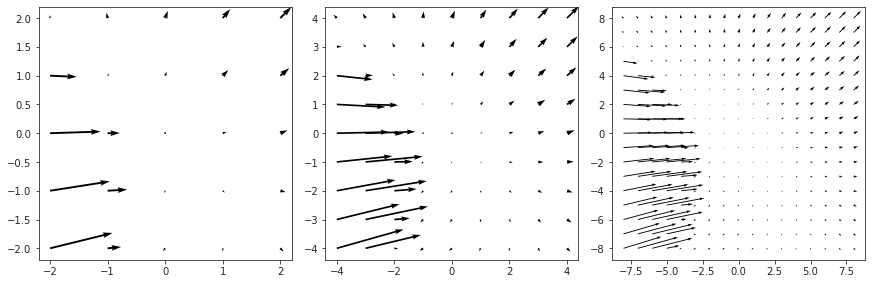

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 2, 1) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

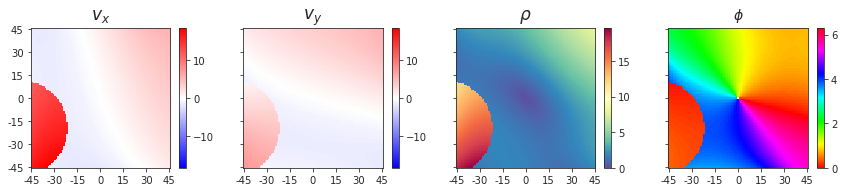

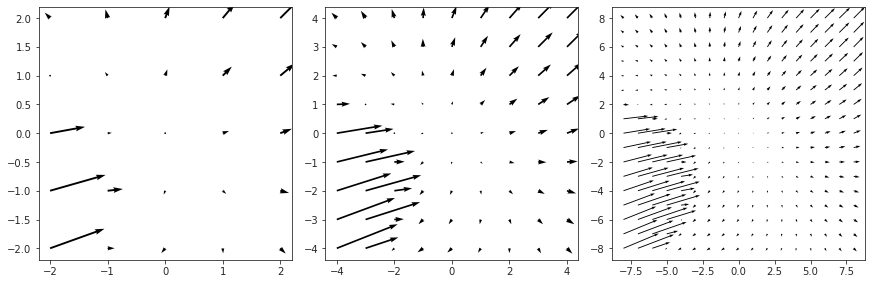

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 2, 2) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

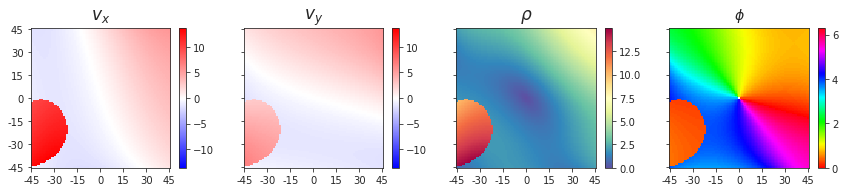

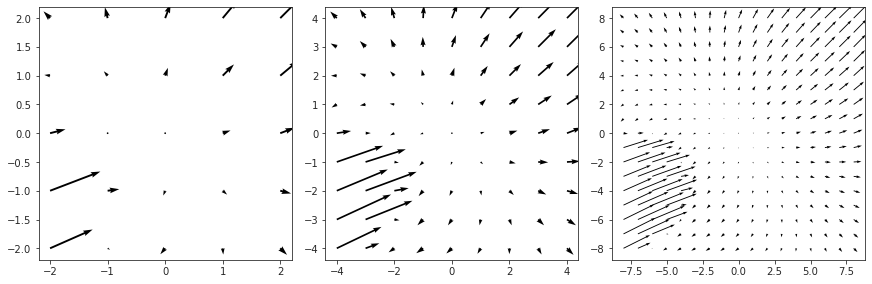

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 2, 3) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

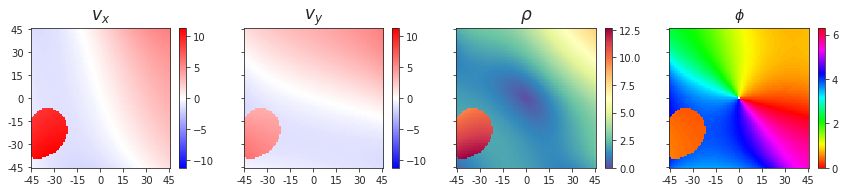

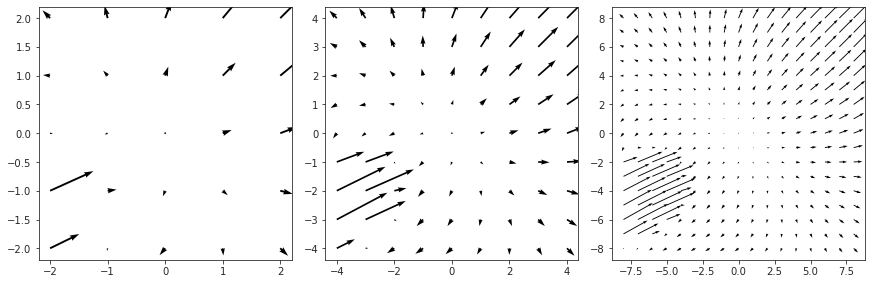

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 2, 4) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

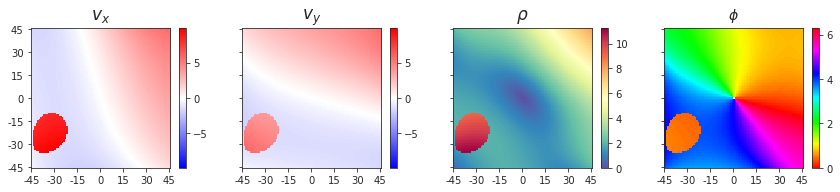

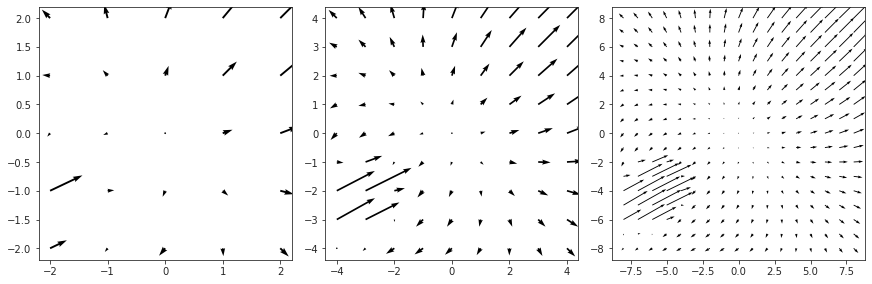

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 2, 5) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

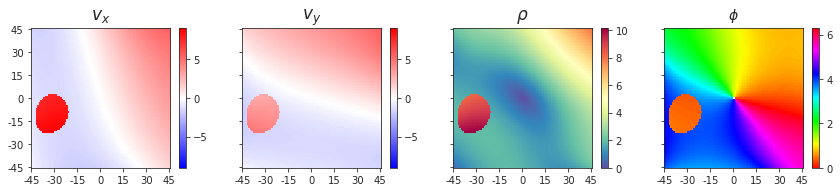

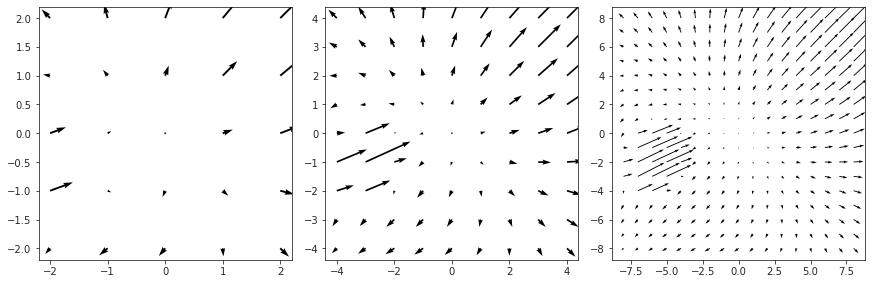

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 2, 6) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [5 5 0]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

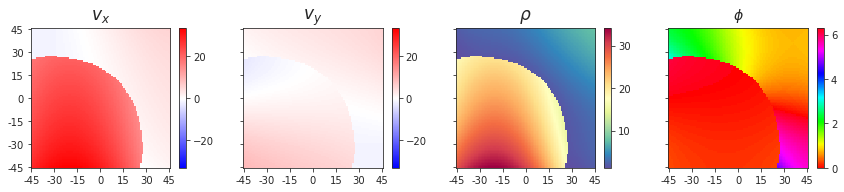

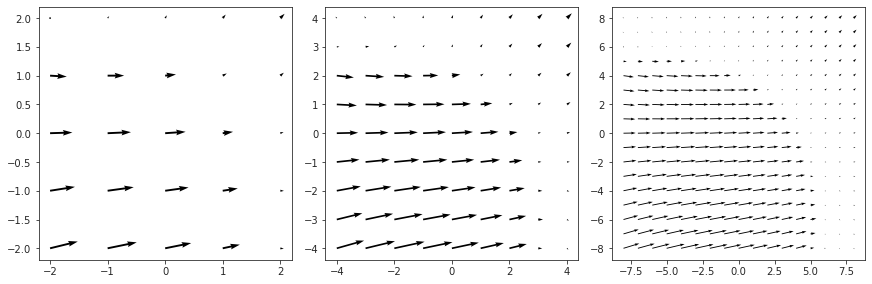

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 2, 7) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [5 5 0]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

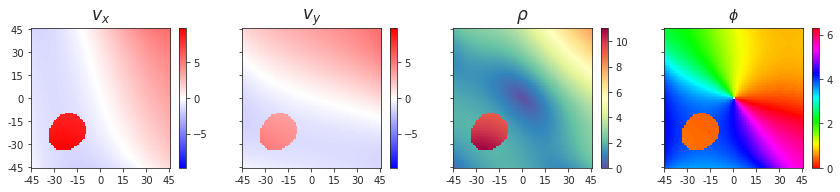

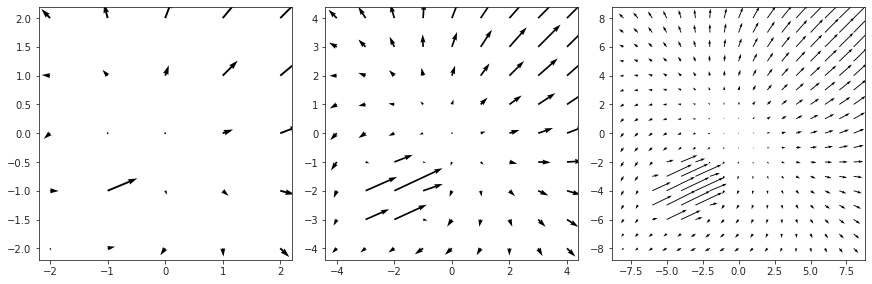

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 2, 8) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [5 5 0]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

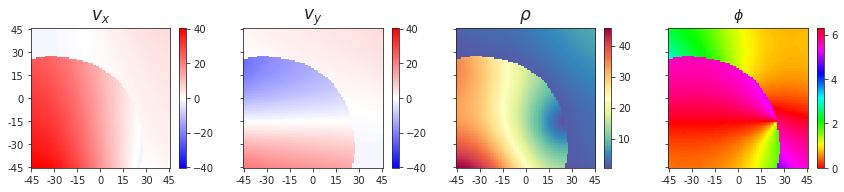

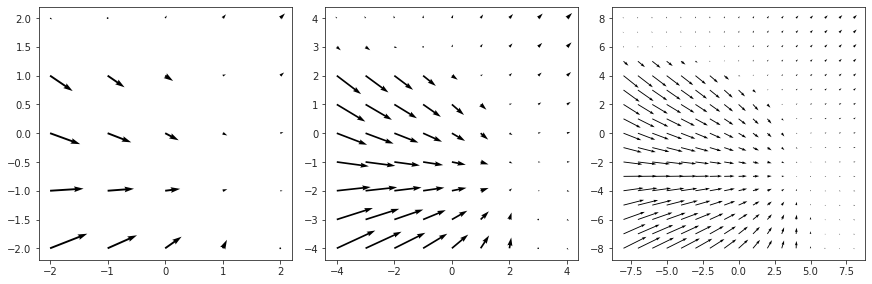

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 2, 9) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [5 5 0]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

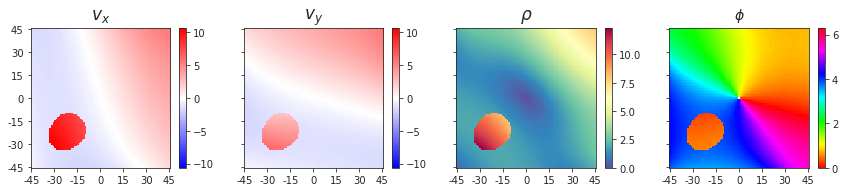

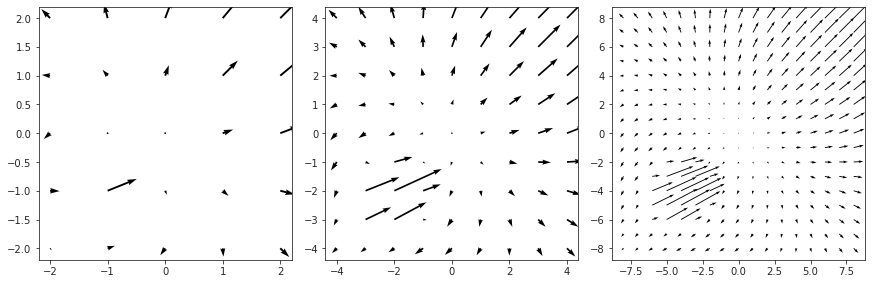

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 3, 0) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

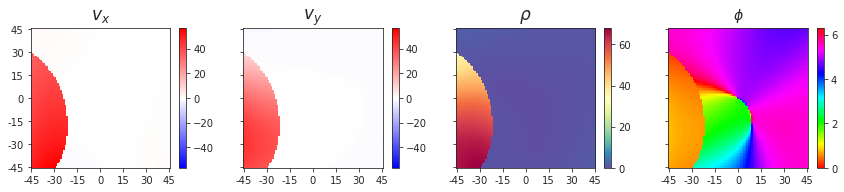

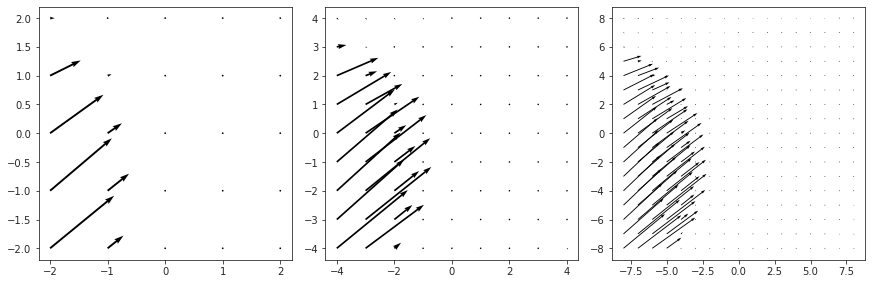

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 3, 1) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

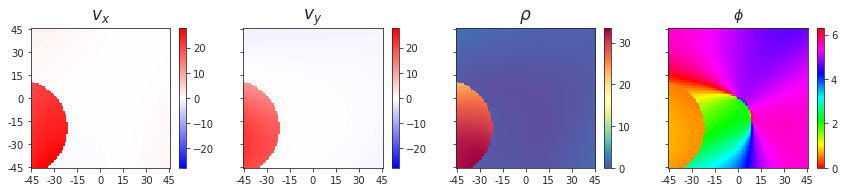

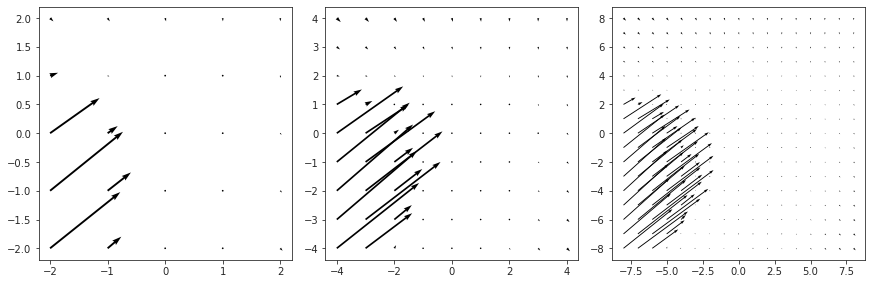

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 3, 2) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

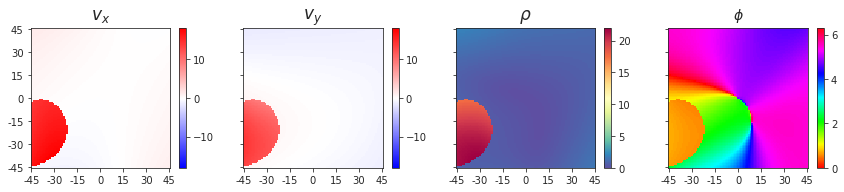

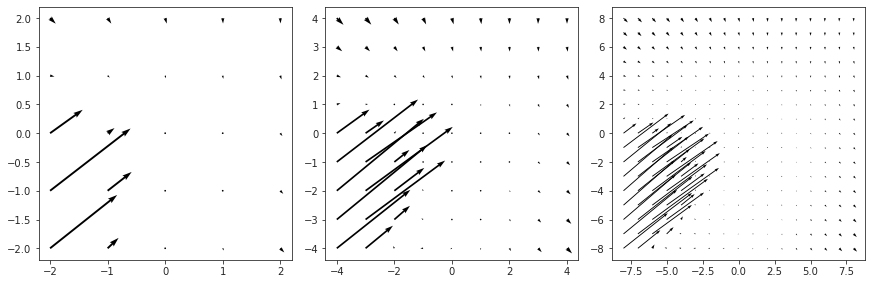

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 3, 3) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

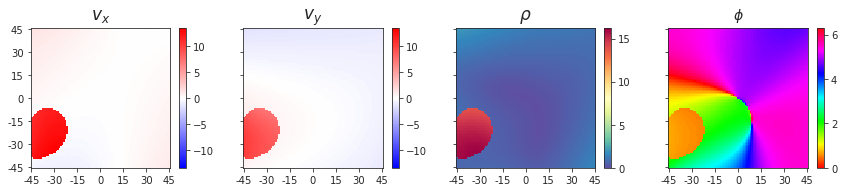

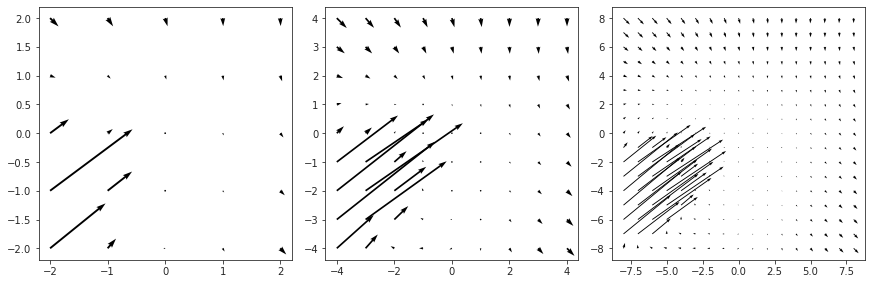

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 3, 4) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

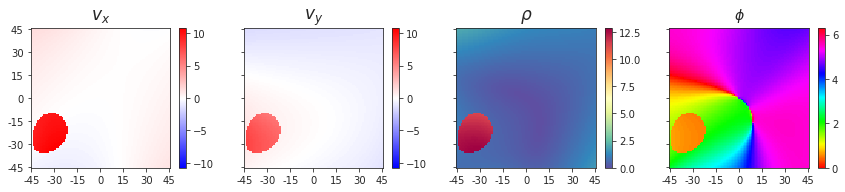

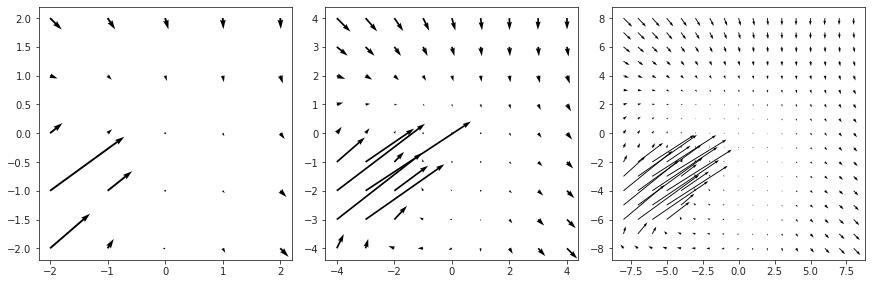

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 3, 5) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

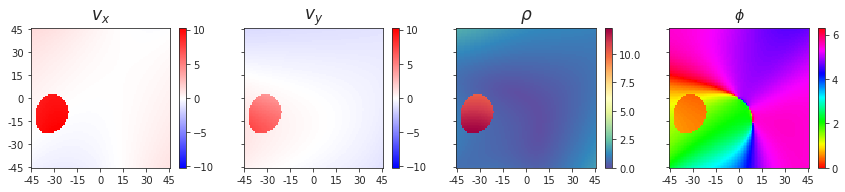

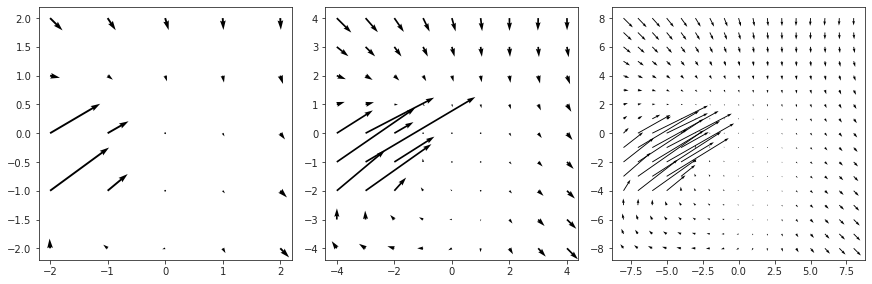

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 3, 6) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 1 -2  0]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

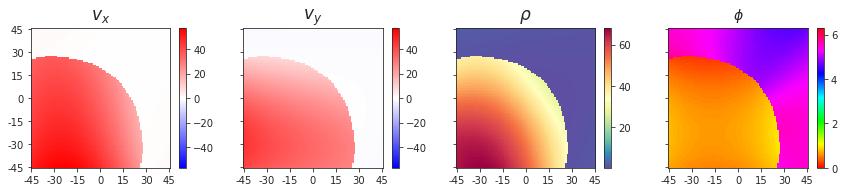

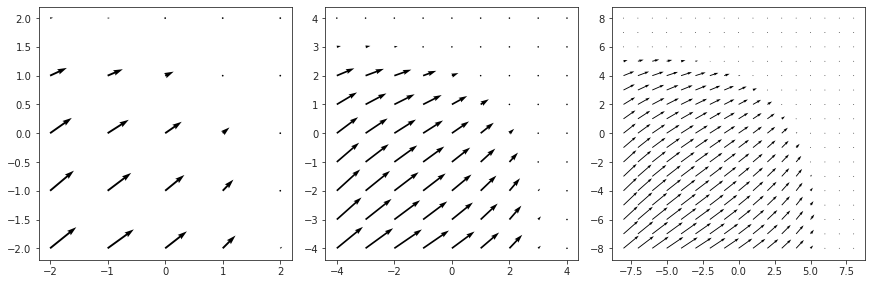

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 3, 7) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 1 -2  0]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

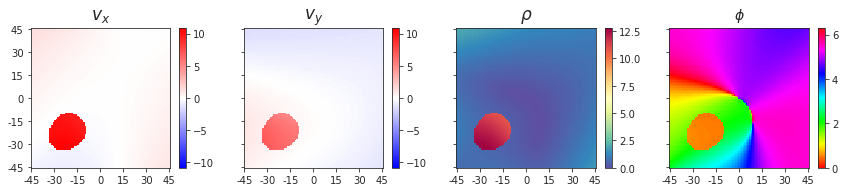

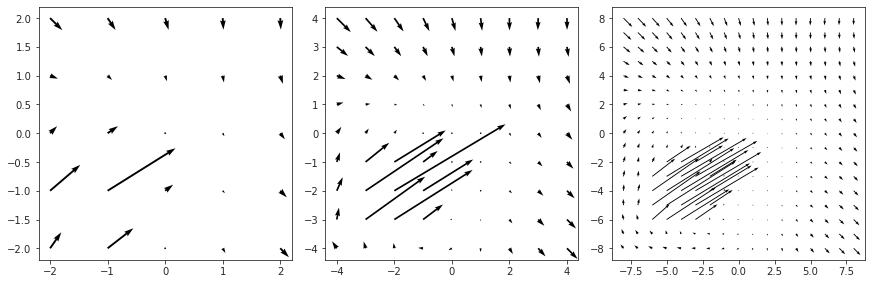

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 3, 8) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 1 -2  0]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

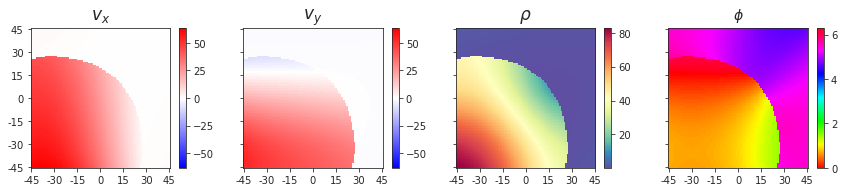

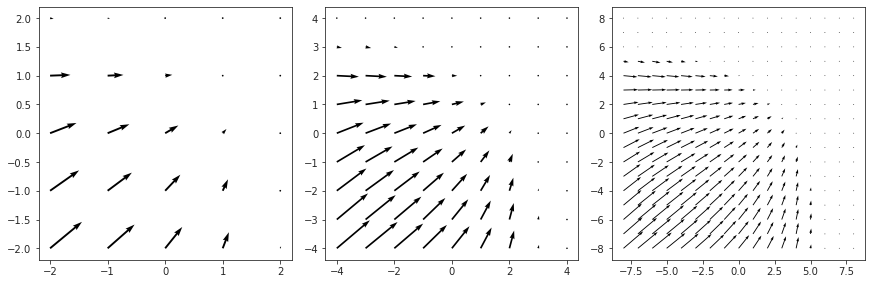

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 3, 9) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 1 -2  0]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

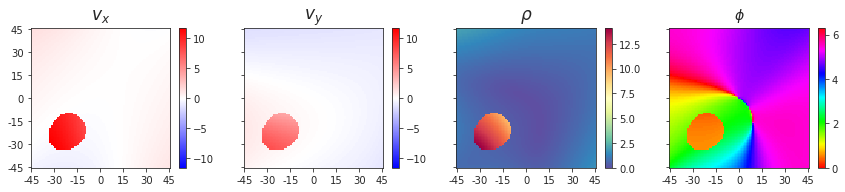

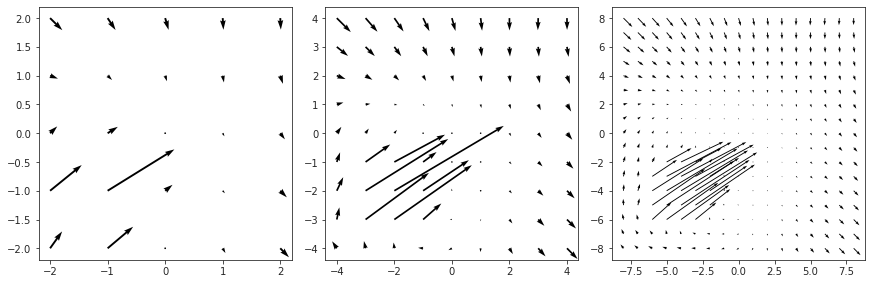

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 4, 0) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

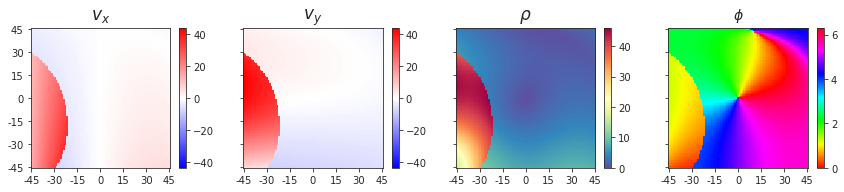

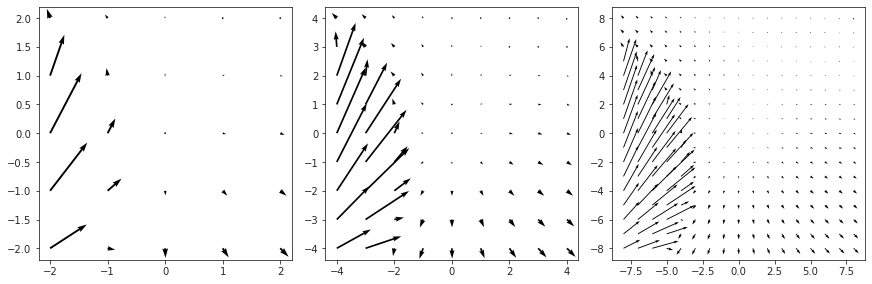

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 4, 1) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

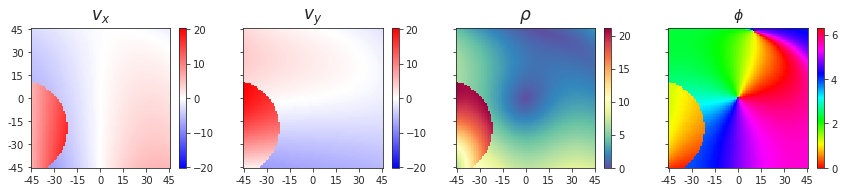

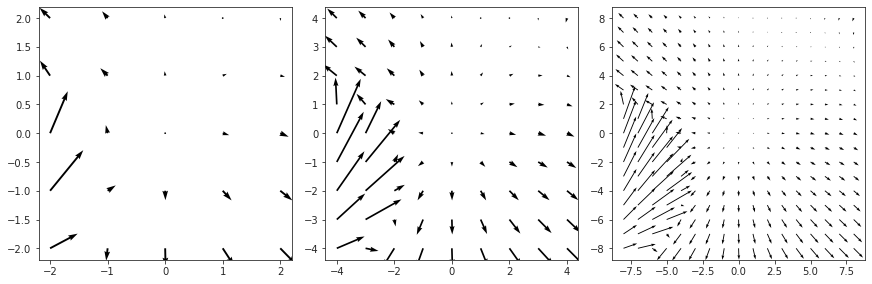

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 4, 2) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

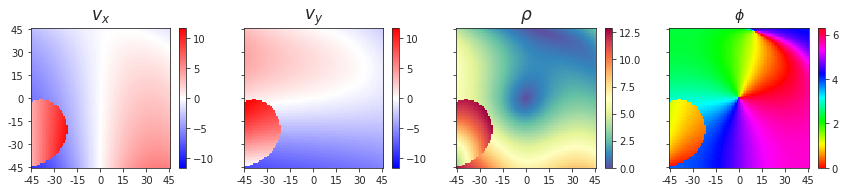

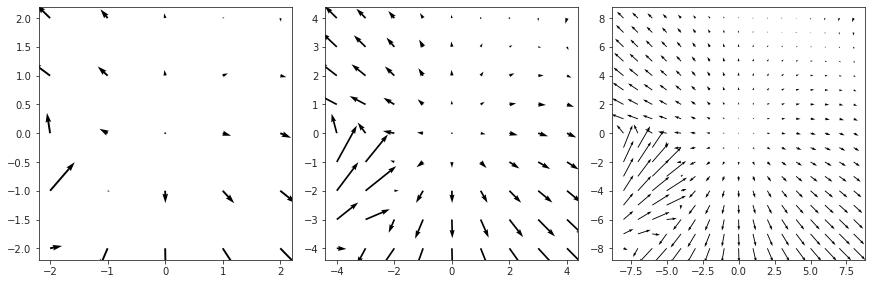

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 4, 3) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

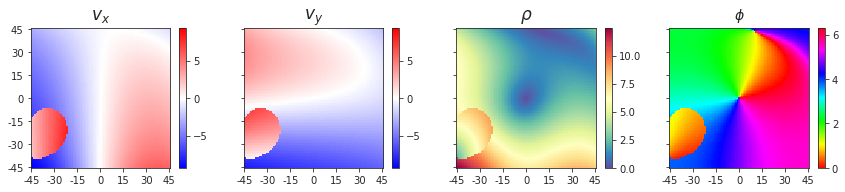

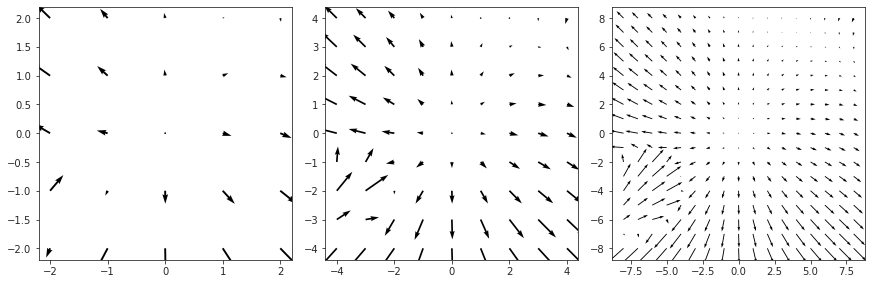

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 4, 4) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

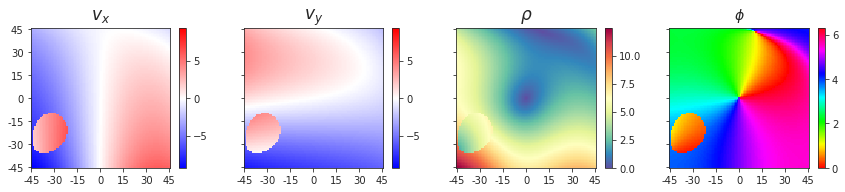

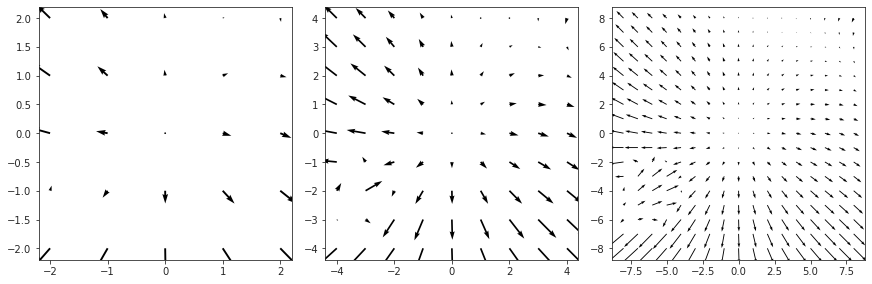

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 4, 5) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

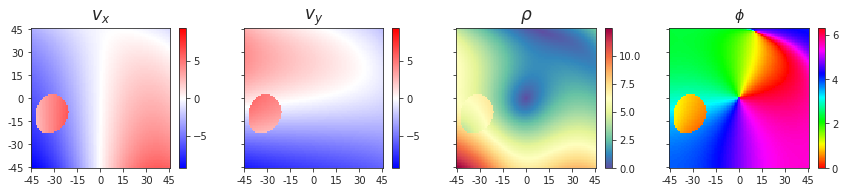

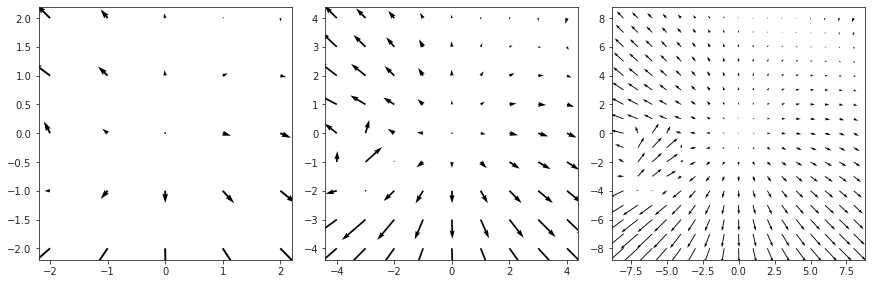

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 4, 6) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 3  0 10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

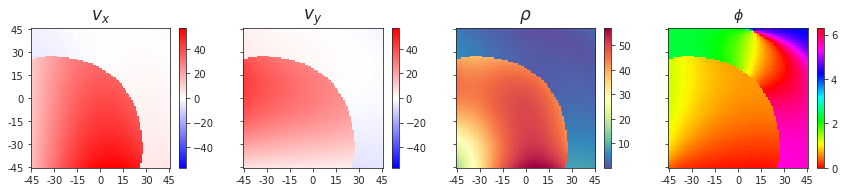

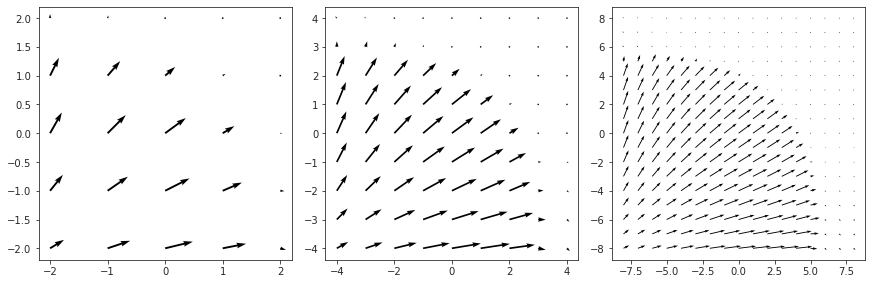

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 4, 7) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 3  0 10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

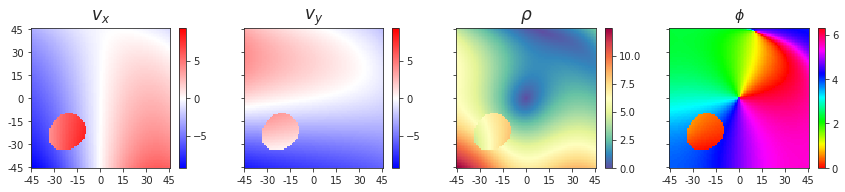

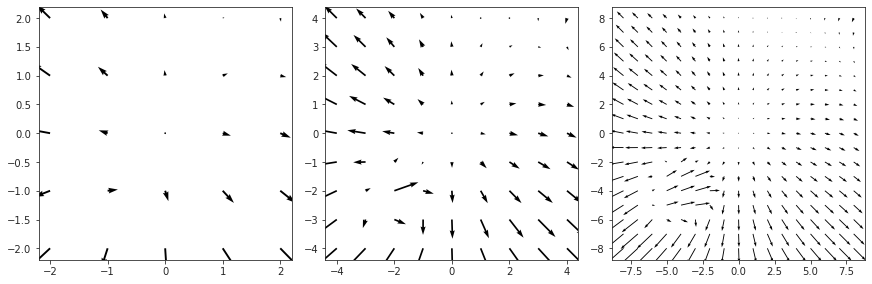

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 4, 8) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 3  0 10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

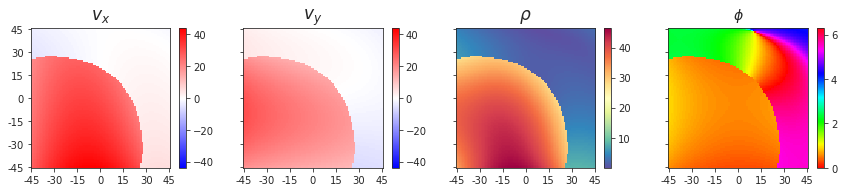

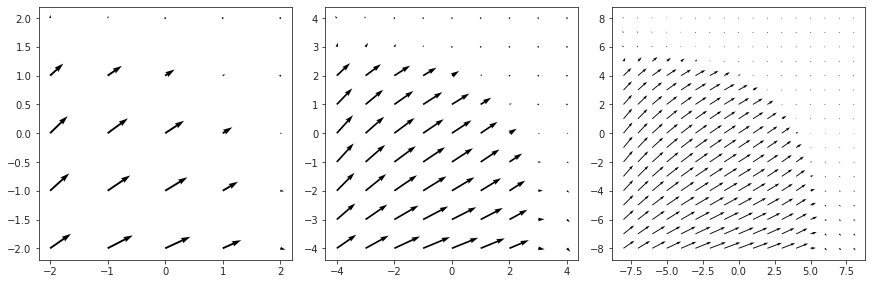

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 4, 9) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [ 3  0 10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

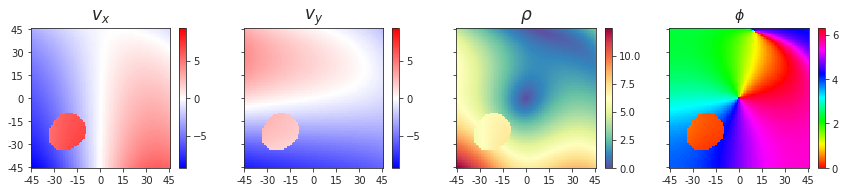

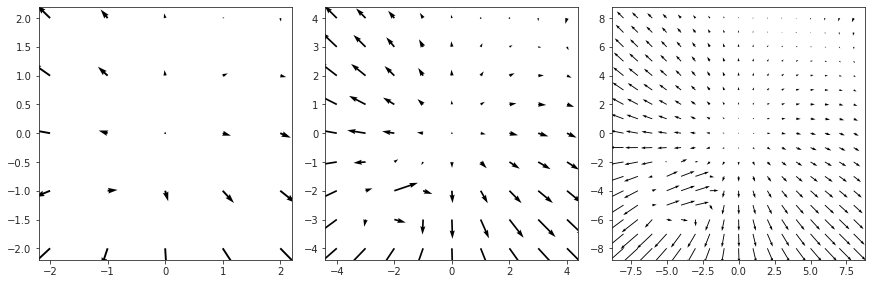

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 5, 0) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

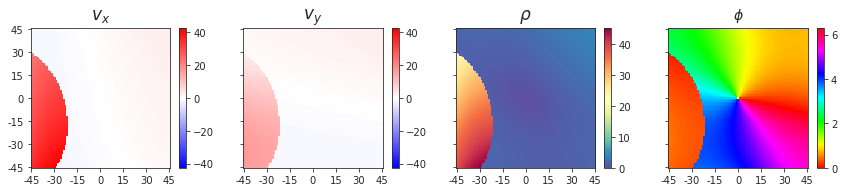

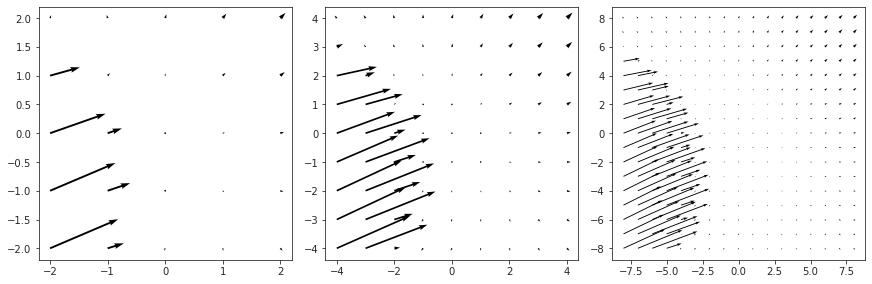

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 5, 1) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

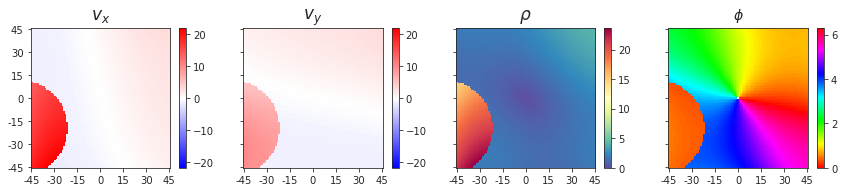

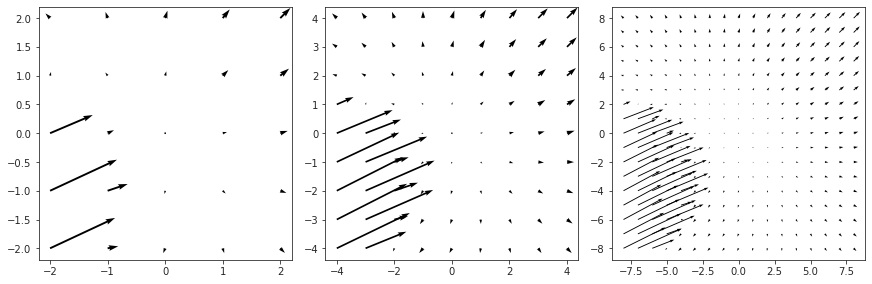

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 5, 2) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

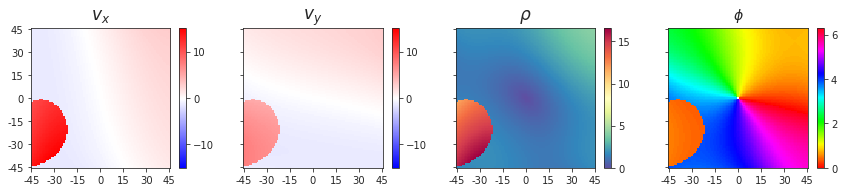

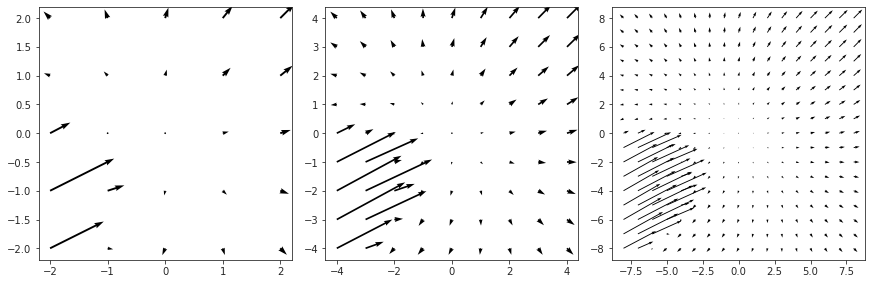

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 5, 3) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

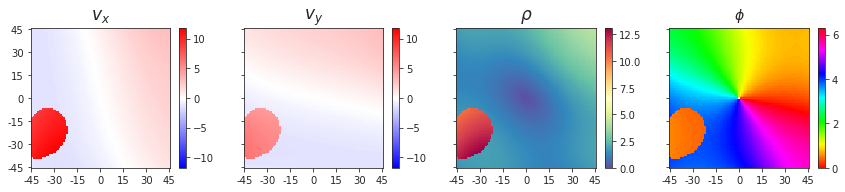

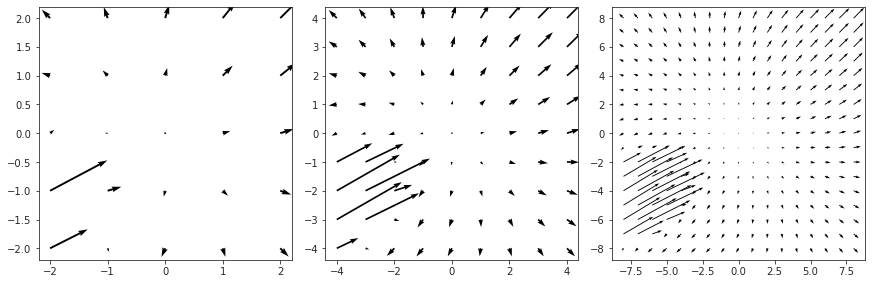

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 5, 4) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

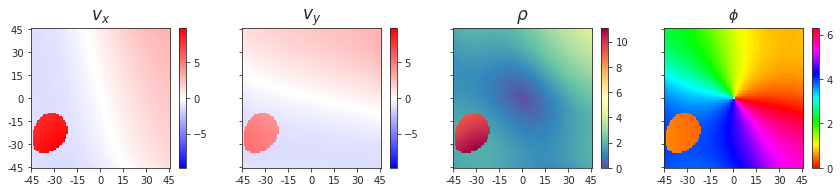

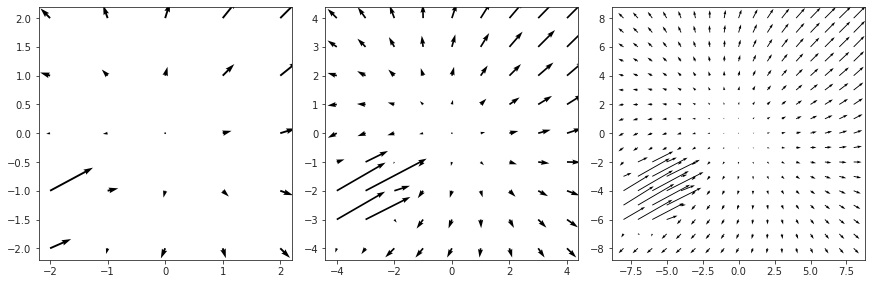

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 5, 5) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

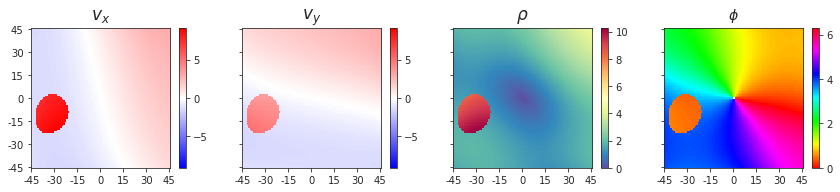

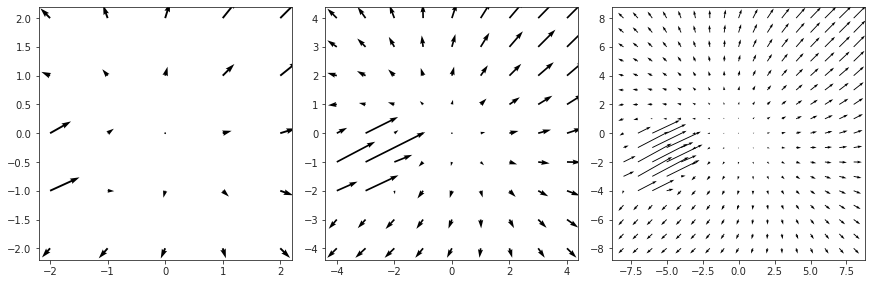

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 5, 6) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [3 3 1]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

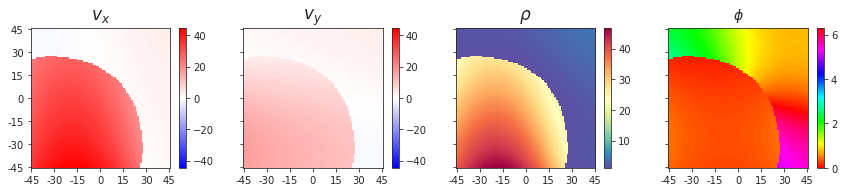

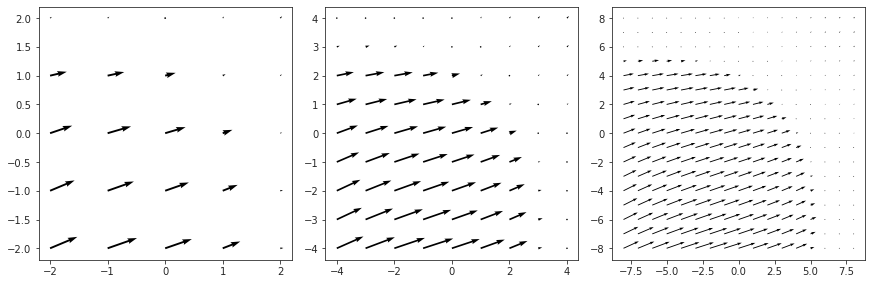

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 5, 7) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [3 3 1]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

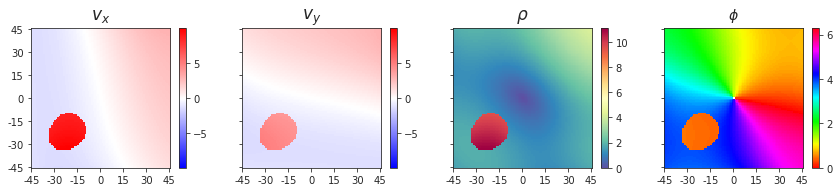

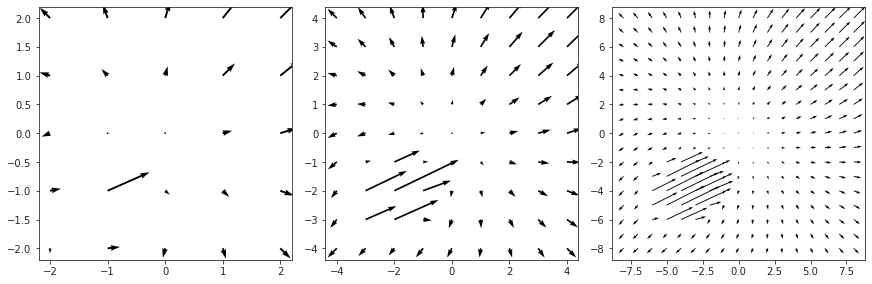

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 5, 8) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [3 3 1]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

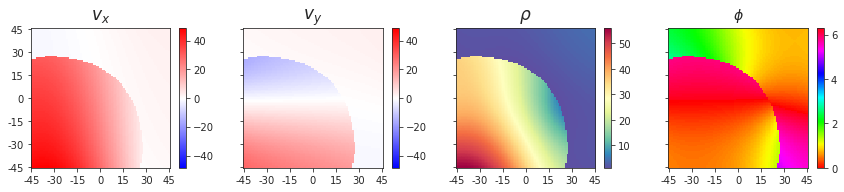

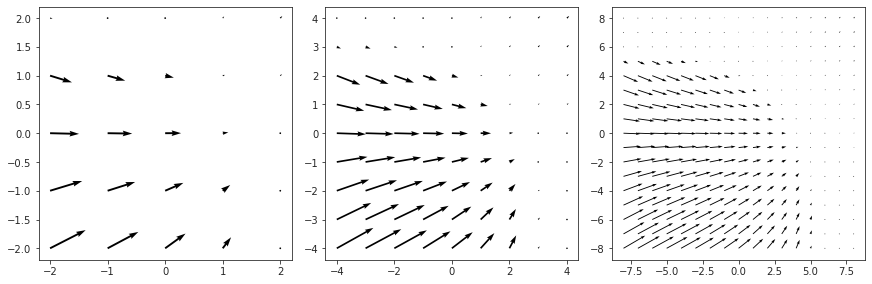

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 5, 9) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [3 3 1]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

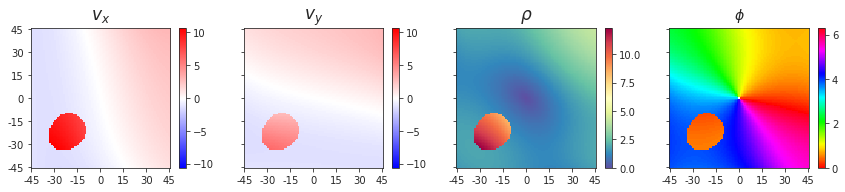

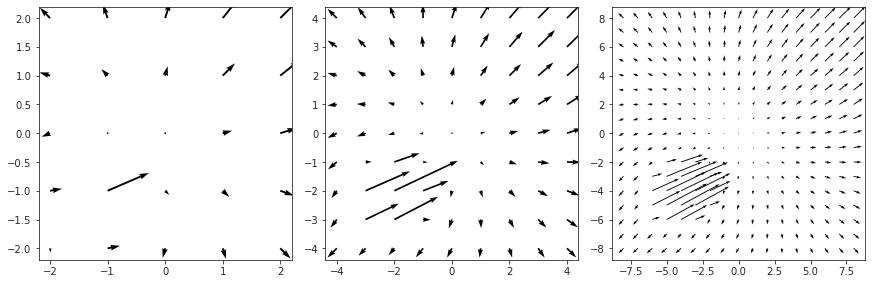

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 6, 0) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

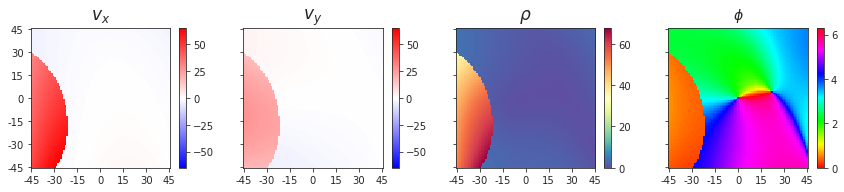

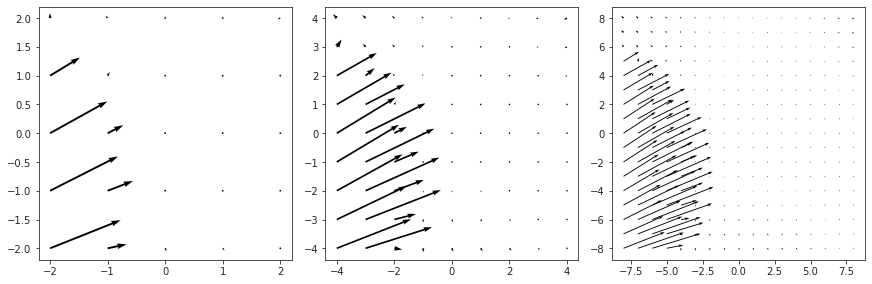

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 6, 1) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

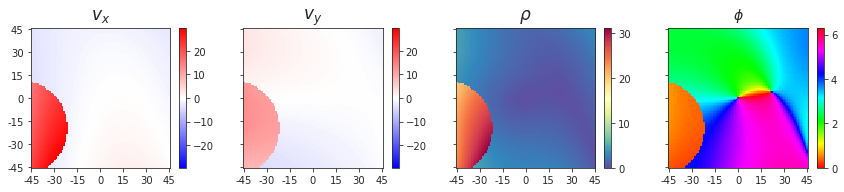

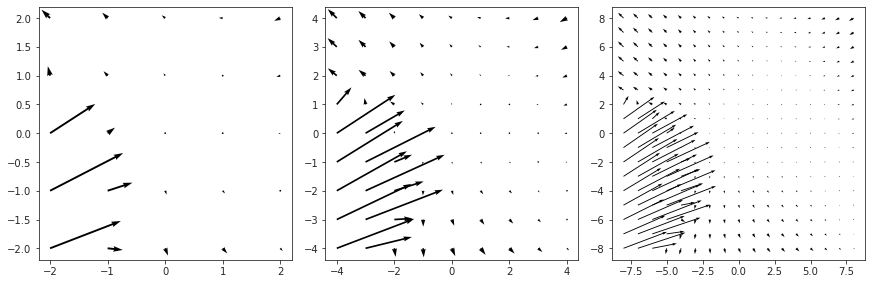

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 6, 2) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

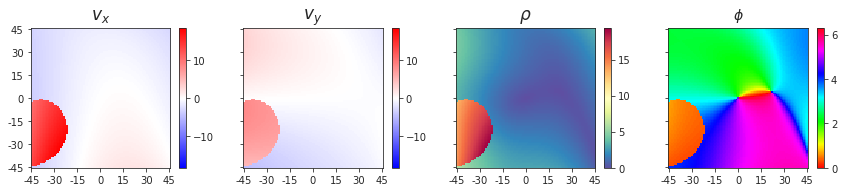

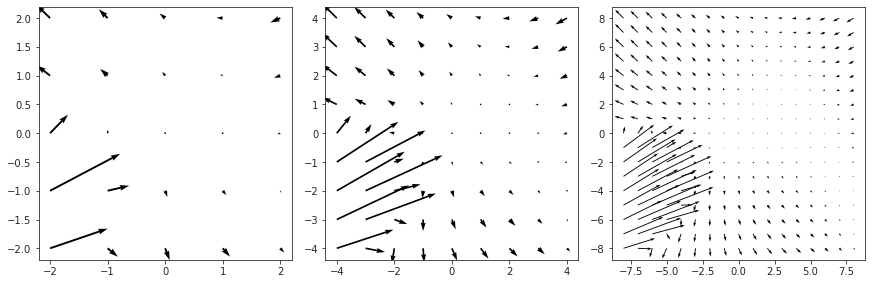

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 6, 3) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

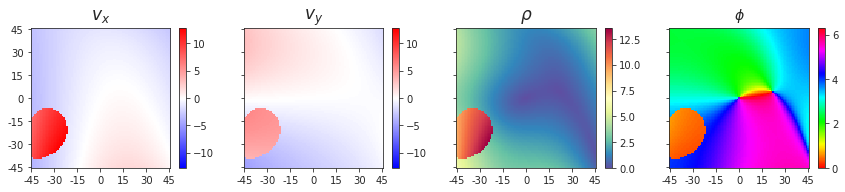

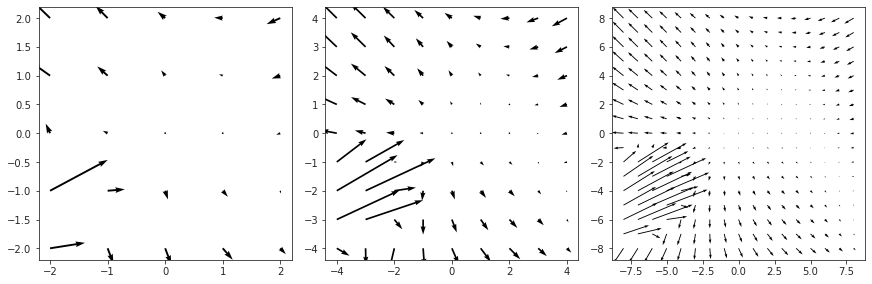

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 6, 4) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

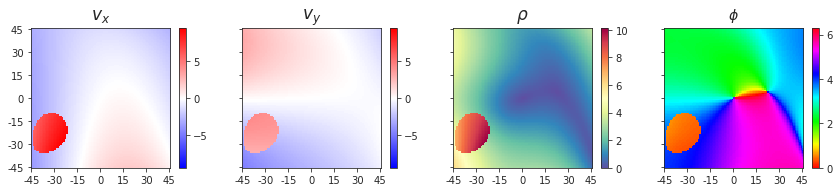

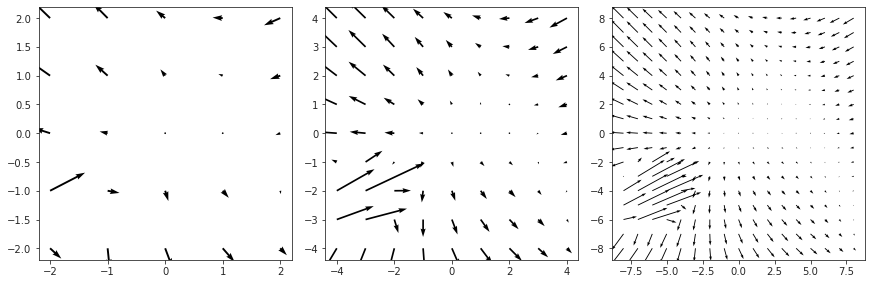

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 6, 5) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

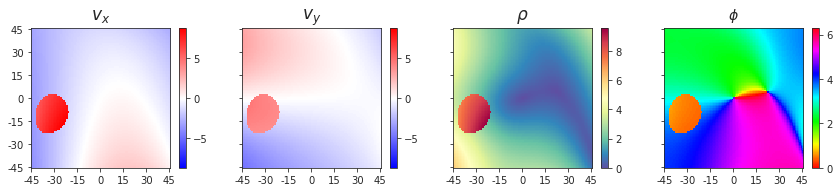

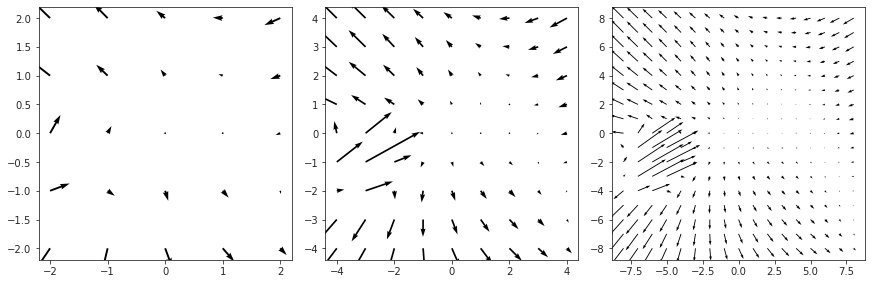

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 6, 6) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [-2  1  5]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

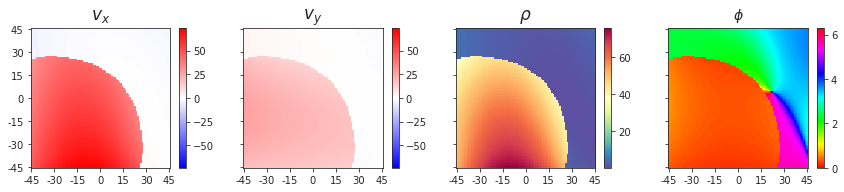

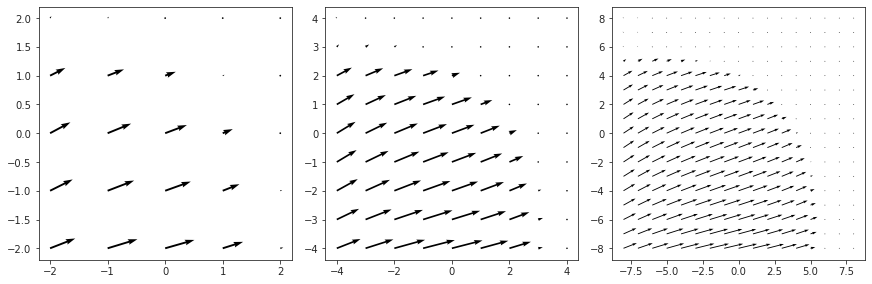

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 6, 7) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [-2  1  5]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

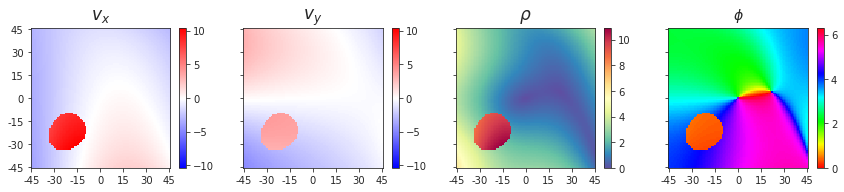

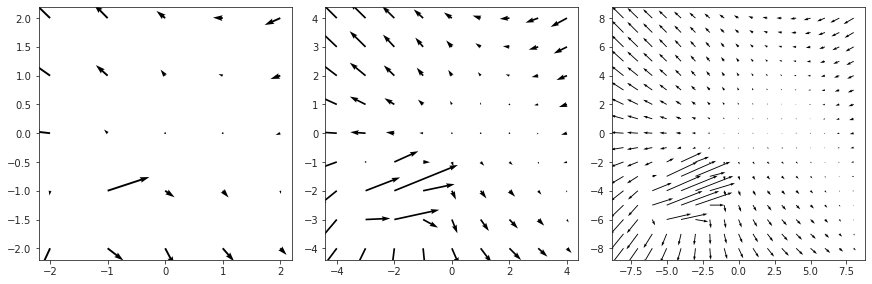

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 6, 8) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [-2  1  5]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

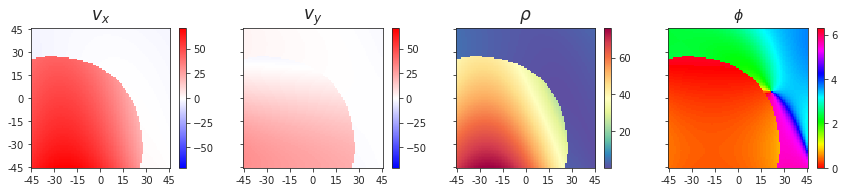

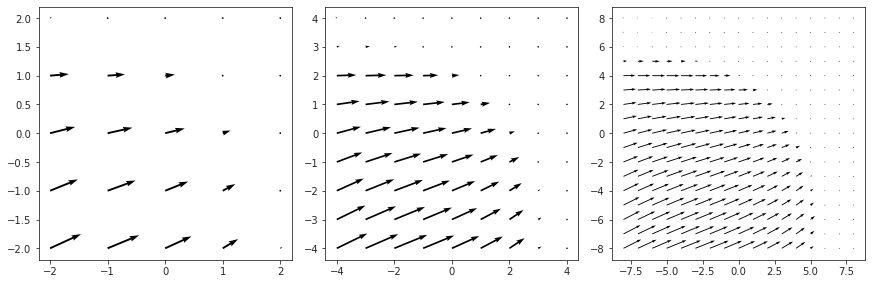

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (3, 6, 9) >>>
self . . . fixation: [0.4 0.4 1. ],  v_self: [-2  1  5]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

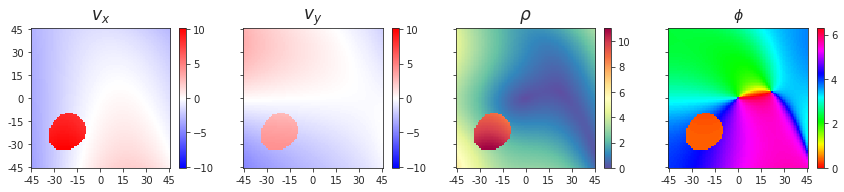

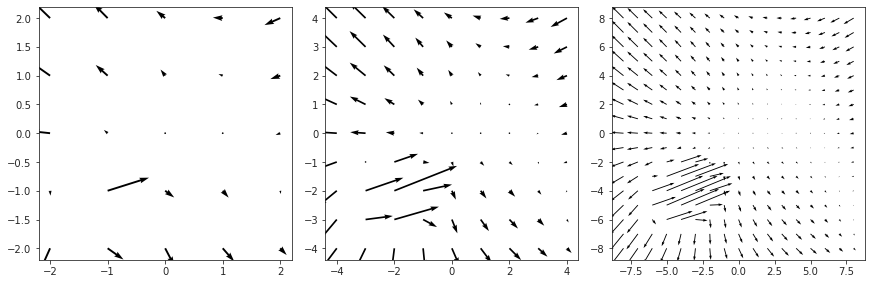

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 0, 0) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

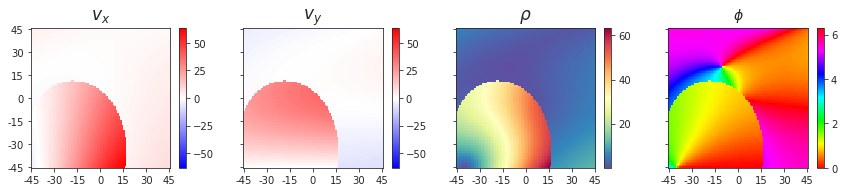

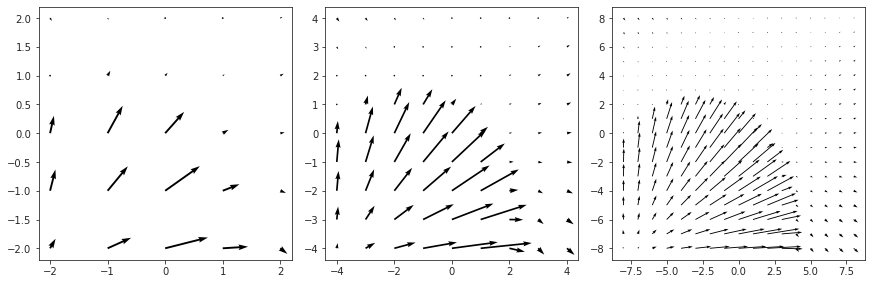

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 0, 1) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

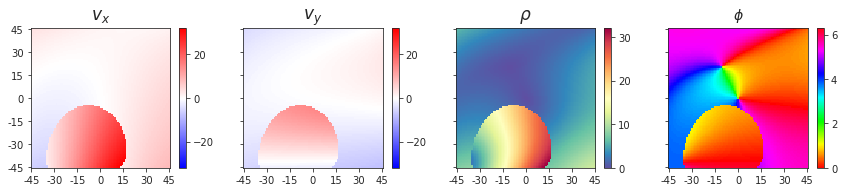

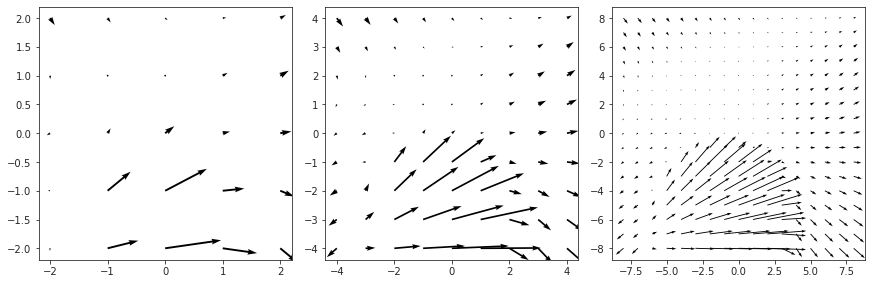

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 0, 2) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

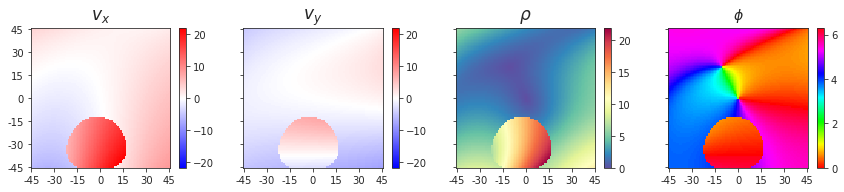

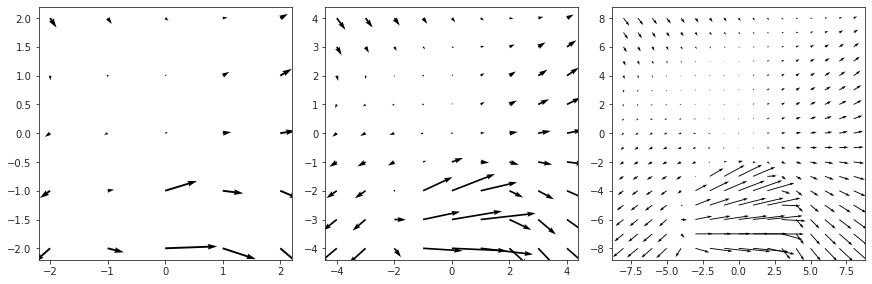

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 0, 3) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

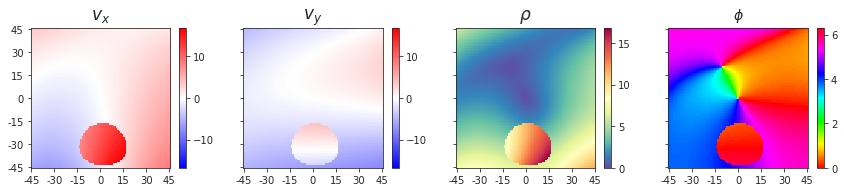

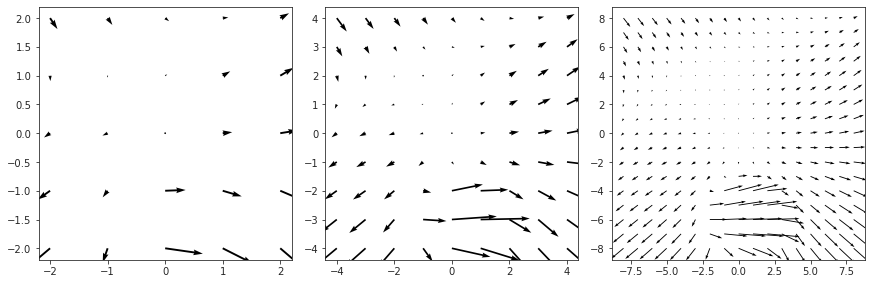

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 0, 4) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

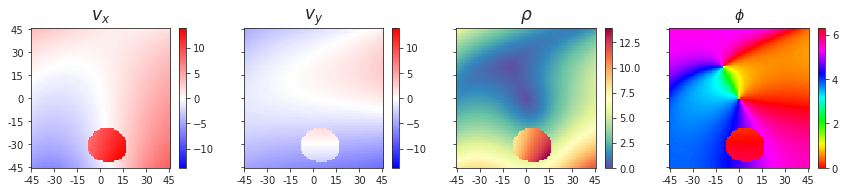

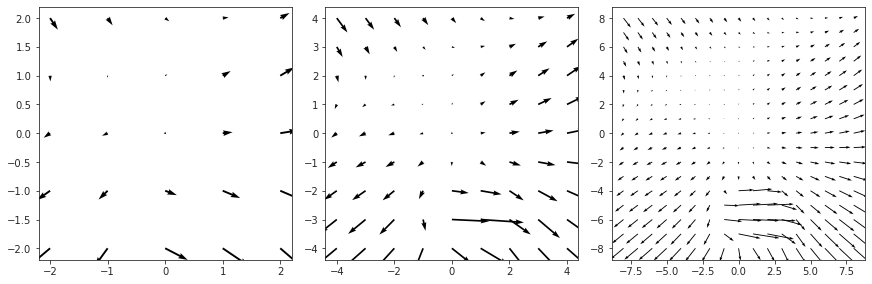

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 0, 5) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 0  0 10]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

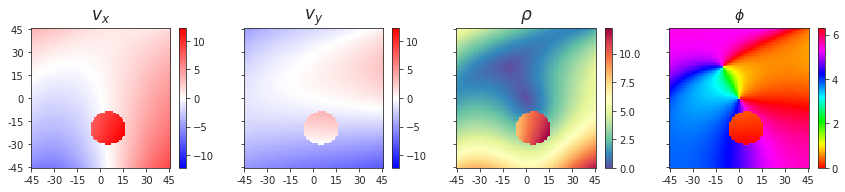

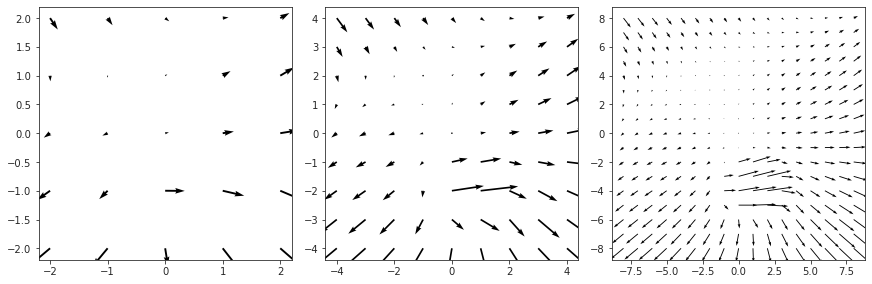

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 0, 6) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 0  0 10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

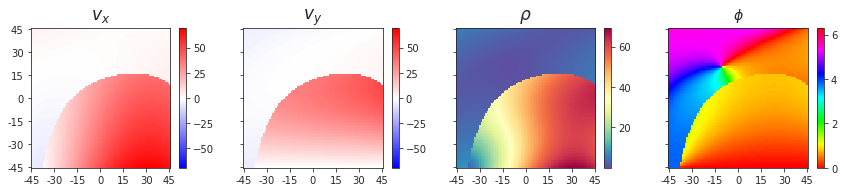

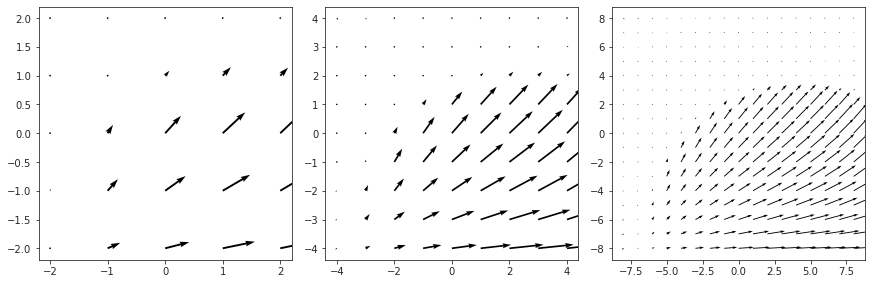

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 0, 7) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 0  0 10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

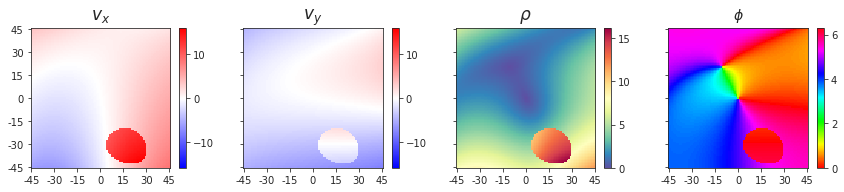

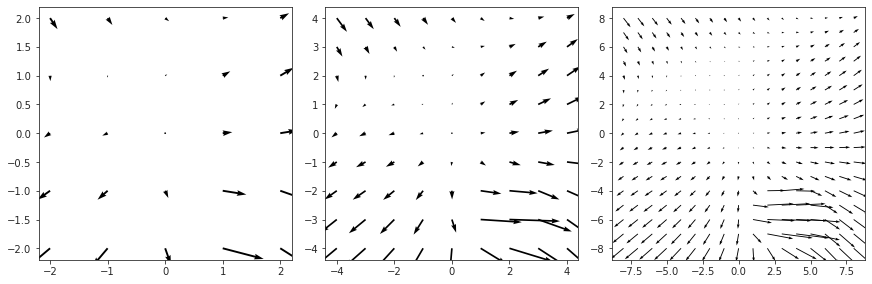

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 0, 8) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 0  0 10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

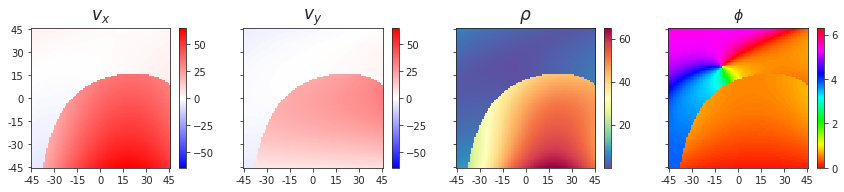

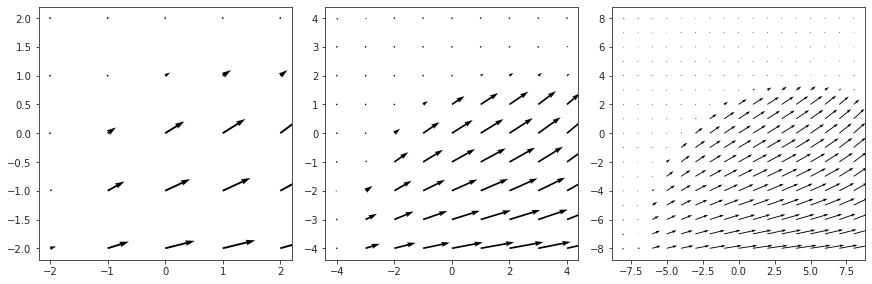

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 0, 9) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 0  0 10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

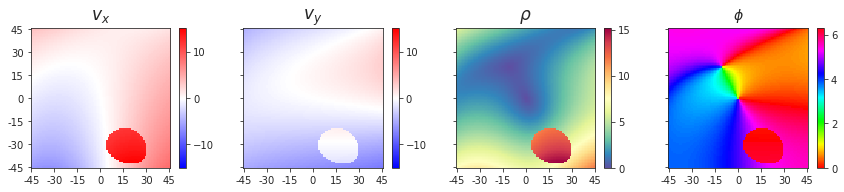

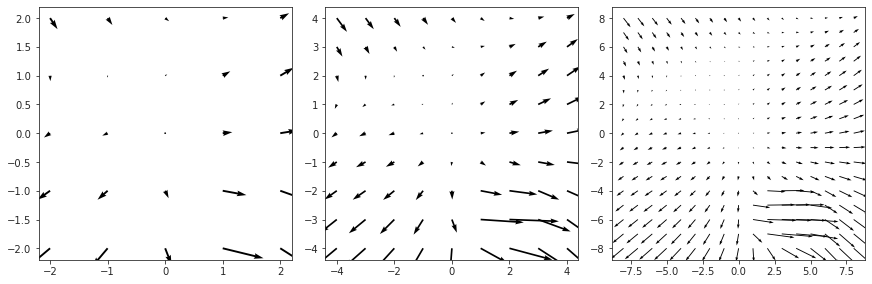

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 1, 0) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

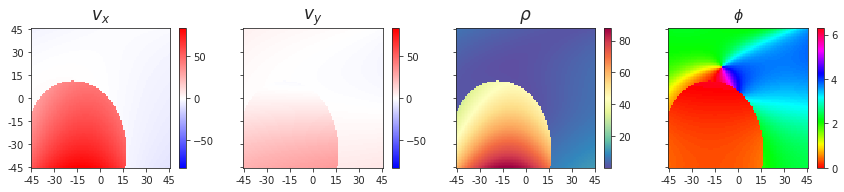

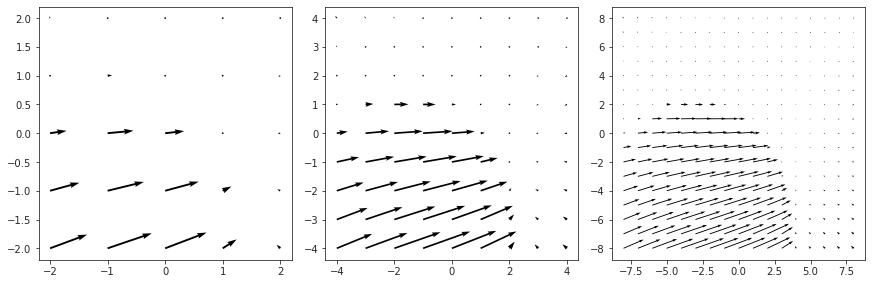

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 1, 1) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

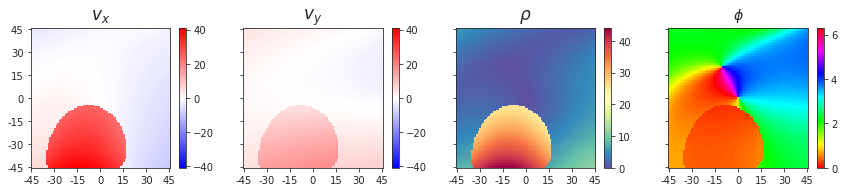

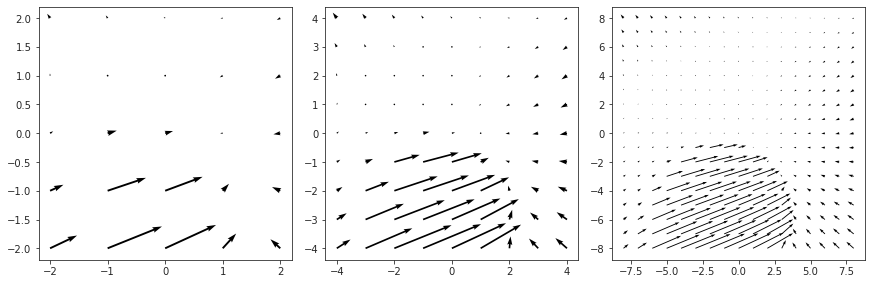

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 1, 2) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

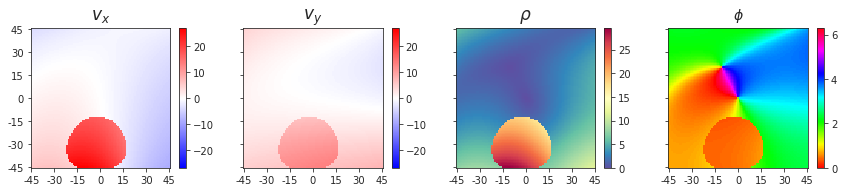

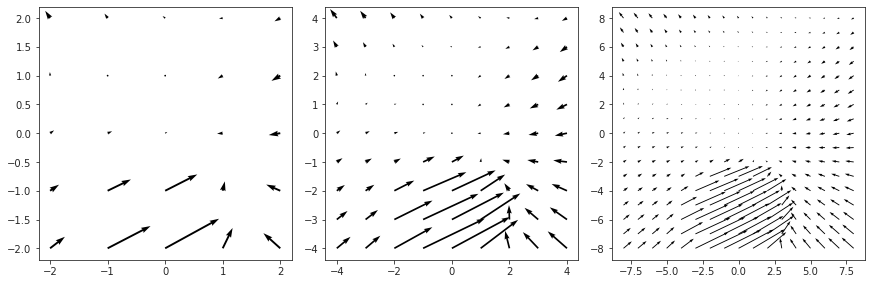

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 1, 3) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

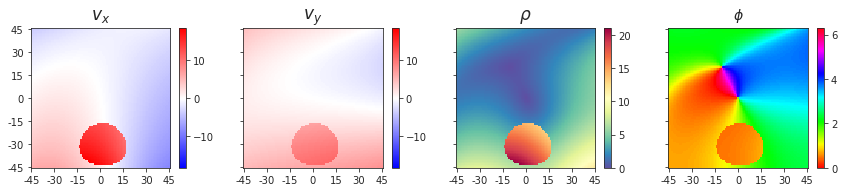

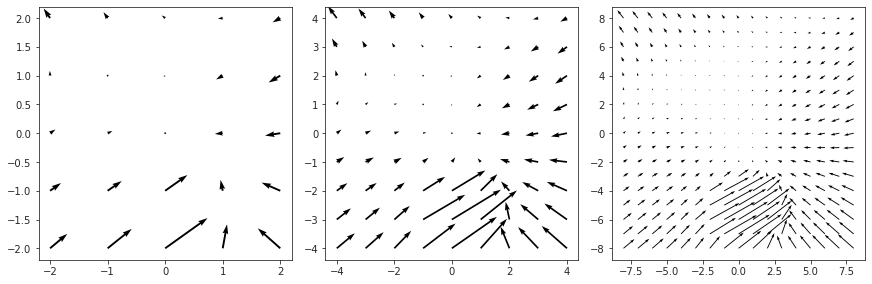

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 1, 4) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

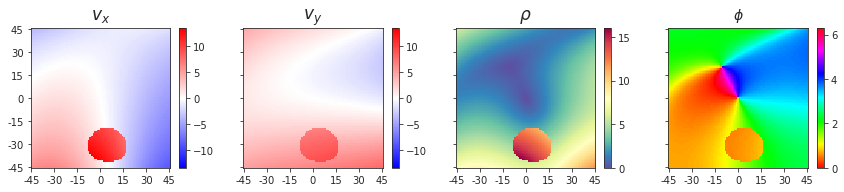

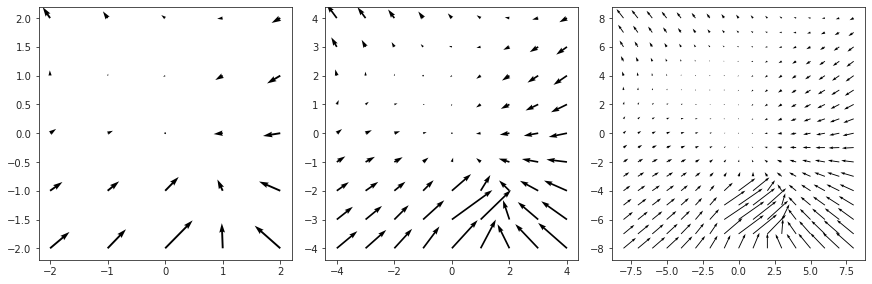

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 1, 5) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [  0   0 -10]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

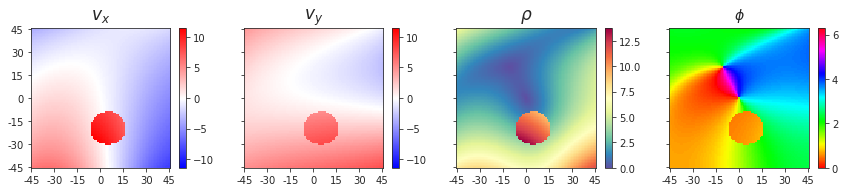

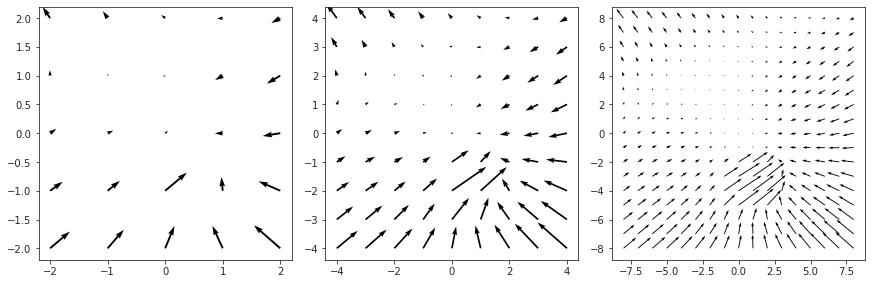

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 1, 6) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [  0   0 -10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

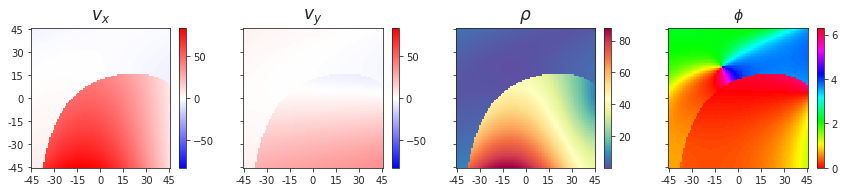

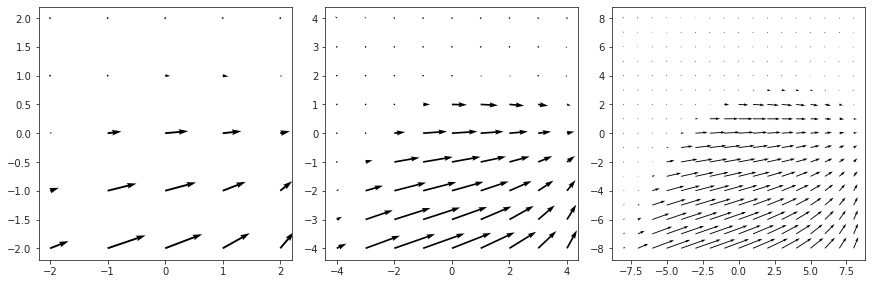

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 1, 7) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [  0   0 -10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

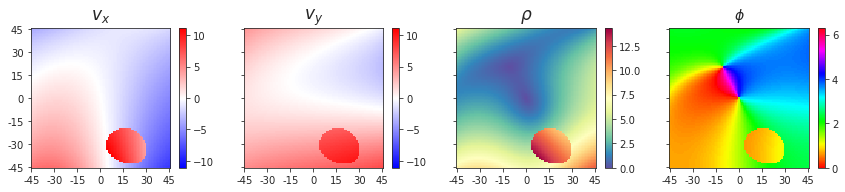

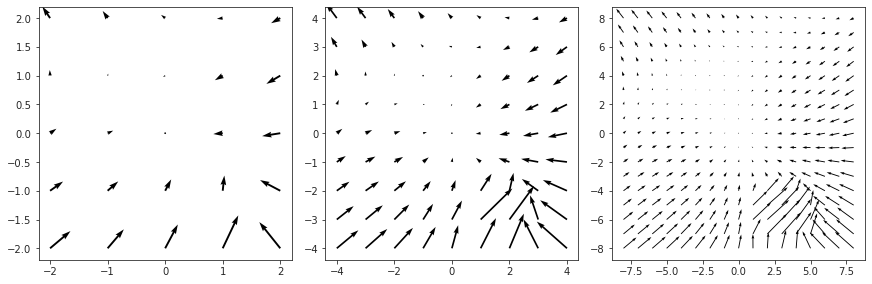

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 1, 8) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [  0   0 -10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

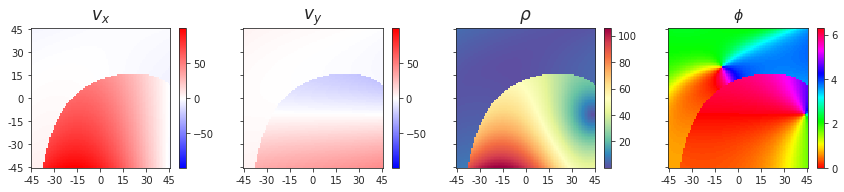

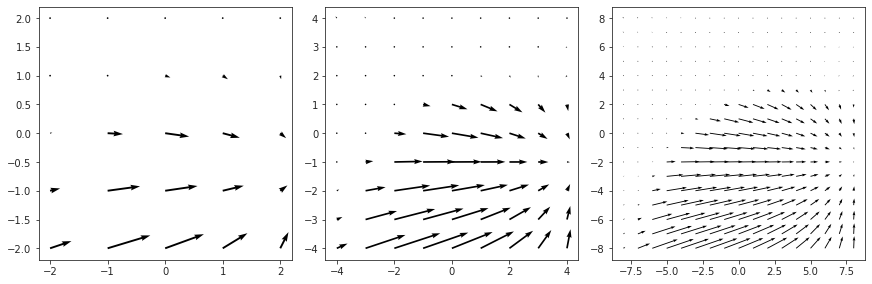

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 1, 9) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [  0   0 -10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

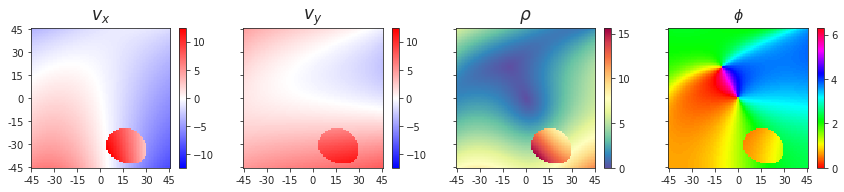

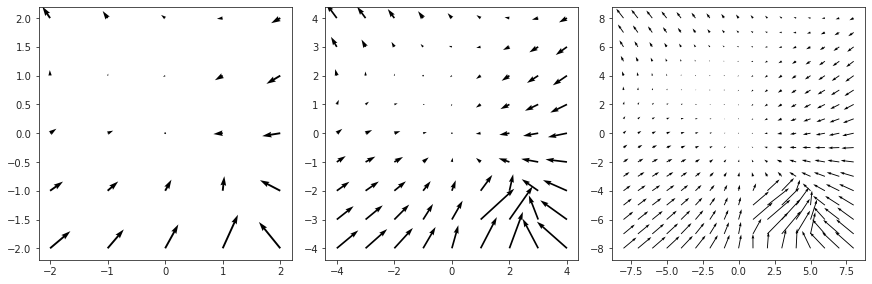

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 2, 0) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

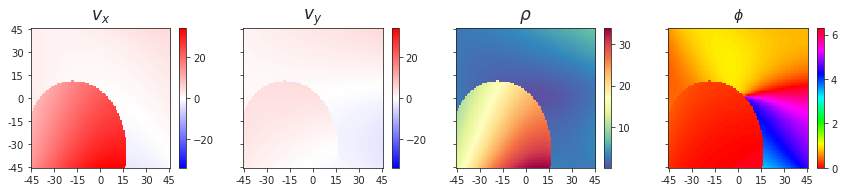

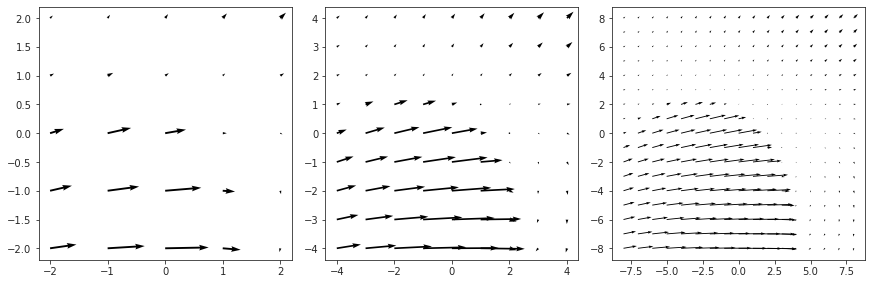

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 2, 1) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

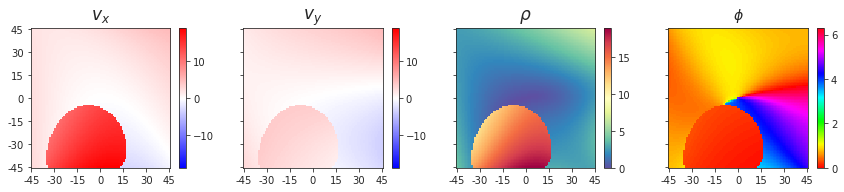

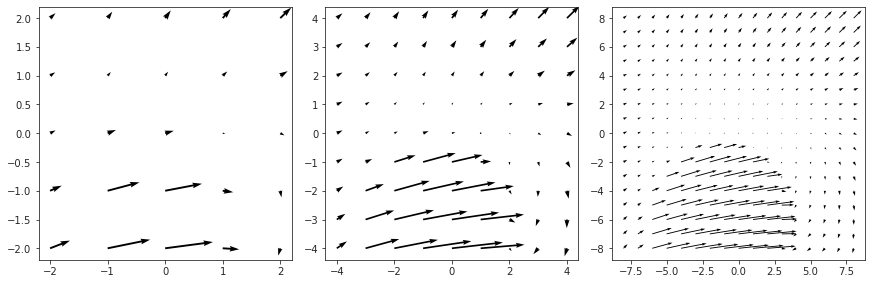

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 2, 2) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

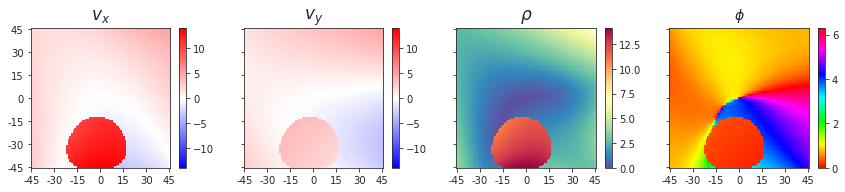

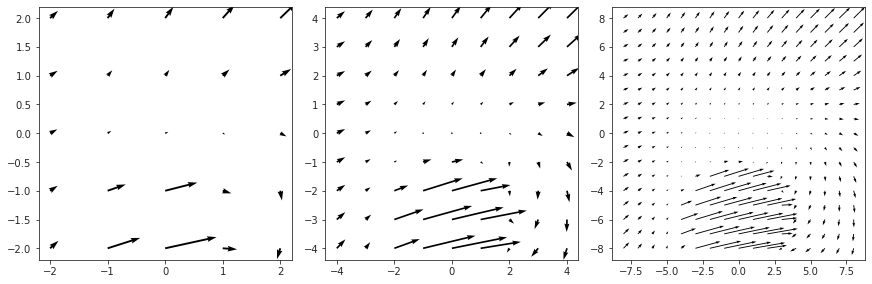

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 2, 3) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

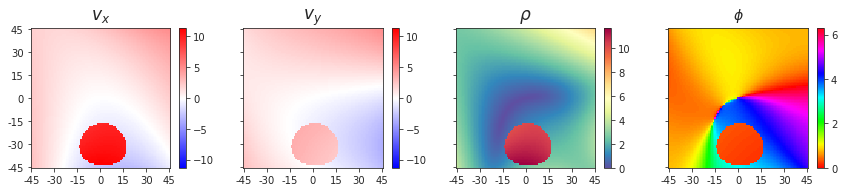

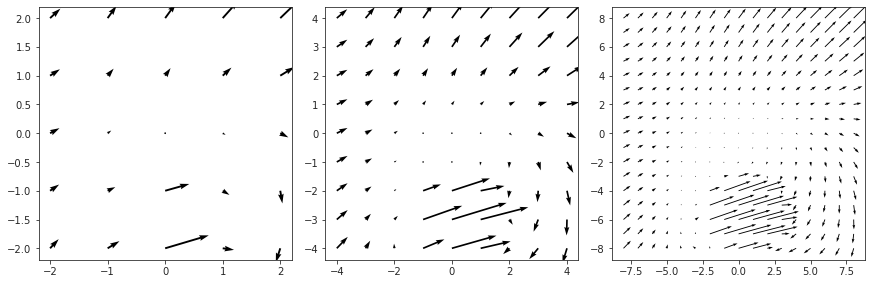

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 2, 4) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

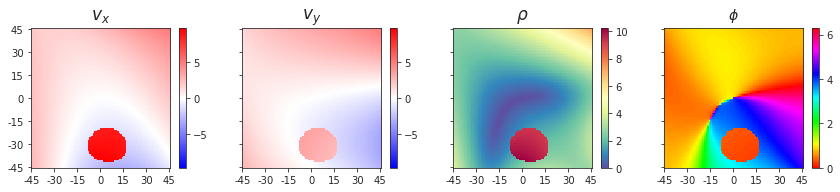

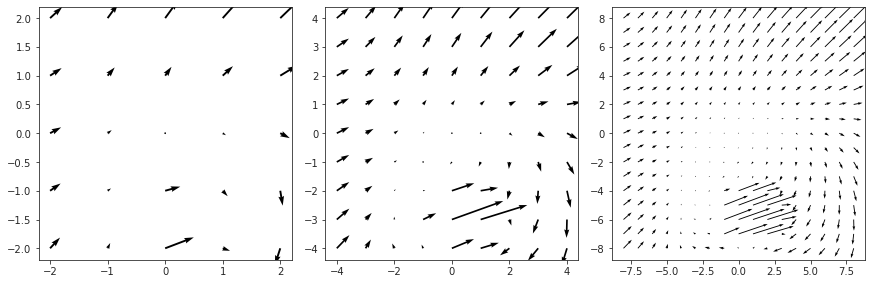

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 2, 5) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [5 5 0]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

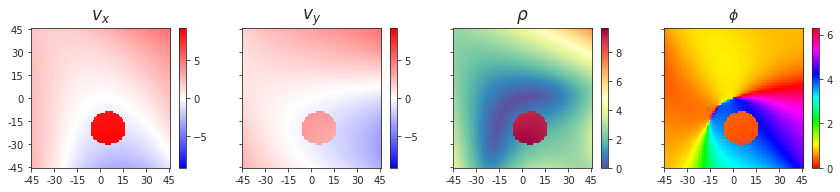

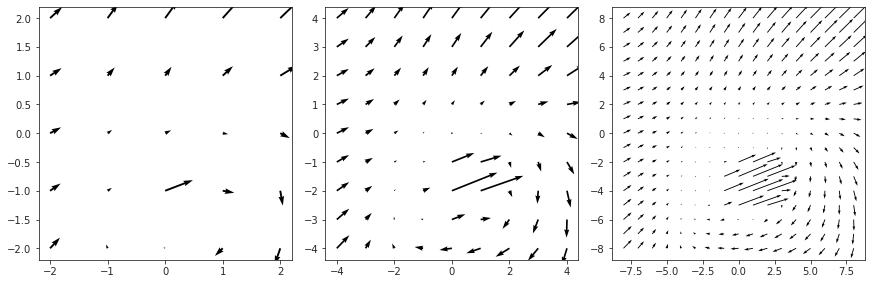

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 2, 6) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [5 5 0]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

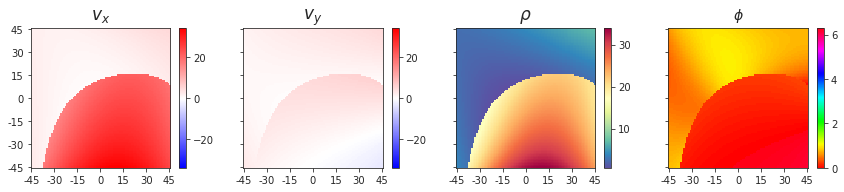

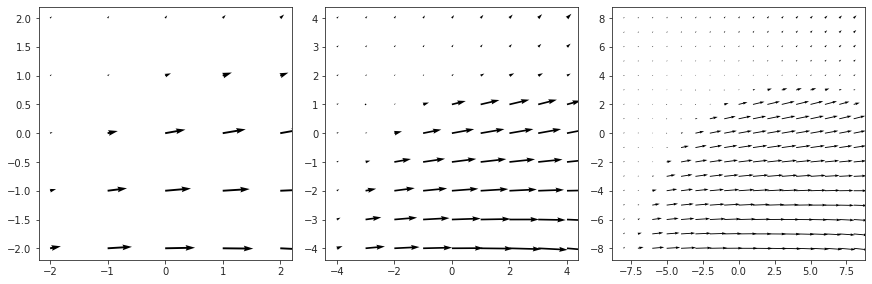

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 2, 7) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [5 5 0]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

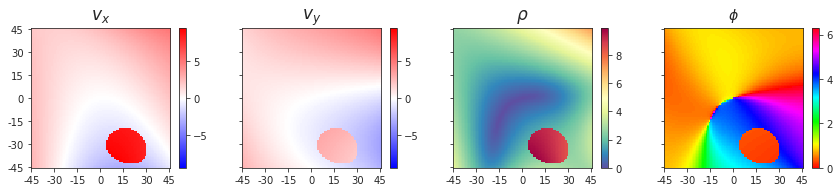

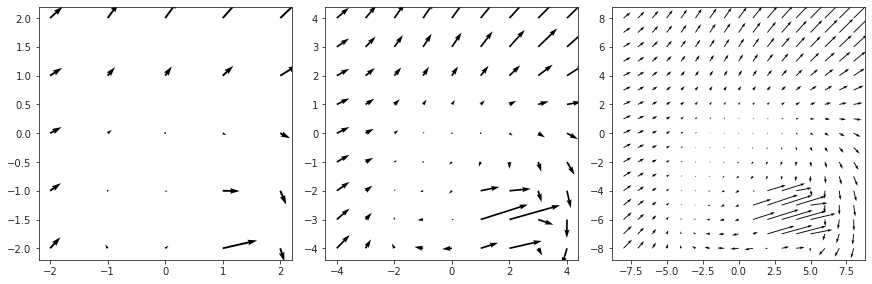

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 2, 8) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [5 5 0]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

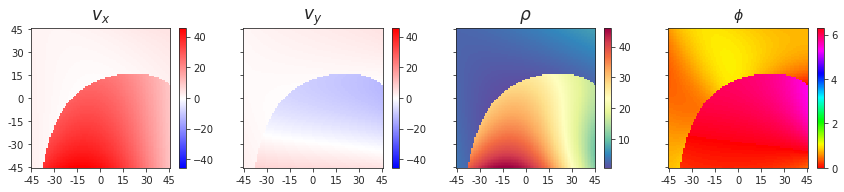

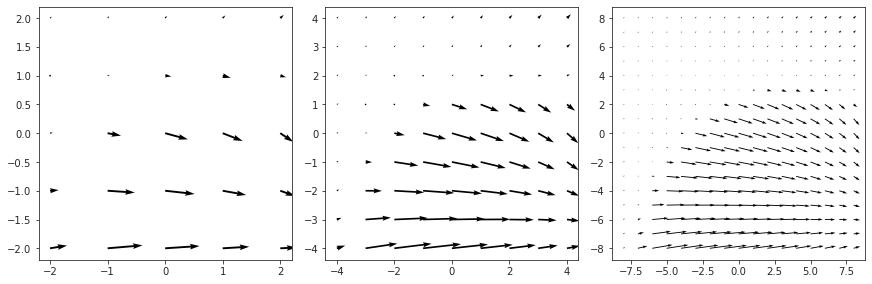

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 2, 9) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [5 5 0]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

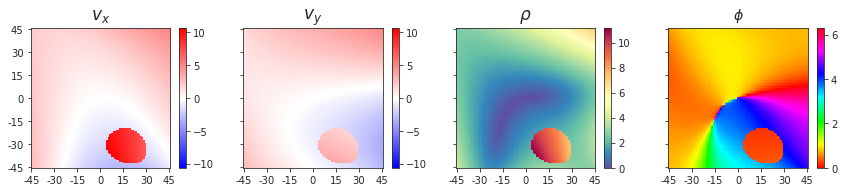

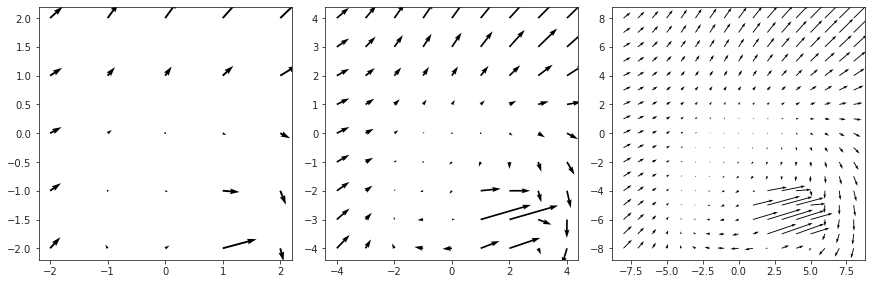

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 3, 0) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

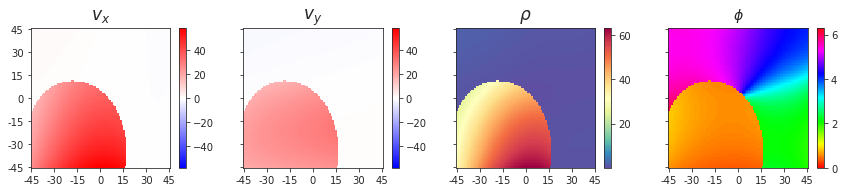

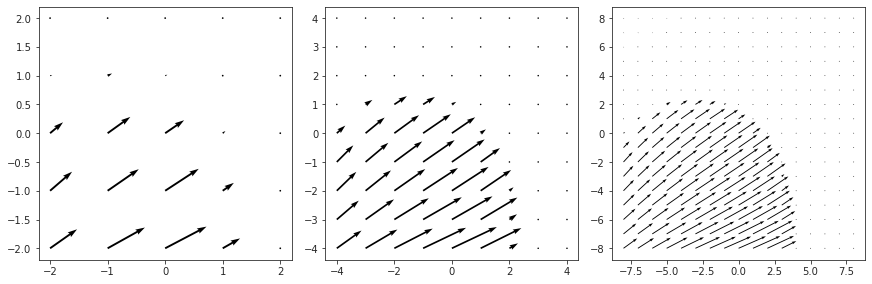

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 3, 1) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

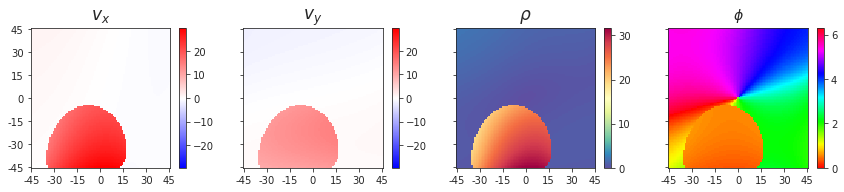

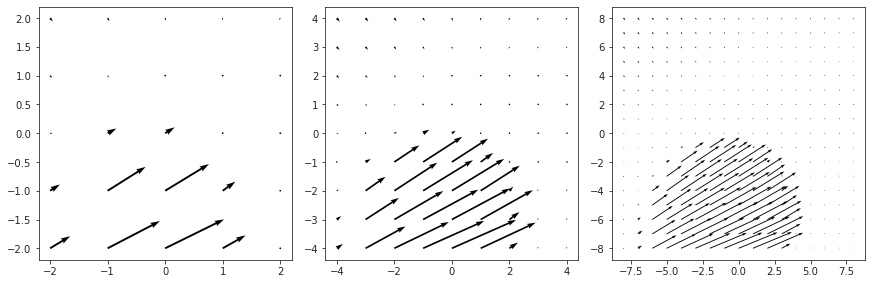

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 3, 2) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

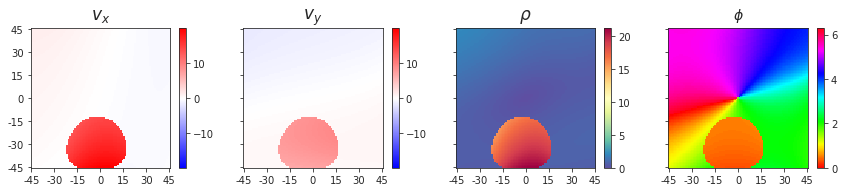

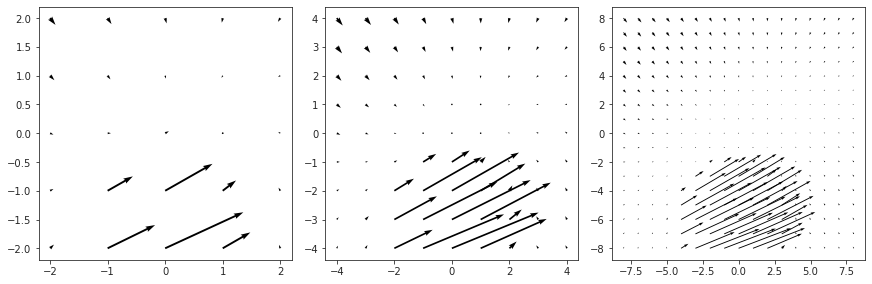

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 3, 3) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

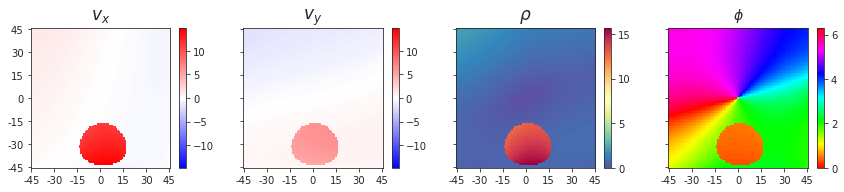

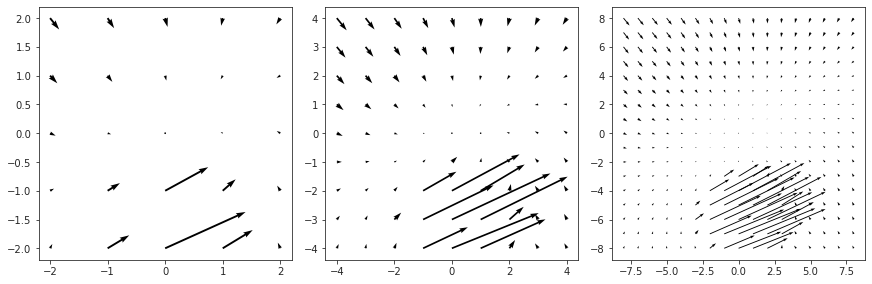

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 3, 4) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

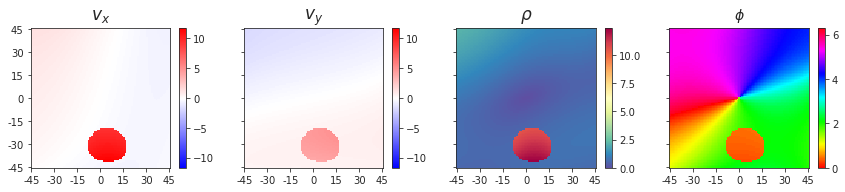

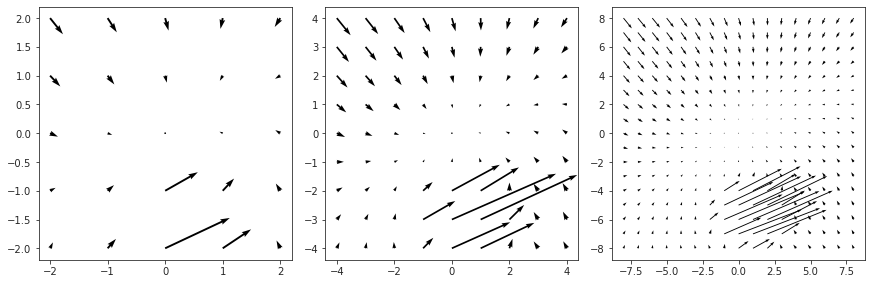

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 3, 5) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 1 -2  0]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

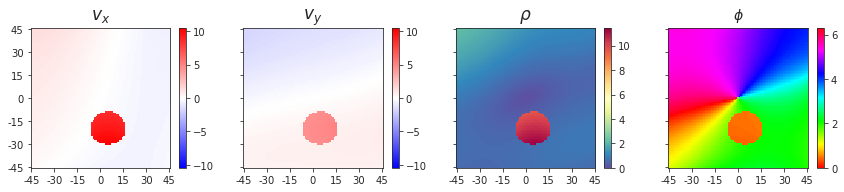

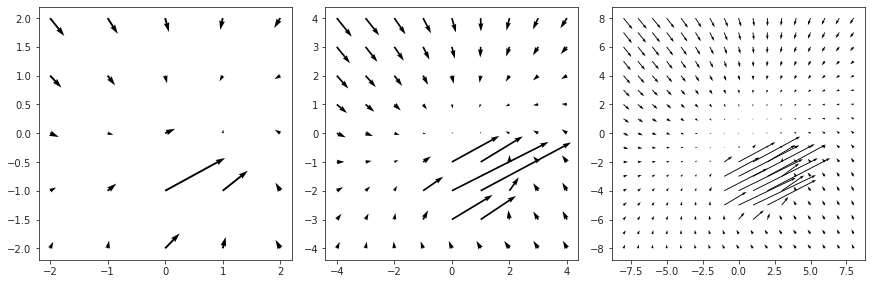

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 3, 6) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 1 -2  0]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

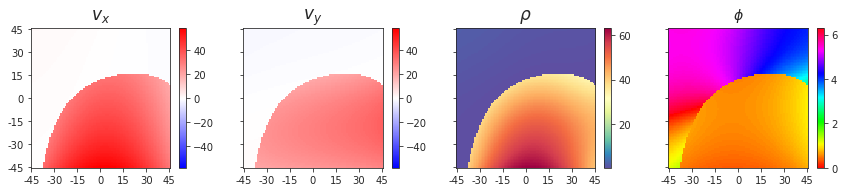

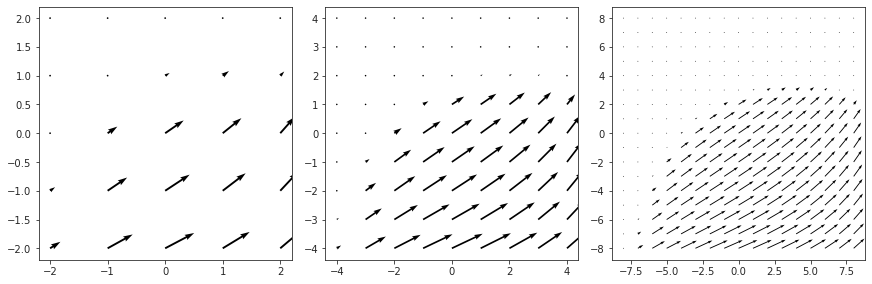

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 3, 7) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 1 -2  0]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

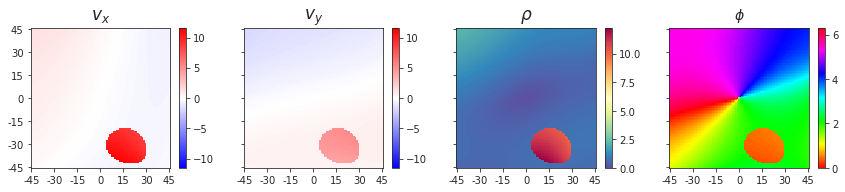

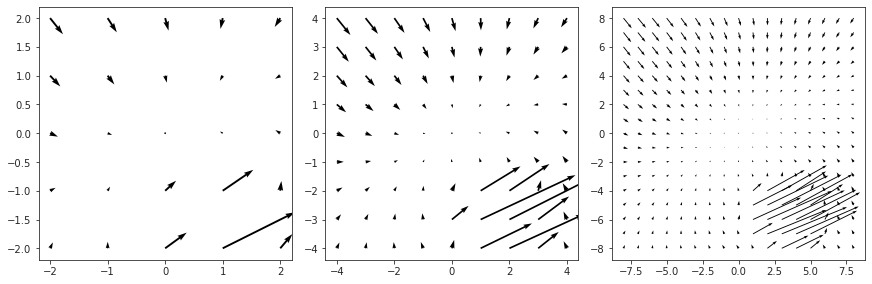

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 3, 8) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 1 -2  0]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

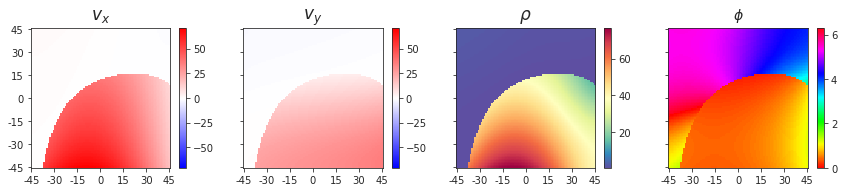

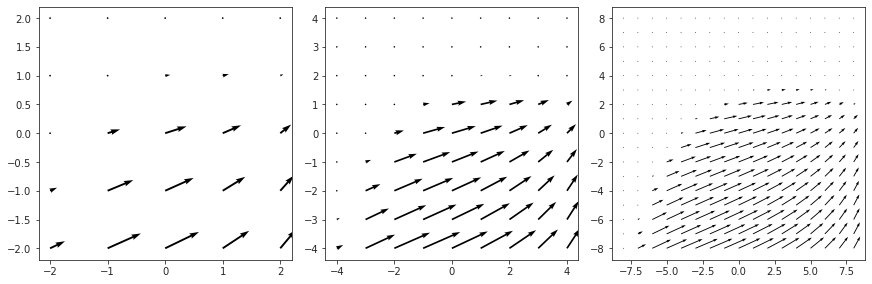

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 3, 9) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 1 -2  0]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

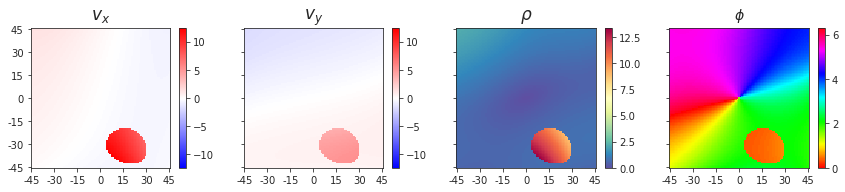

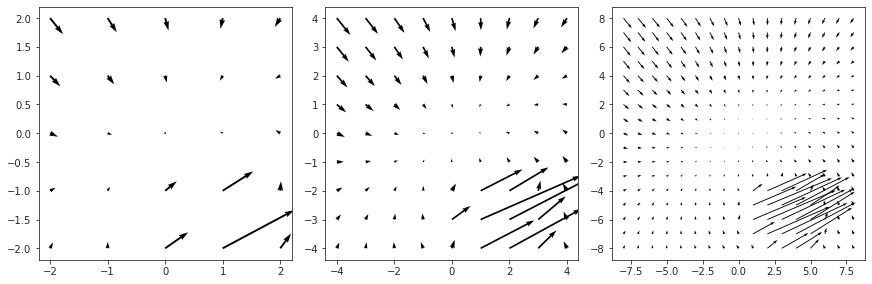

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 4, 0) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

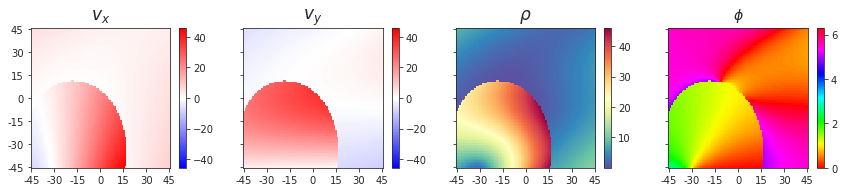

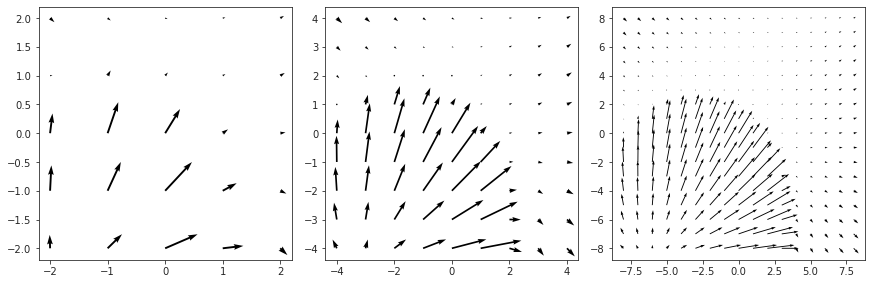

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 4, 1) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

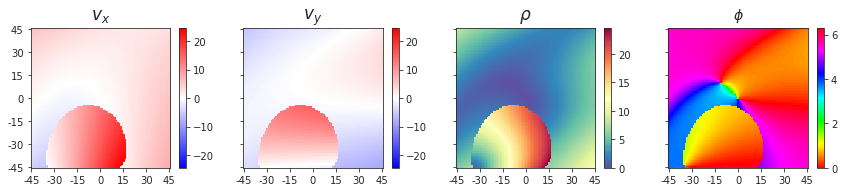

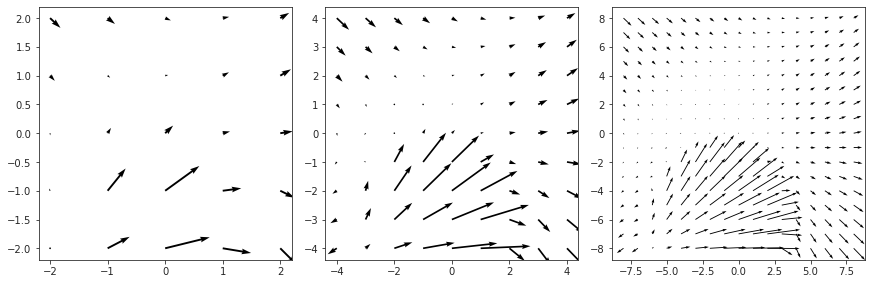

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 4, 2) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

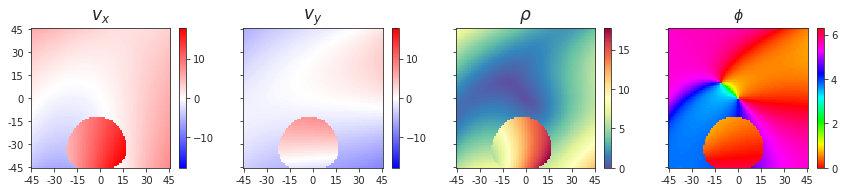

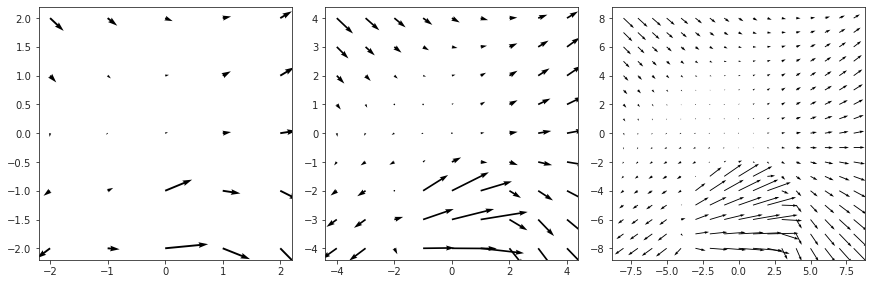

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 4, 3) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

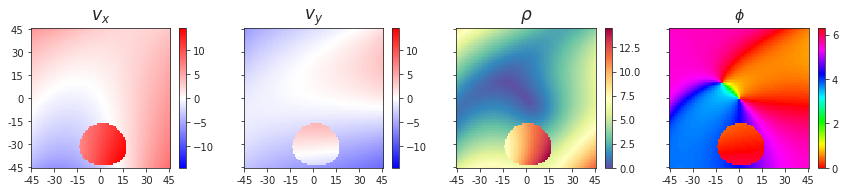

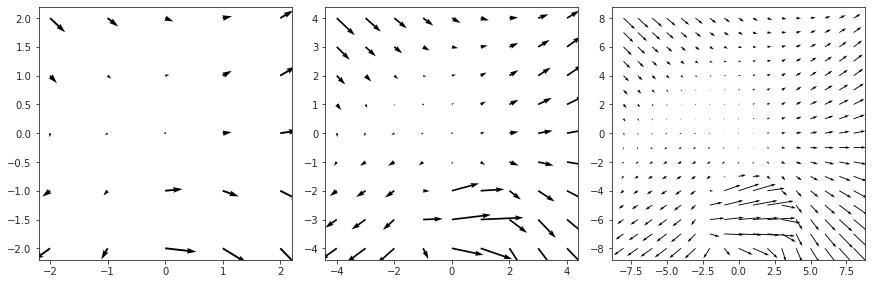

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 4, 4) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

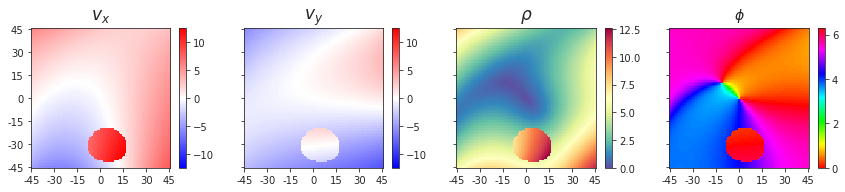

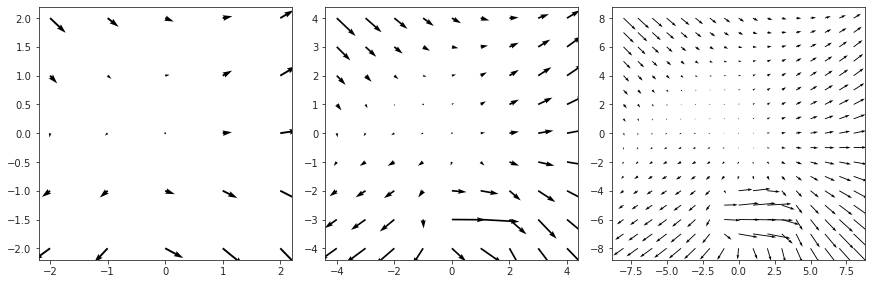

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 4, 5) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 3  0 10]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

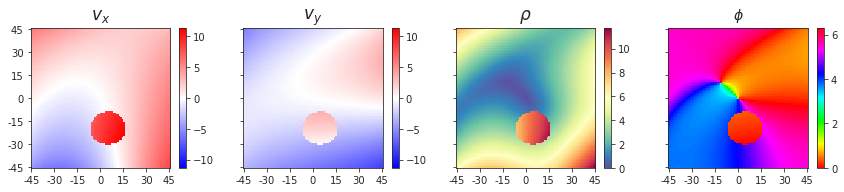

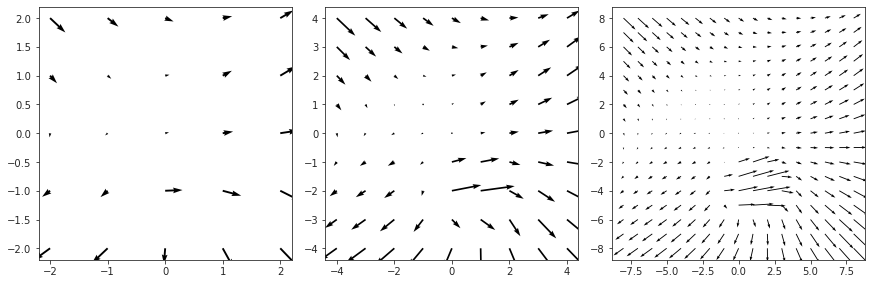

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 4, 6) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 3  0 10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

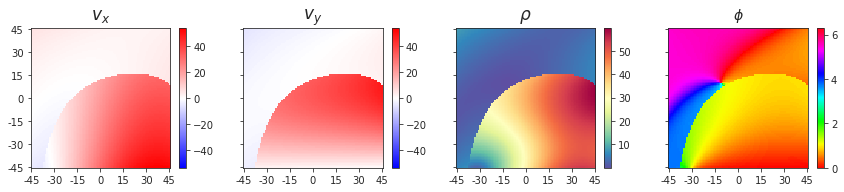

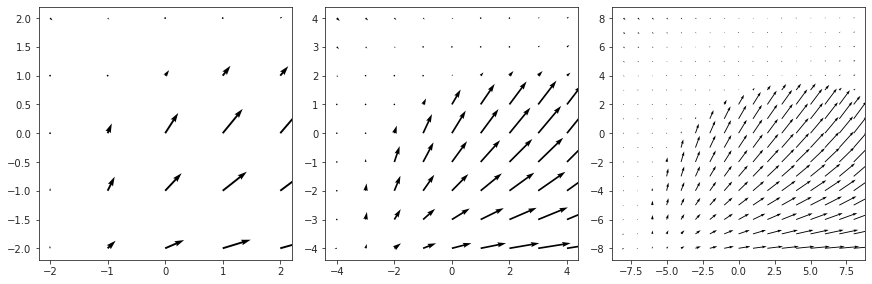

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 4, 7) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 3  0 10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

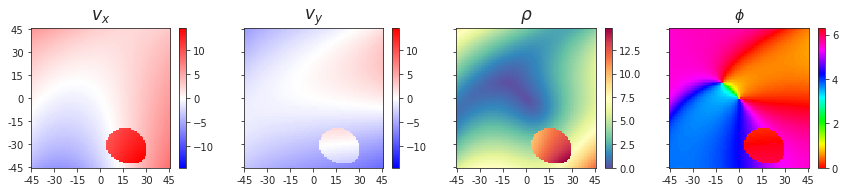

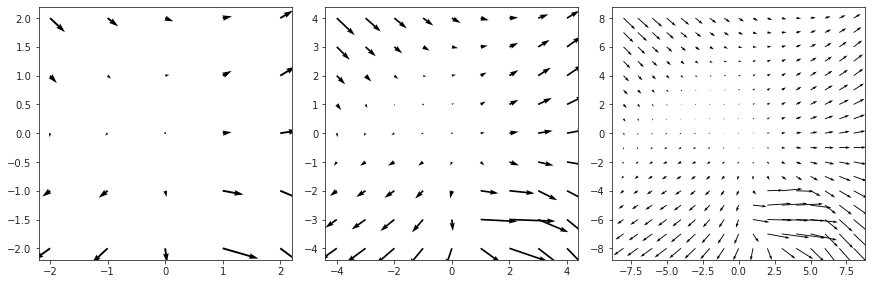

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 4, 8) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 3  0 10]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

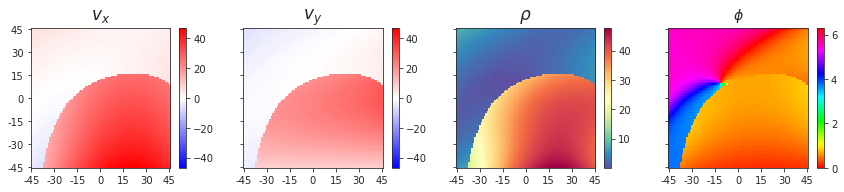

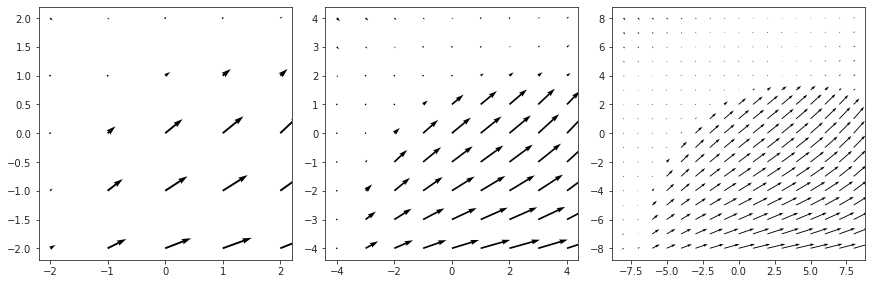

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 4, 9) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [ 3  0 10]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

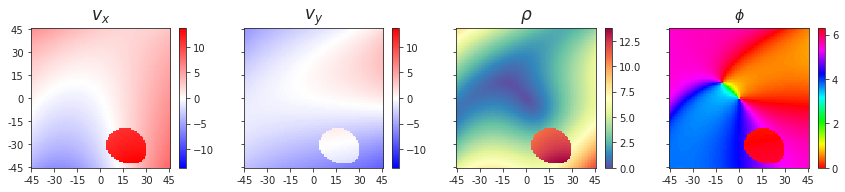

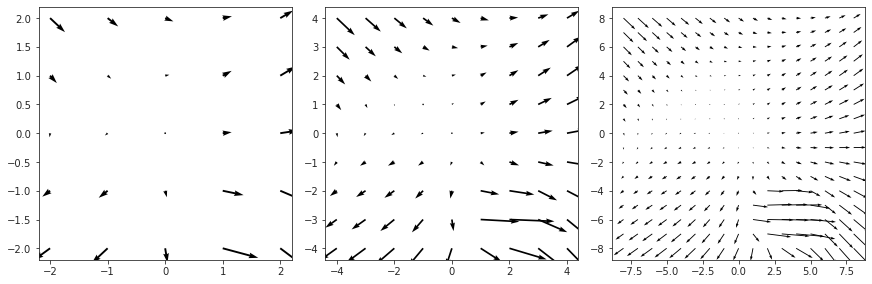

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 5, 0) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

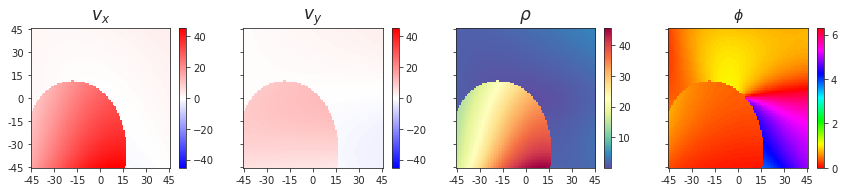

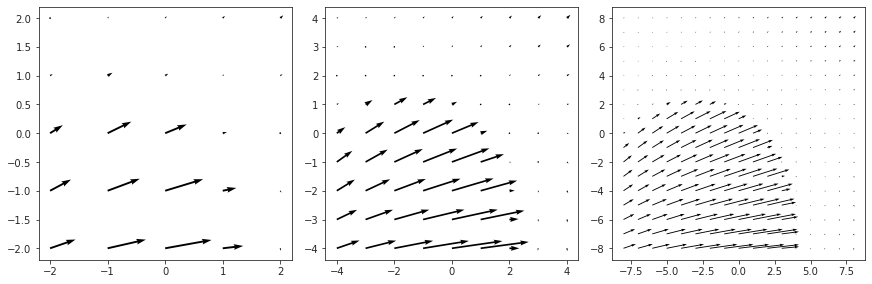

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 5, 1) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

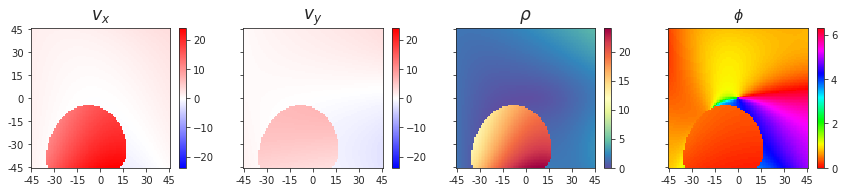

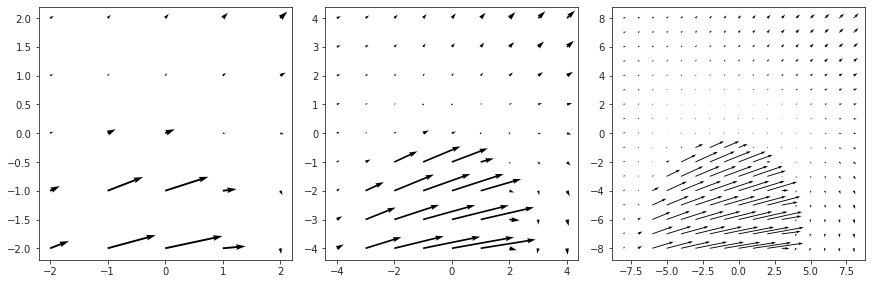

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 5, 2) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

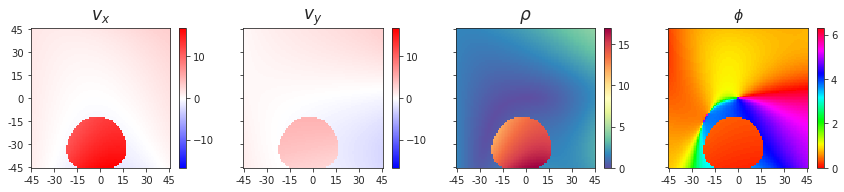

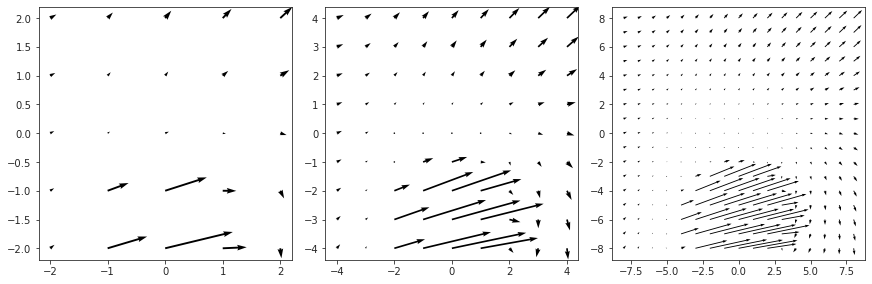

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 5, 3) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

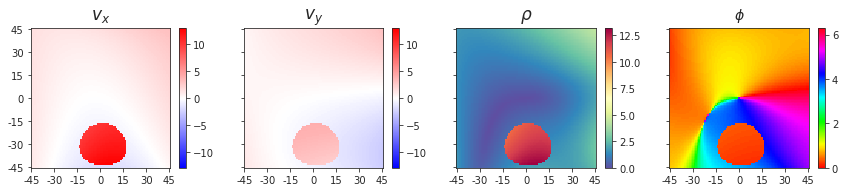

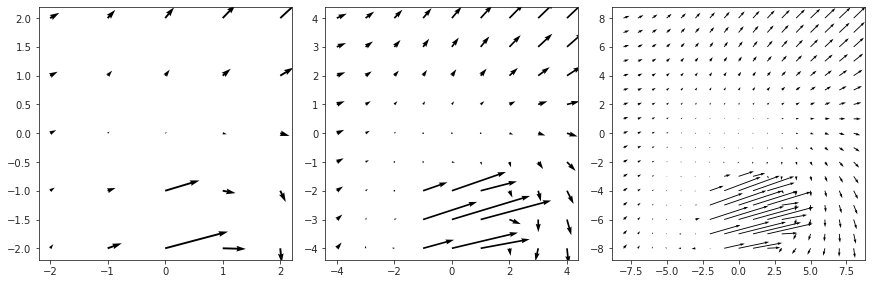

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 5, 4) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

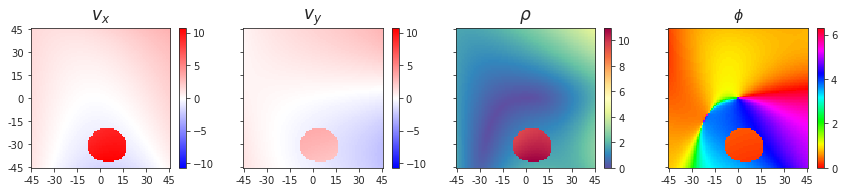

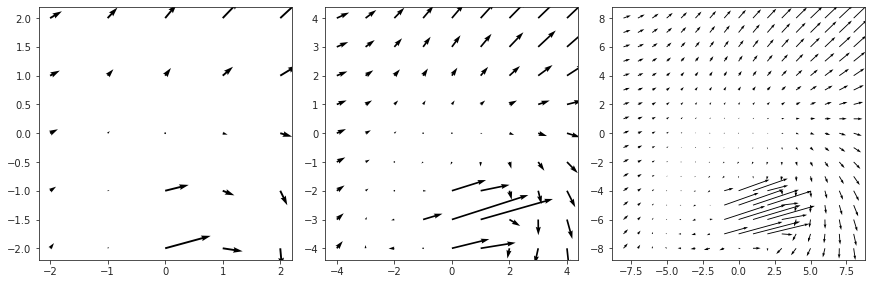

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 5, 5) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [3 3 1]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

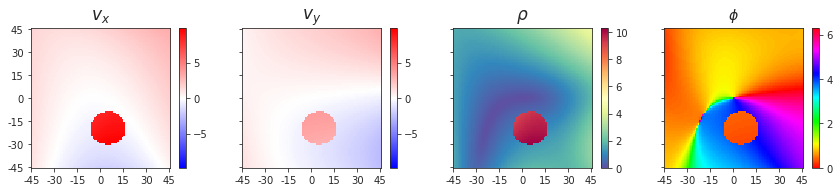

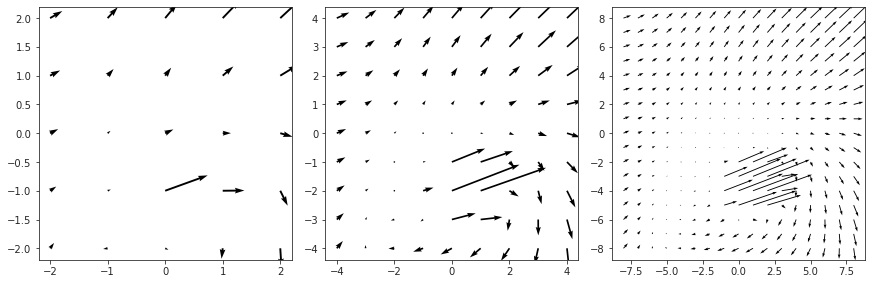

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 5, 6) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [3 3 1]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

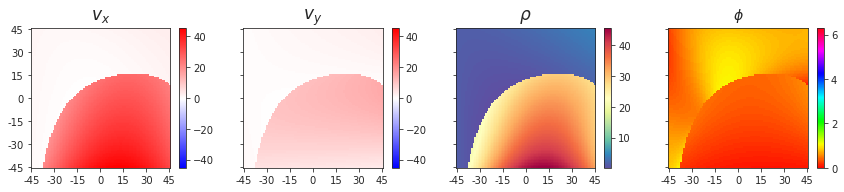

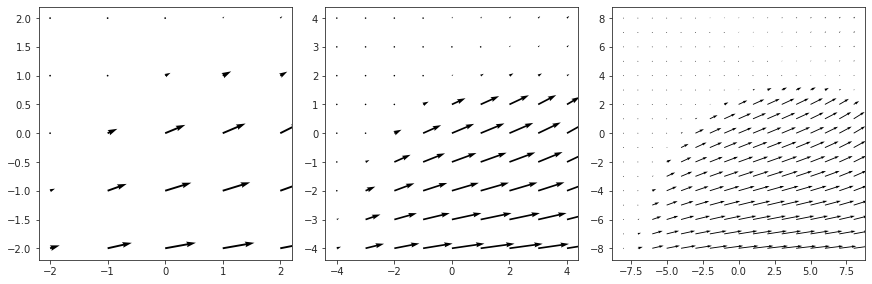

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 5, 7) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [3 3 1]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

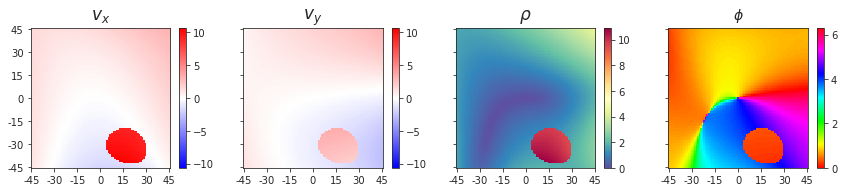

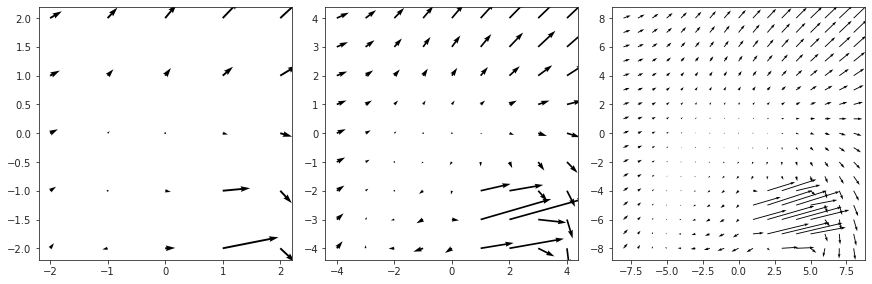

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 5, 8) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [3 3 1]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

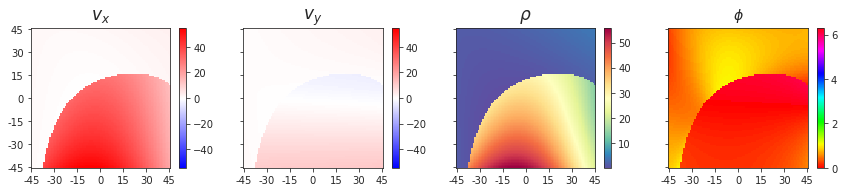

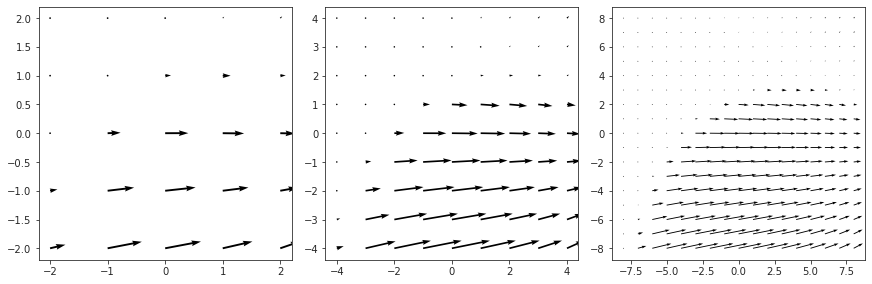

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 5, 9) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [3 3 1]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

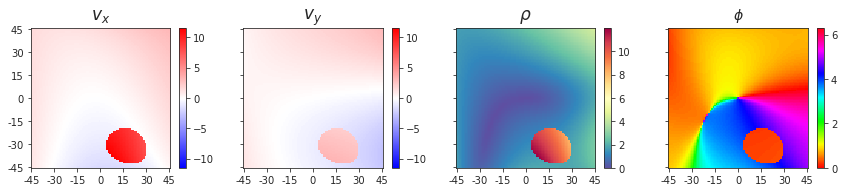

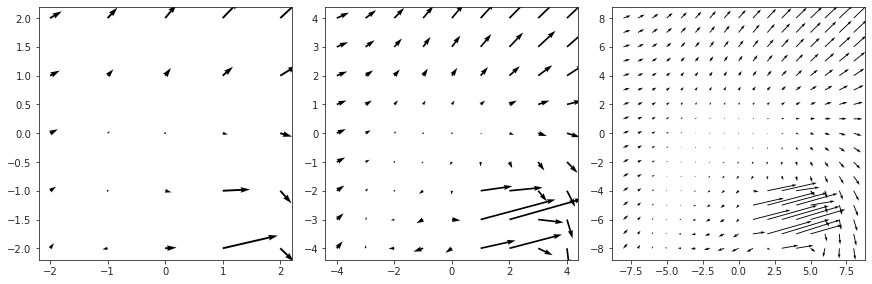

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 6, 0) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   0.2],  v_obj: [9.5 4.7 0. ]

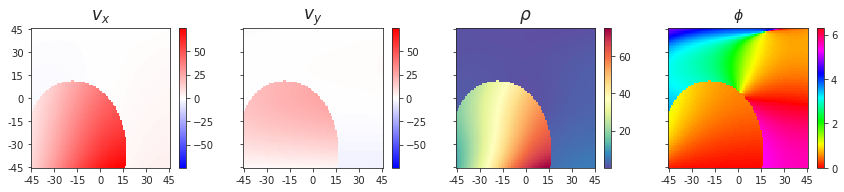

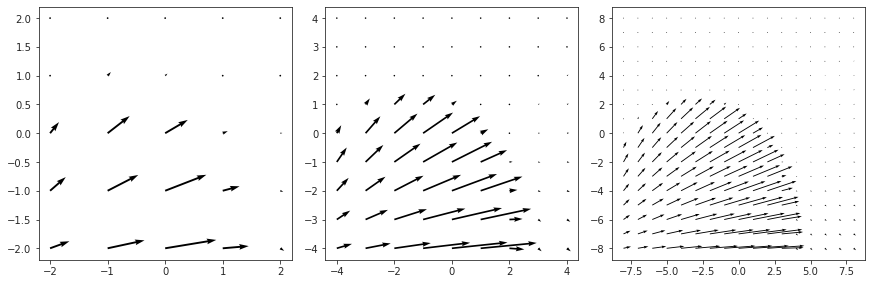

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 6, 1) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   0.4],  v_obj: [9.5 4.7 0. ]

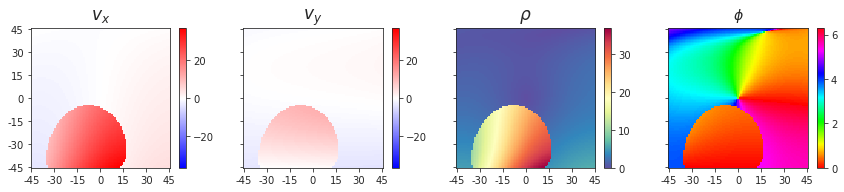

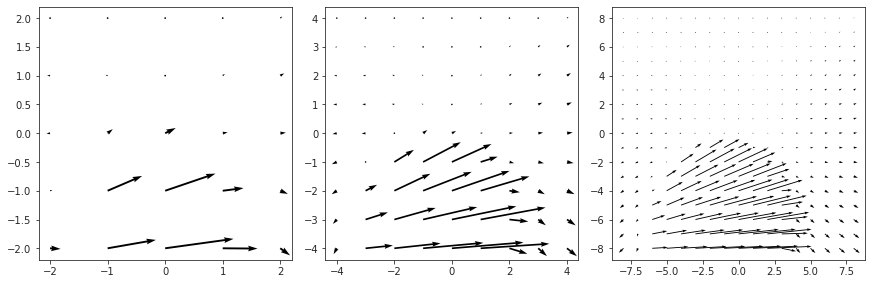

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 6, 2) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   0.6],  v_obj: [9.5 4.7 0. ]

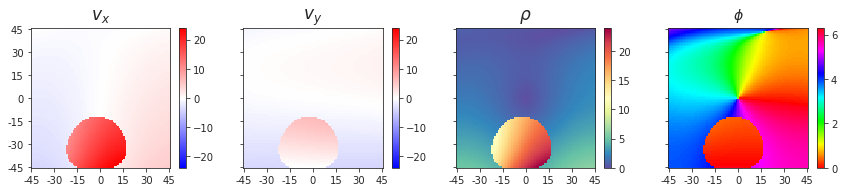

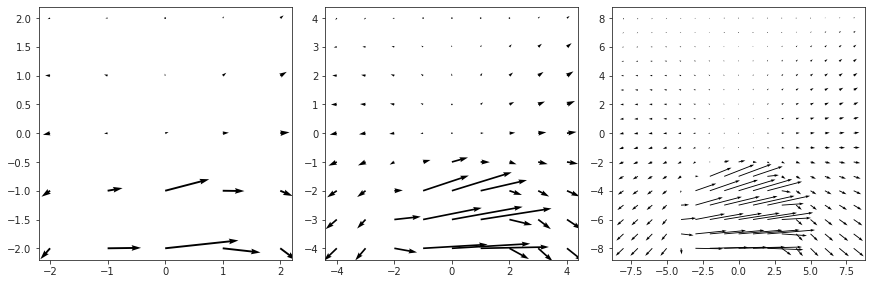

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 6, 3) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   0.8],  v_obj: [9.5 4.7 0. ]

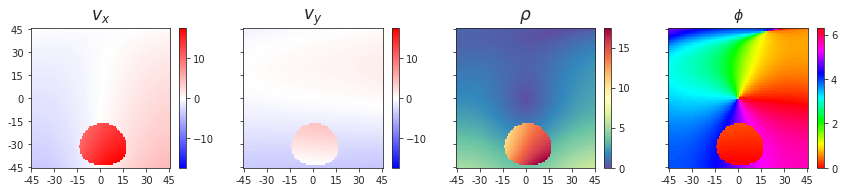

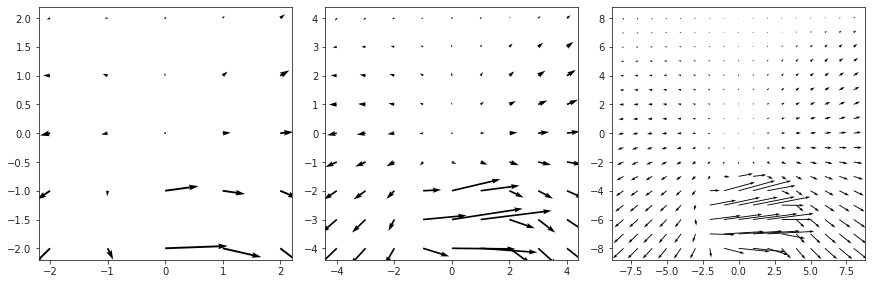

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 6, 4) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.   1. ],  v_obj: [9.5 4.7 0. ]

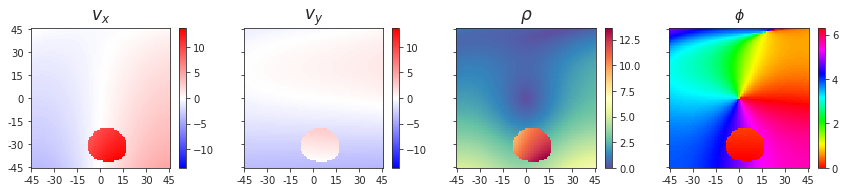

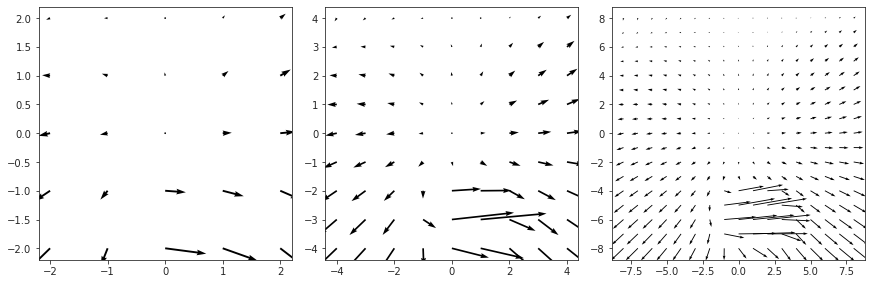

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 6, 5) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [-2  1  5]
obj . . . pos: [-0.2  0.2  1. ],  v_obj: [9.5 4.7 0. ]

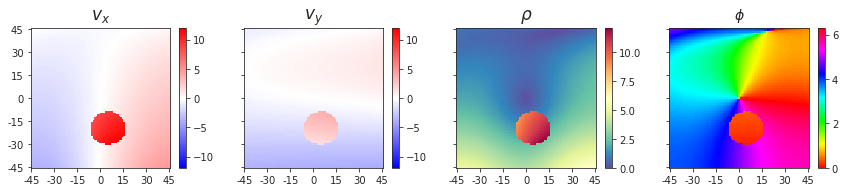

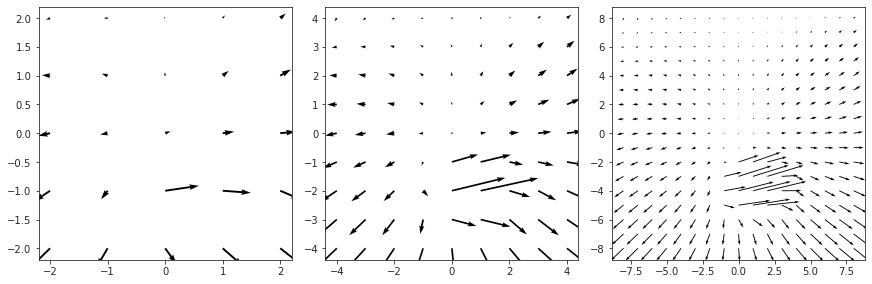

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 6, 6) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [-2  1  5]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 0. ]

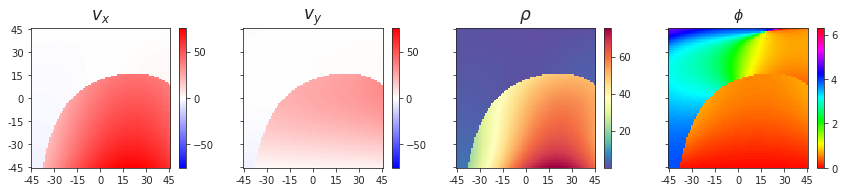

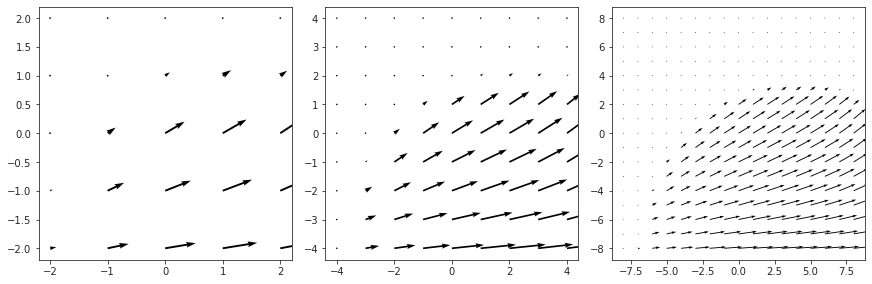

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 6, 7) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [-2  1  5]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 0. ]

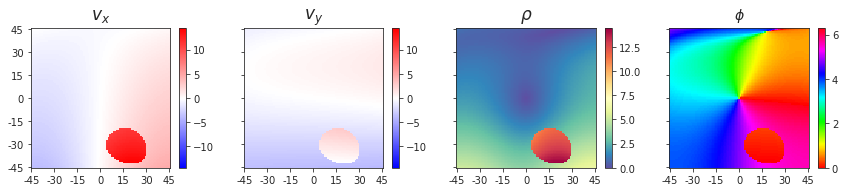

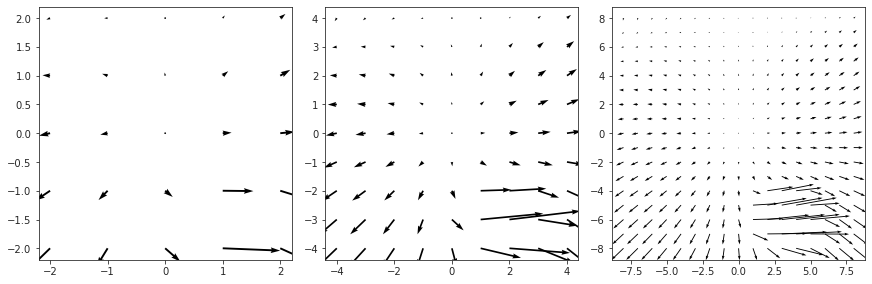

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 6, 8) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [-2  1  5]
obj . . . pos: [0.  0.  0.2],  v_obj: [9.5 4.7 6. ]

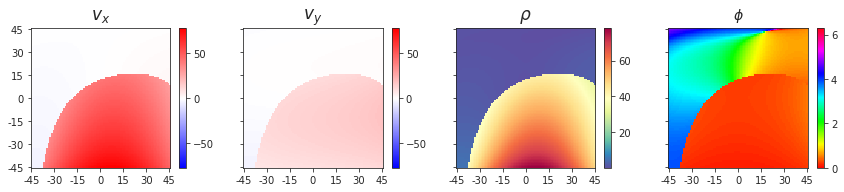

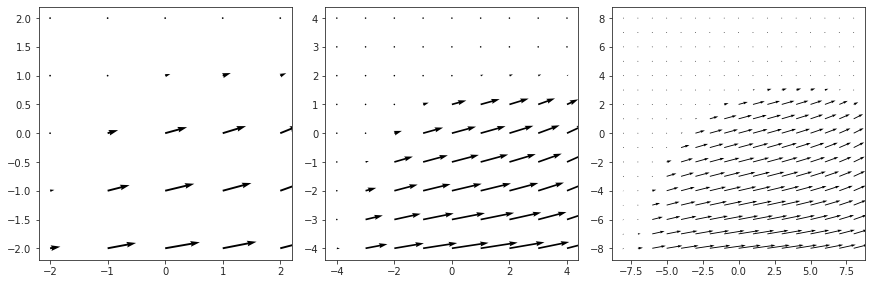

---------------------------------------------------------------------------

<<< idx, (i, j, k) = (4, 6, 9) >>>
self . . . fixation: [-0.3  0.6  1. ],  v_self: [-2  1  5]
obj . . . pos: [0. 0. 1.],  v_obj: [9.5 4.7 6. ]

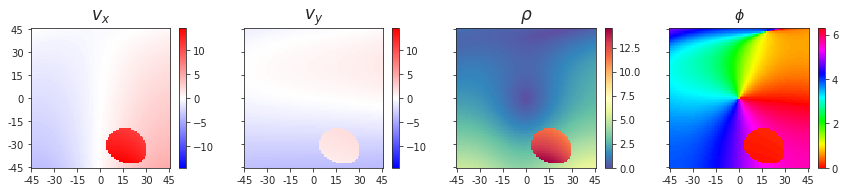

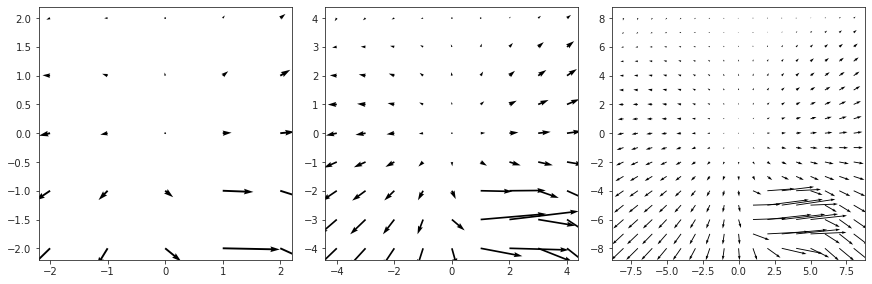

---------------------------------------------------------------------------

CPU times: user 5min 36s, sys: 5.92 s, total: 5min 42s
Wall time: 5min 41s


In [232]:
%%time


looper = itertools.product(
    enumerate(of.fix),
    enumerate(of.vel.T),
    enumerate(of.obj_vel.T),
)
for (i, f), (j, v_self), (k, v_obj) in looper:
    msg = f"<<< idx, (i, j, k) = ({i}, {j}, {k}) >>>\n"
    msg += f"self . . . fixation: {f},  v_self: {v_self}\n"
    msg += f"obj . . . pos: {of.obj_pos[:, k]},  v_obj: {v_obj}"
    print(msg)
    show_velocity(alpha_dot[i, ..., j, k])
    show_opticflow(alpha_dot[i, ..., j, k])
    print('-' * 75)
    print('\n\n')